# Import required libraries


In [1]:


# EDA TOOLS
import matplotlib.pyplot as plt
import seaborn as sns
from autoviz.AutoViz_Class import AutoViz_Class#Instantiate the AutoViz class
from scipy.stats import boxcox 


#Data transformation tools
from sklearn import preprocessing
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

#validation Tools
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

#Models
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from supervised.automl import AutoML
from sklearn import svm, datasets


#sampling tools
from imblearn.over_sampling import RandomOverSampler
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE


# ACCURACY METRICS
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.metrics import recall_score






## Predefined Functions

In [ ]:
def prepareData(X_copy,y):
    X_train, X_test, y_train, y_test = train_test_split(X_copy, y, test_size = 0.20, random_state = 0)
    sc = StandardScaler()
    X_train = sc.fit_transform(X_train)
    X_test = sc.transform(X_test)
    
    pca = PCA()
    pca = PCA(n_components=1)
    pca.fit(X_train)
    X_train = pd.DataFrame(pca.transform(X_train))
    X_test = pd.DataFrame(pca.transform(X_test))
    
    clf = LogisticRegression(random_state=0).fit(X_train, y_train)
    y_pred=clf.predict(X_test)
    get_Precision(y_test,y_pred)



    

def prepareData(X_copy,y):
    X_train, X_test, y_train, y_test = train_test_split(X_copy, y, test_size = 0.20, random_state = 0)
    sc = StandardScaler()
    X_train = sc.fit_transform(X_train)
    X_test = sc.transform(X_test)
    
    #pca = PCA()
    #pca = PCA(n_components=1)
    #pca.fit(X_train)
    #X_train = pd.DataFrame(pca.transform(X_train))
    #X_test = pd.DataFrame(pca.transform(X_test))
    
    #clf = LogisticRegression(random_state=0).fit(X_train, y_train)
    clf = SVC(kernel='sigmoid') 
    clf.fit(X_train, y_train) 
    y_pred=clf.predict(X_test)
    get_Precision(y_test,y_pred)

    
def get_Precision(actual,predicted):
    matrix = confusion_matrix(actual,predicted, labels=[2,1])
    tp, fn, fp, tn = confusion_matrix(actual,predicted,labels=[2,1]).reshape(-1)
    matrix = classification_report(actual,predicted,labels=[2,1])
    print('Classification report : \n',matrix)
    precision=tp/(tp+fp)
    recall=tp/(tp+fn)
    return(precision,recall,tp, fn, fp, tn)

def knn_comparison(X_train,y_train,k):
    knn = KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_train, y_train)
    plot_decision_regions(X_train.to_numpy(), y_train, clf=knn, legend=2)
# Adding axes annotations
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.title('Knn with K='+ str(k))
    plt.show()

## Reading and dataset overview

In [2]:

ilpd= pd.read_csv('Indian Liver Patient Dataset (ILPD).csv')
ilpd.head()

,age,gender,tot_bilirubin,direct_bilirubin,tot_proteins,albumin,ag_ratio,sgpt,sgot,alkphos,is_patient
0,26.0,Male,42.8,19.7,390.0,75.0,138.0,7.5,2.6,0.5,1
1,32.0,Male,32.6,14.1,219.0,95.0,235.0,5.8,3.1,1.1,1
2,40.0,Male,30.8,18.3,285.0,110.0,186.0,7.9,2.7,0.5,1
3,42.0,Male,30.5,14.2,285.0,65.0,130.0,5.2,2.1,0.6,1
4,32.0,Male,30.5,17.1,218.0,39.0,79.0,5.5,2.7,0.9,1


## Checking for missing Value

In [3]:
imp = SimpleImputer(missing_values=np.nan, strategy='median')
#Imputing values
ilpd['alkphos']=imp.fit_transform(ilpd[['alkphos']])
ilpd.isnull().sum()

age                 0
gender              0
tot_bilirubin       0
direct_bilirubin    0
tot_proteins        0
albumin             0
ag_ratio            0
sgpt                0
sgot                0
alkphos             0
is_patient          0
dtype: int64

## Transfomring categorical gender column to indicator varialbe

In [5]:
#Replacing Male and Female with 1 and 0
ilpd['gender'] = ilpd['gender'].apply(lambda x:1 if x == 'Male' else 0)

### Studying outlier points from every column and deleting the ones way outside the normal region

Text(0, 0.5, 'tot_bilirubin')

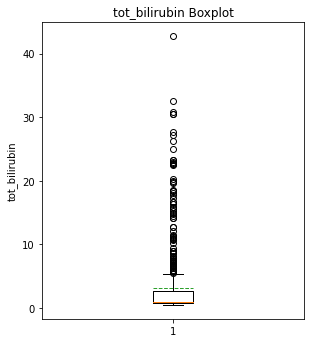

In [6]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['tot_bilirubin'], showmeans = True, meanline = True)
plt.title('tot_bilirubin Boxplot')
plt.ylabel('tot_bilirubin')

In [7]:
ilpd.drop(ilpd.index[ilpd['tot_bilirubin'] == 75], inplace=True)

Text(0, 0.5, 'tot_bilirubin')

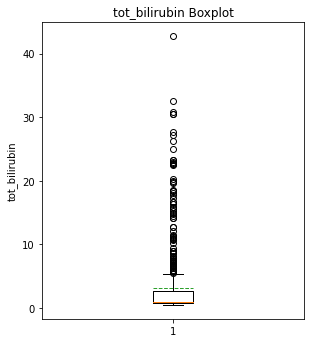

In [8]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['tot_bilirubin'], showmeans = True, meanline = True)
plt.title('tot_bilirubin Boxplot')
plt.ylabel('tot_bilirubin')

Text(0, 0.5, 'direct_bilirubin')

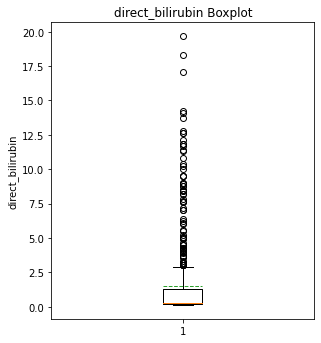

In [9]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['direct_bilirubin'], showmeans = True, meanline = True)
plt.title('direct_bilirubin Boxplot')
plt.ylabel('direct_bilirubin')

Text(0, 0.5, 'tot_proteins')

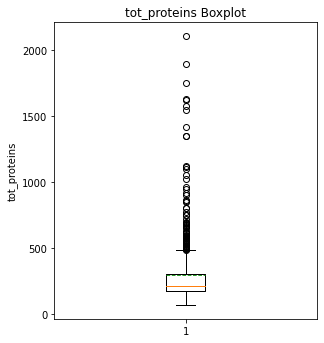

In [10]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['tot_proteins'], showmeans = True, meanline = True)
plt.title('tot_proteins Boxplot')
plt.ylabel('tot_proteins')

Text(0, 0.5, 'albumin')

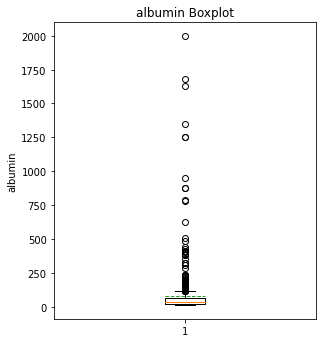

In [11]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['albumin'], showmeans = True, meanline = True)
plt.title('albumin Boxplot')
plt.ylabel('albumin')

Text(0, 0.5, 'ag_ratio')

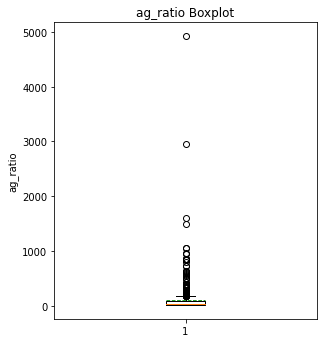

In [12]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['ag_ratio'], showmeans = True, meanline = True)
plt.title('ag_ratio Boxplot')
plt.ylabel('ag_ratio')

In [13]:
ilpd.drop(ilpd.index[ilpd['ag_ratio'] == 4929], inplace=True)

Text(0, 0.5, 'sgpt')

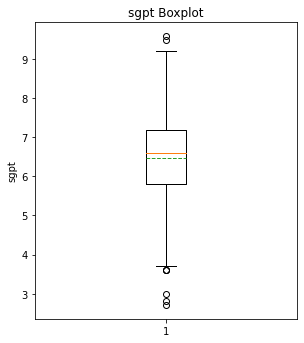

In [14]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['sgpt'], showmeans = True, meanline = True)
plt.title('sgpt Boxplot')
plt.ylabel('sgpt')

Text(0, 0.5, 'sgot')

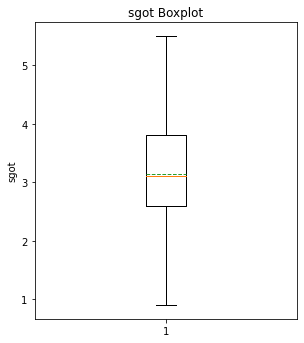

In [15]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['sgot'], showmeans = True, meanline = True)
plt.title('sgot Boxplot')
plt.ylabel('sgot')

Text(0, 0.5, 'alkphos')

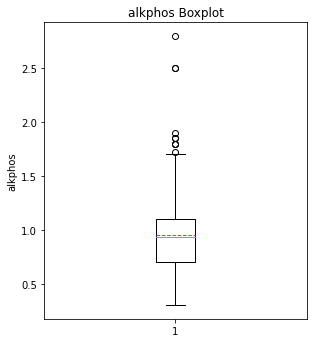

In [16]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x =ilpd['alkphos'], showmeans = True, meanline = True)
plt.title('alkphos Boxplot')
plt.ylabel('alkphos')

# Exploratory Data Anaylsis

C:\Users\v-saym\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


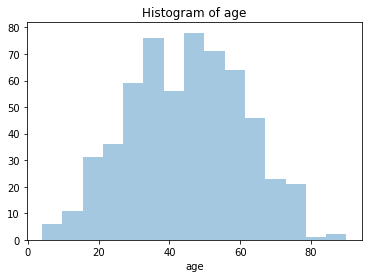

In [17]:
sns.distplot(ilpd.age, kde=False)
plt.title('Histogram of age')
plt.show();

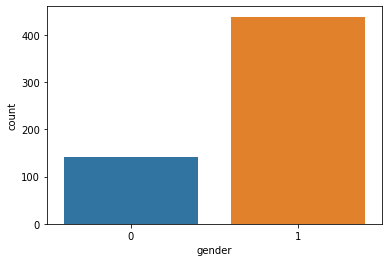

In [18]:
ax = sns.countplot(x="gender", data=ilpd)

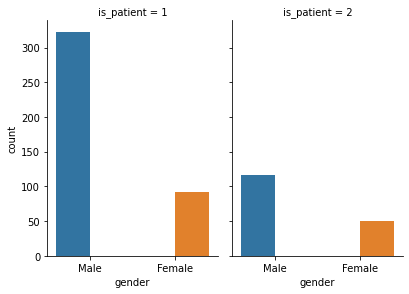

In [19]:
sns.catplot(x="gender", hue="gender", col="is_patient",
                data=pd.read_csv("Indian Liver Patient Dataset (ILPD).csv"), kind="count",
                height=4, aspect=.7);

Alert! from autoviz version 0.1.35, after importing, you must %matplotlib inline to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
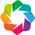

In [20]:
AV = AutoViz_Class()

Shape of your Data Set loaded: (582, 11)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    11 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Number of All Scatter Plots = 45
Time to run AutoViz = 3 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


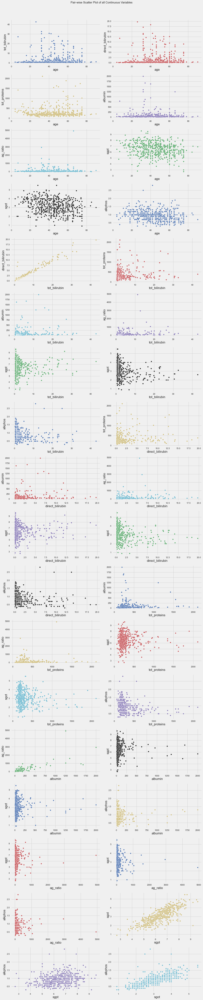

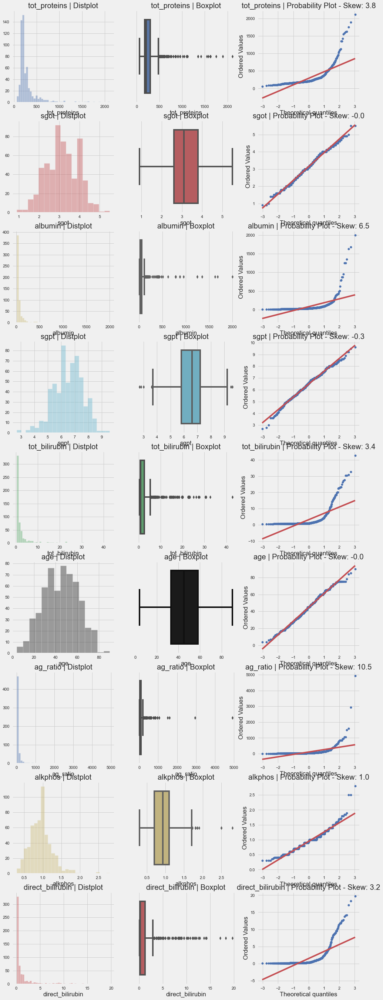

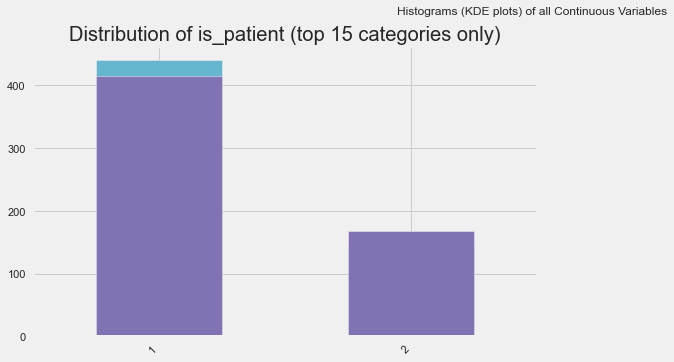

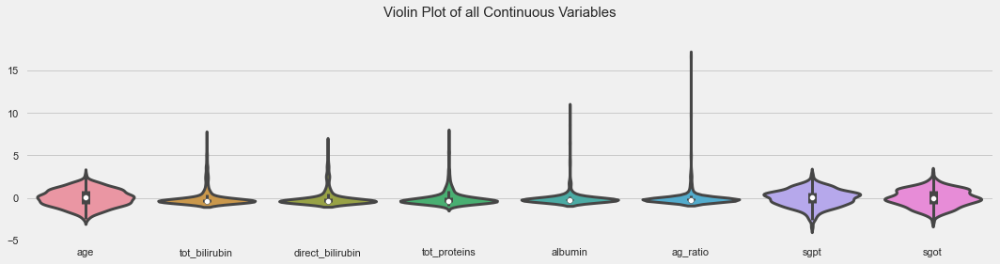

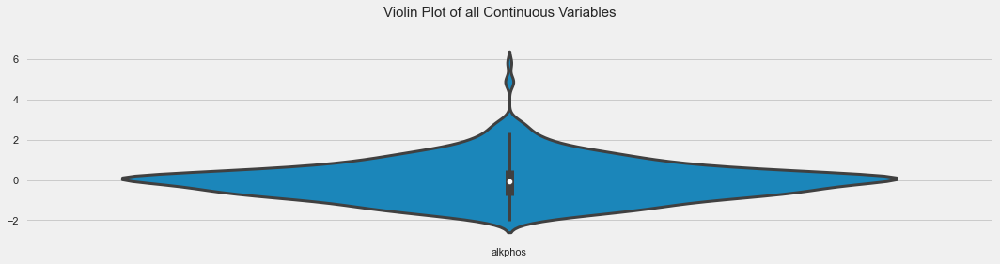

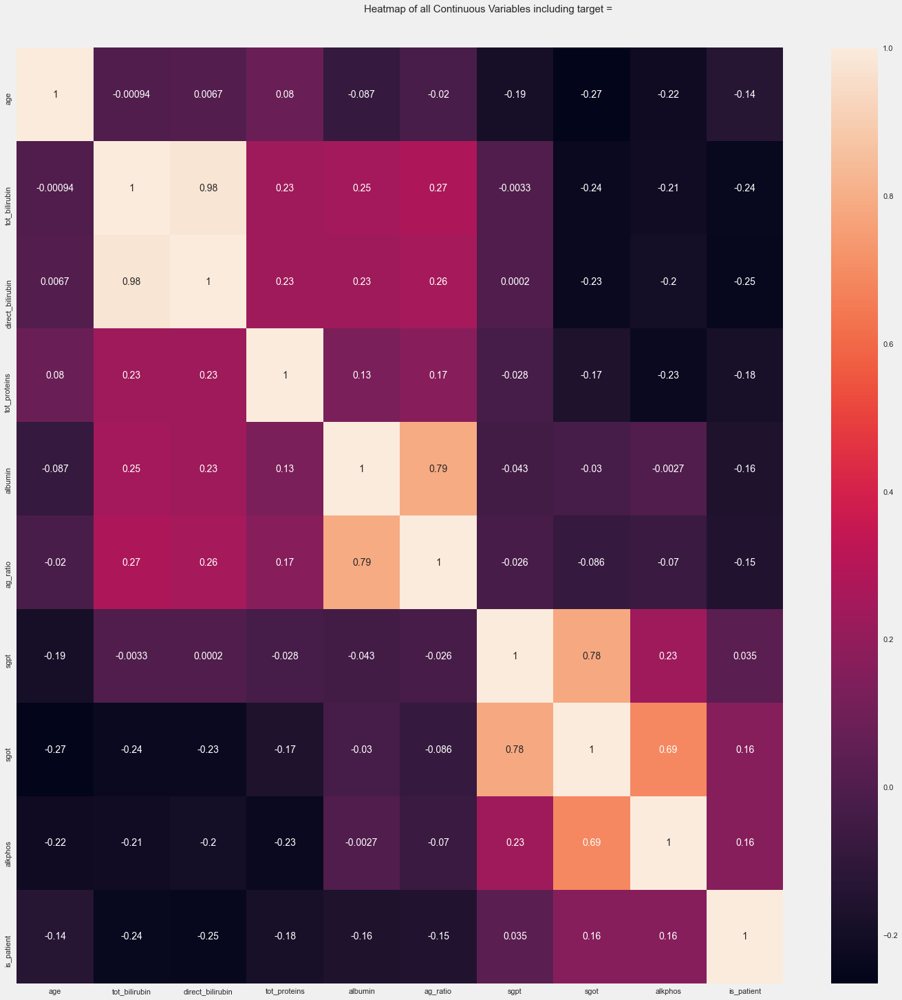

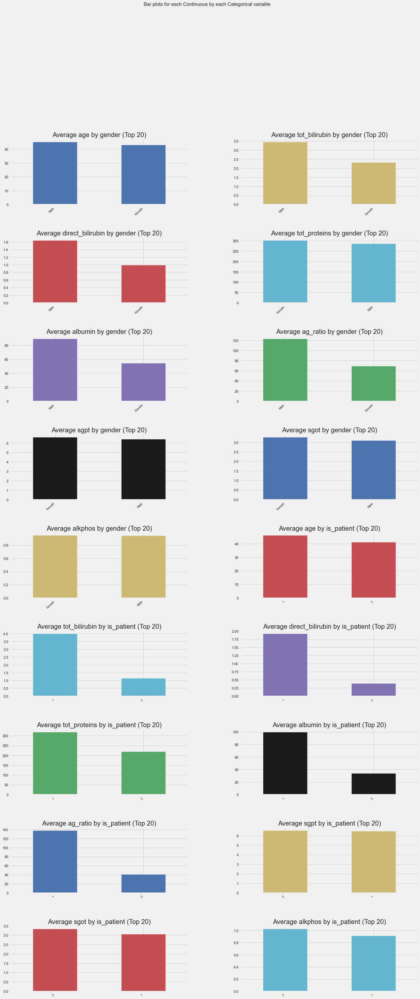

In [22]:
df = AV.AutoViz("Indian Liver Patient Dataset (ILPD).csv")


In [23]:
ilpd.dtypes

age                 float64
gender                int64
tot_bilirubin       float64
direct_bilirubin    float64
tot_proteins        float64
albumin             float64
ag_ratio            float64
sgpt                float64
sgot                float64
alkphos             float64
is_patient            int64
dtype: object

## Correlation Heatmap 

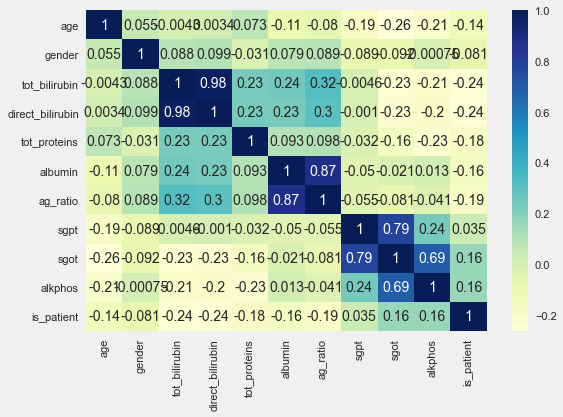

In [24]:
dataplot = sns.heatmap(ilpd.corr(), cmap="YlGnBu", annot=True)


### Bifurcating to dependent and independent columns for automl trial run for feature importance

In [194]:
y=ilpd[["is_patient"]]
X=ilpd.drop("is_patient",axis=1)

In [60]:

automl = AutoML(mode="Perform",eval_metric ="accuracy")
automl.fit(X, y)


AutoML directory: AutoML_6
The task is binary_classification with evaluation metric accuracy
AutoML will use algorithms: ['Linear', 'Random Forest', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'ensemble']
* Step simple_algorithms will try to check up to 1 model
There was an error during 1_Linear training.
Please check AutoML_6\errors.md for details.
* Step default_algorithms will try to check up to 5 models
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This cou

* Step not_so_random will try to check up to 20 models
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused

A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
11_LightGBM accuracy 0.729776 trained in 12.38 seconds (1-sample predict time 0.0918 seconds)
A worker process managed by the executor was unexpe

12_LightGBM accuracy 0.728055 trained in 12.26 seconds (1-sample predict time 0.1097 seconds)
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpe

A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
9_Xgboost accuracy 0.712565 trained in 11.22 seconds (1-sample predict time 0.1109 seconds)
A worker process managed by the executor was unexpect

2022-01-21 20:17:29,340 concurrent.futures ERROR exception calling callback for <Future at 0x1bf93283c08 state=finished raised TerminatedWorkerError>
Traceback (most recent call last):
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\externals\loky\_base.py", line 625, in _invoke_callbacks
    callback(self)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 340, in __call__
    self.parallel.dispatch_next()
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 769, in dispatch_next
    if not self.dispatch_one_batch(self._original_iterator):
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 835, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 754, in _dispatch
    job = self._backend.apply_async(batch, callback=cb)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\_parallel_backends.py", line 551, in apply_async

There was an error during 17_CatBoost_GoldenFeatures training.
Please check AutoML_6\errors.md for details.


2022-01-21 20:17:30,611 concurrent.futures ERROR exception calling callback for <Future at 0x1bf932dfb88 state=finished raised TerminatedWorkerError>
Traceback (most recent call last):
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\externals\loky\_base.py", line 625, in _invoke_callbacks
    callback(self)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 340, in __call__
    self.parallel.dispatch_next()
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 769, in dispatch_next
    if not self.dispatch_one_batch(self._original_iterator):
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 835, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 754, in _dispatch
    job = self._backend.apply_async(batch, callback=cb)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\_parallel_backends.py", line 551, in apply_async

There was an error during 3_Default_CatBoost_GoldenFeatures training.
Please check AutoML_6\errors.md for details.


2022-01-21 20:17:31,892 concurrent.futures ERROR exception calling callback for <Future at 0x1bf932ffd08 state=finished raised TerminatedWorkerError>
Traceback (most recent call last):
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\externals\loky\_base.py", line 625, in _invoke_callbacks
    callback(self)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 340, in __call__
    self.parallel.dispatch_next()
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 769, in dispatch_next
    if not self.dispatch_one_batch(self._original_iterator):
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 835, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\parallel.py", line 754, in _dispatch
    job = self._backend.apply_async(batch, callback=cb)
  File "C:\Users\v-saym\Anaconda3\lib\site-packages\joblib\_parallel_backends.py", line 551, in apply_async

There was an error during 15_CatBoost_GoldenFeatures training.
Please check AutoML_6\errors.md for details.
* Step insert_random_feature will try to check up to 1 model
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation i

A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
30_RandomForest accuracy 0.731497 trained in 17.36 seconds (1-sample predict time 0.7204 seconds)
A worker process managed by the executor was un

35_RandomForest accuracy 0.728055 trained in 18.36 seconds (1-sample predict time 0.7192 seconds)
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was un

A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
41_Xgboost accuracy 0.702238 trained in 13.84 seconds (1-sample predict time 0.0941 seconds)
A worker process managed by the executor was unexpec

A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
46_RandomForest accuracy 0.714286 trained in 19.04 seconds (1-sample predict time 0.7285 seconds)
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was un

A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or by an excessive memory usage causing the Operating System to kill the worker.
Problem during computing permutation importance. Skipping ...
A worker process managed by the executor was unexpectedly terminated. This could be caused by a segmentation fault while calling the function or 

AutoML(eval_metric='accuracy', mode='Perform')

### Base Model Accuracy

In [75]:
clf = LogisticRegression(random_state=0).fit(X_train, y_train)

In [77]:
y_pred=clf.predict(X_test)

In [78]:
get_Precision(y_test,y_pred)

Classification report : 
               precision    recall  f1-score   support

           2       0.69      0.23      0.34        40
           1       0.70      0.95      0.81        77

    accuracy                           0.70       117
   macro avg       0.70      0.59      0.57       117
weighted avg       0.70      0.70      0.65       117



(0.6923076923076923, 0.225, 9, 31, 4, 73)

### Improvement after feature selection


In [60]:

X_copy=X
X_copy=X_copy[["tot_bilirubin","tot_proteins","ag_ratio","age","sgpt"]]
prepareData(X_copy,y)

Classification report : 
               precision    recall  f1-score   support

           2       0.86      0.15      0.26        40
           1       0.69      0.99      0.81        77

    accuracy                           0.70       117
   macro avg       0.77      0.57      0.53       117
weighted avg       0.75      0.70      0.62       117



## Improvement on base model after SMOTE
We tried various other strategies as well, but SMOTE gave us the best result on the base model

### SMOTE

In [62]:

smote = SMOTE()

# fit predictor and target variable
x_smote, y_smote = smote.fit_resample(X_copy, y)
prepareData(x_smote,y_smote)

Classification report : 
               precision    recall  f1-score   support

           2       0.71      0.85      0.77        91
           1       0.76      0.59      0.66        75

    accuracy                           0.73       166
   macro avg       0.74      0.72      0.72       166
weighted avg       0.73      0.73      0.72       166



## Imrovement after taking log on AG_ratio columns
We tried log, box-coxx, square root transformation on all the column that were skewed, but only this one improvemed accuracy

In [156]:


X_copy=X
X_copy=X_copy[["tot_bilirubin","tot_proteins","ag_ratio","age","sgpt"]]
X_copy.ag_ratio=np.log(X_copy.ag_ratio)
x_smote, y_smote = smote.fit_resample(X_copy, y)
prepareData(x_smote,y_smote)

Classification report : 
               precision    recall  f1-score   support

           2       0.73      0.84      0.78        91
           1       0.76      0.63      0.69        75

    accuracy                           0.74       166
   macro avg       0.74      0.73      0.73       166
weighted avg       0.74      0.74      0.74       166



## Running AutomML on transformed sampled data with Optuna HyperParameter
Check Automl FOLDER 8 for results - We recevied SOA accuracy of 86% on the stacked ensemble model

In [158]:

automl = AutoML(mode="Optuna",eval_metric ="f1",stack_models=True)
automl.fit(x_smote, y_smote)

AutoML directory: AutoML_8
Expected computing time:
Time for tuning with Optuna: len(algorithms) * optuna_time_budget = 21600 seconds
There is no time limit for ML model training after Optuna tuning (total_time_limit parameter is ignored).
The task is binary_classification with evaluation metric f1
AutoML will use algorithms: ['Random Forest', 'Extra Trees', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will stack models
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble', 'stack', 'ensemble_stacked']
Skip simple_algorithms because no parameters were generated.
* Step default_algorithms will try to check up to 6 models


[I 2022-01-23 00:23:39,637] A new study created in memory with name: no-name-5a621086-fa10-44b9-8d74-aa57d3acbe17


Optuna optimizes LightGBM with time budget 3600 seconds eval_metric f1 (maximize)


[I 2022-01-23 00:23:40,231] Trial 0 finished with value: 0.7380952380952381 and parameters: {'learning_rate': 0.1, 'num_leaves': 1598, 'lambda_l1': 2.840098794801191e-06, 'lambda_l2': 3.0773599420974e-06, 'feature_fraction': 0.8613105322932351, 'bagging_fraction': 0.970697557159987, 'bagging_freq': 7, 'min_data_in_leaf': 36, 'extra_trees': False}. Best is trial 0 with value: 0.7380952380952381.
[I 2022-01-23 00:23:40,538] Trial 1 finished with value: 0.717391304347826 and parameters: {'learning_rate': 0.0125, 'num_leaves': 30, 'lambda_l1': 0.09024841733204539, 'lambda_l2': 0.8785585624049705, 'feature_fraction': 0.5554201923798203, 'bagging_fraction': 0.7307773310574073, 'bagging_freq': 1, 'min_data_in_leaf': 37, 'extra_trees': True}. Best is trial 0 with value: 0.7380952380952381.
[I 2022-01-23 00:23:40,850] Trial 2 finished with value: 0.7021276595744681 and parameters: {'learning_rate': 0.025, 'num_leaves': 1781, 'lambda_l1': 8.42482357544477e-05, 'lambda_l2': 0.1657023923779856, 'f

[I 2022-01-23 00:23:51,737] Trial 20 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 1214, 'lambda_l1': 9.814029641968645e-08, 'lambda_l2': 1.3474339144862736e-06, 'feature_fraction': 0.7572416774444551, 'bagging_fraction': 0.5224564145486029, 'bagging_freq': 7, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 11 with value: 0.7906976744186047.
[I 2022-01-23 00:23:52,949] Trial 21 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.1, 'num_leaves': 1246, 'lambda_l1': 8.642839356523626e-08, 'lambda_l2': 1.719805726809136e-06, 'feature_fraction': 0.7606036463127468, 'bagging_fraction': 0.48392771675160295, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 21 with value: 0.8139534883720929.
[I 2022-01-23 00:23:53,771] Trial 22 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 883, 'lambda_l1': 8.756395904065683e-08, 'lambda_l2': 5.958564

[I 2022-01-23 00:24:04,299] Trial 40 finished with value: 0.7368421052631579 and parameters: {'learning_rate': 0.0125, 'num_leaves': 770, 'lambda_l1': 0.0004950725327616035, 'lambda_l2': 0.0005828336531926639, 'feature_fraction': 0.522444967551946, 'bagging_fraction': 0.4718605263418458, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': True}. Best is trial 21 with value: 0.8139534883720929.
[I 2022-01-23 00:24:05,007] Trial 41 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 644, 'lambda_l1': 7.370614428541933e-06, 'lambda_l2': 5.2601692512935024e-05, 'feature_fraction': 0.9227754815395471, 'bagging_fraction': 0.5948875684608305, 'bagging_freq': 7, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 21 with value: 0.8139534883720929.
[I 2022-01-23 00:24:06,176] Trial 42 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 549, 'lambda_l1': 1.7754815682178681e-06, 'lambda_l2': 0.00011074

[I 2022-01-23 00:24:21,381] Trial 60 finished with value: 0.6590909090909092 and parameters: {'learning_rate': 0.025, 'num_leaves': 575, 'lambda_l1': 0.009424633032517032, 'lambda_l2': 8.086125689261186e-05, 'feature_fraction': 0.7108228024890296, 'bagging_fraction': 0.7716917587090223, 'bagging_freq': 6, 'min_data_in_leaf': 54, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:24:22,020] Trial 61 finished with value: 0.7209302325581395 and parameters: {'learning_rate': 0.1, 'num_leaves': 764, 'lambda_l1': 0.08312943767815728, 'lambda_l2': 0.000293214430921524, 'feature_fraction': 0.9996880413458249, 'bagging_fraction': 0.8520730168159171, 'bagging_freq': 5, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:24:22,631] Trial 62 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 487, 'lambda_l1': 1.0722610362637355, 'lambda_l2': 1.929199292844848e

[I 2022-01-23 00:24:36,559] Trial 80 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 443, 'lambda_l1': 0.001277986200173888, 'lambda_l2': 8.936251567236061e-05, 'feature_fraction': 0.9913152295750474, 'bagging_fraction': 0.6027945267438413, 'bagging_freq': 5, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:24:37,620] Trial 81 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 495, 'lambda_l1': 1.2678018498494686e-06, 'lambda_l2': 2.746274189576981e-08, 'feature_fraction': 0.9801237380998504, 'bagging_fraction': 0.6702183636642878, 'bagging_freq': 7, 'min_data_in_leaf': 20, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:24:38,777] Trial 82 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 212, 'lambda_l1': 0.011844746264982053, 'lambda_l2': 5.686681565474

[I 2022-01-23 00:24:55,047] Trial 100 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.05, 'num_leaves': 263, 'lambda_l1': 0.005595000146703545, 'lambda_l2': 0.00041589722173271377, 'feature_fraction': 0.9483989233532706, 'bagging_fraction': 0.6264121425614337, 'bagging_freq': 6, 'min_data_in_leaf': 18, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:24:56,009] Trial 101 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 378, 'lambda_l1': 9.063408940056181e-07, 'lambda_l2': 0.0007724454499901223, 'feature_fraction': 0.9132473867172933, 'bagging_fraction': 0.4867934479242271, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:24:56,600] Trial 102 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 326, 'lambda_l1': 1.9758940240893327e-08, 'lambda_l2': 9.2344049

[I 2022-01-23 00:25:11,826] Trial 120 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.025, 'num_leaves': 677, 'lambda_l1': 0.0008966372820165407, 'lambda_l2': 1.8798893012649896e-05, 'feature_fraction': 0.8983683818643515, 'bagging_fraction': 0.5436416955296607, 'bagging_freq': 6, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:25:12,856] Trial 121 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 621, 'lambda_l1': 9.459573658868677e-05, 'lambda_l2': 0.00018489882304186154, 'feature_fraction': 0.9627233945209024, 'bagging_fraction': 0.6066974490097383, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:25:13,609] Trial 122 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 455, 'lambda_l1': 0.001839430786470598, 'lambda_l2': 0.983655

[I 2022-01-23 00:25:32,191] Trial 140 finished with value: 0.7073170731707317 and parameters: {'learning_rate': 0.0125, 'num_leaves': 1061, 'lambda_l1': 7.201637950668047e-05, 'lambda_l2': 6.379826709497739e-06, 'feature_fraction': 0.4765772316731303, 'bagging_fraction': 0.7654194931747489, 'bagging_freq': 6, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:25:33,130] Trial 141 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 1161, 'lambda_l1': 0.003397810961085084, 'lambda_l2': 4.8599552392424e-06, 'feature_fraction': 0.9642112793087979, 'bagging_fraction': 0.6435610028765479, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:25:33,916] Trial 142 finished with value: 0.8 and parameters: {'learning_rate': 0.1, 'num_leaves': 1254, 'lambda_l1': 0.011737991820798507, 'lambda_l2': 1.4298733859124815e-05, 

[I 2022-01-23 00:25:50,076] Trial 160 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 642, 'lambda_l1': 4.807663540327141e-08, 'lambda_l2': 4.4870600603319873e-07, 'feature_fraction': 0.9850124282827946, 'bagging_fraction': 0.5708001111325338, 'bagging_freq': 6, 'min_data_in_leaf': 15, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:25:50,859] Trial 161 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 814, 'lambda_l1': 2.920484917316942e-06, 'lambda_l2': 1.4217465150560591e-06, 'feature_fraction': 0.9394824183193572, 'bagging_fraction': 0.46874336354148916, 'bagging_freq': 7, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:25:52,017] Trial 162 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 723, 'lambda_l1': 4.722036681152661e-06, 'lambda_l2': 1.64964

[I 2022-01-23 00:26:09,824] Trial 180 finished with value: 0.746987951807229 and parameters: {'learning_rate': 0.1, 'num_leaves': 363, 'lambda_l1': 3.7411678172424066e-05, 'lambda_l2': 5.609708156138283e-07, 'feature_fraction': 0.9240718655945, 'bagging_fraction': 0.7901767722955138, 'bagging_freq': 6, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:26:10,420] Trial 181 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 521, 'lambda_l1': 3.150634370025186e-08, 'lambda_l2': 3.1779907935412797e-06, 'feature_fraction': 0.9599080310800145, 'bagging_fraction': 0.9205840477758338, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:26:11,118] Trial 182 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 505, 'lambda_l1': 3.8261373226985054e-08, 'lambda_l2': 1.4990016395

[I 2022-01-23 00:26:27,309] Trial 200 finished with value: 0.6842105263157895 and parameters: {'learning_rate': 0.1, 'num_leaves': 787, 'lambda_l1': 0.004862724755152066, 'lambda_l2': 1.8897757545915545e-06, 'feature_fraction': 0.4136434088401202, 'bagging_fraction': 0.8288245878256896, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:26:28,239] Trial 201 finished with value: 0.7804878048780488 and parameters: {'learning_rate': 0.1, 'num_leaves': 407, 'lambda_l1': 0.01391089551507905, 'lambda_l2': 2.973469311346311e-06, 'feature_fraction': 0.9711620313767606, 'bagging_fraction': 0.7727052952422635, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:26:28,902] Trial 202 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 473, 'lambda_l1': 0.009384926576957641, 'lambda_l2': 4.347246896708

[I 2022-01-23 00:26:46,890] Trial 220 finished with value: 0.7294117647058823 and parameters: {'learning_rate': 0.025, 'num_leaves': 905, 'lambda_l1': 0.0019475852796979208, 'lambda_l2': 1.4483820582514385e-05, 'feature_fraction': 0.8925561750573543, 'bagging_fraction': 0.6946070195392012, 'bagging_freq': 7, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:26:47,808] Trial 221 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 444, 'lambda_l1': 4.939553951133173e-08, 'lambda_l2': 5.7478415763706865e-06, 'feature_fraction': 0.9383968347885131, 'bagging_fraction': 0.6633222776302033, 'bagging_freq': 7, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:26:49,097] Trial 222 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.1, 'num_leaves': 527, 'lambda_l1': 1.0364030346034108e-07, 'lambda_l2': 3.5450

[I 2022-01-23 00:27:00,129] Trial 240 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'num_leaves': 481, 'lambda_l1': 2.923295680681642e-06, 'lambda_l2': 2.2025074500143525e-05, 'feature_fraction': 0.9253994613120851, 'bagging_fraction': 0.5981087943487571, 'bagging_freq': 3, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:27:01,378] Trial 241 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 436, 'lambda_l1': 2.461964896013144e-06, 'lambda_l2': 3.2073337048773964e-05, 'feature_fraction': 0.9229129029328275, 'bagging_fraction': 0.5939081106589915, 'bagging_freq': 3, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 51 with value: 0.8235294117647058.
[I 2022-01-23 00:27:03,008] Trial 242 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 475, 'lambda_l1': 1.417815219861874e-06, 'lambda_l2': 5.0191913

[I 2022-01-23 00:27:19,199] Trial 260 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 612, 'lambda_l1': 1.243486507542385e-05, 'lambda_l2': 0.0008962996595359232, 'feature_fraction': 0.9742490617643339, 'bagging_fraction': 0.6255772604532235, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:27:20,087] Trial 261 finished with value: 0.746987951807229 and parameters: {'learning_rate': 0.1, 'num_leaves': 534, 'lambda_l1': 8.11323892783877e-06, 'lambda_l2': 2.002098515480862e-05, 'feature_fraction': 0.6386922227555653, 'bagging_fraction': 0.6519569332855039, 'bagging_freq': 2, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:27:21,044] Trial 262 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.025, 'num_leaves': 621, 'lambda_l1': 6.464795726968478e-06, 'lambda_l2': 7.3031875

[I 2022-01-23 00:27:38,936] Trial 280 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 1230, 'lambda_l1': 2.129109529921199e-07, 'lambda_l2': 5.9239673717937985e-06, 'feature_fraction': 0.9888711773678519, 'bagging_fraction': 0.6107781878384088, 'bagging_freq': 3, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:27:40,166] Trial 281 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.1, 'num_leaves': 1289, 'lambda_l1': 4.741446028487376e-06, 'lambda_l2': 1.4764417280756675e-05, 'feature_fraction': 0.9446281789225686, 'bagging_fraction': 0.544827816524409, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:27:41,581] Trial 282 finished with value: 0.8048780487804877 and parameters: {'learning_rate': 0.05, 'num_leaves': 1290, 'lambda_l1': 6.16189437538208e-06, 'lambda_l2': 3.460

[I 2022-01-23 00:27:57,799] Trial 300 finished with value: 0.6739130434782609 and parameters: {'learning_rate': 0.1, 'num_leaves': 739, 'lambda_l1': 3.3246230644900405e-06, 'lambda_l2': 1.0586893110955197e-05, 'feature_fraction': 0.9218106584691002, 'bagging_fraction': 0.5952150633775284, 'bagging_freq': 2, 'min_data_in_leaf': 78, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:27:59,000] Trial 301 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.0125, 'num_leaves': 1196, 'lambda_l1': 1.873516805029546e-05, 'lambda_l2': 2.0711395030864728e-05, 'feature_fraction': 0.9585797913880345, 'bagging_fraction': 0.5770472403856294, 'bagging_freq': 1, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:27:59,669] Trial 302 finished with value: 0.6956521739130435 and parameters: {'learning_rate': 0.1, 'num_leaves': 1275, 'lambda_l1': 8.87434979513566e-06, 'lambda_l2': 0

[I 2022-01-23 00:28:16,748] Trial 320 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 554, 'lambda_l1': 3.553880840467769e-07, 'lambda_l2': 1.4508769315608143e-05, 'feature_fraction': 0.9688615394976201, 'bagging_fraction': 0.6458466506912401, 'bagging_freq': 2, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:28:17,650] Trial 321 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 466, 'lambda_l1': 0.05594209420289422, 'lambda_l2': 5.057159900649679e-06, 'feature_fraction': 0.8651009807619017, 'bagging_fraction': 0.4622156186706158, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:28:18,430] Trial 322 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 1286, 'lambda_l1': 6.013450499260668e-07, 'lambda_l2': 6.125759

[I 2022-01-23 00:28:36,490] Trial 340 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 442, 'lambda_l1': 4.410667461325223e-07, 'lambda_l2': 4.558012978223456e-05, 'feature_fraction': 0.9539718281414509, 'bagging_fraction': 0.555379428328956, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:28:37,369] Trial 341 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 579, 'lambda_l1': 1.679728622292259e-07, 'lambda_l2': 0.004537587303684839, 'feature_fraction': 0.968626410902808, 'bagging_fraction': 0.5796025553372636, 'bagging_freq': 2, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:28:38,147] Trial 342 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 1766, 'lambda_l1': 9.85315758783811e-06, 'lambda_l2': 0.0861992958

[I 2022-01-23 00:28:56,843] Trial 360 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 532, 'lambda_l1': 1.1958818051207357e-06, 'lambda_l2': 1.5261875208590725e-05, 'feature_fraction': 0.9666196291702186, 'bagging_fraction': 0.5447153619739318, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:28:57,485] Trial 361 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.1, 'num_leaves': 703, 'lambda_l1': 7.928757686524698e-06, 'lambda_l2': 5.1082815843754665e-05, 'feature_fraction': 0.9371708600657636, 'bagging_fraction': 0.5043526527436626, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:28:59,069] Trial 362 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 422, 'lambda_l1': 4.0440413824326714e-07, 'lambda_l2': 3.134

[I 2022-01-23 00:29:22,427] Trial 380 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 503, 'lambda_l1': 1.0259044050152851e-05, 'lambda_l2': 7.318147953611373e-06, 'feature_fraction': 0.9751487369335059, 'bagging_fraction': 0.6213379140649001, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:29:22,968] Trial 381 finished with value: 0.7209302325581395 and parameters: {'learning_rate': 0.1, 'num_leaves': 613, 'lambda_l1': 2.636510858268809, 'lambda_l2': 6.327864800182553e-06, 'feature_fraction': 0.9639083998251242, 'bagging_fraction': 0.6706745163484095, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:29:25,749] Trial 382 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 650, 'lambda_l1': 4.130823556972972e-07, 'lambda_l2': 1.3145882969

[I 2022-01-23 00:29:41,274] Trial 400 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 1303, 'lambda_l1': 1.5960541170498997e-05, 'lambda_l2': 1.889660956652712e-05, 'feature_fraction': 0.9719367811390401, 'bagging_fraction': 0.48252503711119166, 'bagging_freq': 2, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:29:42,750] Trial 401 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 500, 'lambda_l1': 6.018579050901176e-06, 'lambda_l2': 2.0275118304207608e-05, 'feature_fraction': 0.9225117129002208, 'bagging_fraction': 0.6003796511472542, 'bagging_freq': 4, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:29:43,641] Trial 402 finished with value: 0.6744186046511628 and parameters: {'learning_rate': 0.05, 'num_leaves': 539, 'lambda_l1': 3.092561746500296e-07, 'lambda_l2': 3.3

[I 2022-01-23 00:30:03,301] Trial 420 finished with value: 0.7901234567901235 and parameters: {'learning_rate': 0.1, 'num_leaves': 745, 'lambda_l1': 4.157695561195533e-08, 'lambda_l2': 0.0001750564359088562, 'feature_fraction': 0.8948282813538642, 'bagging_fraction': 0.5026769751786725, 'bagging_freq': 7, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:30:04,543] Trial 421 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.05, 'num_leaves': 638, 'lambda_l1': 3.6617607750889736e-06, 'lambda_l2': 2.2242409530757882e-05, 'feature_fraction': 0.9526300099086776, 'bagging_fraction': 0.3567952982357034, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:30:05,675] Trial 422 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.05, 'num_leaves': 669, 'lambda_l1': 1.3897786068165904e-07, 'lambda_l2': 0.3

[I 2022-01-23 00:30:21,488] Trial 440 finished with value: 0.7272727272727273 and parameters: {'learning_rate': 0.1, 'num_leaves': 673, 'lambda_l1': 5.470483024807777e-08, 'lambda_l2': 0.00012234716611556103, 'feature_fraction': 0.9275072653283396, 'bagging_fraction': 0.42467446630203715, 'bagging_freq': 2, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:30:22,434] Trial 441 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 1360, 'lambda_l1': 3.686459403950234e-06, 'lambda_l2': 6.360561205906249e-05, 'feature_fraction': 0.9296387741709383, 'bagging_fraction': 0.48655104046641173, 'bagging_freq': 1, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:30:23,231] Trial 442 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 1116, 'lambda_l1': 1.225478453345422e-05, 'lambda_l2': 8.26

[I 2022-01-23 00:30:41,150] Trial 460 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.05, 'num_leaves': 1271, 'lambda_l1': 2.069001844535339e-05, 'lambda_l2': 6.290491410086464e-06, 'feature_fraction': 0.9734022585534874, 'bagging_fraction': 0.6177531442942571, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:30:41,807] Trial 461 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.1, 'num_leaves': 483, 'lambda_l1': 1.1002084512257236e-05, 'lambda_l2': 7.315860557593007e-06, 'feature_fraction': 0.4287153493201965, 'bagging_fraction': 0.6171774468898334, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:30:42,679] Trial 462 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.025, 'num_leaves': 506, 'lambda_l1': 5.294879400063766e-07, 'lambda_l2': 1.9

[I 2022-01-23 00:31:04,315] Trial 480 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 595, 'lambda_l1': 9.372819565039205e-07, 'lambda_l2': 5.1971172780004396e-05, 'feature_fraction': 0.9771876800638246, 'bagging_fraction': 0.574128405424475, 'bagging_freq': 7, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:31:05,849] Trial 481 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 1444, 'lambda_l1': 1.7568898123387109e-06, 'lambda_l2': 4.114029817034672e-05, 'feature_fraction': 0.953897616243615, 'bagging_fraction': 0.5640004626360446, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:31:06,782] Trial 482 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.05, 'num_leaves': 504, 'lambda_l1': 8.802674231057997e-07, 'lambda_l2': 3.10303

[I 2022-01-23 00:31:29,878] Trial 500 finished with value: 0.7654320987654322 and parameters: {'learning_rate': 0.1, 'num_leaves': 494, 'lambda_l1': 3.7607478932926364e-07, 'lambda_l2': 5.651362297212249e-06, 'feature_fraction': 0.9377371040492792, 'bagging_fraction': 0.5883834641183696, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:31:31,630] Trial 501 finished with value: 0.8131868131868132 and parameters: {'learning_rate': 0.0125, 'num_leaves': 404, 'lambda_l1': 0.0006356006090742567, 'lambda_l2': 8.961985856119631e-06, 'feature_fraction': 0.9978251275244369, 'bagging_fraction': 0.6161321089316941, 'bagging_freq': 7, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:31:33,336] Trial 502 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.0125, 'num_leaves': 411, 'lambda_l1': 0.0004744315035784706, 'lambda_l2': 1.

[I 2022-01-23 00:31:55,979] Trial 520 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 361, 'lambda_l1': 0.004902803247254213, 'lambda_l2': 1.0151220748196135e-06, 'feature_fraction': 0.8882995332197487, 'bagging_fraction': 0.6873039534591452, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:31:57,921] Trial 521 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.025, 'num_leaves': 1857, 'lambda_l1': 0.0018624988888943411, 'lambda_l2': 1.5325079050271865e-06, 'feature_fraction': 0.9491192386415135, 'bagging_fraction': 0.6451686531917629, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:31:58,401] Trial 522 finished with value: 0.6511627906976744 and parameters: {'learning_rate': 0.0125, 'num_leaves': 444, 'lambda_l1': 1.760497636230376e-06, 'lambda_l2': 5.

[I 2022-01-23 00:32:18,101] Trial 540 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 312, 'lambda_l1': 0.002796357204684328, 'lambda_l2': 2.0045809684668967e-06, 'feature_fraction': 0.9579237592988592, 'bagging_fraction': 0.6835968616672368, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:32:18,910] Trial 541 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 534, 'lambda_l1': 4.621269912590876e-08, 'lambda_l2': 0.0003082746790351759, 'feature_fraction': 0.9480900544811263, 'bagging_fraction': 0.7696808537892118, 'bagging_freq': 6, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:32:20,163] Trial 542 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 632, 'lambda_l1': 1.2940758070429202e-07, 'lambda_l2': 4.42718

[I 2022-01-23 00:32:34,220] Trial 560 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 506, 'lambda_l1': 1.0463970646870918e-05, 'lambda_l2': 6.116998462751914e-06, 'feature_fraction': 0.9836637691579493, 'bagging_fraction': 0.5908919674347917, 'bagging_freq': 2, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:32:35,220] Trial 561 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 455, 'lambda_l1': 2.5432547903376246e-07, 'lambda_l2': 1.022595493349523e-05, 'feature_fraction': 0.9660733471781976, 'bagging_fraction': 0.6037930403370562, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:32:36,459] Trial 562 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 543, 'lambda_l1': 4.113556074040959e-05, 'lambda_l2': 2.2127

[I 2022-01-23 00:32:54,880] Trial 580 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 551, 'lambda_l1': 2.3995237526943294e-05, 'lambda_l2': 3.2022367150152266e-06, 'feature_fraction': 0.9792857783959428, 'bagging_fraction': 0.45856502036630725, 'bagging_freq': 6, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:32:56,396] Trial 581 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 506, 'lambda_l1': 8.102705595765556e-06, 'lambda_l2': 7.370209949539553e-06, 'feature_fraction': 0.9541203981068023, 'bagging_fraction': 0.6057319101077356, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:32:57,362] Trial 582 finished with value: 0.7191011235955055 and parameters: {'learning_rate': 0.1, 'num_leaves': 454, 'lambda_l1': 1.0847167685962893e-07, 'lambda_l2': 2.079

[I 2022-01-23 00:33:11,808] Trial 600 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 492, 'lambda_l1': 4.508536565915118e-06, 'lambda_l2': 8.351029023723283e-06, 'feature_fraction': 0.9641023926138647, 'bagging_fraction': 0.5929522763600888, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:33:12,303] Trial 601 finished with value: 0.7157894736842105 and parameters: {'learning_rate': 0.1, 'num_leaves': 301, 'lambda_l1': 0.001203466452255306, 'lambda_l2': 4.076765001839277e-05, 'feature_fraction': 0.6268916652223694, 'bagging_fraction': 0.5807754886273626, 'bagging_freq': 3, 'min_data_in_leaf': 11, 'extra_trees': True}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:33:13,022] Trial 602 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 600, 'lambda_l1': 2.8157975167495756e-06, 'lambda_l2': 2.0347270

[I 2022-01-23 00:33:31,118] Trial 620 finished with value: 0.7115384615384616 and parameters: {'learning_rate': 0.1, 'num_leaves': 541, 'lambda_l1': 8.79948337693373e-08, 'lambda_l2': 1.4117781056613513e-06, 'feature_fraction': 0.9163901707399227, 'bagging_fraction': 0.57328510870277, 'bagging_freq': 7, 'min_data_in_leaf': 13, 'extra_trees': True}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:33:31,877] Trial 621 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.1, 'num_leaves': 421, 'lambda_l1': 5.820385078139726e-06, 'lambda_l2': 3.8164730116964374e-07, 'feature_fraction': 0.9774527680217343, 'bagging_fraction': 0.43183113374612114, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:33:32,612] Trial 622 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 1354, 'lambda_l1': 0.00011355052066469596, 'lambda_l2': 1.925634

[I 2022-01-23 00:33:52,082] Trial 640 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 383, 'lambda_l1': 3.671044422695922e-08, 'lambda_l2': 1.8847528858323715e-06, 'feature_fraction': 0.9730588743166819, 'bagging_fraction': 0.546714519308288, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:33:53,648] Trial 641 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 1023, 'lambda_l1': 2.051151075300222e-07, 'lambda_l2': 1.1089605147036265e-05, 'feature_fraction': 0.9863125801939844, 'bagging_fraction': 0.5984204969368134, 'bagging_freq': 2, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:33:54,432] Trial 642 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 698, 'lambda_l1': 2.2448351433287434e-06, 'lambda_l2': 4.2788

[I 2022-01-23 00:34:13,027] Trial 660 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 600, 'lambda_l1': 0.0030441557620011976, 'lambda_l2': 0.00022080288912951687, 'feature_fraction': 0.9569259809755261, 'bagging_fraction': 0.5515818256294945, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:34:14,519] Trial 661 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 1465, 'lambda_l1': 2.1048335291580959e-07, 'lambda_l2': 9.955434310118384e-06, 'feature_fraction': 0.9809741231283596, 'bagging_fraction': 0.6050864136999865, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:34:15,290] Trial 662 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 663, 'lambda_l1': 7.138309287090598e-08, 'lambda_l2': 7.1292

[I 2022-01-23 00:34:34,720] Trial 680 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 541, 'lambda_l1': 3.9692214364747526e-08, 'lambda_l2': 4.496365097399142e-06, 'feature_fraction': 0.9990383319211881, 'bagging_fraction': 0.31310820818227375, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:34:36,008] Trial 681 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 476, 'lambda_l1': 6.3665338885806e-05, 'lambda_l2': 1.0648431116175272e-05, 'feature_fraction': 0.9707580650291948, 'bagging_fraction': 0.6007638466122249, 'bagging_freq': 1, 'min_data_in_leaf': 2, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:34:37,350] Trial 682 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 1333, 'lambda_l1': 2.8657854127894544e-07, 'lambda_l2': 2.5623

[I 2022-01-23 00:34:56,141] Trial 700 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 532, 'lambda_l1': 1.2495721233811506e-07, 'lambda_l2': 1.3114408397118383e-06, 'feature_fraction': 0.8093688222178821, 'bagging_fraction': 0.5698187239813357, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:34:56,801] Trial 701 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 569, 'lambda_l1': 6.522459685111299e-06, 'lambda_l2': 3.2157642591467267e-06, 'feature_fraction': 0.9875518394566267, 'bagging_fraction': 0.4187060919428962, 'bagging_freq': 6, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:34:57,412] Trial 702 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.1, 'num_leaves': 403, 'lambda_l1': 1.1972545777556288e-06, 'lambda_l2': 1.581

[I 2022-01-23 00:35:14,193] Trial 720 finished with value: 0.6896551724137931 and parameters: {'learning_rate': 0.1, 'num_leaves': 603, 'lambda_l1': 2.3158371001871996e-06, 'lambda_l2': 3.6794467806551153e-05, 'feature_fraction': 0.8990547122172909, 'bagging_fraction': 0.5238421608822288, 'bagging_freq': 2, 'min_data_in_leaf': 42, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:35:15,164] Trial 721 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 508, 'lambda_l1': 3.554231042827994e-06, 'lambda_l2': 8.432578815607387e-06, 'feature_fraction': 0.8692914156196928, 'bagging_fraction': 0.6431619577170449, 'bagging_freq': 6, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 248 with value: 0.8275862068965518.
[I 2022-01-23 00:35:16,950] Trial 722 finished with value: 0.7272727272727273 and parameters: {'learning_rate': 0.05, 'num_leaves': 1065, 'lambda_l1': 3.359169462759622e-07, 'lambda_l2': 1.81

[I 2022-01-23 00:35:38,200] Trial 740 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 1213, 'lambda_l1': 1.2090703782500816e-05, 'lambda_l2': 5.1148031048391496e-06, 'feature_fraction': 0.9744521086511334, 'bagging_fraction': 0.510060865140302, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:35:38,946] Trial 741 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.05, 'num_leaves': 1279, 'lambda_l1': 5.703488903431166e-05, 'lambda_l2': 2.6450883429401957e-06, 'feature_fraction': 0.9524617970061295, 'bagging_fraction': 0.5182907545521486, 'bagging_freq': 7, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:35:40,417] Trial 742 finished with value: 0.8 and parameters: {'learning_rate': 0.1, 'num_leaves': 1138, 'lambda_l1': 3.2032093098410994e-05, 'lambda_l2': 1.8555967625225

[I 2022-01-23 00:35:58,690] Trial 760 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.05, 'num_leaves': 1315, 'lambda_l1': 2.0442338672538735e-05, 'lambda_l2': 5.273422035064198e-06, 'feature_fraction': 0.9295334472724843, 'bagging_fraction': 0.5284357168366348, 'bagging_freq': 7, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:35:59,403] Trial 761 finished with value: 0.7333333333333334 and parameters: {'learning_rate': 0.0125, 'num_leaves': 1351, 'lambda_l1': 4.189118521306962e-05, 'lambda_l2': 6.059413719354033e-06, 'feature_fraction': 0.8951987220814583, 'bagging_fraction': 0.5162460364551537, 'bagging_freq': 7, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:36:00,152] Trial 762 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 1274, 'lambda_l1': 0.000563625703801537, 'lambda_l2': 7

[I 2022-01-23 00:36:18,317] Trial 780 finished with value: 0.7560975609756099 and parameters: {'learning_rate': 0.1, 'num_leaves': 266, 'lambda_l1': 8.22049997842686e-08, 'lambda_l2': 1.6680952685774835e-05, 'feature_fraction': 0.9800075644618005, 'bagging_fraction': 0.5581093272309128, 'bagging_freq': 7, 'min_data_in_leaf': 33, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:36:19,004] Trial 781 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 359, 'lambda_l1': 2.6477936211865543e-07, 'lambda_l2': 8.01039308321768e-06, 'feature_fraction': 0.9546781621659516, 'bagging_fraction': 0.5595119023532648, 'bagging_freq': 7, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:36:20,003] Trial 782 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.025, 'num_leaves': 309, 'lambda_l1': 9.674786565454207e-06, 'lambda_l2': 4.639

[I 2022-01-23 00:36:36,409] Trial 800 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 389, 'lambda_l1': 0.0014546672818887408, 'lambda_l2': 1.2333813017612157e-05, 'feature_fraction': 0.9612741930368259, 'bagging_fraction': 0.5766494938271824, 'bagging_freq': 2, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:36:37,456] Trial 801 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 472, 'lambda_l1': 2.2503184161014734e-05, 'lambda_l2': 2.1363126898288496e-05, 'feature_fraction': 0.9514901147968918, 'bagging_fraction': 0.5882045752209955, 'bagging_freq': 1, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:36:37,870] Trial 802 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.0125, 'num_leaves': 1709, 'lambda_l1': 7.126296203302711e-07, 'lambda_l2': 8.

[I 2022-01-23 00:36:48,549] Trial 820 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 1242, 'lambda_l1': 2.221308589753282e-07, 'lambda_l2': 2.3730361832636524e-05, 'feature_fraction': 0.999696532992591, 'bagging_fraction': 0.8168705406571708, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:36:49,449] Trial 821 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 416, 'lambda_l1': 0.00011158044619666989, 'lambda_l2': 5.959542339300489e-05, 'feature_fraction': 0.9873953806472214, 'bagging_fraction': 0.45123731338983625, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 732 with value: 0.8372093023255814.
[I 2022-01-23 00:36:50,626] Trial 822 finished with value: 0.7294117647058823 and parameters: {'learning_rate': 0.1, 'num_leaves': 1450, 'lambda_l1': 0.003812013268482311, 'lambda_l2': 0.000

[I 2022-01-23 00:37:04,099] Trial 840 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 591, 'lambda_l1': 6.223334768505458e-06, 'lambda_l2': 5.0942755048246244e-06, 'feature_fraction': 0.9771662169552331, 'bagging_fraction': 0.5235813730827579, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:04,681] Trial 841 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 536, 'lambda_l1': 3.738300473443976e-07, 'lambda_l2': 3.752428340988871e-05, 'feature_fraction': 0.9381484642779454, 'bagging_fraction': 0.5461445341941106, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:05,512] Trial 842 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 1180, 'lambda_l1': 1.2155833755683272e-07, 'lambda_l2': 9.6396

[I 2022-01-23 00:37:17,300] Trial 860 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.1, 'num_leaves': 1281, 'lambda_l1': 1.2124072563191746e-06, 'lambda_l2': 2.997602793103849e-07, 'feature_fraction': 0.8977054618541659, 'bagging_fraction': 0.5211317711476724, 'bagging_freq': 2, 'min_data_in_leaf': 20, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:18,321] Trial 861 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 1499, 'lambda_l1': 4.780990659879086e-07, 'lambda_l2': 5.439547378626822e-07, 'feature_fraction': 0.9387355616339428, 'bagging_fraction': 0.47784237215794756, 'bagging_freq': 2, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:19,584] Trial 862 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 362, 'lambda_l1': 8.19642829128103e-07, 'lambda_l2': 1.18

[I 2022-01-23 00:37:34,115] Trial 880 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 743, 'lambda_l1': 3.2829617033237507e-07, 'lambda_l2': 1.5354653643097123e-05, 'feature_fraction': 0.988747064366556, 'bagging_fraction': 0.8034758749537361, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:34,556] Trial 881 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.1, 'num_leaves': 905, 'lambda_l1': 2.515557506261786e-07, 'lambda_l2': 3.098384552084044e-07, 'feature_fraction': 0.9052828719260476, 'bagging_fraction': 0.5098753616219681, 'bagging_freq': 1, 'min_data_in_leaf': 15, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:35,459] Trial 882 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 921, 'lambda_l1': 4.169232137426767e-08, 'lambda_l2': 6.91599

[I 2022-01-23 00:37:50,251] Trial 900 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 796, 'lambda_l1': 3.016787789748493e-08, 'lambda_l2': 2.1413210754318996e-08, 'feature_fraction': 0.9183006189359711, 'bagging_fraction': 0.5322406897638934, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:50,862] Trial 901 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 1032, 'lambda_l1': 5.324691854659028e-08, 'lambda_l2': 6.740249932950103e-07, 'feature_fraction': 0.9747811922530111, 'bagging_fraction': 0.5009287433002322, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:37:51,666] Trial 902 finished with value: 0.6741573033707865 and parameters: {'learning_rate': 0.05, 'num_leaves': 328, 'lambda_l1': 1.8408569649252343e-07, 'lambda_l2': 3.598

[I 2022-01-23 00:38:06,530] Trial 920 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.05, 'num_leaves': 427, 'lambda_l1': 3.438110853256455e-05, 'lambda_l2': 1.3726450987801293e-05, 'feature_fraction': 0.9793923416747871, 'bagging_fraction': 0.597947562662669, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:38:07,350] Trial 921 finished with value: 0.7560975609756099 and parameters: {'learning_rate': 0.1, 'num_leaves': 829, 'lambda_l1': 3.152913815971837e-08, 'lambda_l2': 3.873364675176878e-08, 'feature_fraction': 0.8970247308292968, 'bagging_fraction': 0.5274472778376244, 'bagging_freq': 2, 'min_data_in_leaf': 16, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:38:08,071] Trial 922 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.1, 'num_leaves': 507, 'lambda_l1': 8.446209987421934e-07, 'lambda_l2': 7.40366

[I 2022-01-23 00:38:22,189] Trial 940 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 371, 'lambda_l1': 1.1003093111335422e-06, 'lambda_l2': 5.624511495920407e-08, 'feature_fraction': 0.9738116037115427, 'bagging_fraction': 0.5570505112413194, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:38:23,400] Trial 941 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 717, 'lambda_l1': 0.0030866958806930926, 'lambda_l2': 1.585961390817002e-08, 'feature_fraction': 0.9597182923930387, 'bagging_fraction': 0.8661173639021422, 'bagging_freq': 2, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:38:24,603] Trial 942 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 1176, 'lambda_l1': 2.9495123008542446e-06, 'lambda_l2': 4.6922

[I 2022-01-23 00:38:41,062] Trial 960 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.1, 'num_leaves': 1375, 'lambda_l1': 2.2420337749568252e-07, 'lambda_l2': 4.1354979711704115e-05, 'feature_fraction': 0.9238424630266312, 'bagging_fraction': 0.4946924747967821, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:38:42,008] Trial 961 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 454, 'lambda_l1': 0.002648262652637228, 'lambda_l2': 1.295589945722961e-06, 'feature_fraction': 0.9117428721493203, 'bagging_fraction': 0.5233246731127597, 'bagging_freq': 1, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:38:42,581] Trial 962 finished with value: 0.8048780487804877 and parameters: {'learning_rate': 0.1, 'num_leaves': 697, 'lambda_l1': 2.3662989412687036e-05, 'lambda_l2': 1.4303

[I 2022-01-23 00:38:57,844] Trial 980 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 704, 'lambda_l1': 4.241528610473192e-07, 'lambda_l2': 2.2324491191533118e-07, 'feature_fraction': 0.9576935489399149, 'bagging_fraction': 0.6076405707737806, 'bagging_freq': 3, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:38:58,847] Trial 981 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 728, 'lambda_l1': 4.804874430830329e-05, 'lambda_l2': 2.8322530166249326e-05, 'feature_fraction': 0.9436093047203322, 'bagging_fraction': 0.56682694858313, 'bagging_freq': 2, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:39:00,122] Trial 982 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 586, 'lambda_l1': 5.363850744749394e-06, 'lambda_l2': 1.79455703

[I 2022-01-23 00:39:13,692] Trial 1000 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 618, 'lambda_l1': 3.7614888408252393e-06, 'lambda_l2': 6.467362383129029e-05, 'feature_fraction': 0.8860937568840294, 'bagging_fraction': 0.5017286833966252, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:39:14,509] Trial 1001 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.05, 'num_leaves': 555, 'lambda_l1': 1.2737265015618446e-05, 'lambda_l2': 1.2442307059628967e-05, 'feature_fraction': 0.9708964353231865, 'bagging_fraction': 0.7117857164810608, 'bagging_freq': 4, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:39:15,306] Trial 1002 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 1041, 'lambda_l1': 9.987245517151748e-07, 'lambda_l2': 7

[I 2022-01-23 00:39:37,003] Trial 1020 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.05, 'num_leaves': 707, 'lambda_l1': 1.8079977414471028e-06, 'lambda_l2': 0.00011869761923402519, 'feature_fraction': 0.9074723051433179, 'bagging_fraction': 0.5689682093368892, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:39:37,507] Trial 1021 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 566, 'lambda_l1': 4.503503218107335e-06, 'lambda_l2': 3.2234161885499014e-08, 'feature_fraction': 0.943940211384284, 'bagging_fraction': 0.510854888202183, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:39:38,479] Trial 1022 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.1, 'num_leaves': 687, 'lambda_l1': 3.786077666663691e-07, 'lambda_l2': 3.69

[I 2022-01-23 00:39:54,001] Trial 1040 finished with value: 0.6590909090909092 and parameters: {'learning_rate': 0.1, 'num_leaves': 685, 'lambda_l1': 2.1935626913908345e-06, 'lambda_l2': 5.007731814666178e-05, 'feature_fraction': 0.8939676576851978, 'bagging_fraction': 0.5482322495887376, 'bagging_freq': 2, 'min_data_in_leaf': 55, 'extra_trees': False}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:39:54,483] Trial 1041 finished with value: 0.717391304347826 and parameters: {'learning_rate': 0.1, 'num_leaves': 765, 'lambda_l1': 4.823309523272103e-07, 'lambda_l2': 3.980108466924686e-05, 'feature_fraction': 0.9397857972905393, 'bagging_fraction': 0.5578067810213506, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': True}. Best is trial 825 with value: 0.8409090909090909.
[I 2022-01-23 00:39:55,615] Trial 1042 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 877, 'lambda_l1': 0.00019967152730697446, 'lambda_l2': 1.845

[I 2022-01-23 00:40:08,672] Trial 1060 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.1, 'num_leaves': 605, 'lambda_l1': 6.365923167462333e-06, 'lambda_l2': 8.152612658321236e-05, 'feature_fraction': 0.9086827230490079, 'bagging_fraction': 0.5506236282441239, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:40:09,519] Trial 1061 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 623, 'lambda_l1': 5.968895895034752e-06, 'lambda_l2': 4.0132310567905046e-05, 'feature_fraction': 0.9227976178801546, 'bagging_fraction': 0.5383236879292933, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:40:09,974] Trial 1062 finished with value: 0.7200000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 549, 'lambda_l1': 8.920407640439912e-06, 'lambda_l2': 3.

[I 2022-01-23 00:40:36,226] Trial 1080 finished with value: 0.7096774193548387 and parameters: {'learning_rate': 0.025, 'num_leaves': 518, 'lambda_l1': 1.479229613631406e-05, 'lambda_l2': 3.0327376449551622e-05, 'feature_fraction': 0.94577831696134, 'bagging_fraction': 0.5072396614034035, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': True}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:40:36,974] Trial 1081 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 996, 'lambda_l1': 9.647159631908738e-06, 'lambda_l2': 2.7896362756943323e-07, 'feature_fraction': 0.9535746623360322, 'bagging_fraction': 0.5010270185723563, 'bagging_freq': 1, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:40:37,898] Trial 1082 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 1235, 'lambda_l1': 4.475413107195582e-06, 'lambda_l2': 3.

[I 2022-01-23 00:40:51,342] Trial 1100 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'num_leaves': 534, 'lambda_l1': 7.406087114157561e-07, 'lambda_l2': 6.319334158763378e-05, 'feature_fraction': 0.8927510006507225, 'bagging_fraction': 0.5449145806130413, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:40:52,118] Trial 1101 finished with value: 0.7526881720430108 and parameters: {'learning_rate': 0.1, 'num_leaves': 581, 'lambda_l1': 2.60867322274598e-07, 'lambda_l2': 0.00010549763687208106, 'feature_fraction': 0.9129962252600818, 'bagging_fraction': 0.5625314337964709, 'bagging_freq': 2, 'min_data_in_leaf': 3, 'extra_trees': True}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:40:52,885] Trial 1102 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.05, 'num_leaves': 591, 'lambda_l1': 1.241660244987114e-05, 'lambda_l2': 2.49

[I 2022-01-23 00:41:06,782] Trial 1120 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.1, 'num_leaves': 561, 'lambda_l1': 5.3873723403623195e-06, 'lambda_l2': 2.675986358879184e-05, 'feature_fraction': 0.939552136881033, 'bagging_fraction': 0.5396352386590177, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:41:07,568] Trial 1121 finished with value: 0.7012987012987012 and parameters: {'learning_rate': 0.1, 'num_leaves': 438, 'lambda_l1': 0.00035784161346222835, 'lambda_l2': 9.543412379048593e-06, 'feature_fraction': 0.30269375910309937, 'bagging_fraction': 0.5647576765690079, 'bagging_freq': 1, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:41:09,254] Trial 1122 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.1, 'num_leaves': 667, 'lambda_l1': 1.8547402869157533e-07, 'lambda_l2': 0

[I 2022-01-23 00:41:38,810] Trial 1140 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 1104, 'lambda_l1': 2.432504523892368e-06, 'lambda_l2': 8.364964640948275e-06, 'feature_fraction': 0.9858618248451445, 'bagging_fraction': 0.5930205486242071, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:41:40,232] Trial 1141 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 624, 'lambda_l1': 3.5940193229457727e-06, 'lambda_l2': 6.61833308009272e-05, 'feature_fraction': 0.9090237911352742, 'bagging_fraction': 0.5339979222094619, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:41:40,966] Trial 1142 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 392, 'lambda_l1': 1.6661045293770547e-05, 'lambda_l2': 1.

[I 2022-01-23 00:41:58,853] Trial 1160 finished with value: 0.6741573033707865 and parameters: {'learning_rate': 0.1, 'num_leaves': 1393, 'lambda_l1': 1.4834719632026804e-05, 'lambda_l2': 1.884998356254452e-05, 'feature_fraction': 0.982564313584893, 'bagging_fraction': 0.552180798834139, 'bagging_freq': 7, 'min_data_in_leaf': 79, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:00,180] Trial 1161 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 529, 'lambda_l1': 0.0001342569745758964, 'lambda_l2': 1.1650646465072094e-05, 'feature_fraction': 0.9619924379608118, 'bagging_fraction': 0.5014864896160963, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:01,237] Trial 1162 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 611, 'lambda_l1': 1.7440302312835104e-06, 'lambda_l2': 1

[I 2022-01-23 00:42:17,302] Trial 1180 finished with value: 0.7804878048780488 and parameters: {'learning_rate': 0.1, 'num_leaves': 567, 'lambda_l1': 7.850429143473146e-06, 'lambda_l2': 1.0612320054439935e-05, 'feature_fraction': 0.9498273867039261, 'bagging_fraction': 0.3567118556646854, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:17,804] Trial 1181 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.1, 'num_leaves': 506, 'lambda_l1': 7.392661252096383e-07, 'lambda_l2': 3.224222584982262e-05, 'feature_fraction': 0.9141861490179586, 'bagging_fraction': 0.5463116006351996, 'bagging_freq': 2, 'min_data_in_leaf': 14, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:18,823] Trial 1182 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 388, 'lambda_l1': 2.4765188449887627e-05, 'lambda_l2': 2

[I 2022-01-23 00:42:33,170] Trial 1200 finished with value: 0.7252747252747254 and parameters: {'learning_rate': 0.0125, 'num_leaves': 502, 'lambda_l1': 6.76493572961644e-06, 'lambda_l2': 0.004127632826683077, 'feature_fraction': 0.9595619399441169, 'bagging_fraction': 0.5565374241907779, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:33,657] Trial 1201 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.025, 'num_leaves': 577, 'lambda_l1': 3.6464378976521197e-06, 'lambda_l2': 0.004416491880195661, 'feature_fraction': 0.9297636447869428, 'bagging_fraction': 0.47997044375355213, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:34,409] Trial 1202 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 551, 'lambda_l1': 2.119575330433606e-06, 'lambda_l2':

[I 2022-01-23 00:42:47,589] Trial 1220 finished with value: 0.6976744186046511 and parameters: {'learning_rate': 0.1, 'num_leaves': 1624, 'lambda_l1': 3.5211346762173593e-06, 'lambda_l2': 5.751529928062215e-05, 'feature_fraction': 0.9583740782282217, 'bagging_fraction': 0.4986210333304091, 'bagging_freq': 2, 'min_data_in_leaf': 28, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:48,223] Trial 1221 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.05, 'num_leaves': 1032, 'lambda_l1': 6.072038832395719e-06, 'lambda_l2': 0.001463411752581707, 'feature_fraction': 0.943523272598583, 'bagging_fraction': 0.42606684195159916, 'bagging_freq': 3, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:42:49,109] Trial 1222 finished with value: 0.7272727272727273 and parameters: {'learning_rate': 0.0125, 'num_leaves': 592, 'lambda_l1': 2.127813040063377e-05, 'lambda_l2

[I 2022-01-23 00:43:01,800] Trial 1240 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.05, 'num_leaves': 429, 'lambda_l1': 1.6736407726765145e-05, 'lambda_l2': 1.6017168086581088e-05, 'feature_fraction': 0.9454107852331219, 'bagging_fraction': 0.4416798513337719, 'bagging_freq': 1, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:43:02,435] Trial 1241 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 558, 'lambda_l1': 3.3739065473319524e-06, 'lambda_l2': 3.782101253413533e-05, 'feature_fraction': 0.9887487327307423, 'bagging_fraction': 0.570686528756891, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:43:03,334] Trial 1242 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 1130, 'lambda_l1': 4.21940691829435e-07, 'lambda_l2': 0

[I 2022-01-23 00:43:28,759] Trial 1260 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 479, 'lambda_l1': 2.2717336934013135e-06, 'lambda_l2': 0.0001364458555585673, 'feature_fraction': 0.9479480650633575, 'bagging_fraction': 0.5333072458758863, 'bagging_freq': 4, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:43:29,175] Trial 1261 finished with value: 0.6516853932584269 and parameters: {'learning_rate': 0.1, 'num_leaves': 535, 'lambda_l1': 6.462884636242829e-07, 'lambda_l2': 2.7932287522742512e-05, 'feature_fraction': 0.9191157405882879, 'bagging_fraction': 0.3685849482971736, 'bagging_freq': 7, 'min_data_in_leaf': 64, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:43:29,740] Trial 1262 finished with value: 0.7294117647058823 and parameters: {'learning_rate': 0.1, 'num_leaves': 600, 'lambda_l1': 2.672891684329721e-05, 'lambda_l2': 5

[I 2022-01-23 00:43:46,071] Trial 1280 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 1317, 'lambda_l1': 4.380378081660492e-07, 'lambda_l2': 3.41394622141366e-05, 'feature_fraction': 0.9588771169318274, 'bagging_fraction': 0.5624027077477058, 'bagging_freq': 2, 'min_data_in_leaf': 15, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:43:46,920] Trial 1281 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 424, 'lambda_l1': 1.805612895555521e-05, 'lambda_l2': 1.2337487318557854e-05, 'feature_fraction': 0.9375165754514027, 'bagging_fraction': 0.46855411045791784, 'bagging_freq': 1, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:43:47,880] Trial 1282 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 1241, 'lambda_l1': 7.165234073574018e-07, 'lambda_l2': 

[I 2022-01-23 00:44:03,647] Trial 1300 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 524, 'lambda_l1': 5.723298551350912e-07, 'lambda_l2': 2.0422492271517175e-05, 'feature_fraction': 0.976484960221804, 'bagging_fraction': 0.4511856502839755, 'bagging_freq': 1, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:44:04,412] Trial 1301 finished with value: 0.8 and parameters: {'learning_rate': 0.1, 'num_leaves': 1221, 'lambda_l1': 6.243546650373838e-06, 'lambda_l2': 1.392256435484856e-05, 'feature_fraction': 0.9369665082529482, 'bagging_fraction': 0.6034815981128956, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:44:05,980] Trial 1302 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 622, 'lambda_l1': 2.7498581702724383e-07, 'lambda_l2': 6.15308064423484

[I 2022-01-23 00:44:34,345] Trial 1320 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.1, 'num_leaves': 563, 'lambda_l1': 2.2288473985206665e-05, 'lambda_l2': 3.809737159520559e-05, 'feature_fraction': 0.9804979513949834, 'bagging_fraction': 0.5280765550396362, 'bagging_freq': 7, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:44:34,922] Trial 1321 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 495, 'lambda_l1': 1.0453718167186815e-05, 'lambda_l2': 5.717622686586019e-05, 'feature_fraction': 0.9478340744654354, 'bagging_fraction': 0.5445888243851301, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:44:35,774] Trial 1322 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.025, 'num_leaves': 616, 'lambda_l1': 7.102513098396372e-08, 'lambda_l2': 

[I 2022-01-23 00:44:51,980] Trial 1340 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 492, 'lambda_l1': 1.4319886009176668e-07, 'lambda_l2': 1.6578471071541939e-07, 'feature_fraction': 0.9294477158708859, 'bagging_fraction': 0.5561770390359648, 'bagging_freq': 7, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:44:52,604] Trial 1341 finished with value: 0.7499999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 461, 'lambda_l1': 8.200073964793543e-06, 'lambda_l2': 1.854592137285658e-05, 'feature_fraction': 0.4361270765014153, 'bagging_fraction': 0.521629359302555, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:44:53,801] Trial 1342 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.05, 'num_leaves': 538, 'lambda_l1': 5.293434428414871e-07, 'lambda_l2': 5

[I 2022-01-23 00:45:21,796] Trial 1360 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.05, 'num_leaves': 510, 'lambda_l1': 1.1348087508465525e-05, 'lambda_l2': 4.150857378487293e-05, 'feature_fraction': 0.9913503018087914, 'bagging_fraction': 0.5091538515774224, 'bagging_freq': 7, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:45:22,413] Trial 1361 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 647, 'lambda_l1': 1.7579606937765203e-07, 'lambda_l2': 1.5004980767166161e-05, 'feature_fraction': 0.9423621798354112, 'bagging_fraction': 0.5593974597560145, 'bagging_freq': 1, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:45:22,838] Trial 1362 finished with value: 0.6999999999999998 and parameters: {'learning_rate': 0.1, 'num_leaves': 584, 'lambda_l1': 2.922912563787958e-06, 'lambda_l2': 

[I 2022-01-23 00:45:38,865] Trial 1380 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 1170, 'lambda_l1': 2.4464361830899143e-06, 'lambda_l2': 1.3676719875510418e-05, 'feature_fraction': 0.951377718712078, 'bagging_fraction': 0.47800485631098283, 'bagging_freq': 1, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:45:39,821] Trial 1381 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 533, 'lambda_l1': 5.421549168167601e-07, 'lambda_l2': 6.005883398837755e-06, 'feature_fraction': 0.9332686279133293, 'bagging_fraction': 0.5381317620399448, 'bagging_freq': 2, 'min_data_in_leaf': 14, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:45:40,657] Trial 1382 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.1, 'num_leaves': 468, 'lambda_l1': 4.502122270280755e-06, 'lambda_l2':

[I 2022-01-23 00:45:56,211] Trial 1400 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 493, 'lambda_l1': 5.78132396859231e-07, 'lambda_l2': 1.318123365314605e-07, 'feature_fraction': 0.9512338271863832, 'bagging_fraction': 0.5615503167596801, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:45:56,825] Trial 1401 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 494, 'lambda_l1': 4.179736577630619e-07, 'lambda_l2': 7.772043597158145e-08, 'feature_fraction': 0.9625559853613423, 'bagging_fraction': 0.5695470921931437, 'bagging_freq': 3, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:45:57,507] Trial 1402 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 435, 'lambda_l1': 7.326069732031655e-07, 'lambda_l2': 2.15

[I 2022-01-23 00:46:13,861] Trial 1420 finished with value: 0.7200000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 380, 'lambda_l1': 1.0814439500929967e-06, 'lambda_l2': 0.00012342318063842363, 'feature_fraction': 0.9508102517781999, 'bagging_fraction': 0.5433129429507345, 'bagging_freq': 3, 'min_data_in_leaf': 17, 'extra_trees': True}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:46:14,502] Trial 1421 finished with value: 0.7088607594936709 and parameters: {'learning_rate': 0.1, 'num_leaves': 488, 'lambda_l1': 2.544590416504776e-07, 'lambda_l2': 7.520385819289996e-06, 'feature_fraction': 0.31845879521637904, 'bagging_fraction': 0.5942373965315394, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:46:15,381] Trial 1422 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 547, 'lambda_l1': 4.938725725075915e-07, 'lambda_l2': 2

[I 2022-01-23 00:46:32,992] Trial 1440 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.1, 'num_leaves': 1282, 'lambda_l1': 2.058471195460359e-06, 'lambda_l2': 9.109439747021675e-06, 'feature_fraction': 0.933410058047151, 'bagging_fraction': 0.6421943602678261, 'bagging_freq': 2, 'min_data_in_leaf': 16, 'extra_trees': True}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:46:34,847] Trial 1441 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.0125, 'num_leaves': 1178, 'lambda_l1': 6.781353841777298e-07, 'lambda_l2': 1.7702760271431627e-06, 'feature_fraction': 0.9421273590020899, 'bagging_fraction': 0.6234989989438103, 'bagging_freq': 7, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:46:35,694] Trial 1442 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 1244, 'lambda_l1': 6.31871593687927e-07, 'lambda_l2': 

[I 2022-01-23 00:46:52,510] Trial 1460 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.1, 'num_leaves': 1359, 'lambda_l1': 5.7560286413935643e-08, 'lambda_l2': 8.663926332414138e-06, 'feature_fraction': 0.9546508405255856, 'bagging_fraction': 0.6225681579375035, 'bagging_freq': 7, 'min_data_in_leaf': 12, 'extra_trees': True}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:46:54,080] Trial 1461 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 1026, 'lambda_l1': 1.5842810430079998e-07, 'lambda_l2': 0.00010063277048436284, 'feature_fraction': 0.9442708566549846, 'bagging_fraction': 0.602601074458262, 'bagging_freq': 7, 'min_data_in_leaf': 2, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:46:55,109] Trial 1462 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.05, 'num_leaves': 1288, 'lambda_l1': 2.8918717637753654e-07, 'lambda_l2

[I 2022-01-23 00:47:13,604] Trial 1480 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 517, 'lambda_l1': 6.429185934729889e-06, 'lambda_l2': 5.1081781999655786e-05, 'feature_fraction': 0.9995912577227428, 'bagging_fraction': 0.5227305711397089, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:47:14,263] Trial 1481 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 1181, 'lambda_l1': 1.212870769001528e-06, 'lambda_l2': 3.321807170516204e-05, 'feature_fraction': 0.9237926781057795, 'bagging_fraction': 0.5612701428445415, 'bagging_freq': 2, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:47:14,908] Trial 1482 finished with value: 0.6966292134831461 and parameters: {'learning_rate': 0.05, 'num_leaves': 486, 'lambda_l1': 3.7447664274868426, 'lambda_l2': 7.2

[I 2022-01-23 00:47:30,293] Trial 1500 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 626, 'lambda_l1': 4.890443549153559e-06, 'lambda_l2': 5.6815134291720584e-05, 'feature_fraction': 0.7574224768767046, 'bagging_fraction': 0.442511080336502, 'bagging_freq': 2, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:47:31,478] Trial 1501 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.05, 'num_leaves': 1308, 'lambda_l1': 1.6748097421607942e-06, 'lambda_l2': 2.7623313115739957e-05, 'feature_fraction': 0.9164665744321328, 'bagging_fraction': 0.5352785061142397, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:47:32,529] Trial 1502 finished with value: 0.7499999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 1227, 'lambda_l1': 5.856500799288441e-07, 'lambda_l2':

[I 2022-01-23 00:47:51,338] Trial 1520 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 603, 'lambda_l1': 3.686487495777569e-07, 'lambda_l2': 6.262559669438549e-06, 'feature_fraction': 0.9257290536442391, 'bagging_fraction': 0.5504619404885015, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:47:52,234] Trial 1521 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.025, 'num_leaves': 667, 'lambda_l1': 1.2166349833797269e-06, 'lambda_l2': 0.00011579960031202343, 'feature_fraction': 0.8352844621887966, 'bagging_fraction': 0.5687553151771203, 'bagging_freq': 2, 'min_data_in_leaf': 2, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:47:53,548] Trial 1522 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.05, 'num_leaves': 994, 'lambda_l1': 4.103026027183847e-07, 'lambda_l2'

[I 2022-01-23 00:48:09,185] Trial 1540 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 402, 'lambda_l1': 5.601371229107011e-07, 'lambda_l2': 1.0532586476428172e-05, 'feature_fraction': 0.9309375010430592, 'bagging_fraction': 0.5581284877292366, 'bagging_freq': 1, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:48:09,699] Trial 1541 finished with value: 0.6741573033707865 and parameters: {'learning_rate': 0.1, 'num_leaves': 1210, 'lambda_l1': 2.5979551743680796e-06, 'lambda_l2': 0.00035400704500430566, 'feature_fraction': 0.9097030175254318, 'bagging_fraction': 0.5301790708962683, 'bagging_freq': 7, 'min_data_in_leaf': 74, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:48:10,750] Trial 1542 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.05, 'num_leaves': 617, 'lambda_l1': 5.708683149792751e-06, 'lambda_l2'

[I 2022-01-23 00:48:26,856] Trial 1560 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 1286, 'lambda_l1': 5.918072084489235e-07, 'lambda_l2': 1.3018842844375693e-05, 'feature_fraction': 0.9417283356438904, 'bagging_fraction': 0.5900686271789594, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:48:28,767] Trial 1561 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.05, 'num_leaves': 508, 'lambda_l1': 0.0006351488569251894, 'lambda_l2': 2.022299974531339e-05, 'feature_fraction': 0.9867378292080354, 'bagging_fraction': 0.6148948647475408, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:48:30,747] Trial 1562 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 1273, 'lambda_l1': 2.6354339350832982e-06, 'lambda_l2':

[I 2022-01-23 00:48:49,481] Trial 1580 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 528, 'lambda_l1': 7.571229073744724e-08, 'lambda_l2': 1.5396213136753904e-06, 'feature_fraction': 0.9736466469036601, 'bagging_fraction': 0.6614139818977276, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:48:50,746] Trial 1581 finished with value: 0.7804878048780488 and parameters: {'learning_rate': 0.1, 'num_leaves': 469, 'lambda_l1': 3.219200390410141e-07, 'lambda_l2': 6.299355119394275e-06, 'feature_fraction': 0.9512849771123548, 'bagging_fraction': 0.46016060241267465, 'bagging_freq': 1, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:48:52,141] Trial 1582 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.1, 'num_leaves': 537, 'lambda_l1': 3.935447692708826e-08, 'lambda_l2': 1

[I 2022-01-23 00:49:07,558] Trial 1600 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 484, 'lambda_l1': 9.874654108350044e-06, 'lambda_l2': 1.3498475356197884e-05, 'feature_fraction': 0.9688622941885614, 'bagging_fraction': 0.511664305501946, 'bagging_freq': 3, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:49:08,861] Trial 1601 finished with value: 0.7749999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 736, 'lambda_l1': 1.4873206379377855e-06, 'lambda_l2': 4.815352026430558e-05, 'feature_fraction': 0.9139369418631254, 'bagging_fraction': 0.5738857880884591, 'bagging_freq': 2, 'min_data_in_leaf': 14, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:49:09,682] Trial 1602 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 444, 'lambda_l1': 1.1956267194725137e-07, 'lambda_l2': 0

[I 2022-01-23 00:49:27,939] Trial 1620 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 583, 'lambda_l1': 1.5152563347584458e-07, 'lambda_l2': 4.985329373928815e-06, 'feature_fraction': 0.9910380123624852, 'bagging_fraction': 0.5122216651166062, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:49:28,918] Trial 1621 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 449, 'lambda_l1': 2.4571447954823397e-07, 'lambda_l2': 8.906322799336309e-05, 'feature_fraction': 0.9490385343714444, 'bagging_fraction': 0.46107058360695763, 'bagging_freq': 1, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:49:30,608] Trial 1622 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 1205, 'lambda_l1': 0.025445153234143467, 'lambda_l2': 6

[I 2022-01-23 00:49:48,319] Trial 1640 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 1174, 'lambda_l1': 2.4877823387175714e-06, 'lambda_l2': 3.374110911670822e-05, 'feature_fraction': 0.9191755927854812, 'bagging_fraction': 0.5405079468170291, 'bagging_freq': 2, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:49:49,333] Trial 1641 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 1129, 'lambda_l1': 1.2338518762836113e-06, 'lambda_l2': 0.9536366256715328, 'feature_fraction': 0.9033237451208924, 'bagging_fraction': 0.5626284397952628, 'bagging_freq': 1, 'min_data_in_leaf': 14, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:49:50,788] Trial 1642 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.05, 'num_leaves': 573, 'lambda_l1': 1.705315598098842e-07, 'lambda_l2': 3.

[I 2022-01-23 00:50:07,544] Trial 1660 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.05, 'num_leaves': 483, 'lambda_l1': 1.8408696154409493e-06, 'lambda_l2': 4.31246381169002e-05, 'feature_fraction': 0.9659080421821521, 'bagging_fraction': 0.6275663916626972, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:50:08,766] Trial 1661 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.0125, 'num_leaves': 573, 'lambda_l1': 5.1520700160711994e-08, 'lambda_l2': 3.470516020047954e-07, 'feature_fraction': 0.9821146566279599, 'bagging_fraction': 0.3584526434257757, 'bagging_freq': 7, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:50:09,976] Trial 1662 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 1209, 'lambda_l1': 3.01350019197542e-06, 'lambda_l2': 

[I 2022-01-23 00:50:28,274] Trial 1680 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 1207, 'lambda_l1': 1.050682218444611e-06, 'lambda_l2': 2.436607933621432e-05, 'feature_fraction': 0.8992419447465309, 'bagging_fraction': 0.5621545925953894, 'bagging_freq': 2, 'min_data_in_leaf': 16, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:50:29,300] Trial 1681 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 758, 'lambda_l1': 4.4294340786804645e-07, 'lambda_l2': 6.571291817459498e-06, 'feature_fraction': 0.9707279696360555, 'bagging_fraction': 0.5283140188070365, 'bagging_freq': 1, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:50:30,977] Trial 1682 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 731, 'lambda_l1': 2.179074480711672e-06, 'lambda_l2': 3

[I 2022-01-23 00:50:47,708] Trial 1700 finished with value: 0.746987951807229 and parameters: {'learning_rate': 0.1, 'num_leaves': 798, 'lambda_l1': 2.302871992154741, 'lambda_l2': 1.60506907915469e-05, 'feature_fraction': 0.9442658663478377, 'bagging_fraction': 0.6327851488339188, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:50:48,390] Trial 1701 finished with value: 0.7142857142857143 and parameters: {'learning_rate': 0.1, 'num_leaves': 466, 'lambda_l1': 1.4371127253136285e-05, 'lambda_l2': 8.14778977036253e-06, 'feature_fraction': 0.41959673964556, 'bagging_fraction': 0.49861687224478973, 'bagging_freq': 7, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:50:49,115] Trial 1702 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 676, 'lambda_l1': 9.931229340810708e-07, 'lambda_l2': 2.575041893

[I 2022-01-23 00:51:07,442] Trial 1720 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 1184, 'lambda_l1': 1.4522202892127985e-06, 'lambda_l2': 2.26022739066441e-05, 'feature_fraction': 0.9201004204791563, 'bagging_fraction': 0.5871195767998398, 'bagging_freq': 4, 'min_data_in_leaf': 15, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:51:07,911] Trial 1721 finished with value: 0.7096774193548387 and parameters: {'learning_rate': 0.1, 'num_leaves': 436, 'lambda_l1': 4.219225858086875e-07, 'lambda_l2': 7.091723422536093e-06, 'feature_fraction': 0.9650246951065179, 'bagging_fraction': 0.5043766903147702, 'bagging_freq': 7, 'min_data_in_leaf': 97, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:51:08,630] Trial 1722 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 481, 'lambda_l1': 0.00010812158432891984, 'lambda_l2': 0

[I 2022-01-23 00:51:29,557] Trial 1740 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 730, 'lambda_l1': 3.6505964678018045e-07, 'lambda_l2': 5.000303451234348e-06, 'feature_fraction': 0.9887841846448796, 'bagging_fraction': 0.5111172438440064, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:51:30,187] Trial 1741 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 778, 'lambda_l1': 5.471762111445503e-07, 'lambda_l2': 0.006558129413486148, 'feature_fraction': 0.9746038651194807, 'bagging_fraction': 0.5334366426914277, 'bagging_freq': 3, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:51:31,006] Trial 1742 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.1, 'num_leaves': 1386, 'lambda_l1': 2.591722042248794e-07, 'lambda_l2': 0.00

[I 2022-01-23 00:51:47,278] Trial 1760 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 317, 'lambda_l1': 1.4163418377774572e-07, 'lambda_l2': 0.06568410113252389, 'feature_fraction': 0.9782370153723854, 'bagging_fraction': 0.48995559237547065, 'bagging_freq': 6, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:51:47,973] Trial 1761 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 652, 'lambda_l1': 1.747702282498261e-07, 'lambda_l2': 0.014709789820546383, 'feature_fraction': 0.990550650947903, 'bagging_fraction': 0.49988728130166743, 'bagging_freq': 4, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:51:48,641] Trial 1762 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 357, 'lambda_l1': 8.34648105522355e-07, 'lambda_l2': 0.000

[I 2022-01-23 00:52:03,379] Trial 1780 finished with value: 0.711111111111111 and parameters: {'learning_rate': 0.1, 'num_leaves': 540, 'lambda_l1': 4.9254433440474644e-08, 'lambda_l2': 0.12013680295702879, 'feature_fraction': 0.9995527114607317, 'bagging_fraction': 0.4720183651998552, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': True}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:52:04,664] Trial 1781 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 448, 'lambda_l1': 4.803993850243128e-07, 'lambda_l2': 0.01855088658453243, 'feature_fraction': 0.9524815407864028, 'bagging_fraction': 0.4779901758081478, 'bagging_freq': 5, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:52:05,478] Trial 1782 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 503, 'lambda_l1': 9.195192150641796e-08, 'lambda_l2': 0.0013808

[I 2022-01-23 00:52:22,035] Trial 1800 finished with value: 0.717391304347826 and parameters: {'learning_rate': 0.1, 'num_leaves': 1507, 'lambda_l1': 1.8555249140293559e-07, 'lambda_l2': 3.793839637108907e-06, 'feature_fraction': 0.9853296732382114, 'bagging_fraction': 0.5229327828640427, 'bagging_freq': 7, 'min_data_in_leaf': 9, 'extra_trees': True}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:52:23,076] Trial 1801 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 113, 'lambda_l1': 0.00018386806529623894, 'lambda_l2': 0.0002450137286433354, 'feature_fraction': 0.945819148251271, 'bagging_fraction': 0.5007503636757715, 'bagging_freq': 4, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:52:24,453] Trial 1802 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 619, 'lambda_l1': 3.726498509035837e-07, 'lambda_l2': 1.54

[I 2022-01-23 00:52:48,907] Trial 1820 finished with value: 0.7096774193548387 and parameters: {'learning_rate': 0.025, 'num_leaves': 1144, 'lambda_l1': 2.2376709644008477e-06, 'lambda_l2': 2.837536060182245, 'feature_fraction': 0.8686737309883211, 'bagging_fraction': 0.6009865387432609, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:52:49,680] Trial 1821 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 429, 'lambda_l1': 3.6725064190635025e-07, 'lambda_l2': 0.13551312437958168, 'feature_fraction': 0.773697774507476, 'bagging_fraction': 0.5618656888042166, 'bagging_freq': 5, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:52:50,256] Trial 1822 finished with value: 0.7209302325581395 and parameters: {'learning_rate': 0.1, 'num_leaves': 400, 'lambda_l1': 7.627468725329456e-07, 'lambda_l2': 1.338

[I 2022-01-23 00:53:05,414] Trial 1840 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 758, 'lambda_l1': 1.0792398988427549e-06, 'lambda_l2': 1.4623210524652202e-05, 'feature_fraction': 0.9271460439245448, 'bagging_fraction': 0.5378980655417259, 'bagging_freq': 2, 'min_data_in_leaf': 14, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:53:06,101] Trial 1841 finished with value: 0.7126436781609194 and parameters: {'learning_rate': 0.1, 'num_leaves': 552, 'lambda_l1': 8.040903465238092e-08, 'lambda_l2': 1.7328868190495346e-06, 'feature_fraction': 0.9841439350346066, 'bagging_fraction': 0.4853122078348107, 'bagging_freq': 7, 'min_data_in_leaf': 30, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:53:06,722] Trial 1842 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 593, 'lambda_l1': 1.397600524529592e-07, 'lambda_l2':

[I 2022-01-23 00:53:25,517] Trial 1860 finished with value: 0.7749999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 315, 'lambda_l1': 3.785880233959657e-07, 'lambda_l2': 0.00019014003873375792, 'feature_fraction': 0.9600079821191034, 'bagging_fraction': 0.4195701015350472, 'bagging_freq': 5, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:53:27,207] Trial 1861 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.1, 'num_leaves': 390, 'lambda_l1': 4.465337376820509e-07, 'lambda_l2': 0.0001776197150348557, 'feature_fraction': 0.972830257430896, 'bagging_fraction': 0.4456997294719652, 'bagging_freq': 5, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:53:27,932] Trial 1862 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.0125, 'num_leaves': 433, 'lambda_l1': 3.731996287819947e-07, 'lambda_l2': 0

[I 2022-01-23 00:53:48,190] Trial 1880 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.1, 'num_leaves': 395, 'lambda_l1': 3.0984973941587194e-07, 'lambda_l2': 0.00018094987374934053, 'feature_fraction': 0.972056159492835, 'bagging_fraction': 0.6451684535184212, 'bagging_freq': 4, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:53:49,128] Trial 1881 finished with value: 0.8192771084337348 and parameters: {'learning_rate': 0.1, 'num_leaves': 326, 'lambda_l1': 3.261415836881265e-07, 'lambda_l2': 0.00028540030183077776, 'feature_fraction': 0.9376470326892545, 'bagging_fraction': 0.43203216019257323, 'bagging_freq': 4, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:53:50,242] Trial 1882 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 313, 'lambda_l1': 0.00030829717940001, 'lambda_l2': 0.0

[I 2022-01-23 00:54:15,592] Trial 1900 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 429, 'lambda_l1': 4.09549876970481e-07, 'lambda_l2': 0.00015956438824979354, 'feature_fraction': 0.9850832247450041, 'bagging_fraction': 0.5931876807397332, 'bagging_freq': 4, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:54:16,196] Trial 1901 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 493, 'lambda_l1': 1.0650109678077277e-06, 'lambda_l2': 0.4954270897189114, 'feature_fraction': 0.9701850889394361, 'bagging_fraction': 0.4827220017037152, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:54:17,319] Trial 1902 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.1, 'num_leaves': 346, 'lambda_l1': 2.747672678197428e-07, 'lambda_l2': 0.0003

[I 2022-01-23 00:54:33,252] Trial 1920 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'num_leaves': 238, 'lambda_l1': 1.6319988896092293e-07, 'lambda_l2': 0.00035618057401109234, 'feature_fraction': 0.9081906728625161, 'bagging_fraction': 0.4384684867807542, 'bagging_freq': 3, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:54:34,749] Trial 1921 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 303, 'lambda_l1': 3.4298392012735553e-07, 'lambda_l2': 0.00029170397533429584, 'feature_fraction': 0.895791403115817, 'bagging_fraction': 0.44094694759336467, 'bagging_freq': 4, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:54:35,600] Trial 1922 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 379, 'lambda_l1': 2.3565588829937235e-07, 'lambda_l2'

[I 2022-01-23 00:54:51,670] Trial 1940 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 465, 'lambda_l1': 1.8134576950450315e-05, 'lambda_l2': 5.5958935777779994e-05, 'feature_fraction': 0.9904415795431399, 'bagging_fraction': 0.5868387991068074, 'bagging_freq': 7, 'min_data_in_leaf': 2, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:54:52,784] Trial 1941 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 546, 'lambda_l1': 1.3572350230174887e-06, 'lambda_l2': 6.815835751947761e-05, 'feature_fraction': 0.9994129408722396, 'bagging_fraction': 0.6283344317317742, 'bagging_freq': 7, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 1053 with value: 0.8470588235294119.
[I 2022-01-23 00:54:53,455] Trial 1942 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 462, 'lambda_l1': 5.302355425055255e-07, 'lambda_l2': 

[I 2022-01-23 00:55:19,768] Trial 1960 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 448, 'lambda_l1': 1.3697364827646801e-06, 'lambda_l2': 0.002737371741867516, 'feature_fraction': 0.9553341400435962, 'bagging_fraction': 0.523979295286762, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:55:20,593] Trial 1961 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 465, 'lambda_l1': 7.130982833078241e-07, 'lambda_l2': 0.011396619203035335, 'feature_fraction': 0.9995272398887246, 'bagging_fraction': 0.6061149684570161, 'bagging_freq': 7, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:55:21,757] Trial 1962 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 452, 'lambda_l1': 4.7390075947131833e-07, 'lambda_l2': 0.000

[I 2022-01-23 00:55:39,082] Trial 1980 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 267, 'lambda_l1': 3.1029545220749225e-07, 'lambda_l2': 0.0011476594548242498, 'feature_fraction': 0.9294096836241361, 'bagging_fraction': 0.490890465199422, 'bagging_freq': 4, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:55:39,649] Trial 1981 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 381, 'lambda_l1': 1.721751506536564e-07, 'lambda_l2': 0.00029402659282887976, 'feature_fraction': 0.9416270626440929, 'bagging_fraction': 0.3929148793658866, 'bagging_freq': 4, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:55:40,256] Trial 1982 finished with value: 0.746987951807229 and parameters: {'learning_rate': 0.1, 'num_leaves': 280, 'lambda_l1': 1.3812826940014588e-07, 'lambda_l2': 0.0

[I 2022-01-23 00:55:56,046] Trial 2000 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 578, 'lambda_l1': 1.9823776320860523e-07, 'lambda_l2': 0.0006322235785812632, 'feature_fraction': 0.9328186604583354, 'bagging_fraction': 0.5128479318236685, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:55:57,780] Trial 2001 finished with value: 0.7804878048780488 and parameters: {'learning_rate': 0.025, 'num_leaves': 351, 'lambda_l1': 2.3609438386741572e-07, 'lambda_l2': 0.00020830722960959357, 'feature_fraction': 0.9232257464448234, 'bagging_fraction': 0.3981540341997281, 'bagging_freq': 4, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:55:58,353] Trial 2002 finished with value: 0.7526881720430108 and parameters: {'learning_rate': 0.1, 'num_leaves': 517, 'lambda_l1': 3.616926290121059e-07, 'lambda_l2'

[I 2022-01-23 00:56:12,428] Trial 2020 finished with value: 0.723404255319149 and parameters: {'learning_rate': 0.0125, 'num_leaves': 553, 'lambda_l1': 8.08391015034902e-06, 'lambda_l2': 6.330541716452166e-06, 'feature_fraction': 0.999927616956317, 'bagging_fraction': 0.47061773069426865, 'bagging_freq': 2, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:56:13,233] Trial 2021 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.1, 'num_leaves': 443, 'lambda_l1': 1.2308696549614086e-05, 'lambda_l2': 0.006271601291595801, 'feature_fraction': 0.857893832114117, 'bagging_fraction': 0.5018263714797458, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:56:17,944] Trial 2022 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 428, 'lambda_l1': 0.0017849813028783653, 'lambda_l2': 0.0

[I 2022-01-23 00:56:41,935] Trial 2040 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 439, 'lambda_l1': 0.004303081968954143, 'lambda_l2': 0.04851800161659414, 'feature_fraction': 0.9212869315225013, 'bagging_fraction': 0.43686093387146385, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:56:43,605] Trial 2041 finished with value: 0.8048780487804877 and parameters: {'learning_rate': 0.0125, 'num_leaves': 563, 'lambda_l1': 1.1598676762362158e-06, 'lambda_l2': 3.245972887033799e-05, 'feature_fraction': 0.9898670667577352, 'bagging_fraction': 0.5387458034735213, 'bagging_freq': 7, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:56:44,226] Trial 2042 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 1627, 'lambda_l1': 6.987830956899593e-06, 'lambda_l2': 6

[I 2022-01-23 00:57:00,928] Trial 2060 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 479, 'lambda_l1': 1.777958267451618e-06, 'lambda_l2': 7.807481792113171e-05, 'feature_fraction': 0.9889080376906334, 'bagging_fraction': 0.5819567826020601, 'bagging_freq': 7, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:57:01,562] Trial 2061 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 413, 'lambda_l1': 1.502763409816404e-07, 'lambda_l2': 0.00019343812500957318, 'feature_fraction': 0.9392704293734551, 'bagging_fraction': 0.43064902145608003, 'bagging_freq': 4, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:57:02,731] Trial 2062 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 607, 'lambda_l1': 4.8462380548668265e-05, 'lambda_l2': 2

[I 2022-01-23 00:57:36,137] Trial 2080 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 531, 'lambda_l1': 5.851475506433878e-07, 'lambda_l2': 1.5343757095763105e-05, 'feature_fraction': 0.9602753936815501, 'bagging_fraction': 0.4685431658485214, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:57:37,082] Trial 2081 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 332, 'lambda_l1': 8.547906654790379e-08, 'lambda_l2': 0.0004032577370901397, 'feature_fraction': 0.9350651400266297, 'bagging_fraction': 0.6288770478715854, 'bagging_freq': 4, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:57:37,932] Trial 2082 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 634, 'lambda_l1': 2.5399412911995554e-07, 'lambda_l2': 8.

[I 2022-01-23 00:57:55,099] Trial 2100 finished with value: 0.7142857142857143 and parameters: {'learning_rate': 0.1, 'num_leaves': 315, 'lambda_l1': 0.11612874058980427, 'lambda_l2': 0.00021114230424768398, 'feature_fraction': 0.9410138836128924, 'bagging_fraction': 0.3799252608663752, 'bagging_freq': 4, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:57:56,730] Trial 2101 finished with value: 0.6835443037974684 and parameters: {'learning_rate': 0.1, 'num_leaves': 502, 'lambda_l1': 3.105860297700983e-06, 'lambda_l2': 5.372741551303967e-05, 'feature_fraction': 0.4228939230310178, 'bagging_fraction': 0.5514234536944206, 'bagging_freq': 7, 'min_data_in_leaf': 2, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:57:58,570] Trial 2102 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 436, 'lambda_l1': 4.502328713659568e-06, 'lambda_l2': 0.000

[I 2022-01-23 00:58:18,506] Trial 2120 finished with value: 0.7010309278350515 and parameters: {'learning_rate': 0.1, 'num_leaves': 512, 'lambda_l1': 5.805601115414314e-07, 'lambda_l2': 1.9480789616481074e-05, 'feature_fraction': 0.9576318740829203, 'bagging_fraction': 0.488574696482794, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': True}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:58:33,187] Trial 2121 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 813, 'lambda_l1': 9.730996347627771e-06, 'lambda_l2': 4.184770903823718e-06, 'feature_fraction': 0.9340134303905367, 'bagging_fraction': 0.6468070247239652, 'bagging_freq': 3, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:58:34,435] Trial 2122 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 1104, 'lambda_l1': 1.0076538715171932e-06, 'lambda_l2': 7.

[I 2022-01-23 00:58:53,052] Trial 2140 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 369, 'lambda_l1': 2.0788918687537496e-07, 'lambda_l2': 0.00017429876662125232, 'feature_fraction': 0.8741785063389677, 'bagging_fraction': 0.4142739223118791, 'bagging_freq': 4, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:58:53,630] Trial 2141 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 387, 'lambda_l1': 1.2912815249000772e-07, 'lambda_l2': 0.00027154208253721464, 'feature_fraction': 0.9078936735190096, 'bagging_fraction': 0.3759295365780164, 'bagging_freq': 4, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:58:54,726] Trial 2142 finished with value: 0.8048780487804877 and parameters: {'learning_rate': 0.1, 'num_leaves': 298, 'lambda_l1': 3.6684226962725653e-07, 'lambda_l2':

[I 2022-01-23 00:59:14,465] Trial 2160 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 592, 'lambda_l1': 2.1938387612215423e-06, 'lambda_l2': 6.911549493926234e-05, 'feature_fraction': 0.9878782516900192, 'bagging_fraction': 0.5330459713476454, 'bagging_freq': 2, 'min_data_in_leaf': 18, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:59:15,552] Trial 2161 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 551, 'lambda_l1': 4.579876436869874e-06, 'lambda_l2': 1.1876855388116426e-06, 'feature_fraction': 0.9735368228584069, 'bagging_fraction': 0.5551496302944514, 'bagging_freq': 2, 'min_data_in_leaf': 14, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:59:17,059] Trial 2162 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 526, 'lambda_l1': 2.00255392251121e-06, 'lambda_l2': 8

[I 2022-01-23 00:59:50,833] Trial 2180 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.025, 'num_leaves': 537, 'lambda_l1': 2.5444905620190305e-06, 'lambda_l2': 3.10976414825514e-05, 'feature_fraction': 0.9879396335566129, 'bagging_fraction': 0.5655845384948286, 'bagging_freq': 7, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:59:51,756] Trial 2181 finished with value: 0.7560975609756099 and parameters: {'learning_rate': 0.1, 'num_leaves': 471, 'lambda_l1': 4.599553234474352e-06, 'lambda_l2': 7.0685592349808986e-06, 'feature_fraction': 0.9476782265134525, 'bagging_fraction': 0.6834673200385999, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 00:59:53,242] Trial 2182 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 514, 'lambda_l1': 1.3646659296747755e-06, 'lambda_l2': 

[I 2022-01-23 01:00:11,998] Trial 2200 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'num_leaves': 1155, 'lambda_l1': 0.05613402922414125, 'lambda_l2': 0.00011719721014065722, 'feature_fraction': 0.936033477114219, 'bagging_fraction': 0.5481324252549091, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:00:13,287] Trial 2201 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.1, 'num_leaves': 1219, 'lambda_l1': 0.06292907307353038, 'lambda_l2': 0.00019204168256259168, 'feature_fraction': 0.9563628326788451, 'bagging_fraction': 0.5405400134490272, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:00:14,285] Trial 2202 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 1180, 'lambda_l1': 0.011383650331123731, 'lambda_l2': 0.000

[I 2022-01-23 01:00:44,569] Trial 2220 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 1222, 'lambda_l1': 0.0004139642096151171, 'lambda_l2': 0.0014877913664129382, 'feature_fraction': 0.9617881959916249, 'bagging_fraction': 0.5228415211275182, 'bagging_freq': 7, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:00:45,426] Trial 2221 finished with value: 0.7272727272727273 and parameters: {'learning_rate': 0.0125, 'num_leaves': 1131, 'lambda_l1': 0.2744342045723812, 'lambda_l2': 0.000103296582619471, 'feature_fraction': 0.9382783401455492, 'bagging_fraction': 0.631192313144386, 'bagging_freq': 7, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:00:46,342] Trial 2222 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 1213, 'lambda_l1': 0.010380874551378627, 'lambda_l2': 0.00

[I 2022-01-23 01:01:05,840] Trial 2240 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 1277, 'lambda_l1': 7.143964716006473e-06, 'lambda_l2': 0.00012114995628876518, 'feature_fraction': 0.9511380920559097, 'bagging_fraction': 0.5290049879270762, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:01:06,716] Trial 2241 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 1163, 'lambda_l1': 1.2664395565665221e-05, 'lambda_l2': 6.022159537617562e-06, 'feature_fraction': 0.9995413653402481, 'bagging_fraction': 0.6225661045982934, 'bagging_freq': 7, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:01:08,458] Trial 2242 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 1268, 'lambda_l1': 0.0134517823217584, 'lambda_l2': 2

[I 2022-01-23 01:01:37,795] Trial 2260 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 522, 'lambda_l1': 9.74889899349859e-06, 'lambda_l2': 0.00016542947782324303, 'feature_fraction': 0.9571349174175813, 'bagging_fraction': 0.5619070106812384, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:01:38,262] Trial 2261 finished with value: 0.7096774193548387 and parameters: {'learning_rate': 0.1, 'num_leaves': 1217, 'lambda_l1': 5.306297208924959e-06, 'lambda_l2': 5.409147652715316e-06, 'feature_fraction': 0.9814394843004258, 'bagging_fraction': 0.5413799342691697, 'bagging_freq': 7, 'min_data_in_leaf': 95, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:01:38,901] Trial 2262 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 749, 'lambda_l1': 1.2428880626507745e-06, 'lambda_l2': 2

[I 2022-01-23 01:03:42,994] Trial 2280 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 610, 'lambda_l1': 1.1183034518123524e-05, 'lambda_l2': 1.979877463029684e-06, 'feature_fraction': 0.9461128637201952, 'bagging_fraction': 0.5364394171724491, 'bagging_freq': 2, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:03:43,792] Trial 2281 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 451, 'lambda_l1': 4.9919650562719265e-06, 'lambda_l2': 0.0012219881017622974, 'feature_fraction': 0.9760420414740347, 'bagging_fraction': 0.5962581294884811, 'bagging_freq': 7, 'min_data_in_leaf': 16, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:03:45,374] Trial 2282 finished with value: 0.8333333333333333 and parameters: {'learning_rate': 0.1, 'num_leaves': 877, 'lambda_l1': 0.03219033707281297, 'lambda_l2': 0.1

[I 2022-01-23 01:04:01,163] Trial 2300 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'num_leaves': 772, 'lambda_l1': 0.004594401962450188, 'lambda_l2': 0.026202490700767574, 'feature_fraction': 0.9162441625425568, 'bagging_fraction': 0.526673972688018, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:04:01,941] Trial 2301 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 779, 'lambda_l1': 0.003941662861453392, 'lambda_l2': 0.14068752185808797, 'feature_fraction': 0.8849059133372559, 'bagging_fraction': 0.5677878881494944, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:04:02,525] Trial 2302 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 686, 'lambda_l1': 0.04362900882012377, 'lambda_l2': 0.0002403844

[I 2022-01-23 01:04:18,956] Trial 2320 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.05, 'num_leaves': 853, 'lambda_l1': 0.0026766930129041777, 'lambda_l2': 0.005802703709296663, 'feature_fraction': 0.8804583193460002, 'bagging_fraction': 0.6435814129082298, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:04:20,409] Trial 2321 finished with value: 0.8275862068965518 and parameters: {'learning_rate': 0.1, 'num_leaves': 775, 'lambda_l1': 0.01029499071065496, 'lambda_l2': 0.19053243627704797, 'feature_fraction': 0.9251467548654724, 'bagging_fraction': 0.5157275868544787, 'bagging_freq': 7, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:04:21,242] Trial 2322 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 787, 'lambda_l1': 0.009309174621914855, 'lambda_l2': 0.316876

[I 2022-01-23 01:04:37,959] Trial 2340 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 715, 'lambda_l1': 0.015108292675953056, 'lambda_l2': 0.23797538595496845, 'feature_fraction': 0.9023680245262615, 'bagging_fraction': 0.5637848339354407, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:04:38,909] Trial 2341 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 1088, 'lambda_l1': 0.04717105852325526, 'lambda_l2': 0.07026714241374506, 'feature_fraction': 0.9320998430355518, 'bagging_fraction': 0.5513802633314224, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:04:40,241] Trial 2342 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 697, 'lambda_l1': 0.008903254756601758, 'lambda_l2': 0.462749110

[I 2022-01-23 01:04:58,417] Trial 2360 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.1, 'num_leaves': 1048, 'lambda_l1': 0.0041344623905630856, 'lambda_l2': 0.1559788790034012, 'feature_fraction': 0.8980207669253525, 'bagging_fraction': 0.48932558422718075, 'bagging_freq': 7, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:00,375] Trial 2361 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.05, 'num_leaves': 674, 'lambda_l1': 0.0031123520569530574, 'lambda_l2': 0.01929297136651273, 'feature_fraction': 0.9076289418028467, 'bagging_fraction': 0.5631017729948308, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:01,151] Trial 2362 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 711, 'lambda_l1': 0.0068060287084260864, 'lambda_l2': 0.246

[I 2022-01-23 01:05:17,933] Trial 2380 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 644, 'lambda_l1': 0.037597754688874725, 'lambda_l2': 0.05181157447697983, 'feature_fraction': 0.8740269311620839, 'bagging_fraction': 0.5321896476413078, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:18,595] Trial 2381 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.1, 'num_leaves': 1069, 'lambda_l1': 0.00221921922329865, 'lambda_l2': 0.2329084477119001, 'feature_fraction': 0.8971175164117177, 'bagging_fraction': 0.5391526523736354, 'bagging_freq': 2, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:19,196] Trial 2382 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 966, 'lambda_l1': 0.001599397049140016, 'lambda_l2': 0.234708424

[I 2022-01-23 01:05:36,721] Trial 2400 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 438, 'lambda_l1': 0.002118711427365681, 'lambda_l2': 0.12843380547905378, 'feature_fraction': 0.9115281264853329, 'bagging_fraction': 0.6163412081893472, 'bagging_freq': 5, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:37,786] Trial 2401 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 959, 'lambda_l1': 0.018108100255490617, 'lambda_l2': 0.04463647163024292, 'feature_fraction': 0.9106429283388506, 'bagging_fraction': 0.5119686263137183, 'bagging_freq': 7, 'min_data_in_leaf': 15, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:38,740] Trial 2402 finished with value: 0.7356321839080461 and parameters: {'learning_rate': 0.1, 'num_leaves': 1095, 'lambda_l1': 0.006792795895000421, 'lambda_l2': 0.0751166

[I 2022-01-23 01:05:56,002] Trial 2420 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.025, 'num_leaves': 616, 'lambda_l1': 0.002239449766857856, 'lambda_l2': 0.0815176607900353, 'feature_fraction': 0.9021242891722345, 'bagging_fraction': 0.5202873848591381, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:56,896] Trial 2421 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 671, 'lambda_l1': 0.0016436045626821078, 'lambda_l2': 0.3792131582050719, 'feature_fraction': 0.9133709457337699, 'bagging_fraction': 0.5842436915098729, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:05:57,686] Trial 2422 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 1003, 'lambda_l1': 0.004330518302214951, 'lambda_l2': 0.2197095

[I 2022-01-23 01:06:17,448] Trial 2440 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 589, 'lambda_l1': 0.0018767835873671013, 'lambda_l2': 0.10030899688693803, 'feature_fraction': 0.9169326416898992, 'bagging_fraction': 0.5399521436757536, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:06:18,163] Trial 2441 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.1, 'num_leaves': 1104, 'lambda_l1': 0.004407331452322084, 'lambda_l2': 0.10988368522741783, 'feature_fraction': 0.8690748781589686, 'bagging_fraction': 0.6243234234582792, 'bagging_freq': 3, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:06:19,560] Trial 2442 finished with value: 0.7333333333333334 and parameters: {'learning_rate': 0.1, 'num_leaves': 428, 'lambda_l1': 0.0013787826567087157, 'lambda_l2': 0.27752

[I 2022-01-23 01:06:48,061] Trial 2460 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 574, 'lambda_l1': 0.00923928626517769, 'lambda_l2': 0.052215618762049575, 'feature_fraction': 0.9291278304605314, 'bagging_fraction': 0.5346218359593684, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:06:49,001] Trial 2461 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 722, 'lambda_l1': 0.0037491027170358225, 'lambda_l2': 0.28225271016178316, 'feature_fraction': 0.9339655091803631, 'bagging_fraction': 0.5171495689852372, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:06:50,328] Trial 2462 finished with value: 0.7804878048780488 and parameters: {'learning_rate': 0.1, 'num_leaves': 601, 'lambda_l1': 0.019750392454433382, 'lambda_l2': 0.11856790

[I 2022-01-23 01:07:10,611] Trial 2480 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 695, 'lambda_l1': 0.002499515212827872, 'lambda_l2': 0.39170444985115105, 'feature_fraction': 0.8896205863533241, 'bagging_fraction': 0.510162643754869, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:07:11,211] Trial 2481 finished with value: 0.7200000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 714, 'lambda_l1': 0.0027324574154577092, 'lambda_l2': 0.2761268407458838, 'feature_fraction': 0.9103958135063474, 'bagging_fraction': 0.5320768757553328, 'bagging_freq': 7, 'min_data_in_leaf': 18, 'extra_trees': True}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:07:12,786] Trial 2482 finished with value: 0.7407407407407408 and parameters: {'learning_rate': 0.05, 'num_leaves': 771, 'lambda_l1': 0.0019310093186988933, 'lambda_l2': 0.24410202

[I 2022-01-23 01:07:29,783] Trial 2500 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 610, 'lambda_l1': 0.006205098841090076, 'lambda_l2': 0.546667641494387, 'feature_fraction': 0.9373433674578243, 'bagging_fraction': 0.6743353347932599, 'bagging_freq': 1, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:07:30,875] Trial 2501 finished with value: 0.8 and parameters: {'learning_rate': 0.1, 'num_leaves': 631, 'lambda_l1': 0.002033364079847182, 'lambda_l2': 7.394371254079304e-05, 'feature_fraction': 0.9115083947605218, 'bagging_fraction': 0.5409118174745012, 'bagging_freq': 3, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:07:31,744] Trial 2502 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 631, 'lambda_l1': 0.0012768798595680106, 'lambda_l2': 0.0967668620267148, 'feat

[I 2022-01-23 01:07:51,117] Trial 2520 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 736, 'lambda_l1': 0.014052974939637915, 'lambda_l2': 0.0043189467405659, 'feature_fraction': 0.9695859257995391, 'bagging_fraction': 0.5071671829644497, 'bagging_freq': 4, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:07:52,167] Trial 2521 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 674, 'lambda_l1': 0.00926712899613855, 'lambda_l2': 0.04212379095499325, 'feature_fraction': 0.9268609629020688, 'bagging_fraction': 0.520465718746945, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:07:52,828] Trial 2522 finished with value: 0.7126436781609194 and parameters: {'learning_rate': 0.05, 'num_leaves': 1025, 'lambda_l1': 0.0027546711301199, 'lambda_l2': 0.21684201993

[I 2022-01-23 01:08:08,562] Trial 2540 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 735, 'lambda_l1': 0.006041691937662883, 'lambda_l2': 0.0006621432791057949, 'feature_fraction': 0.6807929263304704, 'bagging_fraction': 0.5066760604107815, 'bagging_freq': 7, 'min_data_in_leaf': 16, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:08:10,379] Trial 2541 finished with value: 0.8192771084337348 and parameters: {'learning_rate': 0.1, 'num_leaves': 642, 'lambda_l1': 4.110294732023503e-06, 'lambda_l2': 0.00018996128780808609, 'feature_fraction': 0.923154224944385, 'bagging_fraction': 0.5309818301754482, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:08:11,180] Trial 2542 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 551, 'lambda_l1': 8.712731716293836e-05, 'lambda_l2': 0.07

[I 2022-01-23 01:08:39,258] Trial 2560 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.1, 'num_leaves': 1013, 'lambda_l1': 0.003999739599348329, 'lambda_l2': 0.7808991741584507, 'feature_fraction': 0.8796226523665404, 'bagging_fraction': 0.48598358871743563, 'bagging_freq': 7, 'min_data_in_leaf': 19, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:08:40,581] Trial 2561 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 814, 'lambda_l1': 0.0011071086975050885, 'lambda_l2': 0.11332394718749556, 'feature_fraction': 0.9510855467096905, 'bagging_fraction': 0.5079995107154578, 'bagging_freq': 7, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:08:42,052] Trial 2562 finished with value: 0.7804878048780488 and parameters: {'learning_rate': 0.1, 'num_leaves': 576, 'lambda_l1': 7.78457896152598e-06, 'lambda_l2': 0.00010

[I 2022-01-23 01:08:58,410] Trial 2580 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'num_leaves': 460, 'lambda_l1': 2.2928794270960185e-06, 'lambda_l2': 2.371435016769457e-05, 'feature_fraction': 0.9183910957251271, 'bagging_fraction': 0.6992000561698376, 'bagging_freq': 5, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:09:00,154] Trial 2581 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 554, 'lambda_l1': 1.710419612312319e-05, 'lambda_l2': 6.85956826642111e-05, 'feature_fraction': 0.9182787598487719, 'bagging_fraction': 0.5393009880519983, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:09:01,101] Trial 2582 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'num_leaves': 574, 'lambda_l1': 0.08174541452458485, 'lambda_l2': 0.000

[I 2022-01-23 01:09:19,733] Trial 2600 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 678, 'lambda_l1': 1.2771577841926589e-05, 'lambda_l2': 0.02771236511669109, 'feature_fraction': 0.9447587017651782, 'bagging_fraction': 0.5182592652437473, 'bagging_freq': 7, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:09:20,702] Trial 2601 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.1, 'num_leaves': 481, 'lambda_l1': 0.002417678383636446, 'lambda_l2': 0.45243827063145015, 'feature_fraction': 0.899070229580108, 'bagging_fraction': 0.5569435205236865, 'bagging_freq': 4, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:09:22,004] Trial 2602 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 706, 'lambda_l1': 6.952343173735652e-07, 'lambda_l2': 0.0004472

[I 2022-01-23 01:09:50,047] Trial 2620 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 549, 'lambda_l1': 4.732424593332406e-06, 'lambda_l2': 8.198287553286205e-05, 'feature_fraction': 0.9251110513029783, 'bagging_fraction': 0.5661384186109979, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:09:51,003] Trial 2621 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 529, 'lambda_l1': 9.48301473961469e-07, 'lambda_l2': 4.083181463901502e-07, 'feature_fraction': 0.9380595265731111, 'bagging_fraction': 0.5496017038294669, 'bagging_freq': 7, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:09:52,007] Trial 2622 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 855, 'lambda_l1': 0.0014437278064716598, 'lambda_l2': 0.085

[I 2022-01-23 01:10:08,893] Trial 2640 finished with value: 0.8048780487804877 and parameters: {'learning_rate': 0.1, 'num_leaves': 615, 'lambda_l1': 6.812196056622828e-06, 'lambda_l2': 0.000149061198870973, 'feature_fraction': 0.9154555851636617, 'bagging_fraction': 0.5491896523545354, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:10:10,584] Trial 2641 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.1, 'num_leaves': 447, 'lambda_l1': 1.100630804801655e-06, 'lambda_l2': 6.272004463989444e-08, 'feature_fraction': 0.9588055634988821, 'bagging_fraction': 0.6715841020156724, 'bagging_freq': 4, 'min_data_in_leaf': 1, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:10:11,242] Trial 2642 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.1, 'num_leaves': 385, 'lambda_l1': 0.05059965909601141, 'lambda_l2': 0.00023

[I 2022-01-23 01:10:30,613] Trial 2660 finished with value: 0.746987951807229 and parameters: {'learning_rate': 0.1, 'num_leaves': 1176, 'lambda_l1': 0.006144876023262761, 'lambda_l2': 0.1277009231961448, 'feature_fraction': 0.5461503645580232, 'bagging_fraction': 0.5148624225186285, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:10:31,321] Trial 2661 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.0125, 'num_leaves': 1168, 'lambda_l1': 0.00455986509540426, 'lambda_l2': 0.19178690149528319, 'feature_fraction': 0.843902160744093, 'bagging_fraction': 0.5531803055210257, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:10:32,237] Trial 2662 finished with value: 0.7380952380952381 and parameters: {'learning_rate': 0.1, 'num_leaves': 496, 'lambda_l1': 0.03737698062245961, 'lambda_l2': 0.00015239

[I 2022-01-23 01:11:03,330] Trial 2680 finished with value: 0.7333333333333334 and parameters: {'learning_rate': 0.1, 'num_leaves': 670, 'lambda_l1': 0.006541357477075133, 'lambda_l2': 0.7385802829110846, 'feature_fraction': 0.910105536888191, 'bagging_fraction': 0.49363023875740025, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:11:04,377] Trial 2681 finished with value: 0.7560975609756099 and parameters: {'learning_rate': 0.1, 'num_leaves': 775, 'lambda_l1': 0.0002200252331758082, 'lambda_l2': 1.8232318665930939e-06, 'feature_fraction': 0.9583987192030867, 'bagging_fraction': 0.5216037079824951, 'bagging_freq': 7, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:11:05,662] Trial 2682 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.05, 'num_leaves': 497, 'lambda_l1': 7.468591808735676e-07, 'lambda_l2': 9.263

[I 2022-01-23 01:11:23,735] Trial 2700 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.1, 'num_leaves': 515, 'lambda_l1': 0.021187700570274384, 'lambda_l2': 3.2901911606803326e-06, 'feature_fraction': 0.9419737714916312, 'bagging_fraction': 0.5494923342693856, 'bagging_freq': 7, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:11:25,176] Trial 2701 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 446, 'lambda_l1': 0.026436301756041083, 'lambda_l2': 0.00010514399311429679, 'feature_fraction': 0.9665609899256257, 'bagging_fraction': 0.5631163077970018, 'bagging_freq': 1, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:11:26,038] Trial 2702 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 1117, 'lambda_l1': 0.01002856184374384, 'lambda_l2': 0.052

[I 2022-01-23 01:11:44,892] Trial 2720 finished with value: 0.8148148148148149 and parameters: {'learning_rate': 0.1, 'num_leaves': 626, 'lambda_l1': 0.007476735560041725, 'lambda_l2': 8.089016502584198e-05, 'feature_fraction': 0.8935288148929023, 'bagging_fraction': 0.5339789236513697, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:11:45,553] Trial 2721 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 596, 'lambda_l1': 0.007030362788964348, 'lambda_l2': 0.15076986712880655, 'feature_fraction': 0.895682556398657, 'bagging_fraction': 0.5374198314729455, 'bagging_freq': 2, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:11:46,132] Trial 2722 finished with value: 0.6595744680851064 and parameters: {'learning_rate': 0.025, 'num_leaves': 511, 'lambda_l1': 0.01501019547005368, 'lambda_l2': 1.86119

[I 2022-01-23 01:12:15,550] Trial 2740 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 564, 'lambda_l1': 4.925967746498171e-06, 'lambda_l2': 5.0448294128084134e-05, 'feature_fraction': 0.9136206756018043, 'bagging_fraction': 0.540615942746678, 'bagging_freq': 2, 'min_data_in_leaf': 25, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:12:16,732] Trial 2741 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'num_leaves': 573, 'lambda_l1': 0.03896479276140358, 'lambda_l2': 0.00014438192270062086, 'feature_fraction': 0.9172711194746076, 'bagging_fraction': 0.5394030186565872, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:12:18,235] Trial 2742 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.1, 'num_leaves': 829, 'lambda_l1': 3.194756402614841e-06, 'lambda_l2': 7.2

[I 2022-01-23 01:12:38,772] Trial 2760 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 676, 'lambda_l1': 2.8849811354273132e-05, 'lambda_l2': 0.02073186106451468, 'feature_fraction': 0.9737675330439394, 'bagging_fraction': 0.5063132041388556, 'bagging_freq': 7, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:12:39,727] Trial 2761 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 696, 'lambda_l1': 6.0607856484334875e-05, 'lambda_l2': 0.004704285770882822, 'feature_fraction': 0.9760682458333202, 'bagging_fraction': 0.5087003934439946, 'bagging_freq': 4, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:12:40,289] Trial 2762 finished with value: 0.6999999999999998 and parameters: {'learning_rate': 0.1, 'num_leaves': 748, 'lambda_l1': 1.7120597510379043e-07, 'lambda_l2': 1.72

[I 2022-01-23 01:13:09,650] Trial 2780 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.1, 'num_leaves': 889, 'lambda_l1': 6.331950360085774e-07, 'lambda_l2': 3.051212091019511e-08, 'feature_fraction': 0.950634923505576, 'bagging_fraction': 0.5396309997343393, 'bagging_freq': 7, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:13:10,374] Trial 2781 finished with value: 0.7157894736842105 and parameters: {'learning_rate': 0.1, 'num_leaves': 1094, 'lambda_l1': 0.002090805555682133, 'lambda_l2': 0.17405832971733462, 'feature_fraction': 0.8646553497535646, 'bagging_fraction': 0.48573444084066936, 'bagging_freq': 6, 'min_data_in_leaf': 12, 'extra_trees': True}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:13:11,305] Trial 2782 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 1172, 'lambda_l1': 0.00504169111014857, 'lambda_l2': 0.12915

[I 2022-01-23 01:13:30,277] Trial 2800 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'num_leaves': 552, 'lambda_l1': 0.016584882935925898, 'lambda_l2': 0.00014523503764232834, 'feature_fraction': 0.9224433681517324, 'bagging_fraction': 0.5405589802632744, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:13:30,872] Trial 2801 finished with value: 0.7157894736842105 and parameters: {'learning_rate': 0.1, 'num_leaves': 408, 'lambda_l1': 7.550120609941143e-07, 'lambda_l2': 2.303602908423161e-05, 'feature_fraction': 0.9684609407881375, 'bagging_fraction': 0.503758224097316, 'bagging_freq': 1, 'min_data_in_leaf': 13, 'extra_trees': True}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:13:32,457] Trial 2802 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.1, 'num_leaves': 581, 'lambda_l1': 6.93227564011635e-06, 'lambda_l2': 4.776

[I 2022-01-23 01:14:03,102] Trial 2820 finished with value: 0.8333333333333333 and parameters: {'learning_rate': 0.1, 'num_leaves': 591, 'lambda_l1': 1.0058122951021615e-05, 'lambda_l2': 7.794662955406092e-05, 'feature_fraction': 0.9210484814170582, 'bagging_fraction': 0.5414901781293014, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:14:04,333] Trial 2821 finished with value: 0.8333333333333333 and parameters: {'learning_rate': 0.1, 'num_leaves': 606, 'lambda_l1': 1.234662789869998e-05, 'lambda_l2': 8.360223458847952e-05, 'feature_fraction': 0.9148498350518632, 'bagging_fraction': 0.5414217669850195, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:14:05,624] Trial 2822 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'num_leaves': 625, 'lambda_l1': 1.1332095348250557e-05, 'lambda_l2': 8.

[I 2022-01-23 01:14:24,060] Trial 2840 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.1, 'num_leaves': 611, 'lambda_l1': 3.9606534949586005e-05, 'lambda_l2': 7.91145352995443e-05, 'feature_fraction': 0.8777508874511097, 'bagging_fraction': 0.5684228228707139, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': True}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:14:25,191] Trial 2841 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 681, 'lambda_l1': 3.0785231968482926e-05, 'lambda_l2': 0.00013339282724382148, 'feature_fraction': 0.9018389464481888, 'bagging_fraction': 0.5335625146575641, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:14:26,257] Trial 2842 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 607, 'lambda_l1': 2.2721263682445214e-05, 'lambda_l2': 

[I 2022-01-23 01:14:53,496] Trial 2860 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.1, 'num_leaves': 729, 'lambda_l1': 1.4508395923873e-05, 'lambda_l2': 0.0001607172141916608, 'feature_fraction': 0.8778156364470581, 'bagging_fraction': 0.5311889716795165, 'bagging_freq': 2, 'min_data_in_leaf': 14, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:14:54,635] Trial 2861 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 698, 'lambda_l1': 2.1099380846777487e-05, 'lambda_l2': 0.00024351128749105697, 'feature_fraction': 0.8947019995560171, 'bagging_fraction': 0.5252570480265697, 'bagging_freq': 2, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:14:55,447] Trial 2862 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 580, 'lambda_l1': 3.5137897284323515e-05, 'lambda_l2': 6

[I 2022-01-23 01:15:11,025] Trial 2880 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.1, 'num_leaves': 563, 'lambda_l1': 8.369781416225904e-06, 'lambda_l2': 6.180010497928431e-05, 'feature_fraction': 0.9148550036425652, 'bagging_fraction': 0.5583722452125319, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:15:11,668] Trial 2881 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.1, 'num_leaves': 741, 'lambda_l1': 1.985686045145424e-05, 'lambda_l2': 0.00024795908679292003, 'feature_fraction': 0.9004945580580132, 'bagging_fraction': 0.5240128094705447, 'bagging_freq': 2, 'min_data_in_leaf': 13, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:15:12,860] Trial 2882 finished with value: 0.8433734939759037 and parameters: {'learning_rate': 0.1, 'num_leaves': 672, 'lambda_l1': 8.448839159718882e-06, 'lambda_l2': 0.

[I 2022-01-23 01:15:30,887] Trial 2900 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.0125, 'num_leaves': 591, 'lambda_l1': 1.1217362548641795e-05, 'lambda_l2': 8.7607480056932e-05, 'feature_fraction': 0.8554827561939438, 'bagging_fraction': 0.5572194731838724, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:15:31,746] Trial 2901 finished with value: 0.8 and parameters: {'learning_rate': 0.025, 'num_leaves': 614, 'lambda_l1': 7.208288596386859e-06, 'lambda_l2': 0.00012328976329594417, 'feature_fraction': 0.884937807644745, 'bagging_fraction': 0.5484044242210324, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:15:45,418] Trial 2902 finished with value: 0.8048780487804877 and parameters: {'learning_rate': 0.1, 'num_leaves': 749, 'lambda_l1': 3.1464997847768514e-05, 'lambda_l2': 0.000289839579

[I 2022-01-23 01:16:02,545] Trial 2920 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 714, 'lambda_l1': 8.990161416045952e-06, 'lambda_l2': 0.00021576330972442517, 'feature_fraction': 0.9098633480818512, 'bagging_fraction': 0.5223090269751264, 'bagging_freq': 2, 'min_data_in_leaf': 15, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:16:03,772] Trial 2921 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.0125, 'num_leaves': 682, 'lambda_l1': 1.1685031069809671e-05, 'lambda_l2': 0.00010200282731273438, 'feature_fraction': 0.8943164074510832, 'bagging_fraction': 0.5320929068113212, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:16:05,026] Trial 2922 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 711, 'lambda_l1': 1.3674122547796021e-05, 'lambda_

[I 2022-01-23 01:16:33,888] Trial 2940 finished with value: 0.7804878048780488 and parameters: {'learning_rate': 0.1, 'num_leaves': 656, 'lambda_l1': 1.4607612346064216e-05, 'lambda_l2': 0.00017178485802789523, 'feature_fraction': 0.8772607037504119, 'bagging_fraction': 0.5400168184504038, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:16:34,742] Trial 2941 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 676, 'lambda_l1': 3.91410466844868e-05, 'lambda_l2': 0.00029802600217676187, 'feature_fraction': 0.8948791954284329, 'bagging_fraction': 0.5174561347737809, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:16:35,720] Trial 2942 finished with value: 0.7317073170731707 and parameters: {'learning_rate': 0.1, 'num_leaves': 690, 'lambda_l1': 2.0609882825214664e-05, 'lambda_l2': 0

[I 2022-01-23 01:16:56,669] Trial 2960 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 658, 'lambda_l1': 9.12714545251046e-06, 'lambda_l2': 9.512364292319555e-05, 'feature_fraction': 0.9180116504436882, 'bagging_fraction': 0.534588183722554, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:16:57,696] Trial 2961 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 695, 'lambda_l1': 4.490759501522214e-05, 'lambda_l2': 0.00023211071534590203, 'feature_fraction': 0.9012445039192402, 'bagging_fraction': 0.513232322294992, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:16:58,393] Trial 2962 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.1, 'num_leaves': 647, 'lambda_l1': 5.617250735750992e-06, 'lambda_l2': 7.7560

[I 2022-01-23 01:17:29,003] Trial 2980 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 754, 'lambda_l1': 0.01587416830391567, 'lambda_l2': 0.0001286387384935793, 'feature_fraction': 0.8887723519584031, 'bagging_fraction': 0.5330777778062875, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:17:30,322] Trial 2981 finished with value: 0.8372093023255814 and parameters: {'learning_rate': 0.1, 'num_leaves': 606, 'lambda_l1': 1.1493489178200204e-05, 'lambda_l2': 5.303789850912257e-05, 'feature_fraction': 0.9201822122075412, 'bagging_fraction': 0.540219668102467, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:17:31,048] Trial 2982 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.1, 'num_leaves': 597, 'lambda_l1': 1.6896176324199713e-05, 'lambda_l2': 4.805

[I 2022-01-23 01:17:48,212] Trial 3000 finished with value: 0.717391304347826 and parameters: {'learning_rate': 0.1, 'num_leaves': 653, 'lambda_l1': 1.6760485834113962e-05, 'lambda_l2': 0.0001396482164884988, 'feature_fraction': 0.9132051445641939, 'bagging_fraction': 0.530919329208427, 'bagging_freq': 2, 'min_data_in_leaf': 36, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:17:49,026] Trial 3001 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 719, 'lambda_l1': 1.164882273658969e-05, 'lambda_l2': 0.00010355480857109408, 'feature_fraction': 0.8939037406605319, 'bagging_fraction': 0.5162025136292341, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:17:50,137] Trial 3002 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 677, 'lambda_l1': 5.317667679500023e-05, 'lambda_l2': 0.

[I 2022-01-23 01:18:22,202] Trial 3020 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 775, 'lambda_l1': 0.010040459366405805, 'lambda_l2': 0.00030310626078331067, 'feature_fraction': 0.9127259515795111, 'bagging_fraction': 0.5047666467819685, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:18:23,531] Trial 3021 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 531, 'lambda_l1': 1.9509550817578312e-05, 'lambda_l2': 9.419007541733078e-05, 'feature_fraction': 0.888698970319644, 'bagging_fraction': 0.5500257325489036, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:18:24,604] Trial 3022 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 725, 'lambda_l1': 0.13166107623911763, 'lambda_l2': 0.0001

[I 2022-01-23 01:18:41,501] Trial 3040 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 653, 'lambda_l1': 1.1057387523953967e-05, 'lambda_l2': 0.00024240388958361283, 'feature_fraction': 0.9162619404706981, 'bagging_fraction': 0.54140104571275, 'bagging_freq': 2, 'min_data_in_leaf': 18, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:18:42,639] Trial 3041 finished with value: 0.6829268292682927 and parameters: {'learning_rate': 0.025, 'num_leaves': 662, 'lambda_l1': 7.582840835230312e-05, 'lambda_l2': 0.00015095379882456886, 'feature_fraction': 0.36246313644822414, 'bagging_fraction': 0.5298190932438469, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:18:43,687] Trial 3042 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 524, 'lambda_l1': 4.947885636937222e-05, 'lambda_l2':

[I 2022-01-23 01:19:03,595] Trial 3060 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 647, 'lambda_l1': 0.0005936840068767087, 'lambda_l2': 0.00014906283287339137, 'feature_fraction': 0.9185911220619766, 'bagging_fraction': 0.5348904881524876, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:19:04,323] Trial 3061 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 782, 'lambda_l1': 0.005935119874889411, 'lambda_l2': 0.045347426853347673, 'feature_fraction': 0.907541334512143, 'bagging_fraction': 0.5066172159883496, 'bagging_freq': 2, 'min_data_in_leaf': 9, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:19:05,257] Trial 3062 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 524, 'lambda_l1': 1.2974831124219872e-05, 'lambda_l2': 0.00

[I 2022-01-23 01:19:38,043] Trial 3080 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.1, 'num_leaves': 550, 'lambda_l1': 9.337168821784708e-06, 'lambda_l2': 7.597004247029644e-05, 'feature_fraction': 0.9317363987531716, 'bagging_fraction': 0.5456227777525655, 'bagging_freq': 2, 'min_data_in_leaf': 7, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:19:39,653] Trial 3081 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.1, 'num_leaves': 514, 'lambda_l1': 0.17489725303146988, 'lambda_l2': 0.00015842869952461755, 'feature_fraction': 0.8874092272595568, 'bagging_fraction': 0.5412041400303922, 'bagging_freq': 2, 'min_data_in_leaf': 3, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:19:40,427] Trial 3082 finished with value: 0.7333333333333334 and parameters: {'learning_rate': 0.0125, 'num_leaves': 591, 'lambda_l1': 5.377703077344937e-06, 'lambda_l2': 4.

[I 2022-01-23 01:19:59,682] Trial 3100 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.1, 'num_leaves': 687, 'lambda_l1': 0.0056688584425400755, 'lambda_l2': 0.00022029694741621428, 'feature_fraction': 0.914418666310891, 'bagging_fraction': 0.5188671052954122, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:20:00,585] Trial 3101 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.1, 'num_leaves': 499, 'lambda_l1': 1.897079481774366e-05, 'lambda_l2': 0.00010802496918077319, 'feature_fraction': 0.9514217205808049, 'bagging_fraction': 0.536997938618185, 'bagging_freq': 2, 'min_data_in_leaf': 4, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:20:01,848] Trial 3102 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'num_leaves': 576, 'lambda_l1': 1.1339301729996187e-05, 'lambda_l2': 8.

[I 2022-01-23 01:20:31,195] Trial 3120 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'num_leaves': 625, 'lambda_l1': 9.616586799622372e-06, 'lambda_l2': 0.00010846465061134817, 'feature_fraction': 0.942419428233019, 'bagging_fraction': 0.5503324032026281, 'bagging_freq': 2, 'min_data_in_leaf': 6, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:20:31,981] Trial 3121 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 552, 'lambda_l1': 6.7175352191570454e-06, 'lambda_l2': 7.372035680025108e-05, 'feature_fraction': 0.9318988912325082, 'bagging_fraction': 0.5442499314474323, 'bagging_freq': 2, 'min_data_in_leaf': 8, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:20:32,708] Trial 3122 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.1, 'num_leaves': 644, 'lambda_l1': 2.3684349392163185e-06, 'lambda_l2': 0.0

[I 2022-01-23 01:21:09,385] Trial 3140 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 701, 'lambda_l1': 0.002861057946643845, 'lambda_l2': 0.21259847941062204, 'feature_fraction': 0.9024342543591939, 'bagging_fraction': 0.4968113339288011, 'bagging_freq': 2, 'min_data_in_leaf': 10, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:21:10,059] Trial 3141 finished with value: 0.723404255319149 and parameters: {'learning_rate': 0.1, 'num_leaves': 682, 'lambda_l1': 0.005091933393881186, 'lambda_l2': 0.5100354896494508, 'feature_fraction': 0.9063870972708887, 'bagging_fraction': 0.5137779543078179, 'bagging_freq': 2, 'min_data_in_leaf': 12, 'extra_trees': True}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:21:11,265] Trial 3142 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.1, 'num_leaves': 460, 'lambda_l1': 1.501051891109332e-05, 'lambda_l2': 9.568326761

[I 2022-01-23 01:21:38,340] Trial 3160 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.1, 'num_leaves': 490, 'lambda_l1': 5.935901423679884e-05, 'lambda_l2': 3.286270383304925e-05, 'feature_fraction': 0.5848183253723384, 'bagging_fraction': 0.5656750202430297, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:22:07,670] Trial 3161 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'num_leaves': 416, 'lambda_l1': 2.9000375930705775e-05, 'lambda_l2': 8.84599985499373e-05, 'feature_fraction': 0.9738791081540088, 'bagging_fraction': 0.5458551307814941, 'bagging_freq': 2, 'min_data_in_leaf': 5, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:22:24,655] Trial 3162 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.1, 'num_leaves': 555, 'lambda_l1': 5.778178197666413e-06, 'lambda_l2': 4.735

[I 2022-01-23 01:23:24,438] Trial 3180 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.1, 'num_leaves': 1781, 'lambda_l1': 0.004322780768988657, 'lambda_l2': 0.19535881434048472, 'feature_fraction': 0.8844644831736309, 'bagging_fraction': 0.4933656760781863, 'bagging_freq': 2, 'min_data_in_leaf': 11, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:23:25,114] Trial 3181 finished with value: 0.6966292134831461 and parameters: {'learning_rate': 0.1, 'num_leaves': 688, 'lambda_l1': 0.00952828971038187, 'lambda_l2': 0.1161836013464746, 'feature_fraction': 0.9016895471889316, 'bagging_fraction': 0.33432154731388275, 'bagging_freq': 2, 'min_data_in_leaf': 21, 'extra_trees': False}. Best is trial 1946 with value: 0.8505747126436782.
[I 2022-01-23 01:23:26,017] Trial 3182 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'num_leaves': 777, 'lambda_l1': 0.002734856993485442, 'lambda_l2': 0.0573616

1_Optuna_LightGBM f1 0.834101 trained in 15.5 seconds


[I 2022-01-23 01:38:40,802] A new study created in memory with name: no-name-51420ee7-647e-41fa-9473-91f709f9da8c


Optuna optimizes Xgboost with time budget 3600 seconds eval_metric f1 (maximize)


[I 2022-01-23 01:38:41,210] Trial 0 finished with value: 0.5714285714285714 and parameters: {'eta': 0.1, 'max_depth': 10, 'lambda': 2.840098794801191e-06, 'alpha': 3.0773599420974e-06, 'colsample_bytree': 0.8613105322932351, 'subsample': 0.970697557159987, 'min_child_weight': 88}. Best is trial 0 with value: 0.5714285714285714.
[I 2022-01-23 01:38:41,479] Trial 1 finished with value: 0.6612903225806451 and parameters: {'eta': 0.1, 'max_depth': 6, 'lambda': 0.0011239983523033718, 'alpha': 0.0003370920325799477, 'colsample_bytree': 0.30963791485116204, 'subsample': 0.8409786428569279, 'min_child_weight': 89}. Best is trial 1 with value: 0.6612903225806451.
[I 2022-01-23 01:38:41,740] Trial 2 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 12, 'lambda': 0.007284559400814385, 'alpha': 3.7568443272922285e-05, 'colsample_bytree': 0.8521111079458232, 'subsample': 0.521785288686571, 'min_child_weight': 57}. Best is trial 1 with value: 0.6612903225806451.
[I 2022-01-23 01:3

[I 2022-01-23 01:38:58,301] Trial 24 finished with value: 0.6526315789473683 and parameters: {'eta': 0.0125, 'max_depth': 5, 'lambda': 0.00012495932442437336, 'alpha': 0.3824788372424047, 'colsample_bytree': 0.5926581269442917, 'subsample': 0.7303337158663782, 'min_child_weight': 14}. Best is trial 21 with value: 0.7356321839080461.
[I 2022-01-23 01:38:58,645] Trial 25 finished with value: 0.6739130434782609 and parameters: {'eta': 0.0125, 'max_depth': 4, 'lambda': 5.213014228053453e-07, 'alpha': 5.879439193580404, 'colsample_bytree': 0.7270261865052627, 'subsample': 0.5791487310323419, 'min_child_weight': 39}. Best is trial 21 with value: 0.7356321839080461.
[I 2022-01-23 01:38:59,003] Trial 26 finished with value: 0.6172839506172839 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 8.481558546098836e-06, 'alpha': 0.6806257817368343, 'colsample_bytree': 0.6071496460297802, 'subsample': 0.6435435173774946, 'min_child_weight': 21}. Best is trial 21 with value: 0.7356321839080461

[I 2022-01-23 01:39:38,594] Trial 48 finished with value: 0.6024096385542169 and parameters: {'eta': 0.1, 'max_depth': 8, 'lambda': 2.943766439121925e-05, 'alpha': 0.2004695249056013, 'colsample_bytree': 0.692081308548347, 'subsample': 0.7248809175170468, 'min_child_weight': 44}. Best is trial 21 with value: 0.7356321839080461.
[I 2022-01-23 01:39:40,644] Trial 49 finished with value: 0.7333333333333334 and parameters: {'eta': 0.0125, 'max_depth': 5, 'lambda': 6.0055022953004637e-05, 'alpha': 0.9328234869532323, 'colsample_bytree': 0.5470219085031414, 'subsample': 0.7924034420296366, 'min_child_weight': 2}. Best is trial 21 with value: 0.7356321839080461.
[I 2022-01-23 01:39:41,466] Trial 50 finished with value: 0.6666666666666666 and parameters: {'eta': 0.025, 'max_depth': 3, 'lambda': 0.010923141841988178, 'alpha': 0.05338679212304982, 'colsample_bytree': 0.5529459071445484, 'subsample': 0.8010068573375737, 'min_child_weight': 1}. Best is trial 21 with value: 0.7356321839080461.
[I 2

[I 2022-01-23 01:40:22,748] Trial 72 finished with value: 0.7294117647058823 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.0004775461273317882, 'alpha': 6.46846163340817e-05, 'colsample_bytree': 0.5396200278797926, 'subsample': 0.8649057776688419, 'min_child_weight': 1}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:40:24,332] Trial 73 finished with value: 0.6436781609195402 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.004487586948927687, 'alpha': 0.00014320485829548044, 'colsample_bytree': 0.5412575258448653, 'subsample': 0.8746764641889628, 'min_child_weight': 10}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:40:26,624] Trial 74 finished with value: 0.7045454545454545 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 0.0027192502190336223, 'alpha': 6.812387419132253e-05, 'colsample_bytree': 0.6442958042480236, 'subsample': 0.7548537151596804, 'min_child_weight': 5}. Best is trial 61 with value: 0.7391304347

[I 2022-01-23 01:40:53,647] Trial 96 finished with value: 0.7333333333333334 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 3.421932045311052e-05, 'alpha': 0.0034524078958252436, 'colsample_bytree': 0.6524549336338402, 'subsample': 0.9575138969374646, 'min_child_weight': 3}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:40:55,938] Trial 97 finished with value: 0.7272727272727273 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 8.762083645687404e-05, 'alpha': 0.0124951439629275, 'colsample_bytree': 0.559178582897419, 'subsample': 0.9492964686921549, 'min_child_weight': 1}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:40:57,467] Trial 98 finished with value: 0.7272727272727273 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 1.3451934367782848e-05, 'alpha': 0.005096170512387549, 'colsample_bytree': 0.5322290998587643, 'subsample': 0.9700193321733706, 'min_child_weight': 1}. Best is trial 61 with value: 0.73913043478260

[I 2022-01-23 01:41:41,652] Trial 120 finished with value: 0.6593406593406594 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 3.615778810114937e-05, 'alpha': 0.0003231017720741336, 'colsample_bytree': 0.5462546768625463, 'subsample': 0.920210554976533, 'min_child_weight': 14}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:41:43,661] Trial 121 finished with value: 0.7126436781609194 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 6.818388530907891e-08, 'alpha': 0.00011042075310046932, 'colsample_bytree': 0.4374999048880297, 'subsample': 0.989444336261809, 'min_child_weight': 4}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:41:44,775] Trial 122 finished with value: 0.6666666666666666 and parameters: {'eta': 0.0125, 'max_depth': 5, 'lambda': 8.059518497869741e-05, 'alpha': 2.9582304156292877e-05, 'colsample_bytree': 0.6163462001242129, 'subsample': 0.5935493875682523, 'min_child_weight': 6}. Best is trial 61 with value: 0.739130

[I 2022-01-23 01:42:30,798] Trial 144 finished with value: 0.6896551724137931 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 4.950679049848593e-05, 'alpha': 0.003944141754566652, 'colsample_bytree': 0.6424788179754257, 'subsample': 0.9696323915765186, 'min_child_weight': 10}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:42:32,090] Trial 145 finished with value: 0.7311827956989247 and parameters: {'eta': 0.0125, 'max_depth': 5, 'lambda': 2.310929892555372e-05, 'alpha': 4.5238957121489115e-06, 'colsample_bytree': 0.6122426566629313, 'subsample': 0.9422761896113879, 'min_child_weight': 3}. Best is trial 61 with value: 0.7391304347826086.
[I 2022-01-23 01:42:33,608] Trial 146 finished with value: 0.7252747252747254 and parameters: {'eta': 0.0125, 'max_depth': 5, 'lambda': 8.98185968724473e-06, 'alpha': 3.503801833612604e-06, 'colsample_bytree': 0.6245119810116574, 'subsample': 0.9389653562804035, 'min_child_weight': 6}. Best is trial 61 with value: 0.7391304

[I 2022-01-23 01:43:22,816] Trial 168 finished with value: 0.7126436781609194 and parameters: {'eta': 0.0125, 'max_depth': 9, 'lambda': 9.878052161241339e-06, 'alpha': 0.0007217493726407698, 'colsample_bytree': 0.5822975429265896, 'subsample': 0.8536245161833859, 'min_child_weight': 4}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:43:24,929] Trial 169 finished with value: 0.7333333333333334 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 0.00013400825924488836, 'alpha': 0.006947530918325859, 'colsample_bytree': 0.6045036640982486, 'subsample': 0.9117915513527599, 'min_child_weight': 1}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:43:27,150] Trial 170 finished with value: 0.7191011235955055 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 0.00012242815002347934, 'alpha': 0.007643359342086897, 'colsample_bytree': 0.6016053882836364, 'subsample': 0.9173777850795439, 'min_child_weight': 1}. Best is trial 161 with value: 0.7500

[I 2022-01-23 01:44:18,122] Trial 192 finished with value: 0.7191011235955055 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 5.5201534423319484e-05, 'alpha': 0.00382136525566043, 'colsample_bytree': 0.6317310574456289, 'subsample': 0.9115010257753409, 'min_child_weight': 4}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:44:19,576] Trial 193 finished with value: 0.7333333333333334 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 2.669668569507418e-05, 'alpha': 0.006285601948095003, 'colsample_bytree': 0.6981535530234513, 'subsample': 0.9590036636595839, 'min_child_weight': 3}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:44:21,116] Trial 194 finished with value: 0.6966292134831461 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 3.784461183161819e-05, 'alpha': 0.0017426354441652235, 'colsample_bytree': 0.6520869024636322, 'subsample': 0.937514546079584, 'min_child_weight': 8}. Best is trial 161 with value: 0.7500000

[I 2022-01-23 01:45:09,774] Trial 216 finished with value: 0.6966292134831461 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 8.625002836899993e-05, 'alpha': 0.0030303512024821787, 'colsample_bytree': 0.7046907633374349, 'subsample': 0.9713853119934128, 'min_child_weight': 1}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:45:11,339] Trial 217 finished with value: 0.7045454545454545 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 4.93097202907771e-05, 'alpha': 0.0016996673908519124, 'colsample_bytree': 0.6888090467954491, 'subsample': 0.9497920284086964, 'min_child_weight': 8}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:45:11,988] Trial 218 finished with value: 0.7045454545454545 and parameters: {'eta': 0.1, 'max_depth': 7, 'lambda': 0.00036979753541019307, 'alpha': 0.0009985125119837898, 'colsample_bytree': 0.6234565136748769, 'subsample': 0.6743378256139317, 'min_child_weight': 6}. Best is trial 161 with value: 0.7500000

[I 2022-01-23 01:46:02,686] Trial 240 finished with value: 0.7333333333333334 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 8.943410761064695e-05, 'alpha': 0.0031830271998781936, 'colsample_bytree': 0.6346894649377407, 'subsample': 0.9801583873658511, 'min_child_weight': 6}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:46:04,030] Trial 241 finished with value: 0.6666666666666666 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 8.303297774143469e-05, 'alpha': 4.602157781399686, 'colsample_bytree': 0.6179893991594138, 'subsample': 0.9841501177185283, 'min_child_weight': 4}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:46:06,163] Trial 242 finished with value: 0.7272727272727273 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 3.916661681528621e-06, 'alpha': 0.0012770293706794702, 'colsample_bytree': 0.6187650170426305, 'subsample': 0.9573400946458159, 'min_child_weight': 2}. Best is trial 161 with value: 0.75000000

[I 2022-01-23 01:46:53,223] Trial 264 finished with value: 0.7333333333333334 and parameters: {'eta': 0.0125, 'max_depth': 5, 'lambda': 1.7702964144154333e-05, 'alpha': 0.0015145832846857974, 'colsample_bytree': 0.5873224736596216, 'subsample': 0.9660981535368127, 'min_child_weight': 4}. Best is trial 161 with value: 0.7500000000000001.
[I 2022-01-23 01:46:54,604] Trial 265 finished with value: 0.7526881720430108 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 5.6146740860219365e-06, 'alpha': 0.0033840536342360484, 'colsample_bytree': 0.7562478718447938, 'subsample': 0.9456035349113713, 'min_child_weight': 3}. Best is trial 265 with value: 0.7526881720430108.
[I 2022-01-23 01:46:56,241] Trial 266 finished with value: 0.7252747252747254 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 3.307852469644824e-06, 'alpha': 0.0035101400054350198, 'colsample_bytree': 0.7543559369695199, 'subsample': 0.9407708448369214, 'min_child_weight': 3}. Best is trial 265 with value: 0.75

[I 2022-01-23 01:47:36,875] Trial 288 finished with value: 0.7126436781609194 and parameters: {'eta': 0.025, 'max_depth': 5, 'lambda': 7.638898707900071e-06, 'alpha': 0.0020912287670830157, 'colsample_bytree': 0.5911907645910496, 'subsample': 0.9102142405510173, 'min_child_weight': 1}. Best is trial 265 with value: 0.7526881720430108.
[I 2022-01-23 01:47:37,271] Trial 289 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 3.37920095296309e-06, 'alpha': 0.0014665406673257744, 'colsample_bytree': 0.6120996389621838, 'subsample': 0.8856703695330219, 'min_child_weight': 82}. Best is trial 265 with value: 0.7526881720430108.
[I 2022-01-23 01:47:38,146] Trial 290 finished with value: 0.7160493827160495 and parameters: {'eta': 0.05, 'max_depth': 12, 'lambda': 1.5730418925934918e-06, 'alpha': 0.00048085216214484604, 'colsample_bytree': 0.5613766372289672, 'subsample': 0.9535272492974385, 'min_child_weight': 3}. Best is trial 265 with value: 0.7526881720430108.
[I

[I 2022-01-23 01:48:04,343] Trial 312 finished with value: 0.7209302325581395 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 9.221489088503622e-07, 'alpha': 0.002234216020532735, 'colsample_bytree': 0.7370139814504513, 'subsample': 0.8212743718111934, 'min_child_weight': 3}. Best is trial 265 with value: 0.7526881720430108.
[I 2022-01-23 01:48:16,033] Trial 313 finished with value: 0.7126436781609194 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 3.828093404069059e-07, 'alpha': 0.0063185113232779285, 'colsample_bytree': 0.717687874806171, 'subsample': 0.8500647820130023, 'min_child_weight': 7}. Best is trial 265 with value: 0.7526881720430108.
[I 2022-01-23 01:48:18,273] Trial 314 finished with value: 0.6666666666666667 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 2.516377742094741e-06, 'alpha': 0.0007892357554517133, 'colsample_bytree': 0.6017222550042398, 'subsample': 0.8598119832172348, 'min_child_weight': 10}. Best is trial 265 with value: 0.75268817

[I 2022-01-23 01:48:43,688] Trial 336 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 6, 'lambda': 6.407973878112592e-07, 'alpha': 0.00435772302216696, 'colsample_bytree': 0.5150950310129758, 'subsample': 0.8810839719882955, 'min_child_weight': 1}. Best is trial 265 with value: 0.7526881720430108.
[I 2022-01-23 01:48:45,363] Trial 337 finished with value: 0.7272727272727273 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 7.400644552374649e-06, 'alpha': 0.0014222832992380984, 'colsample_bytree': 0.5527240128939666, 'subsample': 0.9736253599665479, 'min_child_weight': 6}. Best is trial 265 with value: 0.7526881720430108.
[I 2022-01-23 01:48:46,935] Trial 338 finished with value: 0.7415730337078651 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 1.3032527992576025e-05, 'alpha': 0.0009756957074160025, 'colsample_bytree': 0.6266836506598394, 'subsample': 0.40153161073864024, 'min_child_weight': 3}. Best is trial 265 with value: 0.75268

[I 2022-01-23 01:49:30,588] Trial 360 finished with value: 0.6666666666666666 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.007560353326440624, 'alpha': 0.006505950197029657, 'colsample_bytree': 0.8329248649958213, 'subsample': 0.3666949690290173, 'min_child_weight': 6}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:49:32,474] Trial 361 finished with value: 0.7045454545454545 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 1.4706532842710122e-07, 'alpha': 0.012894137955807418, 'colsample_bytree': 0.8295899592992395, 'subsample': 0.3027474187333882, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:49:33,283] Trial 362 finished with value: 0.6136363636363638 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.00040628104527806063, 'alpha': 0.00857705966956175, 'colsample_bytree': 0.7926784838391243, 'subsample': 0.34232279561125484, 'min_child_weight': 5}. Best is trial 357 with value: 0.767441860

[I 2022-01-23 01:50:12,802] Trial 384 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.22800150826633958, 'alpha': 0.0055611778680299505, 'colsample_bytree': 0.819034069214529, 'subsample': 0.4652107260328927, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:50:14,476] Trial 385 finished with value: 0.7586206896551724 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.21270287433957563, 'alpha': 0.006271440909246719, 'colsample_bytree': 0.8052947034415665, 'subsample': 0.47185332341877656, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:50:15,558] Trial 386 finished with value: 0.7500000000000001 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.1698243838381908, 'alpha': 0.01094094574733744, 'colsample_bytree': 0.8102845972171683, 'subsample': 0.4794207253528495, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651163.

[I 2022-01-23 01:50:59,091] Trial 408 finished with value: 0.7209302325581395 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.04096490769471123, 'alpha': 0.015900579313469318, 'colsample_bytree': 0.7922249032319335, 'subsample': 0.46096537811380955, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:51:00,023] Trial 409 finished with value: 0.6966292134831461 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.07873084785271238, 'alpha': 0.012497725155788224, 'colsample_bytree': 0.7793966092823758, 'subsample': 0.4984430896672366, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:51:01,274] Trial 410 finished with value: 0.7209302325581395 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.037788187534461226, 'alpha': 0.010626383241151192, 'colsample_bytree': 0.801938910172104, 'subsample': 0.42958092180000546, 'min_child_weight': 3}. Best is trial 357 with value: 0.76744186046511

[I 2022-01-23 01:51:40,474] Trial 432 finished with value: 0.6966292134831461 and parameters: {'eta': 0.025, 'max_depth': 10, 'lambda': 0.054548327529791024, 'alpha': 0.016063574536197663, 'colsample_bytree': 0.7720142752991433, 'subsample': 0.4741011795895403, 'min_child_weight': 4}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:51:43,987] Trial 433 finished with value: 0.7272727272727273 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.07129984423420935, 'alpha': 0.009030466067481233, 'colsample_bytree': 0.8863208741664897, 'subsample': 0.52504395602316, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:51:45,636] Trial 434 finished with value: 0.6896551724137931 and parameters: {'eta': 0.025, 'max_depth': 10, 'lambda': 0.7723107878048135, 'alpha': 0.009213995380543379, 'colsample_bytree': 0.8470066826301389, 'subsample': 0.4499746600142538, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163

[I 2022-01-23 01:52:14,342] Trial 456 finished with value: 0.7529411764705882 and parameters: {'eta': 0.05, 'max_depth': 7, 'lambda': 0.33079993692493226, 'alpha': 0.006471850118270675, 'colsample_bytree': 0.8185817807459629, 'subsample': 0.42216147387359404, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:52:14,756] Trial 457 finished with value: 0.0 and parameters: {'eta': 0.05, 'max_depth': 10, 'lambda': 0.382501403444131, 'alpha': 0.015735332874786838, 'colsample_bytree': 0.8333492478349468, 'subsample': 0.3356378065915367, 'min_child_weight': 83}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:52:15,914] Trial 458 finished with value: 0.7529411764705882 and parameters: {'eta': 0.05, 'max_depth': 7, 'lambda': 0.26845700333698186, 'alpha': 0.003375741945171738, 'colsample_bytree': 0.8597476924330034, 'subsample': 0.5940284364313743, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 0

[I 2022-01-23 01:52:50,306] Trial 480 finished with value: 0.6436781609195402 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.20107557794373726, 'alpha': 0.005193266302137966, 'colsample_bytree': 0.82031775690779, 'subsample': 0.3756304011414605, 'min_child_weight': 7}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:52:51,575] Trial 481 finished with value: 0.6744186046511628 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.12244367567851888, 'alpha': 0.013096534455025297, 'colsample_bytree': 0.8341985913962234, 'subsample': 0.44095317893588504, 'min_child_weight': 5}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:52:52,888] Trial 482 finished with value: 0.6206896551724138 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.38815616861726004, 'alpha': 0.008368654006390468, 'colsample_bytree': 0.8470641942792132, 'subsample': 0.5852771362498722, 'min_child_weight': 17}. Best is trial 357 with value: 0.7674418604651163

[I 2022-01-23 01:53:32,732] Trial 504 finished with value: 0.6976744186046511 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.0956061786353449, 'alpha': 0.019474390220167455, 'colsample_bytree': 0.793719483273925, 'subsample': 0.5106987344001116, 'min_child_weight': 5}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:53:34,091] Trial 505 finished with value: 0.7441860465116279 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.03507264976013889, 'alpha': 0.004892443944547649, 'colsample_bytree': 0.8281906564113122, 'subsample': 0.42837858186458233, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:53:35,318] Trial 506 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.15927554012090228, 'alpha': 0.007242913992134384, 'colsample_bytree': 0.8046142078013373, 'subsample': 0.6293797311801441, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651163.

[I 2022-01-23 01:54:04,537] Trial 528 finished with value: 0.6024096385542169 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.07739081313100439, 'alpha': 0.003305570013485821, 'colsample_bytree': 0.8300073747008371, 'subsample': 0.38892732672674546, 'min_child_weight': 32}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:54:16,783] Trial 529 finished with value: 0.6590909090909092 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.25801156917774626, 'alpha': 0.006453786527492089, 'colsample_bytree': 0.8750966330853779, 'subsample': 0.3655668498007864, 'min_child_weight': 5}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:54:18,429] Trial 530 finished with value: 0.7529411764705882 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.006434866398876082, 'alpha': 0.002145007354226013, 'colsample_bytree': 0.8439318809015204, 'subsample': 0.3937028439210362, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651

[I 2022-01-23 01:54:45,000] Trial 552 finished with value: 0.6363636363636364 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.026936734452346685, 'alpha': 0.08325575039730926, 'colsample_bytree': 0.8967051700974229, 'subsample': 0.3629561975265045, 'min_child_weight': 7}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:54:45,902] Trial 553 finished with value: 0.6888888888888889 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.09286852121565418, 'alpha': 0.0038141656901752963, 'colsample_bytree': 0.8401885927175089, 'subsample': 0.3538989710037693, 'min_child_weight': 4}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:54:47,374] Trial 554 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.019861212801724922, 'alpha': 0.001696257222958819, 'colsample_bytree': 0.8130678359720169, 'subsample': 0.4061517912186202, 'min_child_weight': 1}. Best is trial 357 with value: 0.76744186046511

[I 2022-01-23 01:55:25,433] Trial 576 finished with value: 0.6590909090909092 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.010634050462462399, 'alpha': 0.0015347417618687457, 'colsample_bytree': 0.8016036860201331, 'subsample': 0.36938464085747036, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:55:26,417] Trial 577 finished with value: 0.6363636363636364 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 1.0887606515473659e-07, 'alpha': 0.0033501430452190437, 'colsample_bytree': 0.8284502825459953, 'subsample': 0.4189358533341822, 'min_child_weight': 5}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:55:26,863] Trial 578 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 10, 'lambda': 5.352899304610105e-08, 'alpha': 0.0010962798598539792, 'colsample_bytree': 0.8557100103491216, 'subsample': 0.5274095698928657, 'min_child_weight': 57}. Best is trial 357 with value: 0.7674418604651163.
[

[I 2022-01-23 01:56:02,780] Trial 600 finished with value: 0.7272727272727273 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.011254803417237093, 'alpha': 0.0033193498402440224, 'colsample_bytree': 0.8015565193482316, 'subsample': 0.6651890499238788, 'min_child_weight': 3}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:56:03,890] Trial 601 finished with value: 0.7500000000000001 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.07695341528356014, 'alpha': 0.0021483231986395876, 'colsample_bytree': 0.8505958857299811, 'subsample': 0.4427360062300864, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:56:05,251] Trial 602 finished with value: 0.7586206896551724 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.0908079907314083, 'alpha': 0.002114699938176121, 'colsample_bytree': 0.8580235686481235, 'subsample': 0.44487755755776043, 'min_child_weight': 1}. Best is trial 357 with value: 0.7674418604651

[I 2022-01-23 01:56:33,306] Trial 624 finished with value: 0.6206896551724138 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 3.7668663116487736e-08, 'alpha': 0.0025080150295282017, 'colsample_bytree': 0.8801905168931986, 'subsample': 0.4260419533421771, 'min_child_weight': 7}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:56:34,479] Trial 625 finished with value: 0.6352941176470588 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.02084990134789917, 'alpha': 0.002041447674995577, 'colsample_bytree': 0.8525078753261685, 'subsample': 0.3965432474815297, 'min_child_weight': 20}. Best is trial 357 with value: 0.7674418604651163.
[I 2022-01-23 01:56:35,340] Trial 626 finished with value: 0.7356321839080461 and parameters: {'eta': 0.1, 'max_depth': 8, 'lambda': 0.08819955823852135, 'alpha': 0.0024968609649525615, 'colsample_bytree': 0.8460832834180548, 'subsample': 0.4410781384385983, 'min_child_weight': 1}. Best is trial 357 with value: 0.767441860465

[I 2022-01-23 01:57:14,506] Trial 648 finished with value: 0.711111111111111 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.02065842709546342, 'alpha': 1.037378379616782, 'colsample_bytree': 0.9096606571070497, 'subsample': 0.3169803580304242, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:57:15,855] Trial 649 finished with value: 0.627906976744186 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.2035890921076148, 'alpha': 4.904233573209284, 'colsample_bytree': 0.9279155673850029, 'subsample': 0.3599584891807326, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:57:17,371] Trial 650 finished with value: 0.7126436781609194 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.028610660615069214, 'alpha': 0.0009133508927604954, 'colsample_bytree': 0.8149264632884884, 'subsample': 0.6424734534944548, 'min_child_weight': 6}. Best is trial 631 with value: 0.7816091954022988.
[I 20

[I 2022-01-23 01:57:58,678] Trial 672 finished with value: 0.7032967032967035 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.9193930210687299, 'alpha': 0.009271757550512934, 'colsample_bytree': 0.8212252353009974, 'subsample': 0.34791510354944805, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:58:00,019] Trial 673 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.10123223651261781, 'alpha': 0.0030098707733238355, 'colsample_bytree': 0.8293144796113842, 'subsample': 0.3758874576661916, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:58:01,690] Trial 674 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.04483849368630821, 'alpha': 0.004079444661060465, 'colsample_bytree': 0.8550585298029061, 'subsample': 0.41003423457576105, 'min_child_weight': 1}. Best is trial 631 with value: 0.78160919540229

[I 2022-01-23 01:58:39,011] Trial 696 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.03391221129943541, 'alpha': 0.0020705868698471792, 'colsample_bytree': 0.8841799509126956, 'subsample': 0.5926467869808271, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:58:40,579] Trial 697 finished with value: 0.6976744186046511 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 1.6820751347476948e-07, 'alpha': 0.0013029361877845563, 'colsample_bytree': 0.8214420113334999, 'subsample': 0.412856686935689, 'min_child_weight': 4}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:58:41,735] Trial 698 finished with value: 0.711111111111111 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.4200722659848779, 'alpha': 0.011486984242030533, 'colsample_bytree': 0.8385393976649569, 'subsample': 0.5062093963298285, 'min_child_weight': 1}. Best is trial 631 with value: 0.78160919540229

[I 2022-01-23 01:59:20,462] Trial 720 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 4, 'lambda': 1.912932852777243, 'alpha': 0.0009546233639968896, 'colsample_bytree': 0.8459469574810762, 'subsample': 0.3925326619334656, 'min_child_weight': 70}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:59:21,242] Trial 721 finished with value: 0.6136363636363638 and parameters: {'eta': 0.05, 'max_depth': 6, 'lambda': 0.6105089564565843, 'alpha': 0.005326555469380747, 'colsample_bytree': 0.835019429567392, 'subsample': 0.43839600937793644, 'min_child_weight': 7}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:59:22,677] Trial 722 finished with value: 0.6987951807228916 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.1573991057845965, 'alpha': 0.50965708257995, 'colsample_bytree': 0.8240785174147809, 'subsample': 0.37330270201799287, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:59

[I 2022-01-23 01:59:52,148] Trial 744 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.4204221388802844, 'alpha': 0.007010266386150398, 'colsample_bytree': 0.8310023363489148, 'subsample': 0.5011040981772967, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:59:53,796] Trial 745 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.006065053844696157, 'alpha': 0.0024189182546885007, 'colsample_bytree': 0.790430462276075, 'subsample': 0.3842565945769607, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 01:59:54,693] Trial 746 finished with value: 0.6666666666666666 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.2802266873854566, 'alpha': 0.0014410730328773943, 'colsample_bytree': 0.884248754916641, 'subsample': 0.35138251468052195, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988

[I 2022-01-23 02:00:39,876] Trial 768 finished with value: 0.7586206896551724 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.04409731649099837, 'alpha': 0.0008281345735405837, 'colsample_bytree': 0.8710881304848933, 'subsample': 0.42873896096932307, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:00:41,304] Trial 769 finished with value: 0.7272727272727273 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.0693125818661996, 'alpha': 0.0008362171169414525, 'colsample_bytree': 0.8918286723753153, 'subsample': 0.4239532079273206, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:00:42,939] Trial 770 finished with value: 0.7441860465116279 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.03719543329429737, 'alpha': 0.0005586669147661457, 'colsample_bytree': 0.8763910502651009, 'subsample': 0.4493228421233704, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022

[I 2022-01-23 02:01:27,652] Trial 792 finished with value: 0.7228915662650603 and parameters: {'eta': 0.05, 'max_depth': 9, 'lambda': 0.0028794838913257133, 'alpha': 0.0011858962868909677, 'colsample_bytree': 0.8428423515772067, 'subsample': 0.46103011102709884, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:01:28,850] Trial 793 finished with value: 0.6352941176470588 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.23858494532542912, 'alpha': 0.00035753451546396644, 'colsample_bytree': 0.8723072693302951, 'subsample': 0.42918884050880984, 'min_child_weight': 22}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:01:29,609] Trial 794 finished with value: 0.6666666666666666 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.1643457476726223, 'alpha': 0.0020604150002147214, 'colsample_bytree': 0.8294040569371944, 'subsample': 0.4444990705255289, 'min_child_weight': 5}. Best is trial 631 with value: 0.781609195

[I 2022-01-23 02:02:12,456] Trial 816 finished with value: 0.6206896551724138 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.023702861004141113, 'alpha': 0.002539427359408673, 'colsample_bytree': 0.8525109745459201, 'subsample': 0.5867699339807746, 'min_child_weight': 11}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:02:13,946] Trial 817 finished with value: 0.7045454545454545 and parameters: {'eta': 0.025, 'max_depth': 10, 'lambda': 0.16919267585684822, 'alpha': 0.005424225283312556, 'colsample_bytree': 0.7967414000387695, 'subsample': 0.517754535517899, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:02:15,463] Trial 818 finished with value: 0.6896551724137931 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 3.057384926925017, 'alpha': 0.0009522736123820416, 'colsample_bytree': 0.832824964100956, 'subsample': 0.5852132242722585, 'min_child_weight': 4}. Best is trial 631 with value: 0.7816091954022988

[I 2022-01-23 02:02:45,659] Trial 840 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.06605274695611978, 'alpha': 0.0005966387071770368, 'colsample_bytree': 0.8329511126643538, 'subsample': 0.5625448281226306, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:02:47,490] Trial 841 finished with value: 0.7294117647058823 and parameters: {'eta': 0.025, 'max_depth': 12, 'lambda': 1.6093946110177646e-08, 'alpha': 0.0014289214767801224, 'colsample_bytree': 0.8566636110719938, 'subsample': 0.544788697665032, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:02:48,261] Trial 842 finished with value: 0.6590909090909092 and parameters: {'eta': 0.05, 'max_depth': 10, 'lambda': 2.4181775392637916e-08, 'alpha': 0.006546978490616436, 'colsample_bytree': 0.8790098498565208, 'subsample': 0.5845163470120234, 'min_child_weight': 7}. Best is trial 631 with value: 0.78160919

[I 2022-01-23 02:03:27,420] Trial 864 finished with value: 0.6436781609195402 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.01897255240847204, 'alpha': 0.0008273099065096397, 'colsample_bytree': 0.8756201533497844, 'subsample': 0.6210371477944518, 'min_child_weight': 9}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:03:28,720] Trial 865 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.024587042344144713, 'alpha': 0.001825712872891335, 'colsample_bytree': 0.8558763213307743, 'subsample': 0.4031707219397915, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:03:30,101] Trial 866 finished with value: 0.7191011235955055 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.034787798917619586, 'alpha': 0.00048152375149761954, 'colsample_bytree': 0.7840235931939442, 'subsample': 0.46313142890404313, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954

[I 2022-01-23 02:04:11,640] Trial 888 finished with value: 0.6516853932584269 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.039945769616145155, 'alpha': 0.0012785865899765277, 'colsample_bytree': 0.9092247360278918, 'subsample': 0.5051163725191627, 'min_child_weight': 6}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:04:13,795] Trial 889 finished with value: 0.7380952380952381 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.026785162593405215, 'alpha': 0.0015429563446870693, 'colsample_bytree': 0.9261027120359492, 'subsample': 0.4710508543877488, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:04:14,810] Trial 890 finished with value: 0.7640449438202247 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.037836240882960705, 'alpha': 0.0007812798176249134, 'colsample_bytree': 0.9468978246905952, 'subsample': 0.485100061879631, 'min_child_weight': 1}. Best is trial 631 with value: 0.78160919540

[I 2022-01-23 02:04:59,226] Trial 912 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.03774603310265614, 'alpha': 0.013466380810451163, 'colsample_bytree': 0.9128103658538875, 'subsample': 0.4961652395592046, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:05:00,091] Trial 913 finished with value: 0.6436781609195402 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.03296134248705818, 'alpha': 0.01383376679694542, 'colsample_bytree': 0.9351526996310542, 'subsample': 0.4686434362818469, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:05:01,372] Trial 914 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.04488690891969438, 'alpha': 0.00018679641452360636, 'colsample_bytree': 0.8944670504965992, 'subsample': 0.458164866063163, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988

[I 2022-01-23 02:05:42,101] Trial 936 finished with value: 0.7380952380952381 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.020453249872425115, 'alpha': 0.012637815223820896, 'colsample_bytree': 0.9110479339668287, 'subsample': 0.48819376416837723, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:05:44,101] Trial 937 finished with value: 0.7441860465116279 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.04010436193132832, 'alpha': 0.025272223351968708, 'colsample_bytree': 0.9096119744017459, 'subsample': 0.5066213715674108, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:05:45,679] Trial 938 finished with value: 0.7126436781609194 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.09465717004306629, 'alpha': 0.009381074957229311, 'colsample_bytree': 0.9041253330182799, 'subsample': 0.4828180820329062, 'min_child_weight': 4}. Best is trial 631 with value: 0.78160919540229

[I 2022-01-23 02:06:29,203] Trial 960 finished with value: 0.6516853932584269 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.008864723010213677, 'alpha': 0.0006320288832096834, 'colsample_bytree': 0.8698581517665799, 'subsample': 0.44678803586122784, 'min_child_weight': 7}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:06:30,572] Trial 961 finished with value: 0.7045454545454545 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.12132814417506799, 'alpha': 0.005112912767532432, 'colsample_bytree': 0.8844083379704816, 'subsample': 0.44133790833485004, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:06:32,262] Trial 962 finished with value: 0.7500000000000001 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.02618953880297988, 'alpha': 0.00815563893120282, 'colsample_bytree': 0.905787007181093, 'subsample': 0.4593178653994711, 'min_child_weight': 1}. Best is trial 631 with value: 0.78160919540229

[I 2022-01-23 02:07:15,871] Trial 984 finished with value: 0.6436781609195402 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.08649272015241029, 'alpha': 0.09366109689697463, 'colsample_bytree': 0.9284875472383209, 'subsample': 0.5033530493041669, 'min_child_weight': 7}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:07:16,982] Trial 985 finished with value: 0.6292134831460675 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.0395754273077925, 'alpha': 0.0317383792424451, 'colsample_bytree': 0.9511692600835349, 'subsample': 0.4627463891511809, 'min_child_weight': 8}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:07:18,047] Trial 986 finished with value: 0.6666666666666666 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.10153434956221172, 'alpha': 0.03194770246156342, 'colsample_bytree': 0.8072962961100366, 'subsample': 0.4437087024616491, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 

[I 2022-01-23 02:08:01,116] Trial 1008 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.05104008595679697, 'alpha': 0.000527345104458181, 'colsample_bytree': 0.8759034821751764, 'subsample': 0.44782566620235575, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:08:03,225] Trial 1009 finished with value: 0.7294117647058823 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.03978003452702615, 'alpha': 0.028245316536554037, 'colsample_bytree': 0.905538706986511, 'subsample': 0.5026328374261175, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:08:04,580] Trial 1010 finished with value: 0.7058823529411764 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.027540930574819555, 'alpha': 0.042810532582826195, 'colsample_bytree': 0.8570593292652755, 'subsample': 0.4354696746937559, 'min_child_weight': 3}. Best is trial 631 with value: 0.781609195402

[I 2022-01-23 02:08:33,141] Trial 1032 finished with value: 0.6046511627906976 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.023860720391027608, 'alpha': 0.023718581231005988, 'colsample_bytree': 0.8787114687079576, 'subsample': 0.4603030159947123, 'min_child_weight': 8}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:08:46,922] Trial 1033 finished with value: 0.7045454545454545 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.07928436913195809, 'alpha': 0.0012859590590561082, 'colsample_bytree': 0.8518668920315113, 'subsample': 0.4487231143484324, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:08:48,895] Trial 1034 finished with value: 0.7126436781609194 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.014890387890294919, 'alpha': 0.00029585767987716277, 'colsample_bytree': 0.8672140727920686, 'subsample': 0.41895960160899814, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091

[I 2022-01-23 02:09:19,358] Trial 1056 finished with value: 0.627906976744186 and parameters: {'eta': 0.1, 'max_depth': 7, 'lambda': 0.5574342165098018, 'alpha': 0.009438399653167605, 'colsample_bytree': 0.786205868320878, 'subsample': 0.5192800842233499, 'min_child_weight': 7}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:09:21,615] Trial 1057 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.016637684659331232, 'alpha': 0.04393187461683909, 'colsample_bytree': 0.8487624585065106, 'subsample': 0.4373786769139131, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:09:33,992] Trial 1058 finished with value: 0.6511627906976744 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.06075748776725436, 'alpha': 0.019310372412316326, 'colsample_bytree': 0.9350509288720477, 'subsample': 0.5047193712914443, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.


[I 2022-01-23 02:10:06,481] Trial 1080 finished with value: 0.7380952380952381 and parameters: {'eta': 0.1, 'max_depth': 8, 'lambda': 0.08383987385616323, 'alpha': 0.000279270402972119, 'colsample_bytree': 0.8816966791822983, 'subsample': 0.4987817794434931, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:10:08,402] Trial 1081 finished with value: 0.7441860465116279 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.057184791184862305, 'alpha': 0.00040915222276259285, 'colsample_bytree': 0.8921066916633902, 'subsample': 0.47858826109999236, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:10:24,041] Trial 1082 finished with value: 0.7294117647058823 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.1424853155167766, 'alpha': 0.00036095105113360455, 'colsample_bytree': 0.8327647798461205, 'subsample': 0.4712003605837211, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954

[I 2022-01-23 02:10:58,271] Trial 1104 finished with value: 0.6046511627906976 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.042887608513216546, 'alpha': 0.0007683550897646408, 'colsample_bytree': 0.8917912205438833, 'subsample': 0.49255897829777945, 'min_child_weight': 11}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:10:59,702] Trial 1105 finished with value: 0.6896551724137931 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.057422596199533646, 'alpha': 0.0004854947377032422, 'colsample_bytree': 0.8912349109083091, 'subsample': 0.5182975906669306, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:11:01,660] Trial 1106 finished with value: 0.7142857142857143 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.09633326691079792, 'alpha': 0.0001113881118861256, 'colsample_bytree': 0.8813358432319168, 'subsample': 0.5099355349798489, 'min_child_weight': 3}. Best is trial 631 with value: 0.781609

[I 2022-01-23 02:11:48,214] Trial 1128 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.26992404163170175, 'alpha': 0.0002619577650129837, 'colsample_bytree': 0.9588605129541389, 'subsample': 0.46501910897096577, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:11:49,385] Trial 1129 finished with value: 0.7333333333333334 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.19800142461822182, 'alpha': 0.0003812567878508452, 'colsample_bytree': 0.8685709941251188, 'subsample': 0.45672893299474504, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:11:50,725] Trial 1130 finished with value: 0.627906976744186 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 5.304219275953883, 'alpha': 0.0006531625718963706, 'colsample_bytree': 0.8914765147746189, 'subsample': 0.432106993598155, 'min_child_weight': 6}. Best is trial 631 with value: 0.781609195402

[I 2022-01-23 02:12:36,951] Trial 1152 finished with value: 0.6436781609195402 and parameters: {'eta': 0.025, 'max_depth': 10, 'lambda': 0.2042998153744286, 'alpha': 0.0003576274000944022, 'colsample_bytree': 0.896990319989605, 'subsample': 0.5045272885720015, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:12:38,515] Trial 1153 finished with value: 0.7045454545454545 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.03688485034873411, 'alpha': 0.000693274448408514, 'colsample_bytree': 0.8693436964194732, 'subsample': 0.447962946015679, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:12:40,290] Trial 1154 finished with value: 0.7441860465116279 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.07554990327529368, 'alpha': 0.00023016935663187235, 'colsample_bytree': 0.8232010628586269, 'subsample': 0.5159567040543959, 'min_child_weight': 3}. Best is trial 631 with value: 0.781609195402

[I 2022-01-23 02:13:24,012] Trial 1176 finished with value: 0.7209302325581395 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.08256267755384065, 'alpha': 0.0018900252465989227, 'colsample_bytree': 0.8607716567729731, 'subsample': 0.41981127085001674, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:13:25,222] Trial 1177 finished with value: 0.6818181818181819 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.0676715897810537, 'alpha': 0.001972304279355566, 'colsample_bytree': 0.8437179306768119, 'subsample': 0.4498827615425985, 'min_child_weight': 4}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:13:27,109] Trial 1178 finished with value: 0.7500000000000001 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.05469059244691734, 'alpha': 0.000793259896910145, 'colsample_bytree': 0.8661439513272958, 'subsample': 0.4427229463062734, 'min_child_weight': 1}. Best is trial 631 with value: 0.781609195402

[I 2022-01-23 02:14:10,724] Trial 1200 finished with value: 0.6744186046511628 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.18543095180322797, 'alpha': 0.0002731885548043401, 'colsample_bytree': 0.9227856769198852, 'subsample': 0.4968673533286826, 'min_child_weight': 5}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:14:12,834] Trial 1201 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.3248431794903353, 'alpha': 0.0001626071082722009, 'colsample_bytree': 0.8793114596123558, 'subsample': 0.483961231451424, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:14:14,747] Trial 1202 finished with value: 0.7500000000000001 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.521336874820972, 'alpha': 0.00021435043781489315, 'colsample_bytree': 0.9045595941960185, 'subsample': 0.49908933745671, 'min_child_weight': 1}. Best is trial 631 with value: 0.781609195402298

[I 2022-01-23 02:15:02,096] Trial 1224 finished with value: 0.7529411764705882 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.24512067636571974, 'alpha': 0.00039133336875412695, 'colsample_bytree': 0.8924654956625815, 'subsample': 0.492509682345869, 'min_child_weight': 1}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:15:03,897] Trial 1225 finished with value: 0.7126436781609194 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.14872419482819554, 'alpha': 0.00013198118921381192, 'colsample_bytree': 0.8602587209888021, 'subsample': 0.46368043085250626, 'min_child_weight': 3}. Best is trial 631 with value: 0.7816091954022988.
[I 2022-01-23 02:15:05,794] Trial 1226 finished with value: 0.7865168539325843 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.12046576655376649, 'alpha': 0.0005573981741589326, 'colsample_bytree': 0.8753138582839219, 'subsample': 0.4379373714678372, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168

[I 2022-01-23 02:15:48,037] Trial 1248 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 1.0650924931120909, 'alpha': 0.00040439033104945323, 'colsample_bytree': 0.8405674603556806, 'subsample': 0.47304877409829377, 'min_child_weight': 80}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:15:50,096] Trial 1249 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.206912305125395, 'alpha': 0.0009863760618679352, 'colsample_bytree': 0.8486010278326784, 'subsample': 0.4640945425418877, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:15:51,116] Trial 1250 finished with value: 0.6444444444444445 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.03886394189221518, 'alpha': 0.0007017882100719726, 'colsample_bytree': 0.888660429619917, 'subsample': 0.4397272836950117, 'min_child_weight': 7}. Best is trial 1226 with value: 0.7865168539325843.
[I 20

[I 2022-01-23 02:16:34,382] Trial 1272 finished with value: 0.7142857142857143 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.01090317536907792, 'alpha': 0.0666030666667238, 'colsample_bytree': 0.9292476919572187, 'subsample': 0.48154952729661177, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:16:36,148] Trial 1273 finished with value: 0.7441860465116279 and parameters: {'eta': 0.025, 'max_depth': 9, 'lambda': 0.053327507408459755, 'alpha': 0.005954195017176979, 'colsample_bytree': 0.80879743704273, 'subsample': 0.4323467453830545, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:16:37,805] Trial 1274 finished with value: 0.6818181818181819 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.1727330044961481, 'alpha': 0.0013460982474898047, 'colsample_bytree': 0.8583312158341271, 'subsample': 0.45153499319392, 'min_child_weight': 5}. Best is trial 1226 with value: 0.78651685393258

[I 2022-01-23 02:17:19,688] Trial 1296 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.4189130788844013, 'alpha': 0.00031209032011861424, 'colsample_bytree': 0.8724608616818774, 'subsample': 0.5262119106152102, 'min_child_weight': 89}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:17:21,451] Trial 1297 finished with value: 0.7586206896551724 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.15838943356702803, 'alpha': 0.00037125637861412577, 'colsample_bytree': 0.9257024519679451, 'subsample': 0.48856173482607046, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:17:23,005] Trial 1298 finished with value: 0.6818181818181819 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.024774285154617923, 'alpha': 0.02937480503491523, 'colsample_bytree': 0.8543908002753833, 'subsample': 0.44914562655015805, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325843.
[

[I 2022-01-23 02:18:09,335] Trial 1320 finished with value: 0.6666666666666666 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.008220051151309206, 'alpha': 0.0012526718965448034, 'colsample_bytree': 0.9136703853280908, 'subsample': 0.4332314578784789, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:18:10,894] Trial 1321 finished with value: 0.7777777777777778 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0060574054365593035, 'alpha': 1.595041658975012e-08, 'colsample_bytree': 0.9588071435851183, 'subsample': 0.43953100401242773, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:18:12,618] Trial 1322 finished with value: 0.7415730337078651 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.002919326377074428, 'alpha': 2.481591525838468e-07, 'colsample_bytree': 0.9805532786008848, 'subsample': 0.44450674626583186, 'min_child_weight': 1}. Best is trial 1226 with value: 0.

[I 2022-01-23 02:18:59,090] Trial 1344 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0019657784987060873, 'alpha': 0.001651757289711564, 'colsample_bytree': 0.9141924066135159, 'subsample': 0.44807891940371947, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:19:00,658] Trial 1345 finished with value: 0.6888888888888889 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.00497823728219949, 'alpha': 0.0010949139702569114, 'colsample_bytree': 0.9604641440061094, 'subsample': 0.45540865053378893, 'min_child_weight': 6}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:19:02,755] Trial 1346 finished with value: 0.7191011235955055 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.008572672687728928, 'alpha': 0.0004290506476893956, 'colsample_bytree': 0.9498467315080961, 'subsample': 0.46561115774307665, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7

[I 2022-01-23 02:19:36,544] Trial 1368 finished with value: 0.7415730337078651 and parameters: {'eta': 0.0125, 'max_depth': 8, 'lambda': 0.1339457825314704, 'alpha': 0.00034259832352386975, 'colsample_bytree': 0.9401062632221795, 'subsample': 0.4777826453942225, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:19:52,247] Trial 1369 finished with value: 0.7294117647058823 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.18658474336975794, 'alpha': 1.0145751679993377e-08, 'colsample_bytree': 0.9208848533977148, 'subsample': 0.4638992894036226, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:19:53,264] Trial 1370 finished with value: 0.6363636363636364 and parameters: {'eta': 0.025, 'max_depth': 8, 'lambda': 0.014682619290912951, 'alpha': 0.0017560101761110473, 'colsample_bytree': 0.9500630869317401, 'subsample': 0.40702354495748005, 'min_child_weight': 6}. Best is trial 1226 with value: 0.786

[I 2022-01-23 02:20:26,607] Trial 1392 finished with value: 0.6590909090909092 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 0.0013159282809996453, 'alpha': 0.0015225595766237181, 'colsample_bytree': 0.9778976646478721, 'subsample': 0.42518541820908506, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:20:28,703] Trial 1393 finished with value: 0.7500000000000001 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0024468241966107284, 'alpha': 1.46605414767894e-07, 'colsample_bytree': 0.954228474234645, 'subsample': 0.41446496350443013, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:20:29,888] Trial 1394 finished with value: 0.6666666666666667 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.002028523600505998, 'alpha': 2.678803289336879e-07, 'colsample_bytree': 0.9835565203436885, 'subsample': 0.42723056143278876, 'min_child_weight': 31}. Best is trial 1226 with value: 0

[I 2022-01-23 02:21:16,419] Trial 1416 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.004256354740698489, 'alpha': 7.568528134929638e-08, 'colsample_bytree': 0.9972265945814491, 'subsample': 0.40513208378041393, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:21:17,456] Trial 1417 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0030216777506207088, 'alpha': 2.245953294553592e-08, 'colsample_bytree': 0.9776302903178777, 'subsample': 0.40220304640726673, 'min_child_weight': 70}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:21:18,771] Trial 1418 finished with value: 0.6966292134831461 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0023085050900678345, 'alpha': 4.1972864336167874e-07, 'colsample_bytree': 0.9905930751511219, 'subsample': 0.4198134412817246, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325

[I 2022-01-23 02:21:59,959] Trial 1440 finished with value: 0.6516853932584269 and parameters: {'eta': 0.025, 'max_depth': 6, 'lambda': 0.0025833128929686464, 'alpha': 8.160301657891684e-08, 'colsample_bytree': 0.9977171211598446, 'subsample': 0.4409381023544934, 'min_child_weight': 6}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:22:01,998] Trial 1441 finished with value: 0.7441860465116279 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.009063595883079707, 'alpha': 8.779726693642732e-08, 'colsample_bytree': 0.9389517372130427, 'subsample': 0.4587559559894871, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:22:04,065] Trial 1442 finished with value: 0.7640449438202247 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.005449690802315936, 'alpha': 1.7975498914270697e-07, 'colsample_bytree': 0.9997116098839826, 'subsample': 0.42646344807668307, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7

[I 2022-01-23 02:22:50,306] Trial 1464 finished with value: 0.7727272727272727 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.006249065186301817, 'alpha': 3.378418663064219e-08, 'colsample_bytree': 0.9878247107738446, 'subsample': 0.42963248290662126, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:22:51,686] Trial 1465 finished with value: 0.6206896551724138 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.008531154455432467, 'alpha': 2.7406382830103432e-08, 'colsample_bytree': 0.9969178734536532, 'subsample': 0.43143195135530754, 'min_child_weight': 7}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:22:53,376] Trial 1466 finished with value: 0.7058823529411764 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.011077143422827554, 'alpha': 2.9093320532300648e-08, 'colsample_bytree': 0.9654416226184801, 'subsample': 0.44281241275539274, 'min_child_weight': 3}. Best is trial 1226 with value: 0

[I 2022-01-23 02:23:36,810] Trial 1488 finished with value: 0.711111111111111 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0038604568646765443, 'alpha': 1.3574974362163552e-07, 'colsample_bytree': 0.9992184203353452, 'subsample': 0.44506237663588594, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:23:38,391] Trial 1489 finished with value: 0.7692307692307692 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.010523810686842846, 'alpha': 4.317148348315571e-08, 'colsample_bytree': 0.999957043477266, 'subsample': 0.4411346034388499, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:23:40,152] Trial 1490 finished with value: 0.7209302325581395 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0003863296963450877, 'alpha': 1.5555740250780033e-08, 'colsample_bytree': 0.9496791823814167, 'subsample': 0.45353894564889435, 'min_child_weight': 3}. Best is trial 1226 with value: 0.

[I 2022-01-23 02:24:25,539] Trial 1512 finished with value: 0.7272727272727273 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0049267853014459545, 'alpha': 1.3333671345449538e-08, 'colsample_bytree': 0.9750300460319028, 'subsample': 0.4011860691808838, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:24:27,635] Trial 1513 finished with value: 0.6292134831460675 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.00208491273886014, 'alpha': 2.2200282841076645e-08, 'colsample_bytree': 0.9588824314604262, 'subsample': 0.3894050024787789, 'min_child_weight': 7}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:24:29,397] Trial 1514 finished with value: 0.6818181818181819 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0014754884103422717, 'alpha': 1.7946260457283433e-08, 'colsample_bytree': 0.9582972418079615, 'subsample': 0.39792082220402836, 'min_child_weight': 5}. Best is trial 1226 with value: 

[I 2022-01-23 02:25:15,001] Trial 1536 finished with value: 0.7073170731707317 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0018247405111524845, 'alpha': 1.8460555519089795e-08, 'colsample_bytree': 0.969709570090476, 'subsample': 0.38248984382587936, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:25:16,028] Trial 1537 finished with value: 0.7472527472527474 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0036395189332898183, 'alpha': 2.9210717120899542e-08, 'colsample_bytree': 0.984172032010634, 'subsample': 0.3952431960408658, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:25:17,613] Trial 1538 finished with value: 0.6206896551724138 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.006173783828187855, 'alpha': 2.019613073247588e-08, 'colsample_bytree': 0.9477366276302082, 'subsample': 0.4282983263045858, 'min_child_weight': 7}. Best is trial 1226 with value: 0.7

[I 2022-01-23 02:26:01,631] Trial 1560 finished with value: 0.6136363636363638 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.004571672617443922, 'alpha': 2.5589440774802504e-08, 'colsample_bytree': 0.9480509881065812, 'subsample': 0.4359092968583255, 'min_child_weight': 9}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:26:02,183] Trial 1561 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.008112924032427887, 'alpha': 8.70583580297412e-08, 'colsample_bytree': 0.9587512096249208, 'subsample': 0.4270497239666179, 'min_child_weight': 47}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:26:03,763] Trial 1562 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0036022204735619836, 'alpha': 7.784280047047609e-08, 'colsample_bytree': 0.9849858997035138, 'subsample': 0.4016247399296735, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.

[I 2022-01-23 02:26:49,450] Trial 1584 finished with value: 0.7058823529411764 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.001721336909610974, 'alpha': 3.072604916478532e-08, 'colsample_bytree': 0.9569851045347041, 'subsample': 0.3916380152299307, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:26:51,528] Trial 1585 finished with value: 0.7640449438202247 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.004090281359827648, 'alpha': 1.8926563509255986e-07, 'colsample_bytree': 0.9969589265533315, 'subsample': 0.41467551987147677, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:26:52,736] Trial 1586 finished with value: 0.6516853932584269 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.003295836527206723, 'alpha': 4.892566822774322e-08, 'colsample_bytree': 0.9809895269137039, 'subsample': 0.4245329458633073, 'min_child_weight': 5}. Best is trial 1226 with value: 0.78

[I 2022-01-23 02:27:42,011] Trial 1608 finished with value: 0.6741573033707865 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 1.249117140885886, 'alpha': 1.005374342507722e-08, 'colsample_bytree': 0.9451440001731475, 'subsample': 0.4097882465110106, 'min_child_weight': 4}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:27:43,643] Trial 1609 finished with value: 0.611764705882353 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 1.8038318841259844, 'alpha': 1.8041734135058158e-08, 'colsample_bytree': 0.9630329222895893, 'subsample': 0.427258606792117, 'min_child_weight': 21}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:27:45,441] Trial 1610 finished with value: 0.7415730337078651 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.7070144932147372, 'alpha': 3.1375652441941966e-08, 'colsample_bytree': 0.9723982064130933, 'subsample': 0.4562251993141077, 'min_child_weight': 1}. Best is trial 1226 with value: 0.786516853

[I 2022-01-23 02:28:31,145] Trial 1632 finished with value: 0.7294117647058823 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0032296539429853073, 'alpha': 3.71742300981046e-08, 'colsample_bytree': 0.9993162440990716, 'subsample': 0.4055707030518522, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:28:33,085] Trial 1633 finished with value: 0.711111111111111 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.013964830113489736, 'alpha': 1.3556472500468536e-08, 'colsample_bytree': 0.9352736254342596, 'subsample': 0.45468639516691745, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:28:33,600] Trial 1634 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.005255351773617558, 'alpha': 1.1872346147096153e-07, 'colsample_bytree': 0.9844153329547939, 'subsample': 0.41694705160742773, 'min_child_weight': 50}. Best is trial 1226 with value: 0.78651685393258

[I 2022-01-23 02:29:18,817] Trial 1656 finished with value: 0.746987951807229 and parameters: {'eta': 0.05, 'max_depth': 7, 'lambda': 0.005443883905866104, 'alpha': 1.0973889889232415e-08, 'colsample_bytree': 0.9662606023200306, 'subsample': 0.37629749551236635, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:29:19,904] Trial 1657 finished with value: 0.6813186813186813 and parameters: {'eta': 0.05, 'max_depth': 7, 'lambda': 0.004086482692139123, 'alpha': 1.0906454750028841e-08, 'colsample_bytree': 0.9534862120648215, 'subsample': 0.3701572960731652, 'min_child_weight': 4}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:29:21,653] Trial 1658 finished with value: 0.6363636363636364 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.00714061673946842, 'alpha': 1.4708071132808793e-08, 'colsample_bytree': 0.9778787681573632, 'subsample': 0.3648583195045094, 'min_child_weight': 13}. Best is trial 1226 with value: 0.786

[I 2022-01-23 02:29:59,128] Trial 1680 finished with value: 0.5813953488372093 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.00966343835633833, 'alpha': 5.540361390352764e-08, 'colsample_bytree': 0.9576175249422604, 'subsample': 0.39309718418864875, 'min_child_weight': 7}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:29:59,643] Trial 1681 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 6, 'lambda': 0.0028608680583739896, 'alpha': 1.0068219060441106e-08, 'colsample_bytree': 0.9749612956187571, 'subsample': 0.4134273340221762, 'min_child_weight': 58}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:30:02,029] Trial 1682 finished with value: 0.7073170731707317 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0020994705617220365, 'alpha': 2.148188233556542e-08, 'colsample_bytree': 0.9833287847215486, 'subsample': 0.414716831417137, 'min_child_weight': 3}. Best is trial 1226 with value: 0.786516853932584

[I 2022-01-23 02:30:44,613] Trial 1704 finished with value: 0.6966292134831461 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.00914941409473615, 'alpha': 1.4416999405810433e-08, 'colsample_bytree': 0.9341801050765263, 'subsample': 0.42950738713653375, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:30:45,587] Trial 1705 finished with value: 0.6363636363636364 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.5608422840983811, 'alpha': 5.066680067082662e-08, 'colsample_bytree': 0.9881059307213715, 'subsample': 0.4483486105616342, 'min_child_weight': 4}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:30:47,735] Trial 1706 finished with value: 0.7058823529411764 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.004117021918605585, 'alpha': 2.123488265798259e-08, 'colsample_bytree': 0.9722888010230688, 'subsample': 0.4148369877033968, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865

[I 2022-01-23 02:31:30,177] Trial 1728 finished with value: 0.7142857142857143 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.005977261367088583, 'alpha': 4.0540368703367874e-05, 'colsample_bytree': 0.36584655591442494, 'subsample': 0.3948913029425665, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:31:31,715] Trial 1729 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.002785023970144306, 'alpha': 9.68261208810685e-08, 'colsample_bytree': 0.9724998113658492, 'subsample': 0.42749360277411413, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:31:34,110] Trial 1730 finished with value: 0.7317073170731707 and parameters: {'eta': 0.025, 'max_depth': 6, 'lambda': 0.006739116807216954, 'alpha': 2.5341141398866942e-08, 'colsample_bytree': 0.9618009206044035, 'subsample': 0.3835876277827865, 'min_child_weight': 1}. Best is trial 1226 with value: 0.

[I 2022-01-23 02:32:21,543] Trial 1752 finished with value: 0.6363636363636364 and parameters: {'eta': 0.025, 'max_depth': 10, 'lambda': 0.0013384463749863723, 'alpha': 2.067845000333018e-08, 'colsample_bytree': 0.9611260302174032, 'subsample': 0.43474378628105387, 'min_child_weight': 6}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:32:23,634] Trial 1753 finished with value: 0.711111111111111 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.0020160437284064835, 'alpha': 1.2681562153223537e-07, 'colsample_bytree': 0.9882992295687597, 'subsample': 0.4241143031975241, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:32:24,194] Trial 1754 finished with value: 0.0 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 1.5753947232612542, 'alpha': 5.2067305866368506e-08, 'colsample_bytree': 0.9725508966985511, 'subsample': 0.44459315958764645, 'min_child_weight': 66}. Best is trial 1226 with value: 0.7865168539325

[I 2022-01-23 02:33:14,034] Trial 1776 finished with value: 0.6516853932584269 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 1.28916920355728, 'alpha': 2.0462838555992138e-07, 'colsample_bytree': 0.8442582350321949, 'subsample': 0.4513123518410985, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:33:15,519] Trial 1777 finished with value: 0.7356321839080461 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.009613826055208514, 'alpha': 2.3347455650990186e-08, 'colsample_bytree': 0.9396096741554568, 'subsample': 0.4368398647071467, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:33:17,404] Trial 1778 finished with value: 0.7529411764705882 and parameters: {'eta': 0.025, 'max_depth': 6, 'lambda': 0.0037888079233080025, 'alpha': 2.575600370157981e-08, 'colsample_bytree': 0.9862056594583729, 'subsample': 0.39917884078097643, 'min_child_weight': 1}. Best is trial 1226 with value: 0.786

[I 2022-01-23 02:34:00,575] Trial 1800 finished with value: 0.6744186046511628 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0025618807891187294, 'alpha': 1.411910955261933e-07, 'colsample_bytree': 0.9293572037007787, 'subsample': 0.4411077459318949, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:34:02,545] Trial 1801 finished with value: 0.7472527472527474 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.003677703816171373, 'alpha': 2.190141403638147e-08, 'colsample_bytree': 0.9781104863554264, 'subsample': 0.4092040936966259, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:34:03,824] Trial 1802 finished with value: 0.6363636363636364 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.01086867956660296, 'alpha': 2.6599450035074613e-05, 'colsample_bytree': 0.952759869913975, 'subsample': 0.41883079873533513, 'min_child_weight': 5}. Best is trial 1226 with value: 0.78

[I 2022-01-23 02:34:51,699] Trial 1824 finished with value: 0.7391304347826086 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.005731504583675818, 'alpha': 4.097119485572002e-08, 'colsample_bytree': 0.9432617604647524, 'subsample': 0.31845879521637904, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:34:52,895] Trial 1825 finished with value: 0.6741573033707865 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.012443967717332053, 'alpha': 0.0024305555651108666, 'colsample_bytree': 0.7876618535319968, 'subsample': 0.4670666708370447, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:34:53,807] Trial 1826 finished with value: 0.6741573033707865 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.006059358614280665, 'alpha': 6.577162857079792e-08, 'colsample_bytree': 0.9862228696180798, 'subsample': 0.3738219405597678, 'min_child_weight': 3}. Best is trial 1226 with value: 0.78

[I 2022-01-23 02:35:38,204] Trial 1848 finished with value: 0.7586206896551724 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.005143481516101509, 'alpha': 2.5047135403249535e-08, 'colsample_bytree': 0.9766369328594874, 'subsample': 0.4016444595408246, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:35:39,651] Trial 1849 finished with value: 0.711111111111111 and parameters: {'eta': 0.025, 'max_depth': 5, 'lambda': 0.0013666450970650844, 'alpha': 2.911582867491024e-08, 'colsample_bytree': 0.9732284633869741, 'subsample': 0.414617067973626, 'min_child_weight': 3}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:35:42,827] Trial 1850 finished with value: 0.7272727272727273 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.011812794872535332, 'alpha': 1.0241778795734293e-08, 'colsample_bytree': 0.9463902351241359, 'subsample': 0.42605436823105214, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7

[I 2022-01-23 02:36:30,181] Trial 1872 finished with value: 0.7555555555555555 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0058553870003482, 'alpha': 2.060282661218455e-08, 'colsample_bytree': 0.9867879882819071, 'subsample': 0.40871349870700074, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:36:31,686] Trial 1873 finished with value: 0.5977011494252873 and parameters: {'eta': 0.0125, 'max_depth': 6, 'lambda': 0.01284035574324584, 'alpha': 7.222817136363269e-08, 'colsample_bytree': 0.999384857204727, 'subsample': 0.39864348119515214, 'min_child_weight': 6}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:36:34,062] Trial 1874 finished with value: 0.7529411764705882 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0033847554244735133, 'alpha': 5.56093357964034e-08, 'colsample_bytree': 0.9586190815170086, 'subsample': 0.4358205645366682, 'min_child_weight': 1}. Best is trial 1226 with value: 0.78651

[I 2022-01-23 02:37:21,016] Trial 1896 finished with value: 0.7640449438202247 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.08230889480551282, 'alpha': 5.108709858248059e-08, 'colsample_bytree': 0.9863523676225365, 'subsample': 0.43874388533490044, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:37:22,864] Trial 1897 finished with value: 0.6741573033707865 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.0070843737789623076, 'alpha': 1.9341205660607266e-08, 'colsample_bytree': 0.854314833147262, 'subsample': 0.38095635727461924, 'min_child_weight': 5}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:37:25,878] Trial 1898 finished with value: 0.7272727272727273 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.013510658203408757, 'alpha': 1.9271409162701697e-08, 'colsample_bytree': 0.970424729339587, 'subsample': 0.34731240852028433, 'min_child_weight': 1}. Best is trial 1226 with value: 0.

[I 2022-01-23 02:38:13,287] Trial 1920 finished with value: 0.7142857142857143 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.004900607251064769, 'alpha': 3.8624256502147294e-08, 'colsample_bytree': 0.9662290608474127, 'subsample': 0.3815855674994102, 'min_child_weight': 1}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:38:15,157] Trial 1921 finished with value: 0.6436781609195402 and parameters: {'eta': 0.0125, 'max_depth': 7, 'lambda': 0.02539101961639723, 'alpha': 0.0034894984183664927, 'colsample_bytree': 0.8311586809074637, 'subsample': 0.4700952917149218, 'min_child_weight': 7}. Best is trial 1226 with value: 0.7865168539325843.
[I 2022-01-23 02:38:16,903] Trial 1922 finished with value: 0.7209302325581395 and parameters: {'eta': 0.025, 'max_depth': 7, 'lambda': 0.43537562366303273, 'alpha': 0.0011679720722949487, 'colsample_bytree': 0.999769693556362, 'subsample': 0.4252347995056381, 'min_child_weight': 3}. Best is trial 1226 with value: 0.78651

2_Optuna_Xgboost f1 0.792669 trained in 27.85 seconds


[I 2022-01-23 02:44:14,143] A new study created in memory with name: no-name-f5ab68f0-3d32-4d15-ac0a-d6c6b1014e9a


Optuna optimizes CatBoost with time budget 3600 seconds eval_metric f1 (maximize)


[I 2022-01-23 02:44:14,605] Trial 0 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.1, 'depth': 8, 'l2_leaf_reg': 7.7997800836072235, 'random_strength': 2.7259260601004898, 'rsm': 0.34881782962878705, 'min_data_in_leaf': 81}. Best is trial 0 with value: 0.7692307692307692.
[I 2022-01-23 02:44:14,773] Trial 1 finished with value: 0.7021276595744681 and parameters: {'learning_rate': 0.05, 'depth': 6, 'l2_leaf_reg': 6.834661005427845, 'random_strength': 7.127020272701981, 'rsm': 0.43322567931135547, 'min_data_in_leaf': 57}. Best is trial 0 with value: 0.7692307692307692.
[I 2022-01-23 02:44:14,864] Trial 2 finished with value: 0.6813186813186813 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 3.648923350415333, 'random_strength': 6.1539617881809745, 'rsm': 0.16784311747867892, 'min_data_in_leaf': 37}. Best is trial 0 with value: 0.7692307692307692.
[I 2022-01-23 02:44:15,169] Trial 3 finished with value: 0.7126436781609194 and parameters: {'le

[I 2022-01-23 02:44:24,825] Trial 27 finished with value: 0.7956989247311829 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.4558748311863674, 'random_strength': 3.26834560024879, 'rsm': 0.6115775198053321, 'min_data_in_leaf': 13}. Best is trial 25 with value: 0.8095238095238095.
[I 2022-01-23 02:44:25,387] Trial 28 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.1463388684102993, 'random_strength': 3.2917670506027856, 'rsm': 0.5976903299688239, 'min_data_in_leaf': 10}. Best is trial 25 with value: 0.8095238095238095.
[I 2022-01-23 02:44:35,800] Trial 29 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 1.4644954946951732, 'random_strength': 4.630029113459195, 'rsm': 0.5870772540249186, 'min_data_in_leaf': 10}. Best is trial 25 with value: 0.8095238095238095.
[I 2022-01-23 02:44:39,212] Trial 30 finished with value: 0.7906976744186047 and parameters: {

[I 2022-01-23 02:44:58,322] Trial 54 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 3.2791610312240547, 'random_strength': 3.3417401203768224, 'rsm': 0.9036768527447059, 'min_data_in_leaf': 14}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:44:59,621] Trial 55 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.1850861475135934, 'random_strength': 2.969176979992088, 'rsm': 0.8820540271939677, 'min_data_in_leaf': 7}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:45:00,087] Trial 56 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 4.51100810582013, 'random_strength': 4.469711992197671, 'rsm': 0.7862696860802827, 'min_data_in_leaf': 12}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:45:00,727] Trial 57 finished with value: 0.7692307692307692 and parameters: {'le

[I 2022-01-23 02:45:31,701] Trial 81 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9176867962118211, 'random_strength': 3.07154099205024, 'rsm': 0.9724455542847659, 'min_data_in_leaf': 19}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:45:32,273] Trial 82 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.0675414061669812, 'random_strength': 1.3586901233271544, 'rsm': 0.9998311395211326, 'min_data_in_leaf': 16}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:45:33,144] Trial 83 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5494459486738594, 'random_strength': 1.9006251484799592, 'rsm': 0.9494787569157207, 'min_data_in_leaf': 25}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:45:34,276] Trial 84 finished with value: 0.7640449438202247 and parameters: 

[I 2022-01-23 02:45:54,333] Trial 107 finished with value: 0.8275862068965518 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.5256363628421528, 'random_strength': 8.68330986204861, 'rsm': 0.9136635543906007, 'min_data_in_leaf': 37}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:45:58,819] Trial 108 finished with value: 0.7789473684210526 and parameters: {'learning_rate': 0.1, 'depth': 8, 'l2_leaf_reg': 1.1711074860465414, 'random_strength': 8.889623226834727, 'rsm': 0.9052277326024467, 'min_data_in_leaf': 33}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:46:07,419] Trial 109 finished with value: 0.7333333333333334 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.6653061922491166, 'random_strength': 9.549604365916144, 'rsm': 0.8249933818181935, 'min_data_in_leaf': 11}. Best is trial 52 with value: 0.8275862068965518.
[I 2022-01-23 02:46:07,563] Trial 110 finished with value: 0.7096774193548387 and parameters

[I 2022-01-23 02:46:25,454] Trial 133 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.1628931002292, 'random_strength': 9.988884650764854, 'rsm': 0.5061855418758817, 'min_data_in_leaf': 20}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:46:25,818] Trial 134 finished with value: 0.7346938775510203 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 3.8494264589981446, 'random_strength': 9.331775325686396, 'rsm': 0.5131325577189436, 'min_data_in_leaf': 17}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:46:26,303] Trial 135 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.6140553331122438, 'random_strength': 2.342399921598249, 'rsm': 0.4803589317510295, 'min_data_in_leaf': 24}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:46:26,796] Trial 136 finished with value: 0.7608695652173912 and parameters

[I 2022-01-23 02:46:56,768] Trial 159 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.1979918231960096, 'random_strength': 8.80745857498208, 'rsm': 0.9668593546239355, 'min_data_in_leaf': 12}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:46:57,781] Trial 160 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.6851916966480884, 'random_strength': 9.019269525453021, 'rsm': 0.9260194968379197, 'min_data_in_leaf': 4}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:46:58,963] Trial 161 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.4927114712987959, 'random_strength': 8.711078433199507, 'rsm': 0.9672636723338972, 'min_data_in_leaf': 12}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:47:00,355] Trial 162 finished with value: 0.7951807228915663 and paramete

[I 2022-01-23 02:47:21,050] Trial 185 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.5968598174772628, 'random_strength': 9.169093032592915, 'rsm': 0.9141309985222171, 'min_data_in_leaf': 1}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:47:21,519] Trial 186 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.794599280281052, 'random_strength': 2.131438370280513, 'rsm': 0.303101185251666, 'min_data_in_leaf': 34}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:47:22,489] Trial 187 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.2421688892600893, 'random_strength': 8.657560329100379, 'rsm': 0.978404793229633, 'min_data_in_leaf': 14}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:47:23,627] Trial 188 finished with value: 0.8235294117647058 and parameters

[I 2022-01-23 02:47:54,976] Trial 211 finished with value: 0.8333333333333333 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.11586793843777293, 'random_strength': 2.9375966428816795, 'rsm': 0.40958994214861205, 'min_data_in_leaf': 33}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:47:55,364] Trial 212 finished with value: 0.7789473684210526 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.37806260874560815, 'random_strength': 2.404725955738521, 'rsm': 0.4125833721482031, 'min_data_in_leaf': 34}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:47:56,134] Trial 213 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.14277219705335492, 'random_strength': 2.8393223425062177, 'rsm': 0.4266583615543334, 'min_data_in_leaf': 36}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:47:56,635] Trial 214 finished with value: 0.7777777777777778 and 

[I 2022-01-23 02:48:11,345] Trial 237 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.0942799300020202, 'random_strength': 2.8651629673154404, 'rsm': 0.5758701668311635, 'min_data_in_leaf': 35}. Best is trial 127 with value: 0.8395061728395061.
[I 2022-01-23 02:48:26,397] Trial 238 finished with value: 0.8505747126436782 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.018467654749812823, 'random_strength': 2.545218652918947, 'rsm': 0.5931630154574467, 'min_data_in_leaf': 33}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:48:26,999] Trial 239 finished with value: 0.7956989247311829 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.012228295296864047, 'random_strength': 2.328958363683193, 'rsm': 0.5966843856904616, 'min_data_in_leaf': 33}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:48:27,900] Trial 240 finished with value: 0.7951807228915663 and p

[I 2022-01-23 02:48:44,498] Trial 263 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9187783733152242, 'random_strength': 9.201866464669017, 'rsm': 0.9379124555440167, 'min_data_in_leaf': 25}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:48:45,197] Trial 264 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.24828913550961323, 'random_strength': 2.4789550791096477, 'rsm': 0.9136525077504385, 'min_data_in_leaf': 31}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:48:45,487] Trial 265 finished with value: 0.7209302325581395 and parameters: {'learning_rate': 0.2, 'depth': 6, 'l2_leaf_reg': 0.23932384229948342, 'random_strength': 2.604099618144913, 'rsm': 0.9401945566442698, 'min_data_in_leaf': 28}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:48:46,433] Trial 266 finished with value: 0.8 and parameters: {'lear

[I 2022-01-23 02:49:19,875] Trial 289 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6103346362208134, 'random_strength': 1.4897323209186344, 'rsm': 0.4965869551658712, 'min_data_in_leaf': 41}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:49:20,389] Trial 290 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.854893261609034, 'random_strength': 1.5338235400256024, 'rsm': 0.4831253585913169, 'min_data_in_leaf': 44}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:49:20,917] Trial 291 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.5291950856497316, 'random_strength': 1.155964403136166, 'rsm': 0.5127340779644319, 'min_data_in_leaf': 38}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:49:21,970] Trial 292 finished with value: 0.8222222222222222 and param

[I 2022-01-23 02:49:34,483] Trial 315 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.6070239174574336, 'random_strength': 1.8235206377064463, 'rsm': 0.485513418217217, 'min_data_in_leaf': 40}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:49:35,120] Trial 316 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.732488201108463, 'random_strength': 1.2809364744148983, 'rsm': 0.514581139455162, 'min_data_in_leaf': 37}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:49:35,814] Trial 317 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7903297786954415, 'random_strength': 1.5612441425029289, 'rsm': 0.4597327006020199, 'min_data_in_leaf': 40}. Best is trial 238 with value: 0.8505747126436782.
[I 2022-01-23 02:49:36,511] Trial 318 finished with value: 0.8139534883720929 and parame

[I 2022-01-23 02:49:55,071] Trial 341 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.15882682587672822, 'random_strength': 1.1869121276018475, 'rsm': 0.45359799582677685, 'min_data_in_leaf': 38}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:06,403] Trial 342 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.5491641951711366, 'random_strength': 2.92517604166799, 'rsm': 0.48001904172003546, 'min_data_in_leaf': 36}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:07,124] Trial 343 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.35545035990677154, 'random_strength': 7.939194701729432, 'rsm': 0.5306860242493926, 'min_data_in_leaf': 33}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:07,495] Trial 344 finished with value: 0.7659574468085106 and pa

[I 2022-01-23 02:50:21,131] Trial 367 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.13325104924871767, 'random_strength': 6.0047317267509595, 'rsm': 0.8724903200961761, 'min_data_in_leaf': 29}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:21,243] Trial 368 finished with value: 0.717391304347826 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6229176483405127, 'random_strength': 2.446434668970263, 'rsm': 0.20114859676484095, 'min_data_in_leaf': 32}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:22,009] Trial 369 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.3774477730688, 'random_strength': 6.649966370582223, 'rsm': 0.8383559882242778, 'min_data_in_leaf': 28}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:22,234] Trial 370 finished with value: 0.7368421052631579 and paramet

[I 2022-01-23 02:50:38,652] Trial 393 finished with value: 0.7741935483870966 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5217503547939346, 'random_strength': 7.802256224484293, 'rsm': 0.9087454527928028, 'min_data_in_leaf': 38}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:38,924] Trial 394 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.35323794269950287, 'random_strength': 4.928083910983858, 'rsm': 0.29005384228238534, 'min_data_in_leaf': 13}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:39,898] Trial 395 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7483923195028016, 'random_strength': 8.30920964076519, 'rsm': 0.678752829387902, 'min_data_in_leaf': 18}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:50:41,065] Trial 396 finished with value: 0.7764705882352942 and parame

[I 2022-01-23 02:51:13,829] Trial 419 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.776587271051174, 'random_strength': 2.259905157325617, 'rsm': 0.3803510995061733, 'min_data_in_leaf': 32}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:51:14,920] Trial 420 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.42599044120425145, 'random_strength': 3.0388613399385083, 'rsm': 0.46057100938875656, 'min_data_in_leaf': 30}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:51:15,239] Trial 421 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5568030286713211, 'random_strength': 2.8074486927435025, 'rsm': 0.18041401535388923, 'min_data_in_leaf': 12}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:51:16,110] Trial 422 finished with value: 0.7674418604651163 and pa

[I 2022-01-23 02:51:45,724] Trial 445 finished with value: 0.8222222222222222 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.02976801932159, 'random_strength': 8.537740622184705, 'rsm': 0.5038266199430136, 'min_data_in_leaf': 47}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:51:46,622] Trial 446 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.3253707581063594, 'random_strength': 1.8230778985483254, 'rsm': 0.36692234085304737, 'min_data_in_leaf': 34}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:51:47,807] Trial 447 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.784989534976307, 'random_strength': 1.64634714724597, 'rsm': 0.8511134429454179, 'min_data_in_leaf': 36}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:51:48,102] Trial 448 finished with value: 0.7816091954022988 and paramete

[I 2022-01-23 02:52:05,229] Trial 471 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.15154791936423986, 'random_strength': 1.028829409320492, 'rsm': 0.9301065565173047, 'min_data_in_leaf': 26}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:05,842] Trial 472 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.826672804590044, 'random_strength': 2.726477584094335, 'rsm': 0.4530798263226354, 'min_data_in_leaf': 31}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:06,461] Trial 473 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.014202841472785527, 'random_strength': 1.7551296577804598, 'rsm': 0.41294468773889115, 'min_data_in_leaf': 34}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:07,571] Trial 474 finished with value: 0.7529411764705882 and pa

[I 2022-01-23 02:52:36,014] Trial 497 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.9475875294026224, 'random_strength': 8.353414014334955, 'rsm': 0.42314687602871726, 'min_data_in_leaf': 46}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:36,472] Trial 498 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.019041159062872265, 'random_strength': 1.3366579303994115, 'rsm': 0.4853246905573052, 'min_data_in_leaf': 40}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:37,037] Trial 499 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.5552802733327264, 'random_strength': 7.488106462788739, 'rsm': 0.44794926023281795, 'min_data_in_leaf': 37}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:37,463] Trial 500 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0

[I 2022-01-23 02:52:53,865] Trial 523 finished with value: 0.7294117647058823 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.25965104684943835, 'random_strength': 2.649380519983045, 'rsm': 0.30034681554365505, 'min_data_in_leaf': 33}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:54,122] Trial 524 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.0150541349780469, 'random_strength': 3.6303453288893706, 'rsm': 0.2643826013508068, 'min_data_in_leaf': 21}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:54,949] Trial 525 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 7.289858093397246, 'random_strength': 2.3760372160479095, 'rsm': 0.4900646748911706, 'min_data_in_leaf': 37}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:52:55,643] Trial 526 finished with value: 0.8139534883720929 and par

[I 2022-01-23 02:53:22,065] Trial 549 finished with value: 0.7209302325581395 and parameters: {'learning_rate': 0.2, 'depth': 4, 'l2_leaf_reg': 0.1802112020951468, 'random_strength': 6.517653552971345, 'rsm': 0.9026387119575625, 'min_data_in_leaf': 28}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:53:22,725] Trial 550 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8092532380839415, 'random_strength': 3.2104757743983363, 'rsm': 0.4960794149682164, 'min_data_in_leaf': 30}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:53:23,520] Trial 551 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.17815357115737498, 'random_strength': 2.553880270626451, 'rsm': 0.8447812147561166, 'min_data_in_leaf': 32}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:53:23,631] Trial 552 finished with value: 0.7096774193548387 and param

[I 2022-01-23 02:53:37,002] Trial 575 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6335352810577692, 'random_strength': 0.5460016420290176, 'rsm': 0.8687218608569376, 'min_data_in_leaf': 26}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:53:37,778] Trial 576 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.2356347225126643, 'random_strength': 0.9183087768670413, 'rsm': 0.48253468796575844, 'min_data_in_leaf': 44}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:53:38,391] Trial 577 finished with value: 0.7356321839080461 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6470530175101827, 'random_strength': 0.5180524148756983, 'rsm': 0.697637444951231, 'min_data_in_leaf': 26}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:53:38,814] Trial 578 finished with value: 0.8085106382978724 and par

[I 2022-01-23 02:54:09,062] Trial 601 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6605620552110401, 'random_strength': 0.7152772300812289, 'rsm': 0.8573220064573984, 'min_data_in_leaf': 10}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:09,590] Trial 602 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.005513228147124755, 'random_strength': 4.343296069842559, 'rsm': 0.522414469143785, 'min_data_in_leaf': 37}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:10,137] Trial 603 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2577165052213995, 'random_strength': 3.7112172958017107, 'rsm': 0.46229746642417824, 'min_data_in_leaf': 15}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:10,748] Trial 604 finished with value: 0.7865168539325843 and pa

[I 2022-01-23 02:54:40,451] Trial 627 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5552920219279582, 'random_strength': 2.797139706330079, 'rsm': 0.5046374496733729, 'min_data_in_leaf': 43}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:40,838] Trial 628 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17669697901999876, 'random_strength': 3.012422125614176, 'rsm': 0.3520613948997287, 'min_data_in_leaf': 18}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:42,059] Trial 629 finished with value: 0.8372093023255814 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.39092604211726334, 'random_strength': 0.26164456256875873, 'rsm': 0.9338260604120162, 'min_data_in_leaf': 23}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:42,662] Trial 630 finished with value: 0.7912087912087912 and pa

[I 2022-01-23 02:54:58,765] Trial 653 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.056925906906074, 'random_strength': 9.338770359574404, 'rsm': 0.37292607979697906, 'min_data_in_leaf': 28}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:59,048] Trial 654 finished with value: 0.7252747252747254 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4049681597986959, 'random_strength': 8.806827232870837, 'rsm': 0.23874705088726791, 'min_data_in_leaf': 41}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:54:59,663] Trial 655 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.28934555263373946, 'random_strength': 9.051600378374111, 'rsm': 0.5162800003888268, 'min_data_in_leaf': 13}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:55:00,196] Trial 656 finished with value: 0.7777777777777778 and para

[I 2022-01-23 02:55:32,879] Trial 679 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18678962033197252, 'random_strength': 4.062353999172123, 'rsm': 0.9078267643042622, 'min_data_in_leaf': 19}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:55:33,627] Trial 680 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.32732351733646015, 'random_strength': 6.29706899571851, 'rsm': 0.38446054191150114, 'min_data_in_leaf': 20}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:55:34,652] Trial 681 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9265550312551942, 'random_strength': 2.115753477355235, 'rsm': 0.5459367273816383, 'min_data_in_leaf': 36}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:55:34,859] Trial 682 finished with value: 0.7380952380952381 and para

[I 2022-01-23 02:55:48,626] Trial 705 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.1250504620251015, 'random_strength': 3.0499388510375076, 'rsm': 0.3145914180759416, 'min_data_in_leaf': 36}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:55:49,805] Trial 706 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.307148317691506, 'random_strength': 8.345316609605986, 'rsm': 0.8251682399713341, 'min_data_in_leaf': 8}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:55:50,714] Trial 707 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9443481610064399, 'random_strength': 1.7531822659923515, 'rsm': 0.5289820646719602, 'min_data_in_leaf': 34}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:55:52,086] Trial 708 finished with value: 0.8181818181818182 and parame

[I 2022-01-23 02:56:24,824] Trial 731 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4432118148300891, 'random_strength': 4.343110422946084, 'rsm': 0.4635298404970486, 'min_data_in_leaf': 30}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:56:26,133] Trial 732 finished with value: 0.8372093023255814 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17928529149872383, 'random_strength': 2.69937184237703, 'rsm': 0.9404580643520822, 'min_data_in_leaf': 31}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:56:26,873] Trial 733 finished with value: 0.7415730337078651 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.021588188994990792, 'random_strength': 2.267953379691518, 'rsm': 0.9622833254845979, 'min_data_in_leaf': 31}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:56:27,742] Trial 734 finished with value: 0.7816091954022988 and para

[I 2022-01-23 02:56:44,543] Trial 757 finished with value: 0.7045454545454545 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.584227388119204, 'random_strength': 0.7754955666796437, 'rsm': 0.18113002631753955, 'min_data_in_leaf': 25}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:56:44,924] Trial 758 finished with value: 0.7368421052631579 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.23258003064584412, 'random_strength': 5.046001683397771, 'rsm': 0.40271344170486767, 'min_data_in_leaf': 89}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:56:45,107] Trial 759 finished with value: 0.6956521739130435 and parameters: {'learning_rate': 0.2, 'depth': 4, 'l2_leaf_reg': 0.5350602383835354, 'random_strength': 2.8372945359194492, 'rsm': 0.430267230515987, 'min_data_in_leaf': 18}. Best is trial 319 with value: 0.8539325842696629.
[I 2022-01-23 02:56:46,008] Trial 760 finished with value: 0.7529411764705882 and par

[I 2022-01-23 02:57:19,612] Trial 783 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 7.345842480433937, 'random_strength': 2.740940939883899, 'rsm': 0.9816793276041212, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:57:20,601] Trial 784 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8793303295575612, 'random_strength': 2.3740329687718535, 'rsm': 0.9835670592647874, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:57:21,174] Trial 785 finished with value: 0.717391304347826 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18551706122153755, 'random_strength': 2.4195607869798446, 'rsm': 0.9678221735472734, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:57:22,480] Trial 786 finished with value: 0.8095238095238095 and param

[I 2022-01-23 02:57:52,275] Trial 809 finished with value: 0.7872340425531914 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.33679318152866616, 'random_strength': 3.0675744352147305, 'rsm': 0.9315385213972155, 'min_data_in_leaf': 25}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:57:55,288] Trial 810 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.008079243643435041, 'random_strength': 2.543725785092003, 'rsm': 0.32085909706514454, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:57:56,223] Trial 811 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.767638207466653, 'random_strength': 0.3151842932104474, 'rsm': 0.48600566787429966, 'min_data_in_leaf': 19}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:57:57,313] Trial 812 finished with value: 0.7999999999999999 and 

[I 2022-01-23 02:58:11,624] Trial 835 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6752208481868154, 'random_strength': 0.39669184057575124, 'rsm': 0.7195669699748515, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:58:12,135] Trial 836 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.19165253576874863, 'random_strength': 2.9636413822643233, 'rsm': 0.42383794231466926, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:58:12,681] Trial 837 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.009090258997057288, 'random_strength': 2.842915894238853, 'rsm': 0.47059455694884955, 'min_data_in_leaf': 19}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:58:13,261] Trial 838 finished with value: 0.7912087912087912 an

[I 2022-01-23 02:58:42,854] Trial 861 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18609427018142746, 'random_strength': 2.419457176090185, 'rsm': 0.9662001506367262, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:58:43,436] Trial 862 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.0004802607114704205, 'random_strength': 2.2701631115915215, 'rsm': 0.4982016379137283, 'min_data_in_leaf': 32}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:58:43,904] Trial 863 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.32343150796584286, 'random_strength': 2.358466908786449, 'rsm': 0.5460728741801028, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:58:44,129] Trial 864 finished with value: 0.7499999999999999 and 

[I 2022-01-23 02:59:00,586] Trial 887 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.406634712715226, 'random_strength': 1.2125827230777309, 'rsm': 0.9190977049488754, 'min_data_in_leaf': 54}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:01,928] Trial 888 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.5627783529998632, 'random_strength': 0.8001418247581883, 'rsm': 0.8909630843446311, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:02,823] Trial 889 finished with value: 0.8222222222222222 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.19351385968933552, 'random_strength': 0.5928343682728752, 'rsm': 0.9213559127561409, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:03,855] Trial 890 finished with value: 0.8045977011494252 and pa

[I 2022-01-23 02:59:33,820] Trial 913 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.009704863218656878, 'random_strength': 2.9441876843736523, 'rsm': 0.45469184223525394, 'min_data_in_leaf': 34}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:34,518] Trial 914 finished with value: 0.7741935483870966 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.46918344311493776, 'random_strength': 0.353211813241055, 'rsm': 0.9995269101833907, 'min_data_in_leaf': 29}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:35,355] Trial 915 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.222871470430389, 'random_strength': 6.148190313996005, 'rsm': 0.5317009302153612, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:36,517] Trial 916 finished with value: 0.8089887640449439 and pa

[I 2022-01-23 02:59:52,712] Trial 939 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17496071119699613, 'random_strength': 1.212739353670261, 'rsm': 0.8828332323334179, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:52,835] Trial 940 finished with value: 0.7021276595744681 and parameters: {'learning_rate': 0.2, 'depth': 2, 'l2_leaf_reg': 0.36239566843592497, 'random_strength': 2.8722176491912883, 'rsm': 0.27295874505720397, 'min_data_in_leaf': 31}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:53,424] Trial 941 finished with value: 0.8222222222222222 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.004753723908665547, 'random_strength': 2.045672974407029, 'rsm': 0.8682184467574121, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 02:59:54,170] Trial 942 finished with value: 0.7727272727272727 and 

[I 2022-01-23 03:00:26,494] Trial 965 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.6448694392736604, 'random_strength': 2.082649113267985, 'rsm': 0.9686317407602735, 'min_data_in_leaf': 25}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:00:26,940] Trial 966 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 1.6928854813331995, 'random_strength': 2.4946826941187417, 'rsm': 0.5495878427104013, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:00:27,852] Trial 967 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.4846985555346635, 'random_strength': 5.626662619210623, 'rsm': 0.8084753946594757, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:00:28,207] Trial 968 finished with value: 0.7640449438202247 and param

[I 2022-01-23 03:00:55,665] Trial 991 finished with value: 0.7526881720430108 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.0580269020894635, 'random_strength': 4.376850769099703, 'rsm': 0.5202257097350229, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:00:56,148] Trial 992 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.7391656749533857, 'random_strength': 2.0978742801198544, 'rsm': 0.5020190203364467, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:00:56,782] Trial 993 finished with value: 0.7741935483870966 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.823665477842861, 'random_strength': 1.5280426874764634, 'rsm': 0.8716947884651859, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:00:57,297] Trial 994 finished with value: 0.7777777777777778 and param

[I 2022-01-23 03:01:17,337] Trial 1017 finished with value: 0.7333333333333334 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.0394772166778354, 'random_strength': 2.466352188800981, 'rsm': 0.5063566302525196, 'min_data_in_leaf': 31}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:01:18,328] Trial 1018 finished with value: 0.8131868131868132 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.5913344675087535, 'random_strength': 1.9218353248197153, 'rsm': 0.6826350718239956, 'min_data_in_leaf': 54}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:01:18,955] Trial 1019 finished with value: 0.7741935483870966 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.6548922580039406, 'random_strength': 2.257520884266649, 'rsm': 0.5274436563322393, 'min_data_in_leaf': 98}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:01:20,024] Trial 1020 finished with value: 0.7951807228915663 and p

[I 2022-01-23 03:01:51,746] Trial 1043 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5532611833340825, 'random_strength': 2.9531072191661893, 'rsm': 0.6517629988360056, 'min_data_in_leaf': 21}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:01:52,596] Trial 1044 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 5.890475187453847, 'random_strength': 2.1707052791404835, 'rsm': 0.5668423100933462, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:01:53,394] Trial 1045 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1804182218292622, 'random_strength': 2.758848496338159, 'rsm': 0.5938898753105671, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:01:54,300] Trial 1046 finished with value: 0.7764705882352942 and p

[I 2022-01-23 03:02:26,032] Trial 1069 finished with value: 0.7380952380952381 and parameters: {'learning_rate': 0.2, 'depth': 4, 'l2_leaf_reg': 0.2959829992627692, 'random_strength': 2.8914364386309552, 'rsm': 0.639311556908951, 'min_data_in_leaf': 21}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:02:26,656] Trial 1070 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9554721266943189, 'random_strength': 3.0890014670451924, 'rsm': 0.5880123373723917, 'min_data_in_leaf': 25}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:02:27,434] Trial 1071 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.3076753351186439, 'random_strength': 5.032142139944307, 'rsm': 0.5657397608452424, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:02:28,086] Trial 1072 finished with value: 0.782608695652174 and pa

[I 2022-01-23 03:02:48,372] Trial 1095 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7034207370123815, 'random_strength': 2.276576968329679, 'rsm': 0.6338484024695055, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:02:48,494] Trial 1096 finished with value: 0.6966292134831461 and parameters: {'learning_rate': 0.2, 'depth': 2, 'l2_leaf_reg': 0.8914558929762415, 'random_strength': 3.2494838503125942, 'rsm': 0.43370047658558863, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:02:48,887] Trial 1097 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.36851406191074804, 'random_strength': 2.5466720049018363, 'rsm': 0.5620181378298605, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:02:49,887] Trial 1098 finished with value: 0.7865168539325843 an

[I 2022-01-23 03:03:17,721] Trial 1121 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5260478224475572, 'random_strength': 3.2220855850284296, 'rsm': 0.9881991881146469, 'min_data_in_leaf': 78}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:03:18,314] Trial 1122 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.014112865988705009, 'random_strength': 3.5804613259149165, 'rsm': 0.3592065381368733, 'min_data_in_leaf': 31}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:03:18,781] Trial 1123 finished with value: 0.7659574468085106 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.4099056558199925, 'random_strength': 2.135602371777656, 'rsm': 0.45766303309635376, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:03:19,612] Trial 1124 finished with value: 0.7999999999999999 a

[I 2022-01-23 03:03:34,558] Trial 1147 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2799225578123738, 'random_strength': 2.147861218114795, 'rsm': 0.416187861582, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:03:34,995] Trial 1148 finished with value: 0.7708333333333333 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.44935603218165443, 'random_strength': 2.2386908592180146, 'rsm': 0.42786146857886886, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:03:35,501] Trial 1149 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2605064228833243, 'random_strength': 1.8985167586501634, 'rsm': 0.6090095786922372, 'min_data_in_leaf': 31}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:03:35,955] Trial 1150 finished with value: 0.7391304347826086 and pa

[I 2022-01-23 03:04:04,534] Trial 1173 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.2504457148274537, 'random_strength': 1.3954881272260569, 'rsm': 0.9663122597676197, 'min_data_in_leaf': 25}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:05,044] Trial 1174 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.016158789874252233, 'random_strength': 2.3113348601265815, 'rsm': 0.4133848242158324, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:06,147] Trial 1175 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3566495486745035, 'random_strength': 2.6237105432825714, 'rsm': 0.5747895469180974, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:07,248] Trial 1176 finished with value: 0.8235294117647058 a

[I 2022-01-23 03:04:32,475] Trial 1199 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3166867572164256, 'random_strength': 2.5991192465292174, 'rsm': 0.5850370608177, 'min_data_in_leaf': 32}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:33,538] Trial 1200 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4685065682035652, 'random_strength': 4.762951328083213, 'rsm': 0.49582134771860004, 'min_data_in_leaf': 22}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:34,638] Trial 1201 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5015425607280963, 'random_strength': 1.713610358848498, 'rsm': 0.4346667917742435, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:34,979] Trial 1202 finished with value: 0.7586206896551724 and par

[I 2022-01-23 03:04:52,008] Trial 1225 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6321416316585815, 'random_strength': 1.1864347210865624, 'rsm': 0.6053182353627207, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:52,279] Trial 1226 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.2, 'depth': 6, 'l2_leaf_reg': 0.4577568985837074, 'random_strength': 5.799971443428364, 'rsm': 0.4188947307332503, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:53,546] Trial 1227 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.920688334724248, 'random_strength': 1.8207525862502663, 'rsm': 0.4283804167652998, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:04:54,018] Trial 1228 finished with value: 0.7608695652173912 and pa

[I 2022-01-23 03:05:22,422] Trial 1251 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7883880094441833, 'random_strength': 0.8442575442372765, 'rsm': 0.9984146536056209, 'min_data_in_leaf': 32}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:05:23,055] Trial 1252 finished with value: 0.8192771084337348 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17285608372685002, 'random_strength': 2.8993216172261627, 'rsm': 0.46517763900067954, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:05:23,808] Trial 1253 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.0528735504990039, 'random_strength': 0.5430274418586053, 'rsm': 0.5048810066277735, 'min_data_in_leaf': 38}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:05:24,571] Trial 1254 finished with value: 0.7764705882352942 a

[I 2022-01-23 03:05:37,856] Trial 1277 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7734365400271965, 'random_strength': 2.710054274814966, 'rsm': 0.5445775296811939, 'min_data_in_leaf': 39}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:05:39,101] Trial 1278 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.1239691492754549, 'random_strength': 1.82014419230287, 'rsm': 0.6069013314446978, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:05:40,117] Trial 1279 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4904907189129065, 'random_strength': 3.142598655810647, 'rsm': 0.6818403693225108, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:05:41,367] Trial 1280 finished with value: 0.7804878048780488 and par

[I 2022-01-23 03:06:11,036] Trial 1303 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.085470367584072, 'random_strength': 0.9357534800327858, 'rsm': 0.6045771014131934, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:06:11,669] Trial 1304 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.00619775900852193, 'random_strength': 3.0070841452474486, 'rsm': 0.47237384425503043, 'min_data_in_leaf': 11}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:06:12,273] Trial 1305 finished with value: 0.7526881720430108 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 7.167310935287878, 'random_strength': 2.4961831044425353, 'rsm': 0.5840452466416726, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:06:12,901] Trial 1306 finished with value: 0.7692307692307692 and

[I 2022-01-23 03:06:27,169] Trial 1329 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1713695470970596, 'random_strength': 2.29093132753768, 'rsm': 0.43064133072798966, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:06:27,732] Trial 1330 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.14035534582512343, 'random_strength': 4.944411781153918, 'rsm': 0.3959204619211375, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:06:28,658] Trial 1331 finished with value: 0.8372093023255814 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.5482387207514183, 'random_strength': 0.5429889833382988, 'rsm': 0.9446216653112367, 'min_data_in_leaf': 25}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:06:29,455] Trial 1332 finished with value: 0.7640449438202247 and p

[I 2022-01-23 03:07:02,214] Trial 1355 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.566326417321052, 'random_strength': 3.6590051705519735, 'rsm': 0.48164386438803797, 'min_data_in_leaf': 39}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:07:03,142] Trial 1356 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 1.3829948718874876, 'random_strength': 0.0067615101353696305, 'rsm': 0.940014605812738, 'min_data_in_leaf': 29}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:07:04,069] Trial 1357 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.8809440523286671, 'random_strength': 2.3387213007453345, 'rsm': 0.5713303565270594, 'min_data_in_leaf': 21}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:07:05,382] Trial 1358 finished with value: 0.7906976744186047 

[I 2022-01-23 03:07:37,420] Trial 1381 finished with value: 0.7741935483870966 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.3830134254740465, 'random_strength': 2.855275965574072, 'rsm': 0.4830692458938152, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:07:39,061] Trial 1382 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5705569281241901, 'random_strength': 3.1495466424445597, 'rsm': 0.5196181236750756, 'min_data_in_leaf': 37}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:07:39,931] Trial 1383 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.1, 'depth': 8, 'l2_leaf_reg': 0.3638957889359625, 'random_strength': 4.428219821574441, 'rsm': 0.5991818075836528, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:07:40,565] Trial 1384 finished with value: 0.7555555555555555 and pa

[I 2022-01-23 03:08:01,594] Trial 1407 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3045892452371222, 'random_strength': 0.4106509454489605, 'rsm': 0.6984433911603484, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:08:02,400] Trial 1408 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6053039825554395, 'random_strength': 0.8157677368392194, 'rsm': 0.7570760947549061, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:08:06,822] Trial 1409 finished with value: 0.8192771084337348 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2730668610607243, 'random_strength': 0.6663990279245875, 'rsm': 0.45866352232144775, 'min_data_in_leaf': 31}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:08:15,949] Trial 1410 finished with value: 0.7865168539325843 an

[I 2022-01-23 03:08:34,463] Trial 1433 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16983284400762533, 'random_strength': 0.9247561506378639, 'rsm': 0.9798162089729754, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:08:34,682] Trial 1434 finished with value: 0.7058823529411764 and parameters: {'learning_rate': 0.2, 'depth': 3, 'l2_leaf_reg': 0.3880661024586195, 'random_strength': 1.099292212695776, 'rsm': 0.9486804234330497, 'min_data_in_leaf': 35}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:08:35,204] Trial 1435 finished with value: 0.78 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.2175233753911878, 'random_strength': 0.6777838465717314, 'rsm': 0.9374427480328622, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:08:35,834] Trial 1436 finished with value: 0.7865168539325843 and parameters: {

[I 2022-01-23 03:09:07,073] Trial 1459 finished with value: 0.7446808510638298 and parameters: {'learning_rate': 0.2, 'depth': 6, 'l2_leaf_reg': 0.41427024807386, 'random_strength': 0.2537659207438444, 'rsm': 0.9731493323291779, 'min_data_in_leaf': 31}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:07,574] Trial 1460 finished with value: 0.7294117647058823 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.4144273838223095, 'random_strength': 2.5309681838887985, 'rsm': 0.9561900836637415, 'min_data_in_leaf': 73}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:07,935] Trial 1461 finished with value: 0.7356321839080461 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.29981059781981345, 'random_strength': 0.35474879370964385, 'rsm': 0.9598364294921717, 'min_data_in_leaf': 98}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:08,409] Trial 1462 finished with value: 0.8089887640449439 and

[I 2022-01-23 03:09:21,352] Trial 1485 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18669395799963012, 'random_strength': 0.9161445905019934, 'rsm': 0.8985782518603798, 'min_data_in_leaf': 83}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:21,890] Trial 1486 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.007040253460012637, 'random_strength': 0.8139174908659821, 'rsm': 0.9274414163703528, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:22,742] Trial 1487 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.29963642265528573, 'random_strength': 1.7187496285460542, 'rsm': 0.6378655435174436, 'min_data_in_leaf': 19}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:23,090] Trial 1488 finished with value: 0.7659574468085106 

[I 2022-01-23 03:09:57,856] Trial 1511 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.005319943307008385, 'random_strength': 1.6085263858601155, 'rsm': 0.5454894843004904, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:58,658] Trial 1512 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3716673120203218, 'random_strength': 1.4149747898461595, 'rsm': 0.9439518092674797, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:59,462] Trial 1513 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6410584188133397, 'random_strength': 0.3171635993954821, 'rsm': 0.9816531208609002, 'min_data_in_leaf': 29}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:09:59,989] Trial 1514 finished with value: 0.761904761904762 and

[I 2022-01-23 03:10:17,562] Trial 1537 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8687911259736687, 'random_strength': 2.087170068249756, 'rsm': 0.6460361205203237, 'min_data_in_leaf': 25}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:10:18,830] Trial 1538 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.2994231846903637, 'random_strength': 0.7796324170895401, 'rsm': 0.4997319889644894, 'min_data_in_leaf': 11}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:10:19,400] Trial 1539 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7896969992205184, 'random_strength': 2.5009177417237556, 'rsm': 0.4651880570197332, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:10:19,827] Trial 1540 finished with value: 0.7674418604651163 and 

[I 2022-01-23 03:10:50,529] Trial 1563 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5330807391667414, 'random_strength': 0.6593307581087421, 'rsm': 0.9564877564259401, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:10:51,101] Trial 1564 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.007364715817556988, 'random_strength': 3.051337486229059, 'rsm': 0.9052422500942151, 'min_data_in_leaf': 36}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:10:51,397] Trial 1565 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.2, 'depth': 5, 'l2_leaf_reg': 0.3259730725928641, 'random_strength': 2.8115482423943017, 'rsm': 0.9335376359844623, 'min_data_in_leaf': 32}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:10:52,297] Trial 1566 finished with value: 0.8089887640449439 an

[I 2022-01-23 03:11:11,387] Trial 1589 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.292840346900053, 'random_strength': 0.8475802866566017, 'rsm': 0.9190001708616654, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:11:12,358] Trial 1590 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2141343328069293, 'random_strength': 1.1822711408934088, 'rsm': 0.9563024486726338, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:11:13,414] Trial 1591 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 2.6042833787633013, 'random_strength': 1.0517814670187453, 'rsm': 0.9123058259506944, 'min_data_in_leaf': 21}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:11:14,553] Trial 1592 finished with value: 0.7764705882352942 and pa

[I 2022-01-23 03:11:34,517] Trial 1615 finished with value: 0.7956989247311829 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4796525745434791, 'random_strength': 0.8867876101675435, 'rsm': 0.9320416104976781, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:11:35,843] Trial 1616 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.23008498988741832, 'random_strength': 0.5323970273117276, 'rsm': 0.8991078698950715, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:11:36,835] Trial 1617 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16606090301910992, 'random_strength': 0.615018183588328, 'rsm': 0.9033636252027526, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:11:37,431] Trial 1618 finished with value: 0.7912087912087912 and p

[I 2022-01-23 03:12:10,631] Trial 1641 finished with value: 0.8444444444444446 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6999246985695173, 'random_strength': 0.6087511657424345, 'rsm': 0.8749071042078245, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:11,244] Trial 1642 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.6721744584910831, 'random_strength': 0.49589905668600354, 'rsm': 0.9053069629654235, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:12,578] Trial 1643 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7695860090919093, 'random_strength': 0.26548789848093257, 'rsm': 0.9371144941169132, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:13,554] Trial 1644 finished with value: 0.7865168539325843 and 

[I 2022-01-23 03:12:32,253] Trial 1667 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.5921707602954216, 'random_strength': 0.2741381343461614, 'rsm': 0.8856655898244773, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:33,454] Trial 1668 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7372441596086052, 'random_strength': 0.00040641468637137024, 'rsm': 0.9298888368419664, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:34,041] Trial 1669 finished with value: 0.7872340425531914 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16813349479938844, 'random_strength': 1.2770095748541233, 'rsm': 0.8526740259159205, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:34,648] Trial 1670 finished with value: 0.8131868131868132 a

[I 2022-01-23 03:12:53,913] Trial 1693 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.7186389854279124, 'random_strength': 3.792113346903211, 'rsm': 0.8969992379337716, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:54,645] Trial 1694 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.37905636613063254, 'random_strength': 1.411205677662993, 'rsm': 0.9630747685687482, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:54,863] Trial 1695 finished with value: 0.7311827956989247 and parameters: {'learning_rate': 0.2, 'depth': 4, 'l2_leaf_reg': 0.8845731394237908, 'random_strength': 0.8948645413708691, 'rsm': 0.5879928357539667, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:12:55,500] Trial 1696 finished with value: 0.7816091954022988 and p

[I 2022-01-23 03:13:27,793] Trial 1719 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5203444818753816, 'random_strength': 0.5870484743734014, 'rsm': 0.895081175004039, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:13:28,520] Trial 1720 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2355832729540294, 'random_strength': 0.5817616707401951, 'rsm': 0.8637202090836328, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:13:29,428] Trial 1721 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4422687087724821, 'random_strength': 0.4354964025459153, 'rsm': 0.9222029964365421, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:13:30,363] Trial 1722 finished with value: 0.7764705882352942 and p

[I 2022-01-23 03:13:52,434] Trial 1745 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6019652841160327, 'random_strength': 3.735947594020307, 'rsm': 0.6370691665838364, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:13:52,868] Trial 1746 finished with value: 0.7659574468085106 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.46941011663409926, 'random_strength': 0.2635666597825411, 'rsm': 0.903440148910296, 'min_data_in_leaf': 11}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:13:53,032] Trial 1747 finished with value: 0.723404255319149 and parameters: {'learning_rate': 0.2, 'depth': 3, 'l2_leaf_reg': 1.1185939282728286, 'random_strength': 0.539672075284384, 'rsm': 0.8944502521486878, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:13:54,094] Trial 1748 finished with value: 0.7906976744186047 and pa

[I 2022-01-23 03:14:13,135] Trial 1771 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3535893450274512, 'random_strength': 1.4891898990362904, 'rsm': 0.4906377788144391, 'min_data_in_leaf': 11}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:14:14,040] Trial 1772 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8027928592522953, 'random_strength': 0.9497618560896057, 'rsm': 0.9588896427228761, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:14:14,546] Trial 1773 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.6466627426858245, 'random_strength': 0.19515379383308368, 'rsm': 0.9430742499499875, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:14:15,477] Trial 1774 finished with value: 0.7356321839080461 and parameters: {'

[I 2022-01-23 03:14:36,099] Trial 1797 finished with value: 0.7526881720430108 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3615376051455218, 'random_strength': 0.32657419095988777, 'rsm': 0.9430592983582028, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:14:36,477] Trial 1798 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.2784653466688226, 'random_strength': 1.1124283872331113, 'rsm': 0.8763265385590748, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:14:38,059] Trial 1799 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.23381024087055233, 'random_strength': 0.713747006974293, 'rsm': 0.9511722802611636, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:14:38,990] Trial 1800 finished with value: 0.7272727272727273 and

[I 2022-01-23 03:14:58,936] Trial 1823 finished with value: 0.8222222222222222 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.846728960783312, 'random_strength': 0.5466166102559546, 'rsm': 0.9375843202213376, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:00,092] Trial 1824 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8899032349827481, 'random_strength': 3.4415011064997785, 'rsm': 0.997151274459263, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:00,927] Trial 1825 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 1.6279429382063217, 'random_strength': 0.40874193489415955, 'rsm': 0.9740375238179471, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:02,035] Trial 1826 finished with value: 0.8409090909090909 and p

[I 2022-01-23 03:15:32,916] Trial 1849 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.94232769321621, 'random_strength': 8.620681115115772, 'rsm': 0.9012231063513813, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:33,767] Trial 1850 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 5.501743577971694, 'random_strength': 0.6913995997204596, 'rsm': 0.9432398423846549, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:34,724] Trial 1851 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 4.635909395743551, 'random_strength': 8.253988480955229, 'rsm': 0.9506808424636357, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:35,462] Trial 1852 finished with value: 0.7659574468085106 and paramete

[I 2022-01-23 03:15:54,448] Trial 1875 finished with value: 0.7526881720430108 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.994808629225703, 'random_strength': 1.2650394254474537, 'rsm': 0.9087524038060556, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:55,206] Trial 1876 finished with value: 0.7560975609756099 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.29677368029141005, 'random_strength': 1.8467469314642695, 'rsm': 0.9674135164189306, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:56,148] Trial 1877 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4236681349777071, 'random_strength': 0.6029054655003977, 'rsm': 0.9726115525130948, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:15:57,433] Trial 1878 finished with value: 0.7816091954022988 and p

[I 2022-01-23 03:16:18,727] Trial 1901 finished with value: 0.8409090909090909 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.42712783272336063, 'random_strength': 0.8687287465753022, 'rsm': 0.9196946196171961, 'min_data_in_leaf': 2}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:16:19,594] Trial 1902 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 9.504246175192504, 'random_strength': 1.1290598136929084, 'rsm': 0.9133393592809866, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:16:20,462] Trial 1903 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 5.6786072687553695, 'random_strength': 0.8942675070839917, 'rsm': 0.9382572670715112, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:16:20,885] Trial 1904 finished with value: 0.7500000000000001 and pa

[I 2022-01-23 03:16:42,104] Trial 1927 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7097105378075439, 'random_strength': 1.2564501280206046, 'rsm': 0.97596983474648, 'min_data_in_leaf': 2}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:16:43,290] Trial 1928 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4822473155888337, 'random_strength': 1.4294404302692592, 'rsm': 0.9713715388201868, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:16:44,109] Trial 1929 finished with value: 0.7380952380952381 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6198249153276851, 'random_strength': 1.2844993434408143, 'rsm': 0.9618015508761162, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:16:44,865] Trial 1930 finished with value: 0.8095238095238095 and para

[I 2022-01-23 03:17:06,986] Trial 1953 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.42412806614885873, 'random_strength': 1.6487806453855463, 'rsm': 0.9213964155936781, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:07,453] Trial 1954 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.22044747960298097, 'random_strength': 0.9951775421863647, 'rsm': 0.9983072062946114, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:08,820] Trial 1955 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16781540926474592, 'random_strength': 1.338497494825224, 'rsm': 0.9146574842354801, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:10,061] Trial 1956 finished with value: 0.7857142857142858 and parameters: {'

[I 2022-01-23 03:17:28,830] Trial 1979 finished with value: 0.8372093023255814 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3862630360688507, 'random_strength': 0.5587917910297217, 'rsm': 0.9204919831324637, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:29,722] Trial 1980 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.014773117590960949, 'random_strength': 0.7348073405779886, 'rsm': 0.9463099454269672, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:30,272] Trial 1981 finished with value: 0.7916666666666667 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.5893815093693183, 'random_strength': 0.8529004055314406, 'rsm': 0.9696639758189813, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:31,371] Trial 1982 finished with value: 0.761904761904762 and 

[I 2022-01-23 03:17:50,951] Trial 2005 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.41556745592525507, 'random_strength': 1.5977997466323544, 'rsm': 0.9262979408873504, 'min_data_in_leaf': 72}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:51,633] Trial 2006 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3232089422780218, 'random_strength': 0.8607123968557638, 'rsm': 0.9422906763560193, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:51,817] Trial 2007 finished with value: 0.7142857142857142 and parameters: {'learning_rate': 0.2, 'depth': 3, 'l2_leaf_reg': 0.1845485588817627, 'random_strength': 2.0253196806538725, 'rsm': 0.8945042034934141, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:17:52,619] Trial 2008 finished with value: 0.8131868131868132 and 

[I 2022-01-23 03:18:14,565] Trial 2031 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.30245606968733846, 'random_strength': 0.7794335422330722, 'rsm': 0.9316639335729268, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:18:15,397] Trial 2032 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.0030052299461498034, 'random_strength': 0.3313971191522337, 'rsm': 0.9818539983887619, 'min_data_in_leaf': 52}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:18:16,418] Trial 2033 finished with value: 0.8275862068965518 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.433712621275227, 'random_strength': 2.1668018815305627, 'rsm': 0.9592334144360516, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:18:17,185] Trial 2034 finished with value: 0.7906976744186047 an

[I 2022-01-23 03:18:37,797] Trial 2057 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9720639189968043, 'random_strength': 6.268163804711625, 'rsm': 0.9464919598083873, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:18:38,730] Trial 2058 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.19650662669035496, 'random_strength': 1.2032210195485087, 'rsm': 0.8713351274387697, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:18:40,409] Trial 2059 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7914040835622846, 'random_strength': 6.575006541372304, 'rsm': 0.9404246957599397, 'min_data_in_leaf': 85}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:18:41,538] Trial 2060 finished with value: 0.8139534883720929 and pa

[I 2022-01-23 03:19:02,181] Trial 2083 finished with value: 0.7157894736842105 and parameters: {'learning_rate': 0.2, 'depth': 3, 'l2_leaf_reg': 0.4783004212292081, 'random_strength': 0.7783311963424469, 'rsm': 0.7199160791435791, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:03,255] Trial 2084 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 9.72593927193278, 'random_strength': 0.8272435679587893, 'rsm': 0.6564795913273889, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:04,700] Trial 2085 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 1.0053522296343536, 'random_strength': 2.6444220509286045, 'rsm': 0.5825713931594955, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:05,847] Trial 2086 finished with value: 0.8192771084337348 and par

[I 2022-01-23 03:19:24,026] Trial 2109 finished with value: 0.8222222222222222 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.0171730154210767, 'random_strength': 0.8828759117474595, 'rsm': 0.8994448851433342, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:25,343] Trial 2110 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.888910696159886, 'random_strength': 2.188750112215619, 'rsm': 0.9754929958282649, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:25,917] Trial 2111 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8559916481740151, 'random_strength': 0.02216888133088568, 'rsm': 0.6499957500959798, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:26,841] Trial 2112 finished with value: 0.7816091954022988 and p

[I 2022-01-23 03:19:47,298] Trial 2135 finished with value: 0.7951807228915663 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.4420160361658698, 'random_strength': 0.9729701430115315, 'rsm': 0.8928295724020567, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:48,058] Trial 2136 finished with value: 0.7654320987654322 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3099360249184092, 'random_strength': 0.5816959633841992, 'rsm': 0.5706077346253584, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:49,332] Trial 2137 finished with value: 0.8275862068965518 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.45372263822520315, 'random_strength': 0.5899950699706847, 'rsm': 0.9853647734666399, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:19:49,776] Trial 2138 finished with value: 0.7777777777777778 and

[I 2022-01-23 03:20:09,944] Trial 2161 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1955060117777811, 'random_strength': 2.0362311380983016, 'rsm': 0.9582167619282665, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:11,188] Trial 2162 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6538138784339963, 'random_strength': 0.32638238043407636, 'rsm': 0.59497593522212, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:11,802] Trial 2163 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3580595979911798, 'random_strength': 0.8004104946435827, 'rsm': 0.930776116583717, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:12,557] Trial 2164 finished with value: 0.7816091954022988 and parameters: {'lea

[I 2022-01-23 03:20:33,721] Trial 2187 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.006704030220300009, 'random_strength': 1.2232704615172199, 'rsm': 0.9058424209406436, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:34,645] Trial 2188 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17958481661786418, 'random_strength': 2.8286398029749336, 'rsm': 0.9110713155513412, 'min_data_in_leaf': 11}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:35,347] Trial 2189 finished with value: 0.8210526315789473 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4718445240957441, 'random_strength': 2.557583722215528, 'rsm': 0.6847614836549365, 'min_data_in_leaf': 53}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:36,729] Trial 2190 finished with value: 0.8045977011494252 and parameters: {

[I 2022-01-23 03:20:53,529] Trial 2213 finished with value: 0.7628865979381443 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.006195817801856706, 'random_strength': 2.7412097418487704, 'rsm': 0.8253971714230234, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:54,796] Trial 2214 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3426289576587159, 'random_strength': 2.350616943843613, 'rsm': 0.7243747441925786, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:55,721] Trial 2215 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.19565309568681993, 'random_strength': 3.1263939157377827, 'rsm': 0.785267645180342, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:20:55,950] Trial 2216 finished with value: 0.723404255319149 and 

[I 2022-01-23 03:21:12,357] Trial 2239 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7376957138708735, 'random_strength': 0.7008210370171264, 'rsm': 0.8353227680117888, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:12,883] Trial 2240 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.5000074575977935, 'random_strength': 0.2159757814556716, 'rsm': 0.627405222498413, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:13,650] Trial 2241 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3035646391389804, 'random_strength': 2.6019792009632496, 'rsm': 0.6665837408263319, 'min_data_in_leaf': 11}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:14,357] Trial 2242 finished with value: 0.7555555555555555 and parameters: {'l

[I 2022-01-23 03:21:31,825] Trial 2265 finished with value: 0.8 and parameters: {'learning_rate': 0.1, 'depth': 8, 'l2_leaf_reg': 0.16658207802293948, 'random_strength': 2.8231060898368376, 'rsm': 0.97592738481065, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:32,338] Trial 2266 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.6820938355093573, 'random_strength': 0.33411560924979955, 'rsm': 0.5993882527198191, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:33,677] Trial 2267 finished with value: 0.8409090909090909 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5818730399652188, 'random_strength': 2.1508534216770214, 'rsm': 0.934035772382714, 'min_data_in_leaf': 23}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:34,203] Trial 2268 finished with value: 0.7777777777777778 and parameters: {'l

[I 2022-01-23 03:21:54,107] Trial 2291 finished with value: 0.7560975609756099 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.6023939989113436, 'random_strength': 1.7985943938746025, 'rsm': 0.6590972234386427, 'min_data_in_leaf': 21}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:55,065] Trial 2292 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.973406630018033, 'random_strength': 2.522735161853502, 'rsm': 0.9838223562104519, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:56,102] Trial 2293 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.37827353848098716, 'random_strength': 0.7994088926759404, 'rsm': 0.8980062042740584, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:21:56,673] Trial 2294 finished with value: 0.7659574468085106 and p

[I 2022-01-23 03:22:17,499] Trial 2317 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.005203526913819614, 'random_strength': 1.8403287511134028, 'rsm': 0.9487891153616846, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:22:18,137] Trial 2318 finished with value: 0.8043478260869564 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5250187825164887, 'random_strength': 0.7087403579943727, 'rsm': 0.9451872258438044, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:22:19,000] Trial 2319 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4653265471833993, 'random_strength': 2.4258423981214237, 'rsm': 0.9093087440725158, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:22:19,991] Trial 2320 finished with value: 0.8045977011494252 an

[I 2022-01-23 03:22:38,999] Trial 2343 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.1929974893167063, 'random_strength': 2.5765362340291453, 'rsm': 0.971417896566179, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:22:39,850] Trial 2344 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.40623506574137613, 'random_strength': 0.3845178898840479, 'rsm': 0.6117416663721714, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:22:40,568] Trial 2345 finished with value: 0.8043478260869564 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.25337810410788686, 'random_strength': 1.680287731522335, 'rsm': 0.8956977527080401, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:22:41,211] Trial 2346 finished with value: 0.8409090909090909 and

[I 2022-01-23 03:23:02,934] Trial 2369 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 5.658721036162573, 'random_strength': 1.6494643234405397, 'rsm': 0.5767740690910721, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:03,534] Trial 2370 finished with value: 0.7311827956989247 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.19951620653494967, 'random_strength': 1.4710178759554386, 'rsm': 0.9328997886815079, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:03,967] Trial 2371 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.15748511017406497, 'random_strength': 1.0010354787092055, 'rsm': 0.8776099449167045, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:04,429] Trial 2372 finished with value: 0.7142857142857143 a

[I 2022-01-23 03:23:24,602] Trial 2395 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.008961749898664897, 'random_strength': 2.669204793017085, 'rsm': 0.9408030379847566, 'min_data_in_leaf': 22}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:24,853] Trial 2396 finished with value: 0.7291666666666666 and parameters: {'learning_rate': 0.2, 'depth': 6, 'l2_leaf_reg': 0.825904945633921, 'random_strength': 0.16405247039095117, 'rsm': 0.9988066961333205, 'min_data_in_leaf': 79}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:26,483] Trial 2397 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 4.7026064757547985, 'random_strength': 2.4679461602027772, 'rsm': 0.9739936957520664, 'min_data_in_leaf': 95}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:27,334] Trial 2398 finished with value: 0.7954545454545454 an

[I 2022-01-23 03:23:44,609] Trial 2421 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.23682924588285048, 'random_strength': 2.8435600621299866, 'rsm': 0.946161764571245, 'min_data_in_leaf': 56}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:45,475] Trial 2422 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5210095379842034, 'random_strength': 2.1816800442575355, 'rsm': 0.8898359147706034, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:46,511] Trial 2423 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3500145046134737, 'random_strength': 0.813998855237526, 'rsm': 0.893723528205664, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:23:47,117] Trial 2424 finished with value: 0.7906976744186047 and p

[I 2022-01-23 03:24:07,601] Trial 2447 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.0013661420033734633, 'random_strength': 2.7983433201356958, 'rsm': 0.9540398518521849, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:08,467] Trial 2448 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18134066234582533, 'random_strength': 0.9613041000922576, 'rsm': 0.6064949412182965, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:09,949] Trial 2449 finished with value: 0.8351648351648352 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3748332704119225, 'random_strength': 3.096143423801725, 'rsm': 0.915061919257547, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:10,729] Trial 2450 finished with value: 0.7441860465116279 and

[I 2022-01-23 03:24:32,744] Trial 2473 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8596323102614973, 'random_strength': 0.45482491276826853, 'rsm': 0.4793709566086264, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:33,968] Trial 2474 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9915335550219568, 'random_strength': 2.5970408349590315, 'rsm': 0.5686004494379199, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:34,843] Trial 2475 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.3117696716405596, 'random_strength': 2.055060061965221, 'rsm': 0.8940095323971776, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:35,720] Trial 2476 finished with value: 0.7906976744186047 and 

[I 2022-01-23 03:24:54,836] Trial 2499 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 5.560869980534637, 'random_strength': 2.9893303490181427, 'rsm': 0.6626368228429214, 'min_data_in_leaf': 34}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:55,796] Trial 2500 finished with value: 0.7741935483870966 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.5040029982731506, 'random_strength': 4.876224130903577, 'rsm': 0.5328460486452239, 'min_data_in_leaf': 34}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:56,708] Trial 2501 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5566020935001212, 'random_strength': 1.5657707308575515, 'rsm': 0.9041498402565302, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:24:57,586] Trial 2502 finished with value: 0.8172043010752689 and p

[I 2022-01-23 03:25:16,872] Trial 2525 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1596441947079058, 'random_strength': 3.2487385565820617, 'rsm': 0.4871271230394408, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:25:17,552] Trial 2526 finished with value: 0.7857142857142858 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.48808933511396446, 'random_strength': 2.422567188468121, 'rsm': 0.70322137989616, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:25:18,816] Trial 2527 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1719021309507815, 'random_strength': 1.1930168079384842, 'rsm': 0.5257528539429049, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:25:20,121] Trial 2528 finished with value: 0.7674418604651163 and p

[I 2022-01-23 03:25:43,405] Trial 2551 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4002211991857331, 'random_strength': 6.874644970883354, 'rsm': 0.9365374990999296, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:25:43,798] Trial 2552 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.2, 'depth': 6, 'l2_leaf_reg': 2.9825468133419157, 'random_strength': 3.5075602700332515, 'rsm': 0.9381262878401404, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:25:44,084] Trial 2553 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.2, 'depth': 4, 'l2_leaf_reg': 0.29337316399237945, 'random_strength': 1.6296549398716058, 'rsm': 0.937715648041795, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:25:44,978] Trial 2554 finished with value: 0.8 and parameters: {'le

[I 2022-01-23 03:26:03,938] Trial 2577 finished with value: 0.8131868131868132 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.00550299883671157, 'random_strength': 5.733434502532564, 'rsm': 0.9391675552664428, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:04,805] Trial 2578 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.1318799260460661, 'random_strength': 6.066708333779716, 'rsm': 0.9775339592752618, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:05,507] Trial 2579 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.9243856285772285, 'random_strength': 0.2675767137489557, 'rsm': 0.9838432313734575, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:05,716] Trial 2580 finished with value: 0.6947368421052632 and par

[I 2022-01-23 03:26:25,465] Trial 2603 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.29514772431808434, 'random_strength': 2.159030487307121, 'rsm': 0.9058341932898047, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:26,480] Trial 2604 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.006489184126334202, 'random_strength': 0.4538762330787119, 'rsm': 0.6486781197897892, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:27,900] Trial 2605 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6347937109397116, 'random_strength': 2.6702442063697567, 'rsm': 0.9473432076657624, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:28,710] Trial 2606 finished with value: 0.7777777777777778 a

[I 2022-01-23 03:26:48,521] Trial 2629 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.2596599062881455, 'random_strength': 0.22604770629086457, 'rsm': 0.46846266409945186, 'min_data_in_leaf': 43}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:50,029] Trial 2630 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8113401310180008, 'random_strength': 0.4368496556970574, 'rsm': 0.994279775099777, 'min_data_in_leaf': 2}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:51,242] Trial 2631 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.5103703455257724, 'random_strength': 1.7321822722079694, 'rsm': 0.9259216428164772, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:26:52,617] Trial 2632 finished with value: 0.8043478260869564 an

[I 2022-01-23 03:27:14,924] Trial 2655 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8938408283391186, 'random_strength': 0.17453464003715352, 'rsm': 0.9999997740941471, 'min_data_in_leaf': 35}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:27:15,857] Trial 2656 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.079824521399404, 'random_strength': 1.1414815603265303, 'rsm': 0.6071026365691838, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:27:17,387] Trial 2657 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 7.8197896025686084, 'random_strength': 5.491269380045023, 'rsm': 0.9504674919736545, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:27:18,992] Trial 2658 finished with value: 0.7727272727272727 and pa

[I 2022-01-23 03:27:39,985] Trial 2681 finished with value: 0.8260869565217392 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3665751616571334, 'random_strength': 2.0346345694698185, 'rsm': 0.9418965334631357, 'min_data_in_leaf': 29}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:27:40,577] Trial 2682 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.6339482519068291, 'random_strength': 2.5994145242868805, 'rsm': 0.9389083694739736, 'min_data_in_leaf': 23}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:27:41,478] Trial 2683 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.010360676625025518, 'random_strength': 7.439816806689515, 'rsm': 0.9286074401396476, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:27:41,705] Trial 2684 finished with value: 0.6888888888888889 and 

[I 2022-01-23 03:28:02,260] Trial 2707 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.15290832563595574, 'random_strength': 2.9916409211562085, 'rsm': 0.5071093304751388, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:02,696] Trial 2708 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.006072987686780516, 'random_strength': 2.7735290874400245, 'rsm': 0.9618930883403181, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:03,602] Trial 2709 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16222090780124315, 'random_strength': 2.9812938538634133, 'rsm': 0.6069191099599655, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:04,459] Trial 2710 finished with value: 0.8181818181818182 

[I 2022-01-23 03:28:25,004] Trial 2733 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8542738516965867, 'random_strength': 0.35717525005336437, 'rsm': 0.9805661261261203, 'min_data_in_leaf': 85}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:25,961] Trial 2734 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5147696862258515, 'random_strength': 1.6100046700014297, 'rsm': 0.9097657287457996, 'min_data_in_leaf': 23}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:26,840] Trial 2735 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.9577266663710065, 'random_strength': 5.8835015247809865, 'rsm': 0.9673008606894644, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:28,070] Trial 2736 finished with value: 0.7999999999999999 an

[I 2022-01-23 03:28:50,302] Trial 2759 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.3201747861619849, 'random_strength': 0.8153216254265339, 'rsm': 0.9640980220769473, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:51,517] Trial 2760 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 6.238671727541465, 'random_strength': 2.6708838703810467, 'rsm': 0.5698406711917295, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:52,724] Trial 2761 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4336634404083365, 'random_strength': 1.0053247578763693, 'rsm': 0.9088949461208942, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:28:53,424] Trial 2762 finished with value: 0.7741935483870966 and p

[I 2022-01-23 03:29:13,751] Trial 2785 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3352248852133626, 'random_strength': 1.2200490517328948, 'rsm': 0.8940691614102685, 'min_data_in_leaf': 55}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:29:14,578] Trial 2786 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3621843231307674, 'random_strength': 8.065286211414229, 'rsm': 0.9184174909990577, 'min_data_in_leaf': 19}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:29:15,570] Trial 2787 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6237932042918921, 'random_strength': 1.0839112369378887, 'rsm': 0.6502709714801972, 'min_data_in_leaf': 2}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:29:16,728] Trial 2788 finished with value: 0.7906976744186047 and parameters: {'le

[I 2022-01-23 03:29:37,443] Trial 2811 finished with value: 0.7692307692307692 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.746819153046004, 'random_strength': 0.4108938395742041, 'rsm': 0.6947959034552182, 'min_data_in_leaf': 82}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:29:38,205] Trial 2812 finished with value: 0.8260869565217392 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1705061379945022, 'random_strength': 2.7091572106944817, 'rsm': 0.9492350221708472, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:29:39,548] Trial 2813 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1955584383920361, 'random_strength': 2.5110187872654715, 'rsm': 0.6399753837007133, 'min_data_in_leaf': 35}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:29:40,401] Trial 2814 finished with value: 0.7954545454545454 and parameters: {'l

[I 2022-01-23 03:30:02,343] Trial 2837 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.5066179083635253, 'random_strength': 2.12421144901805, 'rsm': 0.9078780265892155, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:03,114] Trial 2838 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 9.06175191166338, 'random_strength': 3.6412708508184357, 'rsm': 0.4311040608804937, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:04,722] Trial 2839 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.38318468435114006, 'random_strength': 1.8315879781828706, 'rsm': 0.9367926769922975, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:05,658] Trial 2840 finished with value: 0.8139534883720929 and para

[I 2022-01-23 03:30:24,743] Trial 2863 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17380470824490524, 'random_strength': 3.157280419044101, 'rsm': 0.6457714247056001, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:26,051] Trial 2864 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5620814038185729, 'random_strength': 2.4246348449624264, 'rsm': 0.7050796930832381, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:26,432] Trial 2865 finished with value: 0.7529411764705882 and parameters: {'learning_rate': 0.2, 'depth': 5, 'l2_leaf_reg': 0.5883121607763326, 'random_strength': 1.134765705458184, 'rsm': 0.34799366489894834, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:27,362] Trial 2866 finished with value: 0.7674418604651163 and 

[I 2022-01-23 03:30:47,835] Trial 2889 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7902189718718842, 'random_strength': 2.6934066844725715, 'rsm': 0.7375268466207269, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:48,798] Trial 2890 finished with value: 0.7654320987654322 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 3.5515220705521506, 'random_strength': 2.5897862163586836, 'rsm': 0.9171161228031027, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:49,820] Trial 2891 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.34567580318617097, 'random_strength': 6.091220503719273, 'rsm': 0.9346736304080896, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:30:50,184] Trial 2892 finished with value: 0.7659574468085106 and 

[I 2022-01-23 03:31:14,820] Trial 2915 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5074514565565837, 'random_strength': 2.2442402829947596, 'rsm': 0.903875498928541, 'min_data_in_leaf': 22}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:31:15,410] Trial 2916 finished with value: 0.7608695652173912 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.6526257051723874, 'random_strength': 0.5096707105805133, 'rsm': 0.8425456276249336, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:31:16,636] Trial 2917 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.532663438473413, 'random_strength': 2.4794872820873617, 'rsm': 0.9510472269807996, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:31:17,582] Trial 2918 finished with value: 0.7529411764705882 and p

[I 2022-01-23 03:31:38,851] Trial 2941 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.22482227126180473, 'random_strength': 3.4249235234455226, 'rsm': 0.6134371098761221, 'min_data_in_leaf': 29}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:31:39,685] Trial 2942 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4701944977631424, 'random_strength': 3.3708582188420104, 'rsm': 0.8918738864707217, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:31:40,682] Trial 2943 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.8494430602350704, 'random_strength': 3.5308731653224443, 'rsm': 0.877465971434748, 'min_data_in_leaf': 57}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:31:41,415] Trial 2944 finished with value: 0.7659574468085106 and

[I 2022-01-23 03:32:01,663] Trial 2967 finished with value: 0.7500000000000001 and parameters: {'learning_rate': 0.2, 'depth': 3, 'l2_leaf_reg': 0.6089616351773077, 'random_strength': 3.25849076723118, 'rsm': 0.6741986182031465, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:02,599] Trial 2968 finished with value: 0.8571428571428572 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1521258592225325, 'random_strength': 3.202301236900274, 'rsm': 0.8959437742808383, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:03,638] Trial 2969 finished with value: 0.8275862068965518 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.14722853967712113, 'random_strength': 3.6350703411673275, 'rsm': 0.8623695861001613, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:04,270] Trial 2970 finished with value: 0.761904761904762 and para

[I 2022-01-23 03:32:24,726] Trial 2993 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.023836777542481653, 'random_strength': 3.5055113919229575, 'rsm': 0.8307325281404344, 'min_data_in_leaf': 19}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:25,732] Trial 2994 finished with value: 0.8172043010752689 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.191575874694689, 'random_strength': 3.060823291628515, 'rsm': 0.841243053393408, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:26,694] Trial 2995 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.20066079392523353, 'random_strength': 3.323421078535567, 'rsm': 0.8652550801970671, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:27,381] Trial 2996 finished with value: 0.7727272727272727 and 

[I 2022-01-23 03:32:49,479] Trial 3019 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.009057993911597395, 'random_strength': 3.449744461220563, 'rsm': 0.8384313572130013, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:50,131] Trial 3020 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.0034823725629835062, 'random_strength': 3.4271649675014197, 'rsm': 0.8698457398385264, 'min_data_in_leaf': 21}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:51,226] Trial 3021 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16043515986288492, 'random_strength': 3.4383356930293947, 'rsm': 0.8494422388344942, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:32:52,026] Trial 3022 finished with value: 0.7865168539325843 

[I 2022-01-23 03:33:15,490] Trial 3045 finished with value: 0.7872340425531914 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18469313539487248, 'random_strength': 3.096803574508373, 'rsm': 0.8701214574873689, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:33:16,683] Trial 3046 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.27333386564713813, 'random_strength': 2.9817365810756296, 'rsm': 0.8610242469725613, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:33:17,689] Trial 3047 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17293252113397467, 'random_strength': 3.2709134204846415, 'rsm': 0.809949915669651, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:33:18,475] Trial 3048 finished with value: 0.7999999999999999 and

[I 2022-01-23 03:33:42,130] Trial 3071 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16887413209408933, 'random_strength': 2.920067943251342, 'rsm': 0.7478163322033228, 'min_data_in_leaf': 41}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:33:44,592] Trial 3072 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 4.7005445659524865, 'random_strength': 3.9321364078955616, 'rsm': 0.8292600207771714, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:33:45,373] Trial 3073 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5878144365706316, 'random_strength': 3.304426654984465, 'rsm': 0.8969070080933298, 'min_data_in_leaf': 18}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:33:46,543] Trial 3074 finished with value: 0.7954545454545454 and 

[I 2022-01-23 03:34:05,658] Trial 3097 finished with value: 0.7916666666666667 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.13083660446460965, 'random_strength': 3.085893971957695, 'rsm': 0.6179233828489785, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:06,923] Trial 3098 finished with value: 0.8275862068965518 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.29815939767895167, 'random_strength': 3.302383121974315, 'rsm': 0.8954772936573827, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:07,208] Trial 3099 finished with value: 0.7216494845360826 and parameters: {'learning_rate': 0.2, 'depth': 4, 'l2_leaf_reg': 2.389200195821705, 'random_strength': 3.592981068090021, 'rsm': 0.8222933500914924, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:08,419] Trial 3100 finished with value: 0.7954545454545454 and par

[I 2022-01-23 03:34:30,596] Trial 3123 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 8.149300917638783, 'random_strength': 3.864180960304455, 'rsm': 0.9074679370445631, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:31,085] Trial 3124 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.48004488935500284, 'random_strength': 3.198863096417542, 'rsm': 0.5741165697473103, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:32,504] Trial 3125 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5697078840102058, 'random_strength': 2.530597586650662, 'rsm': 0.9102494589727219, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:33,687] Trial 3126 finished with value: 0.7674418604651163 and parameters: {'lear

[I 2022-01-23 03:34:55,858] Trial 3149 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.4542657343904284, 'random_strength': 3.4012681255564123, 'rsm': 0.6143720872880155, 'min_data_in_leaf': 59}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:56,977] Trial 3150 finished with value: 0.8409090909090909 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.19540605521337695, 'random_strength': 2.8587870886575226, 'rsm': 0.5146303964306782, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:57,618] Trial 3151 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 3.036672127452218, 'random_strength': 3.5675708914071795, 'rsm': 0.7522408447034628, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:34:58,859] Trial 3152 finished with value: 0.7674418604651163 and

[I 2022-01-23 03:35:18,028] Trial 3175 finished with value: 0.7472527472527474 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.6638473745131527, 'random_strength': 3.458161648490036, 'rsm': 0.4589486631276737, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:35:18,240] Trial 3176 finished with value: 0.74 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.6106052291494892, 'random_strength': 2.9721641525100755, 'rsm': 0.16494396869293393, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:35:19,108] Trial 3177 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.45740646066845625, 'random_strength': 2.842148067914848, 'rsm': 0.5164253976715912, 'min_data_in_leaf': 39}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:35:20,050] Trial 3178 finished with value: 0.7912087912087912 and parameters: {'l

[I 2022-01-23 03:35:41,371] Trial 3201 finished with value: 0.7551020408163265 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 0.30374097956317303, 'random_strength': 2.8682792697614126, 'rsm': 0.5267433794446195, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:35:41,927] Trial 3202 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 0.1809033214160919, 'random_strength': 3.3080964757138474, 'rsm': 0.669445816132883, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:35:42,679] Trial 3203 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.08672106477411771, 'random_strength': 2.891403208449353, 'rsm': 0.9236906544805996, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:35:43,609] Trial 3204 finished with value: 0.8235294117647058 and

[I 2022-01-23 03:36:05,381] Trial 3227 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.9257677423408711, 'random_strength': 2.8831451275786333, 'rsm': 0.7062786643115088, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:36:06,421] Trial 3228 finished with value: 0.7640449438202247 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5113682616499384, 'random_strength': 1.755158339676338, 'rsm': 0.8904847137133002, 'min_data_in_leaf': 19}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:36:07,766] Trial 3229 finished with value: 0.8235294117647058 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.0017932703172763298, 'random_strength': 2.6311244663757543, 'rsm': 0.9133679331794414, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:36:08,317] Trial 3230 finished with value: 0.7916666666666667 a

[I 2022-01-23 03:36:30,270] Trial 3253 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.17733800715229509, 'random_strength': 3.1293967570032772, 'rsm': 0.4886264429954784, 'min_data_in_leaf': 38}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:36:31,196] Trial 3254 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.16610846441043212, 'random_strength': 2.589432649389728, 'rsm': 0.9148886564136514, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:36:32,642] Trial 3255 finished with value: 0.7441860465116279 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.15253773954845767, 'random_strength': 3.01154858614311, 'rsm': 0.8513727146206849, 'min_data_in_leaf': 4}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:36:33,067] Trial 3256 finished with value: 0.7692307692307692 and p

[I 2022-01-23 03:36:58,540] Trial 3279 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18042696543536213, 'random_strength': 0.9001959438072702, 'rsm': 0.8704339341159761, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:36:59,957] Trial 3280 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2743234831665289, 'random_strength': 5.953816852827177, 'rsm': 0.9209860844781687, 'min_data_in_leaf': 13}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:00,719] Trial 3281 finished with value: 0.7555555555555555 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.237169224781079, 'random_strength': 3.009420322363588, 'rsm': 0.5839645413017265, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:01,830] Trial 3282 finished with value: 0.7727272727272727 and p

[I 2022-01-23 03:37:22,997] Trial 3305 finished with value: 0.8181818181818182 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.4647975470332718, 'random_strength': 0.6703898762159064, 'rsm': 0.8862579767262455, 'min_data_in_leaf': 15}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:24,053] Trial 3306 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7073882993608802, 'random_strength': 5.503097641768288, 'rsm': 0.6821001890642907, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:25,268] Trial 3307 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5583566252239271, 'random_strength': 2.482046806060548, 'rsm': 0.8268450180706447, 'min_data_in_leaf': 35}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:25,881] Trial 3308 finished with value: 0.7368421052631579 and p

[I 2022-01-23 03:37:46,939] Trial 3331 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1828721802095691, 'random_strength': 3.1241106029977206, 'rsm': 0.4868597002533145, 'min_data_in_leaf': 14}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:47,832] Trial 3332 finished with value: 0.8089887640449439 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3338552828272834, 'random_strength': 2.5439217475793834, 'rsm': 0.8754299772062349, 'min_data_in_leaf': 27}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:48,242] Trial 3333 finished with value: 0.7446808510638298 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5714450832448461, 'random_strength': 2.3134240928398135, 'rsm': 0.393784715380925, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:37:49,418] Trial 3334 finished with value: 0.8148148148148149 and 

[I 2022-01-23 03:38:10,984] Trial 3357 finished with value: 0.7586206896551724 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.2859648114792352, 'random_strength': 1.6570254200411514, 'rsm': 0.9067343183382676, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:38:12,093] Trial 3358 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.1, 'depth': 9, 'l2_leaf_reg': 0.3264280053554197, 'random_strength': 0.8744448634903732, 'rsm': 0.8702936137990608, 'min_data_in_leaf': 31}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:38:12,943] Trial 3359 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.5380892264754814, 'random_strength': 2.617834180898838, 'rsm': 0.5977693544410813, 'min_data_in_leaf': 28}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:38:13,998] Trial 3360 finished with value: 0.7764705882352942 and 

[I 2022-01-23 03:38:37,031] Trial 3383 finished with value: 0.7777777777777778 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.00471256189556158, 'random_strength': 2.3564029951076693, 'rsm': 0.9216103521651979, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:38:37,955] Trial 3384 finished with value: 0.8048780487804877 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.1766368504898312, 'random_strength': 3.1524003254155915, 'rsm': 0.4866235158730685, 'min_data_in_leaf': 57}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:38:38,453] Trial 3385 finished with value: 0.8085106382978724 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.46889407579272585, 'random_strength': 3.4436369886989655, 'rsm': 0.40084880675029594, 'min_data_in_leaf': 39}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:38:39,266] Trial 3386 finished with value: 0.8045977011494252 

[I 2022-01-23 03:39:00,891] Trial 3409 finished with value: 0.7906976744186047 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8167524600925699, 'random_strength': 2.0916646691202208, 'rsm': 0.6233110065710977, 'min_data_in_leaf': 23}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:02,392] Trial 3410 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17413919689762403, 'random_strength': 1.4111218907976903, 'rsm': 0.9174150077819867, 'min_data_in_leaf': 12}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:04,154] Trial 3411 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.20575100601651763, 'random_strength': 2.7613628796479666, 'rsm': 0.9472764632170121, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:04,559] Trial 3412 finished with value: 0.7555555555555555 an

[I 2022-01-23 03:39:27,412] Trial 3435 finished with value: 0.7872340425531914 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.43343055488072707, 'random_strength': 2.97654563138432, 'rsm': 0.5153832533499099, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:28,308] Trial 3436 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5352598733627774, 'random_strength': 2.159398408531437, 'rsm': 0.927862963724789, 'min_data_in_leaf': 24}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:29,662] Trial 3437 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.1586393898151927, 'random_strength': 2.8235052170835533, 'rsm': 0.5093173612523295, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:30,421] Trial 3438 finished with value: 0.7727272727272727 and par

[I 2022-01-23 03:39:51,371] Trial 3461 finished with value: 0.7368421052631579 and parameters: {'learning_rate': 0.05, 'depth': 9, 'l2_leaf_reg': 6.291423208890632, 'random_strength': 3.4864893128574006, 'rsm': 0.4645135595522043, 'min_data_in_leaf': 68}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:52,616] Trial 3462 finished with value: 0.7708333333333333 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.00866385333472991, 'random_strength': 0.8214382085791252, 'rsm': 0.867041665171036, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:53,295] Trial 3463 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 1.0903273494144927, 'random_strength': 2.0572690346086304, 'rsm': 0.6125153079496645, 'min_data_in_leaf': 25}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:39:53,968] Trial 3464 finished with value: 0.7777777777777778 and 

[I 2022-01-23 03:40:16,578] Trial 3487 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.1875495955879068, 'random_strength': 2.5923907203491616, 'rsm': 0.35356232422183836, 'min_data_in_leaf': 36}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:40:17,557] Trial 3488 finished with value: 0.8095238095238095 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5380503766380271, 'random_strength': 0.9403235398901737, 'rsm': 0.40358351838013884, 'min_data_in_leaf': 1}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:40:18,203] Trial 3489 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.1, 'depth': 7, 'l2_leaf_reg': 0.7378421208883467, 'random_strength': 2.267920420999797, 'rsm': 0.7913813312829479, 'min_data_in_leaf': 23}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:40:19,030] Trial 3490 finished with value: 0.7472527472527474 and

[I 2022-01-23 03:40:42,727] Trial 3513 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.23165079956576767, 'random_strength': 3.3275097348327303, 'rsm': 0.5159306711997499, 'min_data_in_leaf': 17}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:40:43,602] Trial 3514 finished with value: 0.7912087912087912 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.5950573054543749, 'random_strength': 0.5810765842762988, 'rsm': 0.9550246637459848, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:40:44,234] Trial 3515 finished with value: 0.8372093023255814 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.4441165008222648, 'random_strength': 0.35816450163314284, 'rsm': 0.980071329921935, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:40:44,725] Trial 3516 finished with value: 0.8181818181818182 and

[I 2022-01-23 03:41:07,356] Trial 3539 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8102993382969186, 'random_strength': 2.316499021226313, 'rsm': 0.5682654076619779, 'min_data_in_leaf': 10}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:08,289] Trial 3540 finished with value: 0.7710843373493976 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.3179998925511037, 'random_strength': 3.0019621492980457, 'rsm': 0.6357577933418074, 'min_data_in_leaf': 16}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:09,216] Trial 3541 finished with value: 0.8275862068965518 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.18871506624938406, 'random_strength': 0.9425005286651864, 'rsm': 0.9413716995149134, 'min_data_in_leaf': 32}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:09,558] Trial 3542 finished with value: 0.7526881720430108 and parameters: {'

[I 2022-01-23 03:41:32,572] Trial 3565 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17121958046286512, 'random_strength': 3.4523178066608393, 'rsm': 0.5853622454884227, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:33,697] Trial 3566 finished with value: 0.8139534883720929 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.8140598944844584, 'random_strength': 0.6660953930018811, 'rsm': 0.8306528373417076, 'min_data_in_leaf': 33}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:34,617] Trial 3567 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 8, 'l2_leaf_reg': 0.4957719064285615, 'random_strength': 0.5458909514840328, 'rsm': 0.7938010492429927, 'min_data_in_leaf': 30}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:35,087] Trial 3568 finished with value: 0.7500000000000001 and

[I 2022-01-23 03:41:54,904] Trial 3591 finished with value: 0.8 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.003687640995982366, 'random_strength': 2.904748348999655, 'rsm': 0.4618937337720529, 'min_data_in_leaf': 5}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:55,768] Trial 3592 finished with value: 0.8222222222222222 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.37195066332292, 'random_strength': 3.192702582934099, 'rsm': 0.44253454131359643, 'min_data_in_leaf': 9}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:56,288] Trial 3593 finished with value: 0.7526881720430108 and parameters: {'learning_rate': 0.05, 'depth': 7, 'l2_leaf_reg': 0.1766928695857019, 'random_strength': 2.5274888270466445, 'rsm': 0.470650963971128, 'min_data_in_leaf': 26}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:41:56,940] Trial 3594 finished with value: 0.7999999999999999 and parameters: {'lea

[I 2022-01-23 03:42:15,227] Trial 3617 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.0007246509990082028, 'random_strength': 2.297618462414468, 'rsm': 0.4672280471675337, 'min_data_in_leaf': 22}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:42:15,590] Trial 3618 finished with value: 0.7391304347826086 and parameters: {'learning_rate': 0.2, 'depth': 7, 'l2_leaf_reg': 1.0207857868286354, 'random_strength': 0.4568202669761876, 'rsm': 0.48541762489705786, 'min_data_in_leaf': 36}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:42:16,149] Trial 3619 finished with value: 0.782608695652174 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.31537538967275225, 'random_strength': 2.4582126219233276, 'rsm': 0.48664313163168244, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:42:16,810] Trial 3620 finished with value: 0.7816091954022988 

[I 2022-01-23 03:42:37,978] Trial 3643 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3386121036121683, 'random_strength': 2.5096074325279076, 'rsm': 0.583247933621337, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:42:38,978] Trial 3644 finished with value: 0.761904761904762 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 4.403669204934461, 'random_strength': 2.2286216361400144, 'rsm': 0.4996858187025162, 'min_data_in_leaf': 23}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:42:40,016] Trial 3645 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.17943126476458127, 'random_strength': 0.8372871068142445, 'rsm': 0.4627540325843041, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:42:40,755] Trial 3646 finished with value: 0.7956989247311829 and par

[I 2022-01-23 03:43:05,099] Trial 3669 finished with value: 0.7865168539325843 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.012491364475362091, 'random_strength': 0.8361218596826951, 'rsm': 0.8013066993732765, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:06,047] Trial 3670 finished with value: 0.7674418604651163 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.7294013877356794, 'random_strength': 2.7120610070679327, 'rsm': 0.8169179979466632, 'min_data_in_leaf': 67}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:06,913] Trial 3671 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.45159961802127235, 'random_strength': 1.9193022427154631, 'rsm': 0.5691425781524099, 'min_data_in_leaf': 20}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:08,386] Trial 3672 finished with value: 0.8181818181818182 a

[I 2022-01-23 03:43:30,383] Trial 3695 finished with value: 0.7727272727272727 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.21475856853948205, 'random_strength': 1.1378755937482665, 'rsm': 0.8220162085145333, 'min_data_in_leaf': 3}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:31,309] Trial 3696 finished with value: 0.7764705882352942 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.3162242131689358, 'random_strength': 0.8749467811012467, 'rsm': 0.8158685522872362, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:32,768] Trial 3697 finished with value: 0.7999999999999999 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.198908423145548, 'random_strength': 0.8354456794001561, 'rsm': 0.8158736406004408, 'min_data_in_leaf': 7}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:33,883] Trial 3698 finished with value: 0.8 and parameters: {'lea

[I 2022-01-23 03:43:57,378] Trial 3721 finished with value: 0.7954545454545454 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.01810289190552237, 'random_strength': 3.1692722986153936, 'rsm': 0.8565359058992886, 'min_data_in_leaf': 11}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:58,331] Trial 3722 finished with value: 0.7816091954022988 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.19566106207105122, 'random_strength': 3.001635862978032, 'rsm': 0.8230606980673785, 'min_data_in_leaf': 8}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:43:59,475] Trial 3723 finished with value: 0.8045977011494252 and parameters: {'learning_rate': 0.2, 'depth': 9, 'l2_leaf_reg': 0.014989729749647246, 'random_strength': 0.9251550191058089, 'rsm': 0.8411113057200181, 'min_data_in_leaf': 6}. Best is trial 782 with value: 0.8735632183908046.
[I 2022-01-23 03:44:00,591] Trial 3724 finished with value: 0.7912087912087912 an

3_Optuna_CatBoost f1 0.837529 trained in 13.97 seconds


[I 2022-01-23 03:59:44,414] A new study created in memory with name: no-name-a8d7e385-65da-4a42-8e88-8fcab42a958d


Optuna optimizes Neural Network with time budget 3600 seconds eval_metric f1 (maximize)


[I 2022-01-23 03:59:45,014] Trial 0 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 22, 'dense_2_size': 63, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.7645285581846926}. Best is trial 0 with value: 0.723404255319149.
[I 2022-01-23 03:59:45,601] Trial 1 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 38, 'dense_2_size': 51, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.8785585624049705}. Best is trial 0 with value: 0.723404255319149.
[I 2022-01-23 03:59:46,512] Trial 2 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 39, 'dense_2_size': 62, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0012968444078239212}. Best is trial 0 with value: 0.723404255319149.
[I 2022-01-23 03:59:47,002] Trial 3 finished with value: 0.7010309278350515 and parameters: {'dense_1_size': 88, 'dense_2_size': 45, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha'

[I 2022-01-23 04:00:11,792] Trial 29 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 69, 'dense_2_size': 70, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 5.023910037599687e-08}. Best is trial 28 with value: 0.7708333333333333.
[I 2022-01-23 04:00:13,029] Trial 30 finished with value: 0.7415730337078651 and parameters: {'dense_1_size': 69, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 2.2590416662820383e-06}. Best is trial 28 with value: 0.7708333333333333.
[I 2022-01-23 04:00:14,207] Trial 31 finished with value: 0.7857142857142858 and parameters: {'dense_1_size': 69, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.4844852953531004e-06}. Best is trial 31 with value: 0.7857142857142858.
[I 2022-01-23 04:00:15,019] Trial 32 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 81, 'dense_2_size': 70, 'learning_rate': 0.05, 'learning_rate_type': 

[I 2022-01-23 04:00:36,863] Trial 58 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 83, 'dense_2_size': 80, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.5924415626859955e-06}. Best is trial 43 with value: 0.7865168539325843.
[I 2022-01-23 04:00:37,553] Trial 59 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 87, 'dense_2_size': 37, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.476253709545648e-08}. Best is trial 43 with value: 0.7865168539325843.
[I 2022-01-23 04:00:38,213] Trial 60 finished with value: 0.6947368421052632 and parameters: {'dense_1_size': 59, 'dense_2_size': 62, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 6.882714412922081e-06}. Best is trial 43 with value: 0.7865168539325843.
[I 2022-01-23 04:00:38,679] Trial 61 finished with value: 0.7157894736842105 and parameters: {'dense_1_size': 49, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'ad

[I 2022-01-23 04:01:03,206] Trial 87 finished with value: 0.6829268292682927 and parameters: {'dense_1_size': 37, 'dense_2_size': 26, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 9.025741591849817e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:03,655] Trial 88 finished with value: 0.7142857142857142 and parameters: {'dense_1_size': 72, 'dense_2_size': 2, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 7.934441055725368e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:04,156] Trial 89 finished with value: 0.6410256410256411 and parameters: {'dense_1_size': 61, 'dense_2_size': 28, 'learning_rate': 0.2, 'learning_rate_type': 'adaptive', 'alpha': 4.645694410189808e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:04,871] Trial 90 finished with value: 0.5789473684210527 and parameters: {'dense_1_size': 67, 'dense_2_size': 33, 'learning_rate': 0.05, 'learning_rate_type': 'co

[I 2022-01-23 04:01:29,646] Trial 116 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 82, 'dense_2_size': 78, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.8988972323532172e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:30,401] Trial 117 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 44, 'dense_2_size': 31, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.0142631716722599e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:30,765] Trial 118 finished with value: 0.6666666666666666 and parameters: {'dense_1_size': 74, 'dense_2_size': 39, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.4140450098423116e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:31,605] Trial 119 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 66, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_typ

[I 2022-01-23 04:01:53,536] Trial 145 finished with value: 0.7157894736842105 and parameters: {'dense_1_size': 71, 'dense_2_size': 35, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.005797211681932703}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:54,825] Trial 146 finished with value: 0.7083333333333334 and parameters: {'dense_1_size': 68, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.01855360770789917}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:55,786] Trial 147 finished with value: 0.7816091954022988 and parameters: {'dense_1_size': 78, 'dense_2_size': 23, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.2417834694314074e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:01:56,247] Trial 148 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 79, 'dense_2_size': 16, 'learning_rate': 0.05, 'learning_rate_type': 

[I 2022-01-23 04:02:18,648] Trial 174 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 65, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.4539871796761908e-05}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:02:19,716] Trial 175 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 5.751732929529344e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:02:20,437] Trial 176 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 39, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.0739988985178404e-05}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:02:21,621] Trial 177 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 42, 'dense_2_size': 54, 'learning_rate': 0.05, 'learning_rate_typ

[I 2022-01-23 04:02:48,685] Trial 203 finished with value: 0.674698795180723 and parameters: {'dense_1_size': 77, 'dense_2_size': 89, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 4.163549533302323e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:02:50,068] Trial 204 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 81, 'dense_2_size': 85, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.0020626410060485376}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:02:51,437] Trial 205 finished with value: 0.7415730337078651 and parameters: {'dense_1_size': 17, 'dense_2_size': 95, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 1.509241148374688e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:02:52,012] Trial 206 finished with value: 0.6875 and parameters: {'dense_1_size': 79, 'dense_2_size': 93, 'learning_rate': 0.005, 'learning_rate_type': 'adaptive'

[I 2022-01-23 04:03:15,850] Trial 232 finished with value: 0.712871287128713 and parameters: {'dense_1_size': 75, 'dense_2_size': 51, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.856985807965299e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:03:17,246] Trial 233 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 80, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 1.0410670251595596e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:03:18,000] Trial 234 finished with value: 0.7422680412371134 and parameters: {'dense_1_size': 73, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.3314572185278247e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:03:18,948] Trial 235 finished with value: 0.6818181818181819 and parameters: {'dense_1_size': 82, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type

[I 2022-01-23 04:03:43,246] Trial 261 finished with value: 0.6436781609195402 and parameters: {'dense_1_size': 68, 'dense_2_size': 92, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.0015174500261028962}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:03:43,965] Trial 262 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 77, 'dense_2_size': 30, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.004530662206622208}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:03:45,789] Trial 263 finished with value: 0.7954545454545454 and parameters: {'dense_1_size': 42, 'dense_2_size': 88, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 5.663203789759207e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:03:47,232] Trial 264 finished with value: 0.7415730337078651 and parameters: {'dense_1_size': 52, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type':

[I 2022-01-23 04:04:12,697] Trial 290 finished with value: 0.7391304347826086 and parameters: {'dense_1_size': 20, 'dense_2_size': 34, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 8.129224240295393e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:04:12,978] Trial 291 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 7, 'dense_2_size': 28, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 5.950564946674577e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:04:13,298] Trial 292 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 65, 'dense_2_size': 19, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.3937213147017606e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:04:14,451] Trial 293 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 23, 'dense_2_size': 89, 'learning_rate': 0.05, 'learning_rate_type'

[I 2022-01-23 04:04:37,571] Trial 319 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 17, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.5088201400461267e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:04:38,818] Trial 320 finished with value: 0.6818181818181819 and parameters: {'dense_1_size': 78, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 4.6330851242301195e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:04:39,789] Trial 321 finished with value: 0.7472527472527474 and parameters: {'dense_1_size': 85, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.048450377239344e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:04:41,114] Trial 322 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 32, 'dense_2_size': 69, 'learning_rate': 0.05, 'learning_rate_ty

[I 2022-01-23 04:05:08,169] Trial 348 finished with value: 0.7096774193548387 and parameters: {'dense_1_size': 44, 'dense_2_size': 93, 'learning_rate': 0.1, 'learning_rate_type': 'adaptive', 'alpha': 2.4821519460684846e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:05:10,006] Trial 349 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 63, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.0002758315123978565}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:05:11,052] Trial 350 finished with value: 0.6352941176470588 and parameters: {'dense_1_size': 46, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.004476478123117728}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:05:12,216] Trial 351 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 43, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_rate_type':

[I 2022-01-23 04:05:35,811] Trial 377 finished with value: 0.7692307692307692 and parameters: {'dense_1_size': 79, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.0017953791030385904}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:05:36,846] Trial 378 finished with value: 0.6590909090909092 and parameters: {'dense_1_size': 79, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.0019996681150446856}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:05:37,674] Trial 379 finished with value: 0.74 and parameters: {'dense_1_size': 81, 'dense_2_size': 99, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.166440990595669e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:05:38,568] Trial 380 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 78, 'dense_2_size': 99, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 

[I 2022-01-23 04:06:04,736] Trial 406 finished with value: 0.6172839506172839 and parameters: {'dense_1_size': 82, 'dense_2_size': 51, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 3.08205443802968e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:06:05,461] Trial 407 finished with value: 0.6428571428571429 and parameters: {'dense_1_size': 60, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.7343141723106026e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:06:06,494] Trial 408 finished with value: 0.6666666666666666 and parameters: {'dense_1_size': 71, 'dense_2_size': 27, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.009209396225468892}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:06:07,473] Trial 409 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 45, 'dense_2_size': 72, 'learning_rate': 0.05, 'learning_rate_type'

[I 2022-01-23 04:06:32,989] Trial 435 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 87, 'dense_2_size': 36, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.967440256896098e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:06:34,947] Trial 436 finished with value: 0.7294117647058823 and parameters: {'dense_1_size': 90, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 7.465353082602157e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:06:35,394] Trial 437 finished with value: 0.6804123711340206 and parameters: {'dense_1_size': 90, 'dense_2_size': 13, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.9049649435087216e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:06:36,118] Trial 438 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 91, 'dense_2_size': 16, 'learning_rate': 0.05, 'learning_rate_type

[I 2022-01-23 04:07:04,447] Trial 464 finished with value: 0.6593406593406594 and parameters: {'dense_1_size': 41, 'dense_2_size': 91, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 7.819955356776157e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:07:05,624] Trial 465 finished with value: 0.6590909090909092 and parameters: {'dense_1_size': 46, 'dense_2_size': 95, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 2.5935466025495556e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:07:06,579] Trial 466 finished with value: 0.6744186046511628 and parameters: {'dense_1_size': 48, 'dense_2_size': 89, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 1.4915205197697787e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:07:07,736] Trial 467 finished with value: 0.7526881720430108 and parameters: {'dense_1_size': 37, 'dense_2_size': 87, 'learning_rate': 0.01, 'learning_rate_typ

[I 2022-01-23 04:07:35,273] Trial 493 finished with value: 0.7415730337078651 and parameters: {'dense_1_size': 78, 'dense_2_size': 91, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 1.091385754801082e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:07:36,067] Trial 494 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 80, 'dense_2_size': 80, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 4.0563762377257075e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:07:36,644] Trial 495 finished with value: 0.6999999999999998 and parameters: {'dense_1_size': 80, 'dense_2_size': 78, 'learning_rate': 0.005, 'learning_rate_type': 'adaptive', 'alpha': 0.0004605822784099241}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:07:37,721] Trial 496 finished with value: 0.6666666666666666 and parameters: {'dense_1_size': 76, 'dense_2_size': 83, 'learning_rate': 0.05, 'learning_rate_typ

[I 2022-01-23 04:08:11,605] Trial 522 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 84, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 9.112225975328093e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:08:12,972] Trial 523 finished with value: 0.7878787878787878 and parameters: {'dense_1_size': 84, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.346631790647202e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:08:13,792] Trial 524 finished with value: 0.7142857142857142 and parameters: {'dense_1_size': 85, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.627484990299502e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:08:15,337] Trial 525 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 90, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type

[I 2022-01-23 04:08:49,501] Trial 551 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 91, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.151805007446347e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:08:50,525] Trial 552 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 73, 'dense_2_size': 79, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.3531577780656386e-05}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:08:51,249] Trial 553 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 92, 'dense_2_size': 81, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.28711002753924e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:08:52,281] Trial 554 finished with value: 0.6516853932584269 and parameters: {'dense_1_size': 90, 'dense_2_size': 85, 'learning_rate': 0.05, 'learning_rate_type':

[I 2022-01-23 04:09:17,209] Trial 580 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 75, 'dense_2_size': 74, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 7.443046574749702e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:09:17,997] Trial 581 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 78, 'dense_2_size': 73, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.689188661216904e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:09:18,864] Trial 582 finished with value: 0.6818181818181819 and parameters: {'dense_1_size': 51, 'dense_2_size': 64, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.7277124091989935e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:09:20,654] Trial 583 finished with value: 0.7000000000000001 and parameters: {'dense_1_size': 79, 'dense_2_size': 70, 'learning_rate': 0.05, 'learning_rate_type'

[I 2022-01-23 04:09:45,358] Trial 609 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 83, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 4.183905287205882e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:09:46,402] Trial 610 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 71, 'dense_2_size': 83, 'learning_rate': 0.2, 'learning_rate_type': 'constant', 'alpha': 7.158789337678915e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:09:47,404] Trial 611 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 73, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.0444341627129298e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:09:48,561] Trial 612 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 81, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_rate_type':

[I 2022-01-23 04:10:20,964] Trial 638 finished with value: 0.6428571428571429 and parameters: {'dense_1_size': 77, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 5.156288682619948e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:10:21,711] Trial 639 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 37, 'dense_2_size': 87, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 7.956270527550866e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:10:22,823] Trial 640 finished with value: 0.6947368421052632 and parameters: {'dense_1_size': 100, 'dense_2_size': 75, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.001829027994490169}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:10:23,853] Trial 641 finished with value: 0.6585365853658537 and parameters: {'dense_1_size': 80, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type':

[I 2022-01-23 04:10:49,393] Trial 667 finished with value: 0.6823529411764706 and parameters: {'dense_1_size': 80, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.0221599710628938e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:10:50,427] Trial 668 finished with value: 0.7096774193548387 and parameters: {'dense_1_size': 42, 'dense_2_size': 35, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.3912785050935715e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:10:51,242] Trial 669 finished with value: 0.6947368421052632 and parameters: {'dense_1_size': 82, 'dense_2_size': 63, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 2.1136522321435765e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:10:52,766] Trial 670 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 78, 'dense_2_size': 72, 'learning_rate': 0.05, 'learning_rate_typ

[I 2022-01-23 04:11:20,017] Trial 696 finished with value: 0.6818181818181819 and parameters: {'dense_1_size': 68, 'dense_2_size': 89, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 8.696939241190132e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:11:20,812] Trial 697 finished with value: 0.7578947368421053 and parameters: {'dense_1_size': 91, 'dense_2_size': 91, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 3.947668771938628e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:11:22,367] Trial 698 finished with value: 0.6888888888888889 and parameters: {'dense_1_size': 77, 'dense_2_size': 79, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.2701606239767233e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:11:22,981] Trial 699 finished with value: 0.6206896551724138 and parameters: {'dense_1_size': 80, 'dense_2_size': 95, 'learning_rate': 0.01, 'learning_rate_type'

[I 2022-01-23 04:11:49,862] Trial 725 finished with value: 0.7368421052631579 and parameters: {'dense_1_size': 45, 'dense_2_size': 40, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.133984568854942e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:11:50,743] Trial 726 finished with value: 0.6593406593406594 and parameters: {'dense_1_size': 62, 'dense_2_size': 86, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 1.549164807694425e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:11:52,487] Trial 727 finished with value: 0.6823529411764706 and parameters: {'dense_1_size': 76, 'dense_2_size': 82, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.14821202988094e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:11:54,007] Trial 728 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 84, 'dense_2_size': 81, 'learning_rate': 0.01, 'learning_rate_type': '

[I 2022-01-23 04:12:20,983] Trial 754 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 92, 'dense_2_size': 82, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.6948898263298573e-05}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:12:22,929] Trial 755 finished with value: 0.7380952380952381 and parameters: {'dense_1_size': 89, 'dense_2_size': 99, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.0017978749380172113}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:12:24,687] Trial 756 finished with value: 0.7692307692307692 and parameters: {'dense_1_size': 82, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.0015027813583780552}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:12:26,879] Trial 757 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_typ

[I 2022-01-23 04:13:00,398] Trial 783 finished with value: 0.7708333333333333 and parameters: {'dense_1_size': 90, 'dense_2_size': 79, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.308653602781556e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:13:01,045] Trial 784 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 91, 'dense_2_size': 79, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 2.9497722825533403e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:13:02,576] Trial 785 finished with value: 0.7441860465116279 and parameters: {'dense_1_size': 95, 'dense_2_size': 76, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 5.40404071140845e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:13:04,011] Trial 786 finished with value: 0.6304347826086957 and parameters: {'dense_1_size': 92, 'dense_2_size': 78, 'learning_rate': 0.05, 'learning_rate_type'

[I 2022-01-23 04:13:33,277] Trial 812 finished with value: 0.7415730337078651 and parameters: {'dense_1_size': 39, 'dense_2_size': 79, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 4.6655586009526584e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:13:34,349] Trial 813 finished with value: 0.6024096385542169 and parameters: {'dense_1_size': 82, 'dense_2_size': 97, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.0007543699713136065}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:13:35,251] Trial 814 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 81, 'dense_2_size': 99, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.0016603835046776387}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:13:35,988] Trial 815 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 83, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type

[I 2022-01-23 04:14:02,978] Trial 841 finished with value: 0.7526881720430108 and parameters: {'dense_1_size': 64, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 2.355900972103613e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:14:03,607] Trial 842 finished with value: 0.7010309278350515 and parameters: {'dense_1_size': 79, 'dense_2_size': 97, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 3.078811269193966e-05}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:14:04,599] Trial 843 finished with value: 0.7291666666666666 and parameters: {'dense_1_size': 82, 'dense_2_size': 93, 'learning_rate': 0.1, 'learning_rate_type': 'adaptive', 'alpha': 1.0317252732197941e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:14:05,354] Trial 844 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 89, 'dense_2_size': 18, 'learning_rate': 0.01, 'learning_rate_type'

[I 2022-01-23 04:14:33,023] Trial 870 finished with value: 0.7391304347826086 and parameters: {'dense_1_size': 66, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.597582982766777e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:14:34,175] Trial 871 finished with value: 0.6753246753246753 and parameters: {'dense_1_size': 36, 'dense_2_size': 92, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 2.167430774619772e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:14:36,093] Trial 872 finished with value: 0.6506024096385543 and parameters: {'dense_1_size': 90, 'dense_2_size': 88, 'learning_rate': 0.1, 'learning_rate_type': 'adaptive', 'alpha': 1.082536316750684e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:14:37,118] Trial 873 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 48, 'dense_2_size': 83, 'learning_rate': 0.05, 'learning_rate_type':

[I 2022-01-23 04:15:06,731] Trial 899 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 83, 'dense_2_size': 79, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 3.8257467617452955e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:15:08,052] Trial 900 finished with value: 0.7157894736842105 and parameters: {'dense_1_size': 87, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.607678921907021e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:15:08,991] Trial 901 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 85, 'dense_2_size': 26, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.13162711203100985}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:15:10,057] Trial 902 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 75, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 

[I 2022-01-23 04:15:35,954] Trial 928 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 84, 'dense_2_size': 97, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.8547484443992345}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:15:36,351] Trial 929 finished with value: 0.6436781609195402 and parameters: {'dense_1_size': 91, 'dense_2_size': 15, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.7405725609798998}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:15:36,899] Trial 930 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 49, 'dense_2_size': 83, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 7.21114788233556e-08}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:15:37,721] Trial 931 finished with value: 0.7200000000000001 and parameters: {'dense_1_size': 89, 'dense_2_size': 4, 'learning_rate': 0.05, 'learning_rate_type': 'adapti

[I 2022-01-23 04:16:06,351] Trial 957 finished with value: 0.6436781609195402 and parameters: {'dense_1_size': 63, 'dense_2_size': 97, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 1.1298790937107268e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:16:07,994] Trial 958 finished with value: 0.6823529411764706 and parameters: {'dense_1_size': 84, 'dense_2_size': 96, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 4.116431641969564e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:16:08,491] Trial 959 finished with value: 0.7083333333333334 and parameters: {'dense_1_size': 34, 'dense_2_size': 91, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 1.8074570596035366e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:16:09,650] Trial 960 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 82, 'dense_2_size': 93, 'learning_rate': 0.05, 'learning_rate_

[I 2022-01-23 04:16:36,568] Trial 986 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 90, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 8.765710649313154e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:16:37,891] Trial 987 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 72, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.0004907058981087559}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:16:39,004] Trial 988 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 85, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 6.068847888952192e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:16:39,500] Trial 989 finished with value: 0.6736842105263158 and parameters: {'dense_1_size': 87, 'dense_2_size': 19, 'learning_rate': 0.05, 'learning_rate_type'

[I 2022-01-23 04:17:07,913] Trial 1015 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 78, 'dense_2_size': 71, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 6.326874616573356e-07}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:17:09,350] Trial 1016 finished with value: 0.6265060240963854 and parameters: {'dense_1_size': 81, 'dense_2_size': 89, 'learning_rate': 0.2, 'learning_rate_type': 'constant', 'alpha': 1.5984366824990048e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:17:11,243] Trial 1017 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 91, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.568082232165098e-06}. Best is trial 85 with value: 0.7956989247311829.
[I 2022-01-23 04:17:13,034] Trial 1018 finished with value: 0.7708333333333333 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_

[I 2022-01-23 04:17:43,492] Trial 1044 finished with value: 0.6744186046511628 and parameters: {'dense_1_size': 84, 'dense_2_size': 98, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 3.837271435228079e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:17:44,995] Trial 1045 finished with value: 0.674698795180723 and parameters: {'dense_1_size': 87, 'dense_2_size': 83, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 7.836994280749864e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:17:46,465] Trial 1046 finished with value: 0.8 and parameters: {'dense_1_size': 83, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.1661513315980409e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:17:47,251] Trial 1047 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 81, 'dense_2_size': 97, 'learning_rate': 0.05, 'learning_rate_type': 'co

[I 2022-01-23 04:18:18,076] Trial 1073 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.251462152149791e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:18:19,458] Trial 1074 finished with value: 0.7346938775510203 and parameters: {'dense_1_size': 84, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.219526924402485e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:18:20,156] Trial 1075 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 87, 'dense_2_size': 96, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 2.046631154527296e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:18:21,290] Trial 1076 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 79, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:18:50,557] Trial 1102 finished with value: 0.7499999999999999 and parameters: {'dense_1_size': 87, 'dense_2_size': 58, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.012606871764484e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:18:51,505] Trial 1103 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 77, 'dense_2_size': 93, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.8847933272487702e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:18:52,712] Trial 1104 finished with value: 0.6888888888888889 and parameters: {'dense_1_size': 84, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.0686635805845006e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:18:54,284] Trial 1105 finished with value: 0.7912087912087912 and parameters: {'dense_1_size': 82, 'dense_2_size': 95, 'learning_rate': 0.05, 'learni

[I 2022-01-23 04:19:23,221] Trial 1131 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 79, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.8453019843853347e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:19:24,443] Trial 1132 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 85, 'dense_2_size': 72, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.4793683124259183e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:19:25,709] Trial 1133 finished with value: 0.7291666666666666 and parameters: {'dense_1_size': 88, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 8.50378895805247e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:19:26,570] Trial 1134 finished with value: 0.6888888888888889 and parameters: {'dense_1_size': 56, 'dense_2_size': 94, 'learning_rate': 0.01, 'learning_

[I 2022-01-23 04:19:58,393] Trial 1160 finished with value: 0.7872340425531914 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.440688374820184e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:19:59,490] Trial 1161 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 82, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.3165257822658489e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:20:01,446] Trial 1162 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 81, 'dense_2_size': 99, 'learning_rate': 0.2, 'learning_rate_type': 'constant', 'alpha': 1.643116736431886e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:20:03,437] Trial 1163 finished with value: 0.7499999999999999 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.05, 'learnin

[I 2022-01-23 04:20:35,301] Trial 1189 finished with value: 0.7058823529411764 and parameters: {'dense_1_size': 78, 'dense_2_size': 48, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 3.946517734642375e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:20:36,462] Trial 1190 finished with value: 0.6190476190476191 and parameters: {'dense_1_size': 80, 'dense_2_size': 97, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.215340529404075e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:20:37,997] Trial 1191 finished with value: 0.7472527472527474 and parameters: {'dense_1_size': 82, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.6366223843897362e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:20:39,478] Trial 1192 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 88, 'dense_2_size': 95, 'learning_rate': 0.05, 'learnin

[I 2022-01-23 04:21:10,731] Trial 1218 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 88, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.0882842831100847e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:21:12,294] Trial 1219 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 85, 'dense_2_size': 97, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 3.338228208905463e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:21:13,511] Trial 1220 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 87, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.0099615954499033e-05}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:21:15,090] Trial 1221 finished with value: 0.6976744186046511 and parameters: {'dense_1_size': 81, 'dense_2_size': 91, 'learning_rate': 0.05, 'learni

[I 2022-01-23 04:21:45,760] Trial 1247 finished with value: 0.7346938775510203 and parameters: {'dense_1_size': 85, 'dense_2_size': 39, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.518734973316831e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:21:47,702] Trial 1248 finished with value: 0.7073170731707317 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 1.1139085619410465e-05}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:21:49,157] Trial 1249 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 86, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.77901321999202e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:21:50,442] Trial 1250 finished with value: 0.7608695652173912 and parameters: {'dense_1_size': 82, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:22:24,252] Trial 1276 finished with value: 0.7415730337078651 and parameters: {'dense_1_size': 87, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.007736402138925837}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:22:26,140] Trial 1277 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 85, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.005103238030441469}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:22:27,760] Trial 1278 finished with value: 0.7555555555555555 and parameters: {'dense_1_size': 89, 'dense_2_size': 68, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.025045572730858157}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:22:29,398] Trial 1279 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 87, 'dense_2_size': 50, 'learning_rate': 0.05, 'learning_rat

[I 2022-01-23 04:22:58,091] Trial 1305 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 86, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0013819084306646522}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:22:58,794] Trial 1306 finished with value: 0.7070707070707071 and parameters: {'dense_1_size': 81, 'dense_2_size': 92, 'learning_rate': 0.2, 'learning_rate_type': 'constant', 'alpha': 0.02396893508174467}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:23:00,037] Trial 1307 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 77, 'dense_2_size': 98, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 0.0056478416534429966}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:23:00,575] Trial 1308 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 83, 'dense_2_size': 43, 'learning_rate': 0.05, 'learning_rat

[I 2022-01-23 04:23:29,105] Trial 1334 finished with value: 0.7526881720430108 and parameters: {'dense_1_size': 88, 'dense_2_size': 56, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 7.129390443946868e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:23:30,351] Trial 1335 finished with value: 0.7083333333333334 and parameters: {'dense_1_size': 57, 'dense_2_size': 60, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0018218805070076365}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:23:31,558] Trial 1336 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 85, 'dense_2_size': 54, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.00037874759765702107}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:23:32,549] Trial 1337 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 82, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:24:01,087] Trial 1363 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 86, 'dense_2_size': 63, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.487551675357237e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:24:01,688] Trial 1364 finished with value: 0.7291666666666666 and parameters: {'dense_1_size': 84, 'dense_2_size': 53, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.001705819470893874}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:24:02,723] Trial 1365 finished with value: 0.7058823529411764 and parameters: {'dense_1_size': 88, 'dense_2_size': 57, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0002780307821361594}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:24:03,966] Trial 1366 finished with value: 0.6888888888888889 and parameters: {'dense_1_size': 86, 'dense_2_size': 45, 'learning_rate': 0.1, 'learning_ra

[I 2022-01-23 04:24:36,983] Trial 1392 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 86, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.172869565073071e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:24:38,399] Trial 1393 finished with value: 0.7710843373493976 and parameters: {'dense_1_size': 83, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 9.892069505518015e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:24:39,636] Trial 1394 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 92, 'dense_2_size': 59, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.4003222952883286e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:24:40,944] Trial 1395 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 81, 'dense_2_size': 56, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:25:08,720] Trial 1421 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 92, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.00018302521303659215}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:25:10,900] Trial 1422 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 84, 'dense_2_size': 62, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 1.851264720055324e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:25:11,870] Trial 1423 finished with value: 0.7472527472527474 and parameters: {'dense_1_size': 86, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 9.886501662447254e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:25:12,636] Trial 1424 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 80, 'dense_2_size': 52, 'learning_rate': 0.2, 'learnin

[I 2022-01-23 04:25:40,864] Trial 1450 finished with value: 0.7551020408163265 and parameters: {'dense_1_size': 73, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.5680308935446496e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:25:42,310] Trial 1451 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 60, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.003953391454647572}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:25:43,420] Trial 1452 finished with value: 0.7142857142857143 and parameters: {'dense_1_size': 93, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.7594138944249262e-05}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:25:44,039] Trial 1453 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 84, 'dense_2_size': 55, 'learning_rate': 0.05, 'learnin

[I 2022-01-23 04:26:14,775] Trial 1479 finished with value: 0.6666666666666666 and parameters: {'dense_1_size': 80, 'dense_2_size': 82, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.384170982541814e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:26:15,865] Trial 1480 finished with value: 0.7906976744186047 and parameters: {'dense_1_size': 84, 'dense_2_size': 44, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 9.909991824840852e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:26:16,665] Trial 1481 finished with value: 0.7157894736842105 and parameters: {'dense_1_size': 78, 'dense_2_size': 33, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 4.34789621856772e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:26:17,354] Trial 1482 finished with value: 0.7070707070707071 and parameters: {'dense_1_size': 85, 'dense_2_size': 54, 'learning_rate': 0.05, 'learning_r

[I 2022-01-23 04:26:42,598] Trial 1508 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 73, 'dense_2_size': 40, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0012445115185827846}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:26:43,404] Trial 1509 finished with value: 0.6590909090909092 and parameters: {'dense_1_size': 76, 'dense_2_size': 43, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 6.386926269032117e-08}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:26:44,231] Trial 1510 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 78, 'dense_2_size': 25, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.41176061932989e-05}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:26:45,520] Trial 1511 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 82, 'dense_2_size': 37, 'learning_rate': 0.005, 'learning_ra

[I 2022-01-23 04:27:15,746] Trial 1537 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 67, 'dense_2_size': 41, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 6.155711223590532e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:27:16,365] Trial 1538 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 83, 'dense_2_size': 22, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 8.056931771664547e-06}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:27:17,813] Trial 1539 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 91, 'dense_2_size': 71, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.95660602449682e-07}. Best is trial 1041 with value: 0.8089887640449439.
[I 2022-01-23 04:27:18,496] Trial 1540 finished with value: 0.6436781609195402 and parameters: {'dense_1_size': 77, 'dense_2_size': 67, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:27:51,422] Trial 1566 finished with value: 0.5952380952380952 and parameters: {'dense_1_size': 86, 'dense_2_size': 96, 'learning_rate': 0.2, 'learning_rate_type': 'constant', 'alpha': 2.314977376716225e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:27:52,748] Trial 1567 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 85, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.2173834432737625e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:27:53,801] Trial 1568 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 91, 'dense_2_size': 99, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.5622123950867208e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:27:54,431] Trial 1569 finished with value: 0.6739130434782609 and parameters: {'dense_1_size': 83, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:28:23,383] Trial 1595 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 81, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 9.255428358453008e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:28:23,955] Trial 1596 finished with value: 0.674698795180723 and parameters: {'dense_1_size': 82, 'dense_2_size': 18, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.5985227452175873e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:28:24,808] Trial 1597 finished with value: 0.7010309278350515 and parameters: {'dense_1_size': 26, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.005399114538169407}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:28:26,367] Trial 1598 finished with value: 0.7083333333333334 and parameters: {'dense_1_size': 83, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_r

[I 2022-01-23 04:28:59,758] Trial 1624 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 92, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.2097831854775228e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:29:00,695] Trial 1625 finished with value: 0.7422680412371134 and parameters: {'dense_1_size': 79, 'dense_2_size': 72, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 3.3644993418707767e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:29:02,418] Trial 1626 finished with value: 0.7368421052631579 and parameters: {'dense_1_size': 84, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 4.596607679907704e-05}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:29:03,109] Trial 1627 finished with value: 0.7010309278350515 and parameters: {'dense_1_size': 89, 'dense_2_size': 97, 'learning_rate': 0.1, 'learnin

[I 2022-01-23 04:29:32,097] Trial 1653 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 80, 'dense_2_size': 42, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.96227351575029e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:29:33,379] Trial 1654 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 89, 'dense_2_size': 97, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.429072097540345e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:29:34,748] Trial 1655 finished with value: 0.6829268292682927 and parameters: {'dense_1_size': 94, 'dense_2_size': 93, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.0359159113475224}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:29:36,196] Trial 1656 finished with value: 0.7441860465116279 and parameters: {'dense_1_size': 87, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate

[I 2022-01-23 04:30:04,437] Trial 1682 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 78, 'dense_2_size': 78, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.2908071301371162e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:30:05,494] Trial 1683 finished with value: 0.6024096385542169 and parameters: {'dense_1_size': 81, 'dense_2_size': 95, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 8.867310136485985e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:30:06,106] Trial 1684 finished with value: 0.6947368421052632 and parameters: {'dense_1_size': 84, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.268368606688428e-05}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:30:07,426] Trial 1685 finished with value: 0.6976744186046511 and parameters: {'dense_1_size': 86, 'dense_2_size': 94, 'learning_rate': 0.005, 'learnin

[I 2022-01-23 04:30:45,220] Trial 1711 finished with value: 0.7441860465116279 and parameters: {'dense_1_size': 95, 'dense_2_size': 93, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.018027617164681212}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:30:46,219] Trial 1712 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 91, 'dense_2_size': 95, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.015271580665513207}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:30:47,437] Trial 1713 finished with value: 0.6436781609195402 and parameters: {'dense_1_size': 91, 'dense_2_size': 92, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.006834580794240582}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:30:49,111] Trial 1714 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 89, 'dense_2_size': 96, 'learning_rate': 0.01, 'learning_rate

[I 2022-01-23 04:31:33,584] Trial 1740 finished with value: 0.6976744186046511 and parameters: {'dense_1_size': 56, 'dense_2_size': 96, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.026208806576442877}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:31:35,229] Trial 1741 finished with value: 0.7865168539325843 and parameters: {'dense_1_size': 90, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.01025161925756371}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:31:37,820] Trial 1742 finished with value: 0.7529411764705882 and parameters: {'dense_1_size': 98, 'dense_2_size': 97, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.009638183308859067}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:31:40,030] Trial 1743 finished with value: 0.7422680412371134 and parameters: {'dense_1_size': 93, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_ra

[I 2022-01-23 04:32:20,644] Trial 1769 finished with value: 0.7368421052631579 and parameters: {'dense_1_size': 88, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.0029520579589633503}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:32:21,689] Trial 1770 finished with value: 0.717391304347826 and parameters: {'dense_1_size': 85, 'dense_2_size': 69, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.007773794198068781}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:32:23,037] Trial 1771 finished with value: 0.7659574468085106 and parameters: {'dense_1_size': 93, 'dense_2_size': 96, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.009195937886692594}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:32:24,942] Trial 1772 finished with value: 0.7356321839080461 and parameters: {'dense_1_size': 92, 'dense_2_size': 84, 'learning_rate': 0.01, 'learning_rat

[I 2022-01-23 04:32:56,512] Trial 1798 finished with value: 0.627906976744186 and parameters: {'dense_1_size': 90, 'dense_2_size': 41, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 0.006531255536057769}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:32:57,449] Trial 1799 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 87, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.0029828985148795287}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:32:59,957] Trial 1800 finished with value: 0.7160493827160495 and parameters: {'dense_1_size': 86, 'dense_2_size': 99, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 0.002092952222169232}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:33:01,044] Trial 1801 finished with value: 0.6976744186046511 and parameters: {'dense_1_size': 83, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rat

[I 2022-01-23 04:33:34,538] Trial 1827 finished with value: 0.7608695652173912 and parameters: {'dense_1_size': 86, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 5.437500076436583e-08}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:33:35,784] Trial 1828 finished with value: 0.7096774193548387 and parameters: {'dense_1_size': 92, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.009380313130096268}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:33:36,476] Trial 1829 finished with value: 0.6736842105263158 and parameters: {'dense_1_size': 88, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 9.670979383463776e-08}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:33:37,546] Trial 1830 finished with value: 0.6818181818181819 and parameters: {'dense_1_size': 61, 'dense_2_size': 71, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:34:09,698] Trial 1856 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 88, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 5.6726511284756875e-08}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:34:10,812] Trial 1857 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 90, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.010683872640142493}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:34:11,810] Trial 1858 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 85, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.2604589771069867e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:34:13,535] Trial 1859 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 87, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning

[I 2022-01-23 04:34:48,612] Trial 1885 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 88, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 6.5791590763190805e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:34:49,244] Trial 1886 finished with value: 0.7142857142857142 and parameters: {'dense_1_size': 92, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.015361964791286103}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:34:51,041] Trial 1887 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 85, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.00045145957886035784}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:34:52,333] Trial 1888 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 90, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:35:25,974] Trial 1914 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 90, 'dense_2_size': 93, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.00900609729621909}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:35:27,095] Trial 1915 finished with value: 0.7356321839080461 and parameters: {'dense_1_size': 80, 'dense_2_size': 96, 'learning_rate': 0.1, 'learning_rate_type': 'adaptive', 'alpha': 2.2729019196961725e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:35:28,212] Trial 1916 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 92, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.004197166282403646}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:35:28,748] Trial 1917 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 85, 'dense_2_size': 43, 'learning_rate': 0.05, 'learning_rate_

[I 2022-01-23 04:35:59,264] Trial 1943 finished with value: 0.6739130434782609 and parameters: {'dense_1_size': 86, 'dense_2_size': 97, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.0204629861401567e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:36:00,267] Trial 1944 finished with value: 0.7058823529411764 and parameters: {'dense_1_size': 35, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0044231270443681235}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:36:01,098] Trial 1945 finished with value: 0.7291666666666666 and parameters: {'dense_1_size': 48, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.05264482347084177}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:36:02,314] Trial 1946 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 88, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_

[I 2022-01-23 04:36:39,029] Trial 1972 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 84, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.620213986139118e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:36:40,097] Trial 1973 finished with value: 0.6744186046511628 and parameters: {'dense_1_size': 57, 'dense_2_size': 87, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 0.03816813850405077}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:36:41,417] Trial 1974 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 82, 'dense_2_size': 79, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.7258540727459707e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:36:42,336] Trial 1975 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 78, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning

[I 2022-01-23 04:37:19,414] Trial 2001 finished with value: 0.7524752475247526 and parameters: {'dense_1_size': 84, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 5.505635690073654e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:37:20,460] Trial 2002 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 66, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.01703764965109564}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:37:21,495] Trial 2003 finished with value: 0.7356321839080461 and parameters: {'dense_1_size': 88, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 7.855346697773771e-08}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:37:21,812] Trial 2004 finished with value: 0.7378640776699029 and parameters: {'dense_1_size': 91, 'dense_2_size': 5, 'learning_rate': 0.05, 'learning_rat

[I 2022-01-23 04:37:55,523] Trial 2030 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 90, 'dense_2_size': 44, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 0.024497671688679282}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:37:56,698] Trial 2031 finished with value: 0.7291666666666666 and parameters: {'dense_1_size': 83, 'dense_2_size': 81, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.7666210344398555e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:37:57,354] Trial 2032 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 82, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.00014223859982497402}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:37:59,280] Trial 2033 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 95, 'dense_2_size': 94, 'learning_rate': 0.05, 'learnin

[I 2022-01-23 04:38:32,012] Trial 2059 finished with value: 0.7608695652173912 and parameters: {'dense_1_size': 86, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 4.847059880872443e-08}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:38:33,235] Trial 2060 finished with value: 0.7640449438202247 and parameters: {'dense_1_size': 79, 'dense_2_size': 51, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.0008322279274642628}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:38:34,544] Trial 2061 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 77, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.240633492095753e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:38:36,058] Trial 2062 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 83, 'dense_2_size': 100, 'learning_rate': 0.005, 'learni

[I 2022-01-23 04:39:05,216] Trial 2088 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 27, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.005809789713856488}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:39:06,382] Trial 2089 finished with value: 0.7216494845360826 and parameters: {'dense_1_size': 89, 'dense_2_size': 80, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0013712493285804237}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:39:07,792] Trial 2090 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 83, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.9243280374926042e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:39:09,245] Trial 2091 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 79, 'dense_2_size': 77, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:39:40,207] Trial 2117 finished with value: 0.746987951807229 and parameters: {'dense_1_size': 81, 'dense_2_size': 96, 'learning_rate': 0.2, 'learning_rate_type': 'constant', 'alpha': 7.191780272349274e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:39:41,653] Trial 2118 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 61, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.017880233876746587}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:39:42,811] Trial 2119 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 84, 'dense_2_size': 97, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.7995395890801474e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:39:43,659] Trial 2120 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 87, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_r

[I 2022-01-23 04:40:15,344] Trial 2146 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 80, 'dense_2_size': 50, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 4.0470284092226773e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:40:16,645] Trial 2147 finished with value: 0.7578947368421053 and parameters: {'dense_1_size': 84, 'dense_2_size': 38, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.9644421878748503e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:40:17,852] Trial 2148 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 82, 'dense_2_size': 60, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.933498609692829e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:40:18,570] Trial 2149 finished with value: 0.7157894736842105 and parameters: {'dense_1_size': 85, 'dense_2_size': 54, 'learning_rate': 0.005, 'learni

[I 2022-01-23 04:40:48,718] Trial 2175 finished with value: 0.6736842105263158 and parameters: {'dense_1_size': 88, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.193413218341596e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:40:50,325] Trial 2176 finished with value: 0.6829268292682927 and parameters: {'dense_1_size': 63, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 1.0073153890730631e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:40:51,705] Trial 2177 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 16, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0007332553991181305}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:40:52,537] Trial 2178 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 56, 'dense_2_size': 98, 'learning_rate': 0.01, 'learnin

[I 2022-01-23 04:41:24,932] Trial 2204 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 79, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 3.8783218419466274e-08}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:41:25,778] Trial 2205 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 87, 'dense_2_size': 34, 'learning_rate': 0.005, 'learning_rate_type': 'adaptive', 'alpha': 2.579793899088646e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:41:26,872] Trial 2206 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 88, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.001123238391071582}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:41:27,938] Trial 2207 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 81, 'dense_2_size': 95, 'learning_rate': 0.05, 'learnin

[I 2022-01-23 04:42:00,300] Trial 2233 finished with value: 0.6590909090909092 and parameters: {'dense_1_size': 95, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.009236871938538449}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:42:02,502] Trial 2234 finished with value: 0.7356321839080461 and parameters: {'dense_1_size': 81, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.567252088933543e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:42:04,545] Trial 2235 finished with value: 0.675 and parameters: {'dense_1_size': 87, 'dense_2_size': 98, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 2.7747063629173327e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:42:05,520] Trial 2236 finished with value: 0.6511627906976744 and parameters: {'dense_1_size': 93, 'dense_2_size': 87, 'learning_rate': 0.05, 'learning_rate_type': '

[I 2022-01-23 04:42:37,071] Trial 2262 finished with value: 0.7441860465116279 and parameters: {'dense_1_size': 61, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.013311719089898063}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:42:38,105] Trial 2263 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 90, 'dense_2_size': 93, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.003575573016772908}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:42:39,459] Trial 2264 finished with value: 0.7294117647058823 and parameters: {'dense_1_size': 94, 'dense_2_size': 94, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.011471291487667767}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:42:41,048] Trial 2265 finished with value: 0.7692307692307692 and parameters: {'dense_1_size': 87, 'dense_2_size': 49, 'learning_rate': 0.01, 'learning_rat

[I 2022-01-23 04:43:08,344] Trial 2291 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 81, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.252143978476584e-07}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:43:09,196] Trial 2292 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 85, 'dense_2_size': 53, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.09855661418879841}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:43:10,385] Trial 2293 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 58, 'dense_2_size': 98, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 3.4426795489998144e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:43:11,494] Trial 2294 finished with value: 0.6835443037974684 and parameters: {'dense_1_size': 37, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning

[I 2022-01-23 04:43:46,271] Trial 2320 finished with value: 0.711111111111111 and parameters: {'dense_1_size': 100, 'dense_2_size': 57, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.007552173469465402}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:43:47,059] Trial 2321 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 81, 'dense_2_size': 45, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 2.0342497734321553e-06}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:43:47,650] Trial 2322 finished with value: 0.6999999999999998 and parameters: {'dense_1_size': 84, 'dense_2_size': 75, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.492141806302205}. Best is trial 1557 with value: 0.8131868131868132.
[I 2022-01-23 04:43:49,516] Trial 2323 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 88, 'dense_2_size': 97, 'learning_rate': 0.01, 'learning_rate

[I 2022-01-23 04:44:21,767] Trial 2349 finished with value: 0.746987951807229 and parameters: {'dense_1_size': 90, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 8.305011624406118e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:44:22,560] Trial 2350 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 81, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0013822247038012688}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:44:23,884] Trial 2351 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 75, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.0006237283575324668}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:44:25,692] Trial 2352 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 83, 'dense_2_size': 91, 'learning_rate': 0.005, 'learning_r

[I 2022-01-23 04:44:56,946] Trial 2378 finished with value: 0.7659574468085106 and parameters: {'dense_1_size': 87, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.2937893304694562e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:44:57,745] Trial 2379 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 83, 'dense_2_size': 83, 'learning_rate': 0.2, 'learning_rate_type': 'constant', 'alpha': 6.060788869161634e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:44:59,057] Trial 2380 finished with value: 0.7291666666666666 and parameters: {'dense_1_size': 82, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 2.427867543551225e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:45:00,202] Trial 2381 finished with value: 0.6875 and parameters: {'dense_1_size': 79, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_rate_type': 

[I 2022-01-23 04:45:28,004] Trial 2407 finished with value: 0.6506024096385543 and parameters: {'dense_1_size': 90, 'dense_2_size': 97, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 2.5468008940850895e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:45:29,208] Trial 2408 finished with value: 0.6813186813186813 and parameters: {'dense_1_size': 84, 'dense_2_size': 94, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 0.003290312261352904}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:45:30,245] Trial 2409 finished with value: 0.7578947368421053 and parameters: {'dense_1_size': 54, 'dense_2_size': 51, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.0627849449052552e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:45:32,846] Trial 2410 finished with value: 0.7555555555555555 and parameters: {'dense_1_size': 80, 'dense_2_size': 96, 'learning_rate': 0.005, 'learning

[I 2022-01-23 04:46:08,880] Trial 2436 finished with value: 0.7058823529411764 and parameters: {'dense_1_size': 93, 'dense_2_size': 85, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.711716699964911e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:46:10,064] Trial 2437 finished with value: 0.7692307692307692 and parameters: {'dense_1_size': 93, 'dense_2_size': 82, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.612390331183501e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:46:11,879] Trial 2438 finished with value: 0.7333333333333334 and parameters: {'dense_1_size': 94, 'dense_2_size': 81, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0005394497186772537}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:46:12,946] Trial 2439 finished with value: 0.6585365853658537 and parameters: {'dense_1_size': 97, 'dense_2_size': 84, 'learning_rate': 0.2, 'learning_r

[I 2022-01-23 04:46:49,048] Trial 2465 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 97, 'dense_2_size': 78, 'learning_rate': 0.005, 'learning_rate_type': 'constant', 'alpha': 3.740259072955719e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:46:50,614] Trial 2466 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 91, 'dense_2_size': 87, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.0009167379914707e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:46:51,867] Trial 2467 finished with value: 0.7157894736842105 and parameters: {'dense_1_size': 93, 'dense_2_size': 79, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 4.5877460107217426e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:46:53,212] Trial 2468 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 76, 'dense_2_size': 81, 'learning_rate': 0.05, 'learni

[I 2022-01-23 04:47:23,842] Trial 2494 finished with value: 0.7032967032967035 and parameters: {'dense_1_size': 49, 'dense_2_size': 85, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.7627435665421387e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:47:24,674] Trial 2495 finished with value: 0.5897435897435899 and parameters: {'dense_1_size': 47, 'dense_2_size': 88, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 3.6737223497246504e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:47:25,402] Trial 2496 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 41, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.3084445472570434e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:47:26,634] Trial 2497 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 36, 'dense_2_size': 82, 'learning_rate': 0.01, 'learnin

[I 2022-01-23 04:47:55,076] Trial 2523 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 37, 'dense_2_size': 85, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 2.220638237771737e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:47:55,919] Trial 2524 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 40, 'dense_2_size': 83, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 6.414146027534215e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:47:56,617] Trial 2525 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 41, 'dense_2_size': 77, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.7118461966495006e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:47:57,733] Trial 2526 finished with value: 0.7096774193548387 and parameters: {'dense_1_size': 91, 'dense_2_size': 81, 'learning_rate': 0.01, 'learning

[I 2022-01-23 04:48:23,793] Trial 2552 finished with value: 0.7415730337078651 and parameters: {'dense_1_size': 50, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.1708145841255473e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:48:24,676] Trial 2553 finished with value: 0.7472527472527474 and parameters: {'dense_1_size': 77, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.0008813073974260068}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:48:25,695] Trial 2554 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 74, 'dense_2_size': 81, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0001516460503032371}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:48:26,963] Trial 2555 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 89, 'dense_2_size': 58, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:48:55,533] Trial 2581 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 74, 'dense_2_size': 90, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.1742756291792349e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:48:57,558] Trial 2582 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 82, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0014587695870741132}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:48:58,779] Trial 2583 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 87, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.7238999906694553e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:48:59,409] Trial 2584 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 93, 'dense_2_size': 87, 'learning_rate': 0.2, 'learning

[I 2022-01-23 04:49:31,972] Trial 2610 finished with value: 0.6744186046511628 and parameters: {'dense_1_size': 79, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.633361031812647e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:49:33,002] Trial 2611 finished with value: 0.6976744186046511 and parameters: {'dense_1_size': 90, 'dense_2_size': 90, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.00019703605432380312}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:49:34,399] Trial 2612 finished with value: 0.7096774193548387 and parameters: {'dense_1_size': 85, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 5.796301856930193e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:49:35,581] Trial 2613 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 67, 'dense_2_size': 94, 'learning_rate': 0.05, 'learnin

[I 2022-01-23 04:50:05,022] Trial 2639 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 81, 'dense_2_size': 97, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 6.643084949756782e-05}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:50:06,099] Trial 2640 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 88, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.242111264476594e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:50:07,375] Trial 2641 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 43, 'dense_2_size': 100, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 0.0012916370405460329}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:50:07,992] Trial 2642 finished with value: 0.6206896551724138 and parameters: {'dense_1_size': 90, 'dense_2_size': 80, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:50:40,520] Trial 2668 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 94, 'dense_2_size': 82, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 3.0239362828460155e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:50:42,183] Trial 2669 finished with value: 0.7446808510638298 and parameters: {'dense_1_size': 90, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 8.848527359680737e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:50:43,250] Trial 2670 finished with value: 0.7311827956989247 and parameters: {'dense_1_size': 33, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0030941910374888124}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:50:44,554] Trial 2671 finished with value: 0.7499999999999999 and parameters: {'dense_1_size': 49, 'dense_2_size': 90, 'learning_rate': 0.01, 'learning

[I 2022-01-23 04:51:16,047] Trial 2697 finished with value: 0.6904761904761904 and parameters: {'dense_1_size': 81, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.0028170859279416e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:51:17,455] Trial 2698 finished with value: 0.7441860465116279 and parameters: {'dense_1_size': 71, 'dense_2_size': 82, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 1.0465629531715218e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:51:18,083] Trial 2699 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 85, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.0012653475897759444}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:51:19,284] Trial 2700 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 78, 'dense_2_size': 100, 'learning_rate': 0.005, 'learn

[I 2022-01-23 04:51:50,192] Trial 2726 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 82, 'dense_2_size': 81, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 4.801045850677854e-05}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:51:50,899] Trial 2727 finished with value: 0.6888888888888889 and parameters: {'dense_1_size': 28, 'dense_2_size': 79, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.6190793236767853e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:51:52,395] Trial 2728 finished with value: 0.6818181818181819 and parameters: {'dense_1_size': 80, 'dense_2_size': 83, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 4.197427642978577e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:51:53,549] Trial 2729 finished with value: 0.7126436781609194 and parameters: {'dense_1_size': 85, 'dense_2_size': 85, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:52:24,477] Trial 2755 finished with value: 0.7010309278350515 and parameters: {'dense_1_size': 46, 'dense_2_size': 86, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 7.706953426648683e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:52:26,429] Trial 2756 finished with value: 0.7500000000000001 and parameters: {'dense_1_size': 81, 'dense_2_size': 96, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 2.2359339923837248e-05}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:52:27,518] Trial 2757 finished with value: 0.7499999999999999 and parameters: {'dense_1_size': 87, 'dense_2_size': 84, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.295743607887416e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:52:29,049] Trial 2758 finished with value: 0.6888888888888889 and parameters: {'dense_1_size': 85, 'dense_2_size': 87, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:52:56,145] Trial 2784 finished with value: 0.6436781609195402 and parameters: {'dense_1_size': 30, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.004961903553922e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:52:56,900] Trial 2785 finished with value: 0.627906976744186 and parameters: {'dense_1_size': 83, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.923800093881813e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:52:57,460] Trial 2786 finished with value: 0.7096774193548387 and parameters: {'dense_1_size': 86, 'dense_2_size': 12, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.387003337595128e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:52:58,864] Trial 2787 finished with value: 0.7659574468085106 and parameters: {'dense_1_size': 86, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:53:29,421] Trial 2813 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 86, 'dense_2_size': 61, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.0337388969072587e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:53:30,902] Trial 2814 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 84, 'dense_2_size': 93, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.037501324984576e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:53:32,502] Trial 2815 finished with value: 0.7441860465116279 and parameters: {'dense_1_size': 93, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.014948258896328e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:53:33,533] Trial 2816 finished with value: 0.6666666666666666 and parameters: {'dense_1_size': 88, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning

[I 2022-01-23 04:54:07,958] Trial 2842 finished with value: 0.7021276595744681 and parameters: {'dense_1_size': 81, 'dense_2_size': 80, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 3.702839376065403e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:54:08,993] Trial 2843 finished with value: 0.7083333333333334 and parameters: {'dense_1_size': 89, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 9.493282182240985e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:54:11,573] Trial 2844 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 83, 'dense_2_size': 91, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 9.99993024130026e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:54:12,179] Trial 2845 finished with value: 0.6666666666666666 and parameters: {'dense_1_size': 95, 'dense_2_size': 31, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:54:43,172] Trial 2871 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 86, 'dense_2_size': 96, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.358456584685069e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:54:44,144] Trial 2872 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 84, 'dense_2_size': 98, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 0.3343248075757085}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:54:44,928] Trial 2873 finished with value: 0.7368421052631579 and parameters: {'dense_1_size': 92, 'dense_2_size': 81, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 3.922398042494158e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:54:45,770] Trial 2874 finished with value: 0.6741573033707865 and parameters: {'dense_1_size': 88, 'dense_2_size': 78, 'learning_rate': 0.1, 'learning_rate_

[I 2022-01-23 04:55:14,827] Trial 2900 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 80, 'dense_2_size': 96, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 2.0758147227876993}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:55:15,434] Trial 2901 finished with value: 0.7157894736842105 and parameters: {'dense_1_size': 51, 'dense_2_size': 73, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.5233423198183547e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:55:16,217] Trial 2902 finished with value: 0.6666666666666667 and parameters: {'dense_1_size': 85, 'dense_2_size': 93, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 6.997462082023433e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:55:18,288] Trial 2903 finished with value: 0.7356321839080461 and parameters: {'dense_1_size': 82, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_rat

[I 2022-01-23 04:55:53,164] Trial 2929 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 98, 'dense_2_size': 90, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.0309922099545327e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:55:54,562] Trial 2930 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 93, 'dense_2_size': 95, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 1.9681538376847238e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:55:56,303] Trial 2931 finished with value: 0.6896551724137931 and parameters: {'dense_1_size': 95, 'dense_2_size': 90, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 2.895881114176829e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:55:57,703] Trial 2932 finished with value: 0.6976744186046511 and parameters: {'dense_1_size': 97, 'dense_2_size': 92, 'learning_rate': 0.05, 'learnin

[I 2022-01-23 04:56:35,190] Trial 2958 finished with value: 0.6966292134831461 and parameters: {'dense_1_size': 78, 'dense_2_size': 100, 'learning_rate': 0.1, 'learning_rate_type': 'constant', 'alpha': 6.1049403654249306e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:56:35,830] Trial 2959 finished with value: 0.7021276595744681 and parameters: {'dense_1_size': 48, 'dense_2_size': 89, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 1.3598418294822465e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:56:38,005] Trial 2960 finished with value: 0.6976744186046511 and parameters: {'dense_1_size': 94, 'dense_2_size': 87, 'learning_rate': 0.01, 'learning_rate_type': 'constant', 'alpha': 5.995433106584509e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:56:40,116] Trial 2961 finished with value: 0.7209302325581395 and parameters: {'dense_1_size': 92, 'dense_2_size': 84, 'learning_rate': 0.01, 'learnin

[I 2022-01-23 04:57:12,086] Trial 2987 finished with value: 0.7441860465116279 and parameters: {'dense_1_size': 80, 'dense_2_size': 43, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 6.462291806517862e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:57:13,333] Trial 2988 finished with value: 0.7291666666666666 and parameters: {'dense_1_size': 82, 'dense_2_size': 43, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 0.09580244727963294}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:57:14,204] Trial 2989 finished with value: 0.627906976744186 and parameters: {'dense_1_size': 81, 'dense_2_size': 47, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.102996563910779e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:57:14,960] Trial 2990 finished with value: 0.7045454545454545 and parameters: {'dense_1_size': 82, 'dense_2_size': 35, 'learning_rate': 0.05, 'learning_rat

[I 2022-01-23 04:57:34,459] Trial 3016 finished with value: 0.7083333333333334 and parameters: {'dense_1_size': 85, 'dense_2_size': 39, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 9.013266540899674e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:57:35,142] Trial 3017 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 45, 'dense_2_size': 49, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.459520335142224e-05}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:57:36,028] Trial 3018 finished with value: 0.7252747252747254 and parameters: {'dense_1_size': 82, 'dense_2_size': 40, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.620033784240142e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:57:37,633] Trial 3019 finished with value: 0.7640449438202247 and parameters: {'dense_1_size': 81, 'dense_2_size': 47, 'learning_rate': 0.05, 'learning_

[I 2022-01-23 04:58:03,396] Trial 3045 finished with value: 0.7272727272727273 and parameters: {'dense_1_size': 38, 'dense_2_size': 39, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.84760803551655e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:58:04,344] Trial 3046 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 80, 'dense_2_size': 50, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 2.770783308293684e-08}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:58:05,835] Trial 3047 finished with value: 0.723404255319149 and parameters: {'dense_1_size': 90, 'dense_2_size': 96, 'learning_rate': 0.01, 'learning_rate_type': 'adaptive', 'alpha': 3.304084115615159e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:58:07,727] Trial 3048 finished with value: 0.7578947368421053 and parameters: {'dense_1_size': 82, 'dense_2_size': 92, 'learning_rate': 0.05, 'learning_ra

[I 2022-01-23 04:58:42,629] Trial 3074 finished with value: 0.6947368421052632 and parameters: {'dense_1_size': 93, 'dense_2_size': 91, 'learning_rate': 0.2, 'learning_rate_type': 'adaptive', 'alpha': 0.020404852302452717}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:58:43,869] Trial 3075 finished with value: 0.7021276595744681 and parameters: {'dense_1_size': 81, 'dense_2_size': 88, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 5.23068686607043e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:58:45,228] Trial 3076 finished with value: 0.7472527472527474 and parameters: {'dense_1_size': 41, 'dense_2_size': 100, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 4.394907775587084e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:58:46,622] Trial 3077 finished with value: 0.7391304347826086 and parameters: {'dense_1_size': 82, 'dense_2_size': 93, 'learning_rate': 0.05, 'learning_ra

[I 2022-01-23 04:59:20,155] Trial 3103 finished with value: 0.7191011235955055 and parameters: {'dense_1_size': 76, 'dense_2_size': 80, 'learning_rate': 0.05, 'learning_rate_type': 'constant', 'alpha': 1.3285960769763358e-07}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:59:20,976] Trial 3104 finished with value: 0.7096774193548387 and parameters: {'dense_1_size': 88, 'dense_2_size': 97, 'learning_rate': 0.2, 'learning_rate_type': 'adaptive', 'alpha': 2.5986468126675737e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:59:22,073] Trial 3105 finished with value: 0.6881720430107527 and parameters: {'dense_1_size': 86, 'dense_2_size': 95, 'learning_rate': 0.05, 'learning_rate_type': 'adaptive', 'alpha': 7.936708927553913e-06}. Best is trial 2332 with value: 0.8181818181818182.
[I 2022-01-23 04:59:22,977] Trial 3106 finished with value: 0.6956521739130435 and parameters: {'dense_1_size': 78, 'dense_2_size': 100, 'learning_rate': 0.05, 'learnin

4_Optuna_NeuralNetwork f1 0.764317 trained in 16.46 seconds


[I 2022-01-23 05:05:36,473] A new study created in memory with name: no-name-7fcdfde7-be1b-4ecb-ba39-30d4aa47ed25


Optuna optimizes Random Forest with time budget 3600 seconds eval_metric f1 (maximize)


[I 2022-01-23 05:05:38,971] Trial 0 finished with value: 0.6436781609195402 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 79, 'min_samples_leaf': 78, 'max_features': 0.27986667922981523}. Best is trial 0 with value: 0.6436781609195402.
[I 2022-01-23 05:05:41,890] Trial 1 finished with value: 0.6206896551724138 and parameters: {'criterion': 'entropy', 'max_depth': 31, 'min_samples_split': 88, 'min_samples_leaf': 36, 'max_features': 0.5059851742682241}. Best is trial 0 with value: 0.6436781609195402.
[I 2022-01-23 05:05:44,909] Trial 2 finished with value: 0.6363636363636364 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 57, 'min_samples_leaf': 51, 'max_features': 0.023630765094775418}. Best is trial 0 with value: 0.6436781609195402.
[I 2022-01-23 05:05:47,867] Trial 3 finished with value: 0.6666666666666666 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 62, 'min_samples_leaf': 8, 'max_featur

[I 2022-01-23 05:07:06,808] Trial 30 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 13, 'min_samples_leaf': 2, 'max_features': 0.6118429968616007}. Best is trial 25 with value: 0.7391304347826086.
[I 2022-01-23 05:07:09,814] Trial 31 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 0.41298083282363107}. Best is trial 25 with value: 0.7391304347826086.
[I 2022-01-23 05:07:12,895] Trial 32 finished with value: 0.7472527472527474 and parameters: {'criterion': 'gini', 'max_depth': 17, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 0.4067364273861896}. Best is trial 32 with value: 0.7472527472527474.
[I 2022-01-23 05:07:15,946] Trial 33 finished with value: 0.7032967032967035 and parameters: {'criterion': 'gini', 'max_depth': 16, 'min_samples_split': 8, 'min_samples_leaf': 11, 'max_features': 0.4676

[I 2022-01-23 05:08:35,837] Trial 60 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 9, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 0.7715997070639246}. Best is trial 32 with value: 0.7472527472527474.
[I 2022-01-23 05:08:38,708] Trial 61 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 19, 'min_samples_leaf': 9, 'max_features': 0.5992452799117767}. Best is trial 32 with value: 0.7472527472527474.
[I 2022-01-23 05:08:41,527] Trial 62 finished with value: 0.7032967032967035 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 14, 'min_samples_leaf': 10, 'max_features': 0.5082936550372381}. Best is trial 32 with value: 0.7472527472527474.
[I 2022-01-23 05:08:44,549] Trial 63 finished with value: 0.7252747252747254 and parameters: {'criterion': 'gini', 'max_depth': 9, 'min_samples_split': 11, 'min_samples_leaf': 3, 'max_features': 0.671779

[I 2022-01-23 05:10:05,391] Trial 90 finished with value: 0.5952380952380952 and parameters: {'criterion': 'gini', 'max_depth': 9, 'min_samples_split': 24, 'min_samples_leaf': 85, 'max_features': 0.9524184487946237}. Best is trial 87 with value: 0.7526881720430108.
[I 2022-01-23 05:10:08,406] Trial 91 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 17, 'min_samples_leaf': 5, 'max_features': 0.6614482845785021}. Best is trial 87 with value: 0.7526881720430108.
[I 2022-01-23 05:10:11,414] Trial 92 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 13, 'min_samples_leaf': 1, 'max_features': 0.4441486154158684}. Best is trial 87 with value: 0.7526881720430108.
[I 2022-01-23 05:10:14,393] Trial 93 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 7, 'min_samples_split': 11, 'min_samples_leaf': 4, 'max_features': 0.899587

[I 2022-01-23 05:11:35,530] Trial 120 finished with value: 0.7032967032967035 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 4, 'min_samples_leaf': 11, 'max_features': 0.43065865183226054}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:11:38,550] Trial 121 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 5, 'max_features': 0.36567723200282815}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:11:41,579] Trial 122 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 0.3403283633195892}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:11:44,588] Trial 123 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 

[I 2022-01-23 05:13:04,411] Trial 150 finished with value: 0.6516853932584269 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 82, 'min_samples_leaf': 4, 'max_features': 0.3007004614670115}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:13:07,441] Trial 151 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.4163447425895406}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:13:10,434] Trial 152 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 0.4561486957651331}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:13:13,485] Trial 153 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.

[I 2022-01-23 05:14:34,468] Trial 180 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 8, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 0.49122261605951195}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:14:37,492] Trial 181 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.39612144759945445}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:14:40,545] Trial 182 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 2, 'min_samples_leaf': 5, 'max_features': 0.3627247734930852}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:14:43,513] Trial 183 finished with value: 0.7472527472527474 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.4

[I 2022-01-23 05:16:04,652] Trial 210 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 9, 'min_samples_leaf': 5, 'max_features': 0.3906434714820697}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:16:07,659] Trial 211 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 13, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.34778435189622414}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:16:10,689] Trial 212 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 0.27978984707807897}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:16:13,681] Trial 213 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.

[I 2022-01-23 05:17:34,272] Trial 240 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.13322586593587626}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:17:37,256] Trial 241 finished with value: 0.6666666666666666 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 41, 'min_samples_leaf': 3, 'max_features': 0.12640933909802357}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:17:40,106] Trial 242 finished with value: 0.6436781609195402 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 47, 'min_samples_leaf': 62, 'max_features': 0.09887638588831321}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:17:43,045] Trial 243 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features

[I 2022-01-23 05:19:00,770] Trial 269 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 0.2209784093622013}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:19:03,765] Trial 270 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 0.13573877577264754}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:19:06,776] Trial 271 finished with value: 0.6363636363636364 and parameters: {'criterion': 'entropy', 'max_depth': 11, 'min_samples_split': 2, 'min_samples_leaf': 34, 'max_features': 0.09027084769691257}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:19:09,770] Trial 272 finished with value: 0.7311827956989247 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 4, 'min_samples_leaf': 6, 'max_f

[I 2022-01-23 05:20:30,426] Trial 299 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 0.028980420660388945}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:20:33,450] Trial 300 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.04347224248784473}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:20:36,452] Trial 301 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 11, 'min_samples_split': 4, 'min_samples_leaf': 7, 'max_features': 0.19896398860131426}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:20:40,099] Trial 302 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 9, 'min_samples_leaf': 4, 'ma

[I 2022-01-23 05:21:56,637] Trial 328 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 3, 'min_samples_leaf': 5, 'max_features': 0.05943264514236339}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:21:59,660] Trial 329 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.23815077632700749}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:22:02,672] Trial 330 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 7, 'max_features': 0.21067655687170317}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:22:05,712] Trial 331 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max

[I 2022-01-23 05:23:23,846] Trial 357 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 3, 'min_samples_leaf': 1, 'max_features': 0.07207884697011034}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:23:26,831] Trial 358 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 7, 'min_samples_leaf': 5, 'max_features': 0.0674212121378256}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:23:29,918] Trial 359 finished with value: 0.6813186813186813 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 33, 'min_samples_leaf': 3, 'max_features': 0.13268236182283413}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:23:32,933] Trial 360 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_fe

[I 2022-01-23 05:24:51,121] Trial 386 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 5, 'max_features': 0.18548210696110687}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:24:54,111] Trial 387 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 23, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 0.0546563532553622}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:24:57,101] Trial 388 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.07820302968813103}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:25:00,102] Trial 389 finished with value: 0.7096774193548387 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 8, 'min_samples_leaf': 7, 'max_fea

[I 2022-01-23 05:26:17,639] Trial 415 finished with value: 0.6666666666666666 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 60, 'min_samples_leaf': 7, 'max_features': 0.03690340975721754}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:26:20,656] Trial 416 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 9, 'min_samples_leaf': 10, 'max_features': 0.010241772199271804}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:26:23,649] Trial 417 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 16, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.12030245544329274}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:26:26,669] Trial 418 finished with value: 0.7252747252747254 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_fe

[I 2022-01-23 05:27:43,487] Trial 444 finished with value: 0.6363636363636364 and parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 32, 'max_features': 0.18106086859856138}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:27:46,512] Trial 445 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 0.13880815529037588}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:27:49,579] Trial 446 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.08852724986641516}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:27:52,651] Trial 447 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 32, 'min_samples_split': 6, 'min_samples_leaf': 8, 'max_featu

[I 2022-01-23 05:29:09,246] Trial 473 finished with value: 0.6666666666666666 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 41, 'min_samples_leaf': 6, 'max_features': 0.1382654039504827}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:29:12,273] Trial 474 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 0.14065511678007708}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:29:15,300] Trial 475 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 11, 'min_samples_leaf': 11, 'max_features': 0.059454545833488574}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:29:18,258] Trial 476 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 6, 'min_samples_leaf': 4, 'max_fe

[I 2022-01-23 05:30:35,999] Trial 502 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 9, 'min_samples_leaf': 9, 'max_features': 0.32152927555160477}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:30:39,027] Trial 503 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.11820015020737268}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:30:42,026] Trial 504 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 0.1079778537766759}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:30:45,017] Trial 505 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_fe

[I 2022-01-23 05:32:03,505] Trial 531 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.12581824731757812}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:32:06,531] Trial 532 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.1330606240703191}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:32:09,550] Trial 533 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 9, 'min_samples_leaf': 7, 'max_features': 0.09241161952389196}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:32:12,566] Trial 534 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features'

[I 2022-01-23 05:33:33,482] Trial 561 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.09008659774481191}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:33:36,530] Trial 562 finished with value: 0.711111111111111 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.0861276117069232}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:33:39,583] Trial 563 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_features': 0.4005501608633749}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:33:42,575] Trial 564 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 8, 'min_samples_leaf': 9, 'max_featu

[I 2022-01-23 05:35:00,936] Trial 590 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 12, 'min_samples_leaf': 5, 'max_features': 0.06272703568923532}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:35:03,914] Trial 591 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.0433070520861508}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:35:06,954] Trial 592 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 9, 'min_samples_split': 12, 'min_samples_leaf': 9, 'max_features': 0.10637694405833556}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:35:09,960] Trial 593 finished with value: 0.7032967032967035 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 18, 'min_samples_leaf': 4, 'ma

[I 2022-01-23 05:36:27,870] Trial 619 finished with value: 0.717391304347826 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 9, 'min_samples_leaf': 10, 'max_features': 0.4144347339862127}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:36:30,823] Trial 620 finished with value: 0.7472527472527474 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 8, 'min_samples_leaf': 4, 'max_features': 0.894629321045803}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:36:33,854] Trial 621 finished with value: 0.6813186813186813 and parameters: {'criterion': 'entropy', 'max_depth': 11, 'min_samples_split': 6, 'min_samples_leaf': 15, 'max_features': 0.11325951816601755}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:36:36,925] Trial 622 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_f

[I 2022-01-23 05:37:58,531] Trial 649 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 0.17068659116373763}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:38:01,545] Trial 650 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 5, 'min_samples_leaf': 9, 'max_features': 0.1323194901200503}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:38:04,530] Trial 651 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 9, 'min_samples_leaf': 7, 'max_features': 0.029874314843859648}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:38:07,594] Trial 652 finished with value: 0.717391304347826 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 17, 'min_samples_leaf': 6, 'max_fea

[I 2022-01-23 05:39:25,609] Trial 678 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.19859983412230872}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:39:28,642] Trial 679 finished with value: 0.6516853932584269 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 80, 'min_samples_leaf': 3, 'max_features': 0.5261975541158073}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:39:31,629] Trial 680 finished with value: 0.6516853932584269 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 100, 'min_samples_leaf': 4, 'max_features': 0.2285169383300575}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:39:34,691] Trial 681 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 9, 'min_samples_leaf': 3, 'max_feature

[I 2022-01-23 05:40:52,844] Trial 707 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 9, 'min_samples_leaf': 9, 'max_features': 0.3930430078697647}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:40:55,817] Trial 708 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_features': 0.10394284210522994}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:40:58,843] Trial 709 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 7, 'min_samples_leaf': 5, 'max_features': 0.12158070823072793}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:41:01,897] Trial 710 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features'

[I 2022-01-23 05:42:23,302] Trial 737 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 7, 'min_samples_leaf': 8, 'max_features': 0.12425812200965829}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:42:26,243] Trial 738 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 0.054206929651577834}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:42:29,224] Trial 739 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 5, 'min_samples_leaf': 5, 'max_features': 0.01024153251561433}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:42:32,289] Trial 740 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 13, 'min_samples_leaf': 3, 'max_fea

[I 2022-01-23 05:43:50,008] Trial 766 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.0765900886792053}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:43:53,019] Trial 767 finished with value: 0.6363636363636364 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 69, 'min_samples_leaf': 39, 'max_features': 0.359252500432228}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:43:56,025] Trial 768 finished with value: 0.6363636363636364 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 4, 'min_samples_leaf': 30, 'max_features': 0.02471298131319255}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:43:59,000] Trial 769 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_features': 0

[I 2022-01-23 05:45:18,944] Trial 796 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 0.06984439454348168}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:45:21,981] Trial 797 finished with value: 0.717391304347826 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 5, 'min_samples_leaf': 6, 'max_features': 0.16278802158435218}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:45:24,956] Trial 798 finished with value: 0.6741573033707865 and parameters: {'criterion': 'gini', 'max_depth': 13, 'min_samples_split': 49, 'min_samples_leaf': 5, 'max_features': 0.9602292510970079}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:45:27,991] Trial 799 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_featur

[I 2022-01-23 05:46:45,970] Trial 825 finished with value: 0.6436781609195402 and parameters: {'criterion': 'gini', 'max_depth': 13, 'min_samples_split': 12, 'min_samples_leaf': 82, 'max_features': 0.1401538292824743}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:46:48,890] Trial 826 finished with value: 0.7391304347826086 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.0480088514997406}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:46:51,734] Trial 827 finished with value: 0.717391304347826 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 14, 'min_samples_leaf': 10, 'max_features': 0.5486160196874668}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:46:54,630] Trial 828 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_fe

[I 2022-01-23 05:48:12,765] Trial 854 finished with value: 0.6363636363636364 and parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 6, 'min_samples_leaf': 43, 'max_features': 0.10046427367832036}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:48:15,800] Trial 855 finished with value: 0.7252747252747254 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 15, 'min_samples_leaf': 1, 'max_features': 0.03829398318610203}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:48:18,816] Trial 856 finished with value: 0.7096774193548387 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 7, 'max_features': 0.026487390576476345}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:48:21,857] Trial 857 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 4, 'min_samples_leaf': 12, 'max_f

[I 2022-01-23 05:49:39,717] Trial 883 finished with value: 0.6666666666666666 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 6, 'min_samples_leaf': 19, 'max_features': 0.10529909711801316}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:49:42,750] Trial 884 finished with value: 0.7252747252747254 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 0.1047157464501694}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:49:45,773] Trial 885 finished with value: 0.7472527472527474 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 0.7881650409234711}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:49:48,803] Trial 886 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_fe

[I 2022-01-23 05:51:08,248] Trial 912 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.054347378008945825}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:51:11,289] Trial 913 finished with value: 0.6666666666666666 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 74, 'min_samples_leaf': 5, 'max_features': 0.10126921997003942}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:51:14,343] Trial 914 finished with value: 0.6741573033707865 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 6, 'min_samples_leaf': 14, 'max_features': 0.5064457765180539}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:51:17,357] Trial 915 finished with value: 0.6436781609195402 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 59, 'min_samples_leaf': 1, 'max_fe

[I 2022-01-23 05:52:35,050] Trial 941 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 7, 'min_samples_leaf': 7, 'max_features': 0.33958816569472844}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:52:38,128] Trial 942 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 0.042040745162976685}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:52:41,196] Trial 943 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 6, 'min_samples_leaf': 7, 'max_features': 0.3006285267088805}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:52:43,728] Trial 944 finished with value: 0.6363636363636364 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 67, 'ma

[I 2022-01-23 05:54:01,677] Trial 970 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 10, 'min_samples_leaf': 7, 'max_features': 0.010423364495388885}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:54:04,684] Trial 971 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 3, 'min_samples_leaf': 1, 'max_features': 0.07502803372068258}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:54:07,696] Trial 972 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 0.09591924891879146}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:54:10,762] Trial 973 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 3, 'min_samples_leaf': 6, 'max_f

[I 2022-01-23 05:55:32,557] Trial 1000 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': 0.040817610017682936}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:55:35,602] Trial 1001 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 14, 'min_samples_split': 6, 'min_samples_leaf': 8, 'max_features': 0.21529578856238535}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:55:38,580] Trial 1002 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 5, 'min_samples_leaf': 5, 'max_features': 0.11803881789514953}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:55:41,702] Trial 1003 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_

[I 2022-01-23 05:56:59,679] Trial 1029 finished with value: 0.7446808510638298 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 14, 'min_samples_leaf': 3, 'max_features': 0.04260805645968245}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:57:02,739] Trial 1030 finished with value: 0.7252747252747254 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 13, 'min_samples_leaf': 3, 'max_features': 0.13088991086965554}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:57:05,181] Trial 1031 finished with value: 0.6363636363636364 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 6, 'min_samples_leaf': 45, 'max_features': 0.12327874019959499}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:57:08,234] Trial 1032 finished with value: 0.7446808510638298 and parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 4, 'min_samples_leaf': 3, 'ma

[I 2022-01-23 05:58:26,946] Trial 1058 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 10, 'min_samples_leaf': 7, 'max_features': 0.11026514424478685}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:58:29,977] Trial 1059 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 0.010945549209097093}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:58:33,024] Trial 1060 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 7, 'min_samples_leaf': 5, 'max_features': 0.08714319486981767}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:58:36,063] Trial 1061 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 10, 'min_samples_split': 4, 'min_samples_leaf': 9, '

[I 2022-01-23 05:59:55,277] Trial 1087 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.3377874697654253}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 05:59:58,346] Trial 1088 finished with value: 0.6666666666666666 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 8, 'min_samples_leaf': 16, 'max_features': 0.07720566176847413}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:00:01,379] Trial 1089 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 7, 'min_samples_leaf': 7, 'max_features': 0.04950176717252751}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:00:04,431] Trial 1090 finished with value: 0.6666666666666666 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 47, 'min_samples_leaf': 3, 'max_

[I 2022-01-23 06:01:23,197] Trial 1116 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 0.11675477770294525}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:01:26,226] Trial 1117 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.09747935436531986}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:01:29,246] Trial 1118 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 32, 'min_samples_split': 7, 'min_samples_leaf': 8, 'max_features': 0.035125977029323685}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:01:32,273] Trial 1119 finished with value: 0.7446808510638298 and parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_f

[I 2022-01-23 06:02:51,398] Trial 1145 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.35459714369572104}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:02:54,443] Trial 1146 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 14, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_features': 0.13409888694679595}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:02:57,529] Trial 1147 finished with value: 0.7391304347826086 and parameters: {'criterion': 'gini', 'max_depth': 12, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_features': 0.21493188700856045}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:03:00,540] Trial 1148 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 2, 'min_samples_leaf': 5, 'max_featu

[I 2022-01-23 06:04:18,754] Trial 1174 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.05170313155101962}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:04:21,824] Trial 1175 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 0.05404551379428675}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:04:24,871] Trial 1176 finished with value: 0.7578947368421053 and parameters: {'criterion': 'entropy', 'max_depth': 12, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 0.06485647048240384}. Best is trial 107 with value: 0.7659574468085106.
[I 2022-01-23 06:04:27,994] Trial 1177 finished with value: 0.7252747252747254 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 5, 

5_Optuna_RandomForest f1 0.818182 trained in 15.09 seconds


[I 2022-01-23 06:06:13,536] A new study created in memory with name: no-name-a0a5ad5f-52ae-4416-871b-daaa042c7479


Optuna optimizes Extra Trees with time budget 3600 seconds eval_metric f1 (maximize)


[I 2022-01-23 06:06:15,410] Trial 0 finished with value: 0.6666666666666667 and parameters: {'criterion': 'entropy', 'max_depth': 15, 'min_samples_split': 79, 'min_samples_leaf': 78, 'max_features': 0.27986667922981523}. Best is trial 0 with value: 0.6666666666666667.
[I 2022-01-23 06:06:17,270] Trial 1 finished with value: 0.6666666666666667 and parameters: {'criterion': 'entropy', 'max_depth': 31, 'min_samples_split': 88, 'min_samples_leaf': 36, 'max_features': 0.5059851742682241}. Best is trial 0 with value: 0.6666666666666667.
[I 2022-01-23 06:06:19,185] Trial 2 finished with value: 0.6666666666666667 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 57, 'min_samples_leaf': 51, 'max_features': 0.023630765094775418}. Best is trial 0 with value: 0.6666666666666667.
[I 2022-01-23 06:06:21,051] Trial 3 finished with value: 0.7200000000000001 and parameters: {'criterion': 'entropy', 'max_depth': 13, 'min_samples_split': 62, 'min_samples_leaf': 8, 'max_featur

[I 2022-01-23 06:07:12,690] Trial 30 finished with value: 0.6808510638297872 and parameters: {'criterion': 'gini', 'max_depth': 5, 'min_samples_split': 19, 'min_samples_leaf': 39, 'max_features': 0.10103294663113287}. Best is trial 3 with value: 0.7200000000000001.
[I 2022-01-23 06:07:14,564] Trial 31 finished with value: 0.7200000000000001 and parameters: {'criterion': 'gini', 'max_depth': 8, 'min_samples_split': 34, 'min_samples_leaf': 19, 'max_features': 0.332501870604747}. Best is trial 3 with value: 0.7200000000000001.
[I 2022-01-23 06:07:16,436] Trial 32 finished with value: 0.7200000000000001 and parameters: {'criterion': 'gini', 'max_depth': 9, 'min_samples_split': 34, 'min_samples_leaf': 18, 'max_features': 0.33198054542925487}. Best is trial 3 with value: 0.7200000000000001.
[I 2022-01-23 06:07:18,275] Trial 33 finished with value: 0.6808510638297872 and parameters: {'criterion': 'gini', 'max_depth': 9, 'min_samples_split': 40, 'min_samples_leaf': 28, 'max_features': 0.467699

[I 2022-01-23 06:08:08,573] Trial 60 finished with value: 0.7021276595744681 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 96, 'min_samples_leaf': 1, 'max_features': 0.03740163069909315}. Best is trial 58 with value: 0.7499999999999999.
[I 2022-01-23 06:08:10,373] Trial 61 finished with value: 0.6938775510204082 and parameters: {'criterion': 'gini', 'max_depth': 7, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': 0.43496548744833813}. Best is trial 58 with value: 0.7499999999999999.
[I 2022-01-23 06:08:12,265] Trial 62 finished with value: 0.7200000000000001 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 9, 'max_features': 0.09938646555572236}. Best is trial 58 with value: 0.7499999999999999.
[I 2022-01-23 06:08:14,109] Trial 63 finished with value: 0.7200000000000001 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 12, 'min_samples_leaf': 9, 'max_features': 0.1

[I 2022-01-23 06:09:03,594] Trial 90 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 28, 'min_samples_split': 5, 'min_samples_leaf': 13, 'max_features': 0.880666574717458}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:09:05,359] Trial 91 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 18, 'min_samples_leaf': 3, 'max_features': 0.7879182323766323}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:09:07,208] Trial 92 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 26, 'min_samples_split': 9, 'min_samples_leaf': 7, 'max_features': 0.6852798631122088}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:09:09,013] Trial 93 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 26, 'min_samples_split': 14, 'min_samples_leaf': 5, 'max_features': 0.7410949

[I 2022-01-23 06:09:58,469] Trial 120 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 25, 'min_samples_split': 7, 'min_samples_leaf': 8, 'max_features': 0.5923755162021422}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:10:00,459] Trial 121 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 28, 'min_samples_split': 9, 'min_samples_leaf': 5, 'max_features': 0.7745376804597689}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:10:02,337] Trial 122 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 14, 'min_samples_leaf': 1, 'max_features': 0.7205877735483629}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:10:04,118] Trial 123 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 14, 'min_samples_leaf': 1, 'max_features': 0.71

[I 2022-01-23 06:10:53,252] Trial 150 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 18, 'min_samples_leaf': 1, 'max_features': 0.7117751157618716}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:10:55,050] Trial 151 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 27, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_features': 0.7353721411432335}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:10:56,829] Trial 152 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 26, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_features': 0.7919274815282988}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:10:58,621] Trial 153 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 18, 'min_samples_leaf': 2, 'max_features': 0.

[I 2022-01-23 06:11:47,871] Trial 180 finished with value: 0.7096774193548387 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 16, 'min_samples_leaf': 8, 'max_features': 0.6728788107329438}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:11:49,674] Trial 181 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 19, 'min_samples_leaf': 1, 'max_features': 0.7513797343447008}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:11:51,478] Trial 182 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 18, 'min_samples_leaf': 1, 'max_features': 0.6878708612305232}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:11:53,311] Trial 183 finished with value: 0.7368421052631579 and parameters: {'criterion': 'gini', 'max_depth': 25, 'min_samples_split': 13, 'min_samples_leaf': 5, 'max_features': 0.

[I 2022-01-23 06:12:42,116] Trial 210 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.7406047892017847}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:12:43,827] Trial 211 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 0.7293370671551549}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:12:45,583] Trial 212 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 25, 'min_samples_split': 14, 'min_samples_leaf': 4, 'max_features': 0.6861672768519875}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:12:47,480] Trial 213 finished with value: 0.6739130434782609 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 16, 'min_samples_leaf': 54, 'max_features': 0.

[I 2022-01-23 06:13:36,598] Trial 240 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 16, 'min_samples_leaf': 1, 'max_features': 0.6418963983105714}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:13:38,536] Trial 241 finished with value: 0.6444444444444445 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 5, 'min_samples_leaf': 77, 'max_features': 0.7755963771845602}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:13:40,324] Trial 242 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.642120743858245}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:13:42,131] Trial 243 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 15, 'min_samples_leaf': 1, 'max_features': 0.6

[I 2022-01-23 06:14:31,806] Trial 270 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 30, 'min_samples_split': 11, 'min_samples_leaf': 5, 'max_features': 0.7288037921857531}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:14:33,640] Trial 271 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 17, 'min_samples_leaf': 1, 'max_features': 0.7463003556722799}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:14:35,473] Trial 272 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 19, 'min_samples_leaf': 1, 'max_features': 0.7305202136670226}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:14:37,278] Trial 273 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 15, 'min_samples_leaf': 3, 'max_features': 0.7

[I 2022-01-23 06:15:26,888] Trial 300 finished with value: 0.7368421052631579 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 13, 'min_samples_leaf': 5, 'max_features': 0.6555978243342372}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:15:28,667] Trial 301 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 14, 'min_samples_leaf': 3, 'max_features': 0.6891887107686919}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:15:30,412] Trial 302 finished with value: 0.7096774193548387 and parameters: {'criterion': 'gini', 'max_depth': 25, 'min_samples_split': 10, 'min_samples_leaf': 8, 'max_features': 0.7305747817497039}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:15:32,350] Trial 303 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 17, 'min_samples_leaf': 1, 'max_features': 0.

[I 2022-01-23 06:16:23,806] Trial 330 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 7, 'max_features': 0.6722658364666454}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:16:25,680] Trial 331 finished with value: 0.6881720430107527 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 55, 'min_samples_leaf': 5, 'max_features': 0.7018202511545024}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:16:27,503] Trial 332 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 1, 'max_features': 0.6723025761018099}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:16:29,305] Trial 333 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 0.

[I 2022-01-23 06:17:20,147] Trial 360 finished with value: 0.6808510638297872 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 18, 'min_samples_leaf': 6, 'max_features': 0.44427974367097994}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:17:21,944] Trial 361 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.6578854671730049}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:17:23,797] Trial 362 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 14, 'min_samples_leaf': 1, 'max_features': 0.6768670529598484}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:17:25,646] Trial 363 finished with value: 0.6875 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 84, 'min_samples_leaf': 8, 'max_features': 0.58305994029

[I 2022-01-23 06:18:15,606] Trial 390 finished with value: 0.6739130434782609 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 15, 'min_samples_leaf': 43, 'max_features': 0.7085830517890812}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:18:17,488] Trial 391 finished with value: 0.6593406593406594 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 19, 'min_samples_leaf': 91, 'max_features': 0.39606360631898707}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:18:19,386] Trial 392 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 3, 'max_features': 0.6697419477524125}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:18:21,257] Trial 393 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 14, 'min_samples_leaf': 1, 'max_features':

[I 2022-01-23 06:19:10,636] Trial 420 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 18, 'min_samples_leaf': 5, 'max_features': 0.9379168076424975}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:19:12,471] Trial 421 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_features': 0.6282781759288127}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:19:14,312] Trial 422 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 1, 'max_features': 0.667022893095772}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:19:16,159] Trial 423 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 16, 'min_samples_leaf': 6, 'max_features': 0.7

[I 2022-01-23 06:20:05,737] Trial 450 finished with value: 0.6666666666666667 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 29, 'max_features': 0.6152535211791782}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:20:07,549] Trial 451 finished with value: 0.7311827956989247 and parameters: {'criterion': 'entropy', 'max_depth': 23, 'min_samples_split': 23, 'min_samples_leaf': 4, 'max_features': 0.7398727539855677}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:20:09,439] Trial 452 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 11, 'min_samples_leaf': 1, 'max_features': 0.6507289061744334}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:20:11,269] Trial 453 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 7, 'min_samples_leaf': 3, 'max_features': 

[I 2022-01-23 06:21:01,063] Trial 480 finished with value: 0.7333333333333334 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 0.6166203882596656}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:21:02,862] Trial 481 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 8, 'min_samples_leaf': 5, 'max_features': 0.6270092999198141}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:21:04,701] Trial 482 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 1, 'max_features': 0.674591864796017}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:21:06,598] Trial 483 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_features': 0.565

[I 2022-01-23 06:21:56,197] Trial 510 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 14, 'min_samples_leaf': 6, 'max_features': 0.8239540312108635}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:21:58,007] Trial 511 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 17, 'min_samples_split': 14, 'min_samples_leaf': 3, 'max_features': 0.6995672776321666}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:21:59,947] Trial 512 finished with value: 0.6593406593406594 and parameters: {'criterion': 'gini', 'max_depth': 26, 'min_samples_split': 16, 'min_samples_leaf': 70, 'max_features': 0.7607192291254878}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:22:01,812] Trial 513 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 1, 'max_features': 0

[I 2022-01-23 06:22:51,954] Trial 540 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 11, 'min_samples_leaf': 4, 'max_features': 0.6749266125465655}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:22:53,828] Trial 541 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 8, 'min_samples_leaf': 9, 'max_features': 0.6465469509729219}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:22:55,629] Trial 542 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 25, 'min_samples_split': 21, 'min_samples_leaf': 3, 'max_features': 0.7194837926260912}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:22:57,465] Trial 543 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_features': 0.64

[I 2022-01-23 06:23:47,311] Trial 570 finished with value: 0.7368421052631579 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 13, 'min_samples_leaf': 5, 'max_features': 0.6614601163564133}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:23:49,142] Trial 571 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 4, 'max_features': 0.6483579491765075}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:23:50,968] Trial 572 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 19, 'min_samples_split': 5, 'min_samples_leaf': 3, 'max_features': 0.6591580385030771}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:23:52,783] Trial 573 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 1, 'max_features': 0

[I 2022-01-23 06:24:42,563] Trial 600 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 7, 'max_features': 0.670721948561973}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:24:44,384] Trial 601 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 18, 'min_samples_leaf': 5, 'max_features': 0.7131854867774954}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:24:46,242] Trial 602 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 27, 'min_samples_split': 23, 'min_samples_leaf': 3, 'max_features': 0.7191465647237754}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:24:48,078] Trial 603 finished with value: 0.6666666666666667 and parameters: {'criterion': 'gini', 'max_depth': 25, 'min_samples_split': 15, 'min_samples_leaf': 32, 'max_features': 0.

[I 2022-01-23 06:25:38,138] Trial 630 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 13, 'min_samples_leaf': 1, 'max_features': 0.6133374366062039}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:25:39,995] Trial 631 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.5716217403210131}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:25:41,795] Trial 632 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 14, 'min_samples_leaf': 7, 'max_features': 0.9195850202617988}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:25:43,625] Trial 633 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 14, 'min_samples_leaf': 3, 'max_features': 0.

[I 2022-01-23 06:26:33,791] Trial 660 finished with value: 0.7499999999999999 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 3, 'max_features': 0.5778055020903424}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:26:35,732] Trial 661 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 31, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 0.8683138944806269}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:26:37,583] Trial 662 finished with value: 0.7472527472527474 and parameters: {'criterion': 'gini', 'max_depth': 30, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_features': 0.841824820263233}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:26:39,366] Trial 663 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 0.55521

[I 2022-01-23 06:27:30,779] Trial 690 finished with value: 0.7191011235955055 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 0.7131668866926076}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:27:32,694] Trial 691 finished with value: 0.7368421052631579 and parameters: {'criterion': 'entropy', 'max_depth': 19, 'min_samples_split': 9, 'min_samples_leaf': 5, 'max_features': 0.5902593820406442}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:27:34,594] Trial 692 finished with value: 0.717391304347826 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 17, 'min_samples_leaf': 7, 'max_features': 0.8216402362696165}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:27:36,669] Trial 693 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 13, 'min_samples_leaf': 3, 'max_features': 0.

[I 2022-01-23 06:28:26,727] Trial 720 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_features': 0.604182726163512}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:28:28,639] Trial 721 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 6, 'max_features': 0.6432841298555096}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:28:30,461] Trial 722 finished with value: 0.7446808510638298 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 15, 'min_samples_leaf': 4, 'max_features': 0.6856740360794089}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:28:32,362] Trial 723 finished with value: 0.6444444444444445 and parameters: {'criterion': 'gini', 'max_depth': 30, 'min_samples_split': 7, 'min_samples_leaf': 100, 'max_features': 0

[I 2022-01-23 06:29:22,728] Trial 750 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 32, 'min_samples_split': 11, 'min_samples_leaf': 1, 'max_features': 0.6131169851270797}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:29:24,573] Trial 751 finished with value: 0.7368421052631579 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 14, 'min_samples_leaf': 5, 'max_features': 0.6738251806191984}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:29:26,448] Trial 752 finished with value: 0.6875 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 8, 'min_samples_leaf': 15, 'max_features': 0.5909121745875705}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:29:28,371] Trial 753 finished with value: 0.6808510638297872 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 10, 'max_features': 0.60255

[I 2022-01-23 06:30:18,650] Trial 780 finished with value: 0.6593406593406594 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 8, 'min_samples_leaf': 68, 'max_features': 0.6087289262445277}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:30:20,570] Trial 781 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 26, 'min_samples_split': 8, 'min_samples_leaf': 9, 'max_features': 0.6376135023461591}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:30:22,471] Trial 782 finished with value: 0.7096774193548387 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 19, 'min_samples_leaf': 6, 'max_features': 0.7208242398174574}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:30:24,451] Trial 783 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 

[I 2022-01-23 06:31:16,090] Trial 810 finished with value: 0.7021276595744681 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 16, 'min_samples_leaf': 5, 'max_features': 0.478667449935061}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:31:17,983] Trial 811 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 30, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 0.8769163688147009}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:31:19,845] Trial 812 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 17, 'min_samples_leaf': 6, 'max_features': 0.7310950673285012}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:31:21,707] Trial 813 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.6226

[I 2022-01-23 06:32:12,487] Trial 840 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 4, 'max_features': 0.6776060626214289}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:32:14,329] Trial 841 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 17, 'min_samples_split': 3, 'min_samples_leaf': 1, 'max_features': 0.5972499925200572}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:32:16,151] Trial 842 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.5764409034688728}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:32:18,052] Trial 843 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 0

[I 2022-01-23 06:33:09,005] Trial 870 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 31, 'min_samples_split': 9, 'min_samples_leaf': 3, 'max_features': 0.8241779028609221}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:33:10,921] Trial 871 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 9, 'min_samples_leaf': 5, 'max_features': 0.6100796380349727}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:33:12,810] Trial 872 finished with value: 0.7272727272727273 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.05169749082655545}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:33:14,696] Trial 873 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 16, 'min_samples_leaf': 3, 'max_features': 0.90

[I 2022-01-23 06:34:05,197] Trial 900 finished with value: 0.7608695652173912 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 0.6525959835833475}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:34:07,131] Trial 901 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 43, 'min_samples_leaf': 5, 'max_features': 0.6527635016377307}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:34:08,995] Trial 902 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 19, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_features': 0.4081868378393483}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:34:10,935] Trial 903 finished with value: 0.7216494845360826 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 16, 'min_samples_leaf': 3, 'max_features

[I 2022-01-23 06:35:01,668] Trial 930 finished with value: 0.7368421052631579 and parameters: {'criterion': 'gini', 'max_depth': 17, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.5806105008131367}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:35:03,517] Trial 931 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 5, 'min_samples_leaf': 5, 'max_features': 0.9004584553251517}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:35:05,354] Trial 932 finished with value: 0.6875 and parameters: {'criterion': 'gini', 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 11, 'max_features': 0.5558728801353312}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:35:07,206] Trial 933 finished with value: 0.6881720430107527 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 73, 'min_samples_leaf': 4, 'max_features': 0.6504670

[I 2022-01-23 06:35:57,588] Trial 960 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 4, 'max_features': 0.6178109893149805}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:35:59,419] Trial 961 finished with value: 0.7499999999999999 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 11, 'min_samples_leaf': 3, 'max_features': 0.5330309395203621}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:36:01,296] Trial 962 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 15, 'min_samples_leaf': 7, 'max_features': 0.694960438360792}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:36:03,124] Trial 963 finished with value: 0.7083333333333334 and parameters: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 17, 'min_samples_leaf': 5, 'max_features

[I 2022-01-23 06:36:56,257] Trial 990 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_features': 0.6122734103902716}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:36:58,231] Trial 991 finished with value: 0.6666666666666667 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 8, 'min_samples_leaf': 28, 'max_features': 0.6602047486162302}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:37:00,134] Trial 992 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 11, 'min_samples_leaf': 5, 'max_features': 0.6298266715685727}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:37:02,164] Trial 993 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 3, 'max_features'

[I 2022-01-23 06:37:53,589] Trial 1020 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 13, 'max_features': 0.9966254781458551}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:37:55,497] Trial 1021 finished with value: 0.7021276595744681 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 21, 'min_samples_leaf': 5, 'max_features': 0.49273215729018843}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:37:57,421] Trial 1022 finished with value: 0.6938775510204082 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 26, 'max_features': 0.3610097237332918}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:37:59,348] Trial 1023 finished with value: 0.7446808510638298 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_f

[I 2022-01-23 06:38:50,143] Trial 1050 finished with value: 0.6956521739130435 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 17, 'min_samples_leaf': 7, 'max_features': 0.6958793492088278}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:38:52,078] Trial 1051 finished with value: 0.6593406593406594 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 8, 'min_samples_leaf': 70, 'max_features': 0.7287392650060174}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:38:53,891] Trial 1052 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 11, 'min_samples_leaf': 4, 'max_features': 0.6364203911468613}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:38:55,979] Trial 1053 finished with value: 0.6666666666666667 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 20, 'min_samples_leaf': 41, 'max_featu

[I 2022-01-23 06:39:47,516] Trial 1080 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 0.5889424562474359}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:39:49,325] Trial 1081 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 14, 'min_samples_leaf': 5, 'max_features': 0.9318112458733797}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:39:51,152] Trial 1082 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 15, 'min_samples_leaf': 7, 'max_features': 0.700701420747762}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:39:53,126] Trial 1083 finished with value: 0.6666666666666667 and parameters: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 23, 'min_samples_leaf': 50, 'max_f

[I 2022-01-23 06:40:43,675] Trial 1110 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 0.8359977423839738}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:40:45,516] Trial 1111 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 10, 'min_samples_leaf': 3, 'max_features': 0.6097345936174654}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:40:47,358] Trial 1112 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 0.6601552278581704}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:40:49,337] Trial 1113 finished with value: 0.6739130434782609 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 3, 'min_samples_leaf': 35, 'max_feat

[I 2022-01-23 06:41:39,529] Trial 1140 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.6513619345458601}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:41:41,617] Trial 1141 finished with value: 0.7472527472527474 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.5752601206350946}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:41:43,505] Trial 1142 finished with value: 0.6947368421052632 and parameters: {'criterion': 'entropy', 'max_depth': 25, 'min_samples_split': 13, 'min_samples_leaf': 8, 'max_features': 0.4755662672613519}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:41:45,341] Trial 1143 finished with value: 0.7311827956989247 and parameters: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 18, 'min_samples_leaf': 5, 'max_feat

[I 2022-01-23 06:42:35,768] Trial 1170 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 19, 'min_samples_leaf': 4, 'max_features': 0.6114490812014896}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:42:37,620] Trial 1171 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 0.6574744160474865}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:42:39,559] Trial 1172 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 11, 'min_samples_leaf': 1, 'max_features': 0.632321977446793}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:42:41,561] Trial 1173 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 13, 'min_samples_leaf': 5, 'max_featu

[I 2022-01-23 06:43:31,894] Trial 1200 finished with value: 0.7191011235955055 and parameters: {'criterion': 'entropy', 'max_depth': 25, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 0.3421763699146844}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:43:33,755] Trial 1201 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 16, 'min_samples_split': 6, 'min_samples_leaf': 5, 'max_features': 0.6008332442232706}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:43:35,582] Trial 1202 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.6007572675750956}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:43:37,405] Trial 1203 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 4, 'min_samples_leaf': 1, 'max_featur

[I 2022-01-23 06:44:28,846] Trial 1230 finished with value: 0.7659574468085106 and parameters: {'criterion': 'entropy', 'max_depth': 28, 'min_samples_split': 15, 'min_samples_leaf': 1, 'max_features': 0.7062737262223262}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:44:30,658] Trial 1231 finished with value: 0.7096774193548387 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 8, 'max_features': 0.6789912894756754}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:44:32,530] Trial 1232 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 13, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.8508007186598925}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:44:34,342] Trial 1233 finished with value: 0.7083333333333334 and parameters: {'criterion': 'gini', 'max_depth': 8, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features

[I 2022-01-23 06:45:24,801] Trial 1260 finished with value: 0.7499999999999999 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 6, 'min_samples_leaf': 4, 'max_features': 0.5008849117967449}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:45:26,753] Trial 1261 finished with value: 0.7499999999999999 and parameters: {'criterion': 'gini', 'max_depth': 31, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_features': 0.5818913343487363}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:45:28,657] Trial 1262 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 29, 'min_samples_split': 4, 'min_samples_leaf': 9, 'max_features': 0.5904472150383177}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:45:30,491] Trial 1263 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 30, 'min_samples_split': 14, 'min_samples_leaf': 5, 'max_features':

[I 2022-01-23 06:46:21,350] Trial 1290 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 17, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.6127653376620579}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:46:23,249] Trial 1291 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 14, 'min_samples_leaf': 5, 'max_features': 0.7139970423358128}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:46:25,096] Trial 1292 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 0.8102006778480663}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:46:26,975] Trial 1293 finished with value: 0.6666666666666667 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 11, 'min_samples_leaf': 25, 'max_feat

[I 2022-01-23 06:47:19,632] Trial 1320 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 26, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.7628035545609863}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:47:21,482] Trial 1321 finished with value: 0.7021276595744681 and parameters: {'criterion': 'entropy', 'max_depth': 23, 'min_samples_split': 22, 'min_samples_leaf': 8, 'max_features': 0.6283722450279474}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:47:23,473] Trial 1322 finished with value: 0.6444444444444445 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 75, 'max_features': 0.9213120916575018}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:47:25,312] Trial 1323 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 16, 'min_samples_leaf': 5, 'max_fea

[I 2022-01-23 06:48:16,215] Trial 1350 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 9, 'min_samples_leaf': 3, 'max_features': 0.6395143196616003}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:48:18,034] Trial 1351 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.5108116647149784}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:48:19,909] Trial 1352 finished with value: 0.7096774193548387 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 20, 'min_samples_leaf': 7, 'max_features': 0.7814841118463278}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:48:21,722] Trial 1353 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 11, 'min_samples_leaf': 1, 'max_featu

[I 2022-01-23 06:49:12,922] Trial 1380 finished with value: 0.7578947368421053 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 7, 'min_samples_leaf': 3, 'max_features': 0.47457972745837823}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:49:14,804] Trial 1381 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 0.5927878988561762}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:49:16,652] Trial 1382 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 1, 'max_features': 0.554270947392791}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:49:18,537] Trial 1383 finished with value: 0.7628865979381443 and parameters: {'criterion': 'gini', 'max_depth': 13, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features':

[I 2022-01-23 06:50:09,377] Trial 1410 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 16, 'min_samples_split': 5, 'min_samples_leaf': 7, 'max_features': 0.9835767547803751}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:50:11,337] Trial 1411 finished with value: 0.6666666666666667 and parameters: {'criterion': 'entropy', 'max_depth': 26, 'min_samples_split': 12, 'min_samples_leaf': 23, 'max_features': 0.6719549905721021}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:50:13,243] Trial 1412 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 17, 'min_samples_leaf': 3, 'max_features': 0.5960791016987892}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:50:15,142] Trial 1413 finished with value: 0.7216494845360826 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_feature

[I 2022-01-23 06:51:05,488] Trial 1440 finished with value: 0.6666666666666667 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 15, 'min_samples_leaf': 28, 'max_features': 0.679561709887082}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:51:07,286] Trial 1441 finished with value: 0.7368421052631579 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 5, 'max_features': 0.5267836720676178}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:51:09,196] Trial 1442 finished with value: 0.6999999999999998 and parameters: {'criterion': 'entropy', 'max_depth': 3, 'min_samples_split': 11, 'min_samples_leaf': 1, 'max_features': 0.44738414217058914}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:51:11,074] Trial 1443 finished with value: 0.6666666666666667 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 2, 'min_samples_leaf': 46, 'max_feature

[I 2022-01-23 06:52:01,943] Trial 1470 finished with value: 0.7526881720430108 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 0.6059572452338919}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:52:03,916] Trial 1471 finished with value: 0.6521739130434783 and parameters: {'criterion': 'entropy', 'max_depth': 30, 'min_samples_split': 8, 'min_samples_leaf': 78, 'max_features': 0.5806790295711138}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:52:05,764] Trial 1472 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 9, 'min_samples_leaf': 7, 'max_features': 0.5950531820791254}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:52:07,618] Trial 1473 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 12, 'min_samples_leaf': 1, 'max_feature

[I 2022-01-23 06:52:58,352] Trial 1500 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 24, 'min_samples_split': 11, 'min_samples_leaf': 5, 'max_features': 0.6044205702190432}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:53:00,230] Trial 1501 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 11, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_features': 0.6019180024757395}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:53:02,109] Trial 1502 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 24, 'min_samples_split': 11, 'min_samples_leaf': 3, 'max_features': 0.7467997822559284}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:53:04,019] Trial 1503 finished with value: 0.6947368421052632 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 7, 'min_samples_leaf': 7, 'max_featur

[I 2022-01-23 06:53:54,587] Trial 1530 finished with value: 0.7472527472527474 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.9835650728230614}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:53:56,417] Trial 1531 finished with value: 0.7333333333333334 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.9654668822659723}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:53:58,248] Trial 1532 finished with value: 0.7368421052631579 and parameters: {'criterion': 'gini', 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 5, 'max_features': 0.5067406132340537}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:54:00,153] Trial 1533 finished with value: 0.7499999999999999 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_feature

[I 2022-01-23 06:54:51,911] Trial 1560 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 30, 'min_samples_split': 3, 'min_samples_leaf': 3, 'max_features': 0.7764599638745849}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:54:53,761] Trial 1561 finished with value: 0.6888888888888889 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 32, 'min_samples_leaf': 6, 'max_features': 0.8147584050186462}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:54:55,593] Trial 1562 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 22, 'min_samples_split': 17, 'min_samples_leaf': 3, 'max_features': 0.6847189937700711}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:54:57,476] Trial 1563 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 9, 'min_samples_leaf': 3, 'max_featu

[I 2022-01-23 06:55:48,681] Trial 1590 finished with value: 0.7578947368421053 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 0.49897259702853525}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:55:50,505] Trial 1591 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.44393485620017753}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:55:52,417] Trial 1592 finished with value: 0.6875 and parameters: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 91, 'min_samples_leaf': 5, 'max_features': 0.41000447329487366}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:55:54,296] Trial 1593 finished with value: 0.7526881720430108 and parameters: {'criterion': 'entropy', 'max_depth': 20, 'min_samples_split': 11, 'min_samples_leaf': 3, 'max_features

[I 2022-01-23 06:56:45,189] Trial 1620 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 6, 'max_features': 0.5390389404045816}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:56:47,209] Trial 1621 finished with value: 0.7311827956989247 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 19, 'min_samples_leaf': 3, 'max_features': 0.6352211450155222}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:56:49,226] Trial 1622 finished with value: 0.7333333333333334 and parameters: {'criterion': 'entropy', 'max_depth': 26, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.7424058959555082}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:56:51,081] Trial 1623 finished with value: 0.7311827956989247 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 23, 'min_samples_leaf': 1, 'max_featu

[I 2022-01-23 06:57:43,570] Trial 1650 finished with value: 0.7578947368421053 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 11, 'min_samples_leaf': 1, 'max_features': 0.4344237751222764}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:57:45,470] Trial 1651 finished with value: 0.6881720430107527 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 69, 'min_samples_leaf': 5, 'max_features': 0.6700013190188872}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:57:47,496] Trial 1652 finished with value: 0.7608695652173912 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 6, 'min_samples_leaf': 1, 'max_features': 0.4367462720668639}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:57:49,337] Trial 1653 finished with value: 0.6947368421052632 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 8, 'min_samples_leaf': 7, 'max_features

[I 2022-01-23 06:58:40,410] Trial 1680 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.5928355994208001}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:58:42,372] Trial 1681 finished with value: 0.6875 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 21, 'max_features': 0.5001240523183138}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:58:44,231] Trial 1682 finished with value: 0.7551020408163265 and parameters: {'criterion': 'entropy', 'max_depth': 9, 'min_samples_split': 12, 'min_samples_leaf': 1, 'max_features': 0.6716611501132075}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:58:46,211] Trial 1683 finished with value: 0.6739130434782609 and parameters: {'criterion': 'entropy', 'max_depth': 22, 'min_samples_split': 14, 'min_samples_leaf': 58, 'max_features': 0

[I 2022-01-23 06:59:36,881] Trial 1710 finished with value: 0.6875 and parameters: {'criterion': 'gini', 'max_depth': 32, 'min_samples_split': 7, 'min_samples_leaf': 16, 'max_features': 0.5563443188992536}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:59:38,757] Trial 1711 finished with value: 0.6938775510204082 and parameters: {'criterion': 'gini', 'max_depth': 4, 'min_samples_split': 9, 'min_samples_leaf': 4, 'max_features': 0.7912401744309248}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:59:40,621] Trial 1712 finished with value: 0.7659574468085106 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.6504921376087044}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 06:59:42,554] Trial 1713 finished with value: 0.7096774193548387 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 42, 'min_samples_leaf': 3, 'max_features': 0.58449868045

[I 2022-01-23 07:00:33,269] Trial 1740 finished with value: 0.6739130434782609 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 10, 'min_samples_leaf': 56, 'max_features': 0.6219320710627291}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:00:35,133] Trial 1741 finished with value: 0.7499999999999999 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 0.5829895253895583}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:00:37,045] Trial 1742 finished with value: 0.7368421052631579 and parameters: {'criterion': 'entropy', 'max_depth': 24, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_features': 0.5205047215358}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:00:38,911] Trial 1743 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 23, 'min_samples_split': 18, 'min_samples_leaf': 3, 'max_feature

[I 2022-01-23 07:01:30,421] Trial 1770 finished with value: 0.6808510638297872 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 11, 'max_features': 0.6467668091036701}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:01:32,318] Trial 1771 finished with value: 0.6593406593406594 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 15, 'min_samples_leaf': 98, 'max_features': 0.45819217747191315}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:01:34,216] Trial 1772 finished with value: 0.7368421052631579 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 13, 'min_samples_leaf': 5, 'max_features': 0.6695173141304372}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:01:36,089] Trial 1773 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_feat

[I 2022-01-23 07:02:27,469] Trial 1800 finished with value: 0.6444444444444445 and parameters: {'criterion': 'gini', 'max_depth': 15, 'min_samples_split': 16, 'min_samples_leaf': 82, 'max_features': 0.6693129253492552}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:02:29,361] Trial 1801 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 25, 'min_samples_split': 13, 'min_samples_leaf': 1, 'max_features': 0.7217061320826628}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:02:31,211] Trial 1802 finished with value: 0.717391304347826 and parameters: {'criterion': 'entropy', 'max_depth': 23, 'min_samples_split': 24, 'min_samples_leaf': 5, 'max_features': 0.6119536503903162}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:02:33,091] Trial 1803 finished with value: 0.7741935483870966 and parameters: {'criterion': 'entropy', 'max_depth': 16, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_f

[I 2022-01-23 07:03:23,776] Trial 1830 finished with value: 0.7578947368421053 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 15, 'min_samples_leaf': 3, 'max_features': 0.4343666348053155}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:03:25,770] Trial 1831 finished with value: 0.6739130434782609 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 11, 'min_samples_leaf': 47, 'max_features': 0.7445504654553055}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:03:27,609] Trial 1832 finished with value: 0.7578947368421053 and parameters: {'criterion': 'entropy', 'max_depth': 17, 'min_samples_split': 14, 'min_samples_leaf': 1, 'max_features': 0.4434981548013918}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:03:29,440] Trial 1833 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 19, 'min_samples_split': 9, 'min_samples_leaf': 1, 'max_featur

[I 2022-01-23 07:04:20,514] Trial 1860 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 18, 'min_samples_split': 5, 'min_samples_leaf': 7, 'max_features': 0.6480631031834695}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:04:22,361] Trial 1861 finished with value: 0.723404255319149 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 5, 'max_features': 0.6565205417968872}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:04:24,270] Trial 1862 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 20, 'min_samples_split': 12, 'min_samples_leaf': 3, 'max_features': 0.6414306110641369}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:04:26,252] Trial 1863 finished with value: 0.7346938775510203 and parameters: {'criterion': 'gini', 'max_depth': 21, 'min_samples_split': 15, 'min_samples_leaf': 3, 'max_features

[I 2022-01-23 07:05:17,400] Trial 1890 finished with value: 0.7200000000000001 and parameters: {'criterion': 'entropy', 'max_depth': 21, 'min_samples_split': 10, 'min_samples_leaf': 5, 'max_features': 0.24391523769579243}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:05:19,247] Trial 1891 finished with value: 0.7499999999999999 and parameters: {'criterion': 'gini', 'max_depth': 32, 'min_samples_split': 6, 'min_samples_leaf': 3, 'max_features': 0.5813249150975082}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:05:21,258] Trial 1892 finished with value: 0.6956521739130435 and parameters: {'criterion': 'entropy', 'max_depth': 19, 'min_samples_split': 9, 'min_samples_leaf': 7, 'max_features': 0.6485653790980769}. Best is trial 70 with value: 0.7741935483870966.
[I 2022-01-23 07:05:23,125] Trial 1893 finished with value: 0.7741935483870966 and parameters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 1, 'max_featu

[I 2022-01-23 07:06:14,502] Trial 1920 finished with value: 0.7446808510638298 and parameters: {'criterion': 'gini', 'max_depth': 32, 'min_samples_split': 9, 'min_samples_leaf': 4, 'max_features': 0.6017638234315389}. Best is trial 70 with value: 0.7741935483870966.


6_Optuna_ExtraTrees f1 0.820112 trained in 14.23 seconds
* Step ensemble will try to check up to 1 model
Ensemble f1 0.837529 trained in 0.72 seconds
* Step stack will try to check up to 6 models
3_Optuna_CatBoost_Stacked f1 0.844444 trained in 14.94 seconds
1_Optuna_LightGBM_Stacked f1 0.843114 trained in 12.31 seconds
6_Optuna_ExtraTrees_Stacked f1 0.843713 trained in 14.77 seconds
5_Optuna_RandomForest_Stacked f1 0.854438 trained in 16.4 seconds
2_Optuna_Xgboost_Stacked f1 0.830325 trained in 22.84 seconds
4_Optuna_NeuralNetwork_Stacked f1 0.798165 trained in 15.06 seconds
* Step ensemble_stacked will try to check up to 1 model
Ensemble_Stacked f1 0.854438 trained in 0.92 seconds
AutoML fit time: 24336.83 seconds
AutoML best model: 5_Optuna_RandomForest_Stacked


AutoML(eval_metric='f1', mode='Optuna', stack_models=True)

In [159]:

automl = AutoML(mode="Perform",eval_metric ="f1",stack_models=True)
automl.fit(x_smote, y_smote)

AutoML directory: AutoML_9
The task is binary_classification with evaluation metric f1
AutoML will use algorithms: ['Linear', 'Random Forest', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will stack models
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'ensemble', 'stack', 'ensemble_stacked']
* Step simple_algorithms will try to check up to 1 model
1_Linear f1 0.731813 trained in 26.17 seconds (1-sample predict time 0.0469 seconds)
* Step default_algorithms will try to check up to 5 models
2_Default_LightGBM f1 0.803241 trained in 7.95 seconds (1-sample predict time 0.0448 seconds)
3_Default_Xgboost f1 0.766968 trained in 11.73 seconds (1-sample predict time 0.0619 seconds)
4_Default_CatBoost f1 0.803612 trained in 5.87 seconds (1-sample predict time 0.0211 seconds)
5_Default_NeuralNetwork f1 0.776573 tr

AutoML(eval_metric='f1', mode='Perform', stack_models=True)

## Running AutomML on transformed sampled data with Model Explanation model


In [160]:

automl = AutoML(mode="Explain",eval_metric ="f1",stack_models=True)
automl.fit(x_smote, y_smote)

Disable stacking for split validation
AutoML directory: AutoML_10
The task is binary_classification with evaluation metric f1
AutoML will use algorithms: ['Baseline', 'Linear', 'Decision Tree', 'Random Forest', 'Xgboost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'ensemble']
* Step simple_algorithms will try to check up to 3 models
1_Baseline f1 0.0 trained in 2.55 seconds
2_DecisionTree f1 0.732759 trained in 22.24 seconds
3_Linear f1 0.745614 trained in 21.93 seconds
* Step default_algorithms will try to check up to 3 models
4_Default_Xgboost f1 0.785714 trained in 18.32 seconds
5_Default_NeuralNetwork f1 0.75 trained in 3.98 seconds
6_Default_RandomForest f1 0.735931 trained in 7.45 seconds
* Step ensemble will try to check up to 1 model
Ensemble f1 0.8 trained in 1.25 seconds
AutoML fit time: 100.39 seconds
AutoML best model: Ensemble


AutoML(eval_metric='f1', stack_models=True)

## Running SVM with all kernel configuraiton with visualization

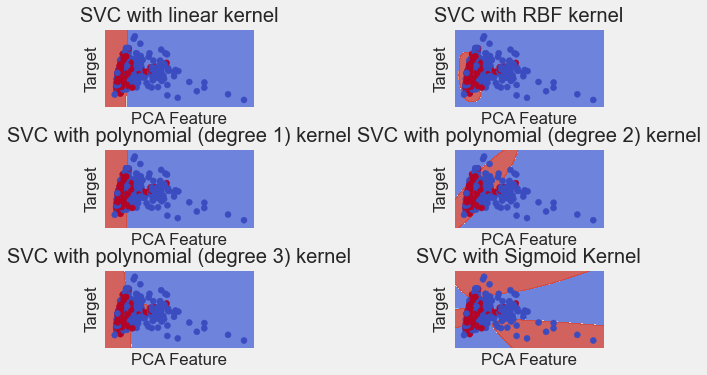

In [221]:


X = X_train
y = y_train

h = .02  # step size in the mesh

# we create an instance of SVM and fit out data. We do not scale our
# data since we want to plot the support vectors
C = 1.0  # SVM regularization parameter
svc = svm.SVC(kernel='linear', C=C).fit(X, y)
rbf_svc = svm.SVC(kernel='rbf', gamma=0.7, C=C).fit(X, y)
poly_svc = svm.SVC(kernel='poly', degree=1, C=C).fit(X, y)
poly_svc_2 = svm.SVC(kernel='poly', degree=2, C=C).fit(X, y)
poly_svc_3 = svm.SVC(kernel='poly', degree=3, C=C).fit(X, y)

sig_svc = svm.SVC(kernel='sigmoid').fit(X, y)


lin_svc = svm.LinearSVC(C=C).fit(X, y)

# create a mesh to plot in
x_min, x_max = X.iloc[:, 0].min() - 1, X.iloc[:, 0].max() + 1
y_min, y_max = X.iloc[:, 1].min() - 1, X.iloc[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))

# title for the plots
titles = ['SVC with linear kernel',
          'SVC with RBF kernel',
          'SVC with polynomial (degree 1) kernel',
           'SVC with polynomial (degree 2) kernel',
          'SVC with polynomial (degree 3) kernel',
           'SVC with Sigmoid Kernel']


for i, clf in enumerate((svc, rbf_svc, poly_svc,poly_svc_2,poly_svc_3,sig_svc)):
    # Plot the decision boundary. For that, we will assign a color to each
    # point in the mesh [x_min, x_max]x[y_min, y_max].
    plt.subplot(3, 2, i + 1)
    plt.subplots_adjust(wspace=0.4, hspace=0.4)

    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.8)

    # Plot also the training points
    plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=y, cmap=plt.cm.coolwarm)
    plt.xlabel('PCA Feature')
    plt.ylabel('Target')
    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.xticks(())
    plt.yticks(())
    plt.title(titles[i])
   # plt.tight_layout(pad=1)
    plt.subplots_adjust(hspace=0.5,wspace=1.3)


plt.show()

## Running KNN with possible K Values with visualization

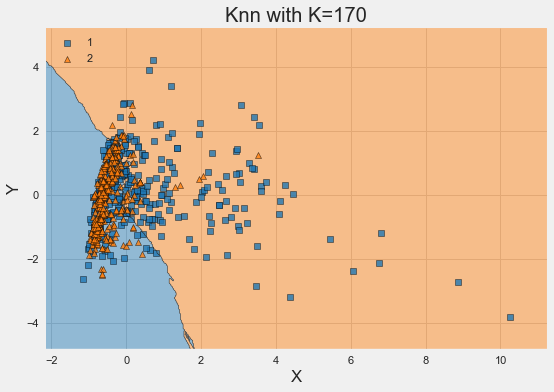

In [186]:

knn_comparison(X_train,y_train,170)

In [148]:
X_train, X_test, y_train, y_test = train_test_split(x_smote, y_smote, test_size = 0.20, random_state = 0)
y_train=y_train.iloc[:,0]
y_train=y_train.to_numpy()
X_train=X_train.to_numpy()
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)
pca = PCA()
pca = PCA(n_components=2)
pca.fit(X_train)
X_train = pd.DataFrame(pca.transform(X_train))
X_test = pd.DataFrame(pca.transform(X_test))

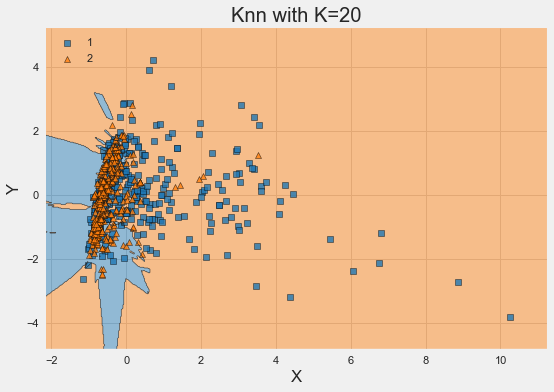